<a href="https://colab.research.google.com/github/WildanAz/recommendation-system-tfidf/blob/main/Tim_10C_Python_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Import data & library**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import warnings

# Menonaktifkan semua warning
warnings.filterwarnings('ignore')

Dataset yang digunakan adalah data 5 supermarket yang ada di UK(United Kingdom)!

In [ ]:
bm = pd.read_csv("/content/drive/MyDrive/SCDSAI/10C- BIG DATA BANDITS/Dataset 5/BritishMart.csv")
cvf = pd.read_csv("/content/drive/MyDrive/SCDSAI/10C- BIG DATA BANDITS/Dataset 5/CVFamz.csv")
cvv = pd.read_csv("/content/drive/MyDrive/SCDSAI/10C- BIG DATA BANDITS/Dataset 5/CVanyMart.csv")
sm = pd.read_csv("/content/drive/MyDrive/SCDSAI/10C- BIG DATA BANDITS/Dataset 5/ScottishMart.csv")
ukm = pd.read_csv("/content/drive/MyDrive/SCDSAI/10C- BIG DATA BANDITS/Dataset 5/UKMart.csv")

## Read Data

In [ ]:
# Menampilkan 3 baris pertama dari setiap DataFrame dalam bentuk tabel
print("BritishMart")
display(bm.head(3))

print("CVFamz")
display(cvf.head(3))

print("CVanyMart")
display(cvv.head(3))

print("ScottishMart")
display(sm.head(3))

print("UKMart")
display(ukm.head(3))

BritishMart


,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01
1,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01
2,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01


CVFamz


,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,CVFamz,45.0,45.0,unit,TP-Link Tapo C310 Outdoor Security Wi-Fi Camera,home,False,2021-01-01
1,CVFamz,55.0,55.0,unit,Amazon Echo Dot 5Th Gen Charcoal,home,False,2021-01-01
2,CVFamz,20.0,4.0,m,Energizer UK 3 Pin Smart 5m Flexi Strip Light,home,False,2021-01-01


CVanyMart


,nama_toko,harga_per_unit,unit,nama,tanggal,kategori,brand_sendiri,harga_pound
0,CVanyMart,2.9,l,Scentcerity Calming Zen Room Spray 240ml,2021-01-01,household,False,0.690000
1,CVanyMart,1.2,l,Almat So Soft Luxurious Fabric Conditioner- Li...,2021-01-02,household,False,1.040000
2,CVanyMart,1.1,l,Almat So Soft Fabric Conditioner - Clear Skies...,2021-01-03,household,False,1.156667


ScottishMart


,nama_toko,harga,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,ScottishMart,0.4,0.0,unit,Swan Vesta Matches 1 Box,household,False,2021-01-01
1,ScottishMart,0.5,0.0,unit,Tesco 200 Cotton Buds,health_products,True,2021-01-01
2,ScottishMart,0.6,0.0,unit,Tesco Nappy Bags 300,baby_products,True,2021-01-01


UKMart


,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,UKMart,1.50,3.00,kg,Alpro Plain Unsweetened No Sugars Plant-Based ...,fresh_food,False,2021-01-01
1,UKMart,1.65,0.82,l,Cravendale Filtered Fresh Skimmed Milk Fresher...,fresh_food,False,2021-01-01
2,UKMart,1.65,0.82,l,Cravendale Filtered Fresh Whole Milk 2L Freshe...,fresh_food,False,2021-01-01


### Null Checking

In [ ]:
print("BritishMart")
display(bm.isna().sum())

print("\nCVFamz")
display(cvf.isna().sum())

print("\nCVanyMart")
display(cvv.isna().sum())

print("\nScottishMart")
display(sm.isna().sum())

print("\nUKMart")
display(ukm.isna().sum())

BritishMart


nama_toko         0
harga_pound       0
harga_per_unit    0
unit              0
nama              0
kategori          0
brand_sendiri     0
tanggal           0
dtype: int64


CVFamz


nama_toko           0
harga_pound         4
harga_per_unit    110
unit              110
nama               21
kategori            0
brand_sendiri      21
tanggal             0
dtype: int64


CVanyMart


nama_toko         0
harga_per_unit    4
unit              4
nama              0
tanggal           0
kategori          0
brand_sendiri     0
harga_pound       0
dtype: int64


ScottishMart


nama_toko         0
harga             0
harga_per_unit    1
unit              1
nama              0
kategori          0
brand_sendiri     0
tanggal           0
dtype: int64


UKMart


nama_toko           0
harga_pound         0
harga_per_unit    129
unit              129
nama                0
kategori            0
brand_sendiri       0
tanggal             0
dtype: int64

### Data Type Checking

In [ ]:
bm.info()
cvf.info()
cvv.info()
sm.info()
ukm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 979866 entries, 0 to 979865
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   nama_toko       979866 non-null  object 
 1   harga_pound     979866 non-null  float64
 2   harga_per_unit  979866 non-null  float64
 3   unit            979866 non-null  object 
 4   nama            979866 non-null  object 
 5   kategori        979866 non-null  object 
 6   brand_sendiri   979866 non-null  bool   
 7   tanggal         979866 non-null  object 
dtypes: bool(1), float64(2), object(5)
memory usage: 53.3+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1299188 entries, 0 to 1299187
Data columns (total 8 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   nama_toko       1299188 non-null  object 
 1   harga_pound     1299184 non-null  float64
 2   harga_per_unit  1299078 non-null  float64
 3   unit            



**nama_toko:** Nama toko tempat produk dijual. Kolom ini berisi informasi tentang berbagai nama toko.

**harga_pound:** Harga produk dalam pound. Kolom ini menunjukkan total harga produk.    

**harga_per_unit:** Harga per unit produk. Ini menunjukkan harga per unit produk yang dijual.

**unit:** Unit produk yang dijual (misalnya liter, kilogram, pcs). Kolom ini berisi informasi tentang satuan ukuran produk.

**nama:** Nama produk. Kolom ini berisi nama-nama produk yang dijual.

**kategori:** Kategori produk. Ini mencakup berbagai kategori seperti makanan, minuman, kebutuhan rumah tangga, dll.

**brand_sendiri:** Indikator apakah produk tersebut merupakan merek milik toko sendiri (private label). Nilainya adalah boolean (Benar atau Salah).

**tanggal:** Tanggal pencatatan data penjualan atau harga. Kolom ini menunjukkan kapan data diambil.

## Join All Data

In [ ]:
# Renaming the columns to ensure consistency
bm.columns = ['nama_toko', 'harga_pound', 'harga_per_unit', 'unit', 'nama', 'kategori', 'brand_sendiri', 'tanggal']
cvf.columns = ['nama_toko', 'harga_pound', 'harga_per_unit', 'unit', 'nama', 'kategori', 'brand_sendiri', 'tanggal']
cvv = cvv.reindex(columns=['nama_toko', 'harga_pound', 'harga_per_unit', 'unit', 'nama', 'kategori', 'brand_sendiri', 'tanggal'])
sm.columns = ['nama_toko', 'harga_pound', 'harga_per_unit', 'unit', 'nama', 'kategori', 'brand_sendiri', 'tanggal']
ukm.columns = ['nama_toko', 'harga_pound', 'harga_per_unit', 'unit', 'nama', 'kategori', 'brand_sendiri', 'tanggal']

#combine the data
all_data = pd.concat([bm, cvf, cvv, sm, ukm], ignore_index=True)
all_data.head(5)

,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01
1,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01
2,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01
3,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01
4,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01


mengganti nama kolom di beberapa DataFrame untuk memastikan kolom tersebut memiliki nama yang konsisten. DataFrames digunakan dalam Python untuk menyimpan dan memanipulasi data. Pada kode tersebut terlihat nama kolom diubah menjadi 'nama_toko' (nama toko), 'harga_pound' (harga dalam pound), 'harga_per_unit' (harga per unit), 'unit' (satuan), 'nama ' (nama), 'kategori' (kategori), 'brand_sendiri' (merek sendiri), dan 'tanggal' (tanggal).

### Uniq Value

In [ ]:
# Melihat kategori unik dari masing-masing tabel
unique_categories_bm = bm['kategori'].unique()
unique_categories_cvf = cvf['kategori'].unique()
unique_categories_cvv = cvv['kategori'].unique()
unique_categories_sm = sm['kategori'].unique()
unique_categories_ukm = ukm['kategori'].unique()

print("Unique categories in BritishMart:", unique_categories_bm)
print("Unique categories in CVFamz:", unique_categories_cvf)
print("Unique categories in CVanyMart:", unique_categories_cvv)
print("Unique categories in ScottishMart:", unique_categories_sm)
print("Unique categories in UKMart:", unique_categories_ukm)

Unique categories in BritishMart: ['drinks' 'home' 'food_cupboard' 'fresh_food' 'frozen' 'free-from'
 'bakery' 'health_products' 'household' 'baby_products' 'pets']
Unique categories in CVFamz: ['home' 'food_cupboard' 'fresh_food' 'health_products' 'free-from'
 'household' 'drinks' 'pets' 'frozen' 'bakery' 'baby_products']
Unique categories in CVanyMart: ['household' 'fresh_food' 'bakery' 'frozen' 'free-from' 'health_products'
 'pets' 'drinks' 'baby_products' 'food_cupboard']
Unique categories in ScottishMart: ['household' 'health_products' 'baby_products' 'drinks' 'home'
 'food_cupboard' 'frozen' 'pets' 'fresh_food' 'bakery']
Unique categories in UKMart: ['fresh_food' 'pets' 'baby_products' 'free-from' 'drinks' 'frozen'
 'household' 'bakery' 'food_cupboard' 'health_products' 'home']


membersihkan dan menyiapkan data untuk analisis lebih lanjut. Ini berfokus pada menemukan kategori produk unik dari beberapa DataFrames.

In [ ]:
# Ambil nilai unik dari kolom 'unit' untuk setiap tabel
unique_categories_bm = bm['unit'].unique()
unique_categories_cvf = cvf['unit'].unique()
unique_categories_cvv = cvv['unit'].unique()
unique_categories_sm = sm['unit'].unique()
unique_categories_ukm = ukm['unit'].unique()
unique_categories_all_data = all_data['unit'].unique()

# Tampilkan nilai unik untuk setiap tabel
print("Unique categories in BritishMart:", unique_categories_bm)
print("Unique categories in CVFamz:", unique_categories_cvf)
print("Unique categories in CVanyMart:", unique_categories_cvv)
print("Unique categories in ScottishMart:", unique_categories_sm)
print("Unique categories in UKMart:", unique_categories_ukm)

Unique categories in BritishMart: ['l' 'kg' 'unit' 'm']
Unique categories in CVFamz: ['unit' 'm' 'l' 'kg' nan]
Unique categories in CVanyMart: ['l' 'unit' 'kg' 'm' nan]
Unique categories in ScottishMart: ['unit' 'kg' 'l' 'm' nan]
Unique categories in UKMart: ['kg' 'l' 'unit' nan 'm']


daftar kategori unik yang ditemukan di lima toko berbeda: British Mart, CV Famz, CV AnyMart, Scottish Mart, dan UK Mart.Untuk setiap toko, kategori unik dicantumkan. Misalnya, di British Mart, kategori uniknya mencakup "kg", "unit", dan "m".

Penting untuk dicatat bahwa arti dari kategori-kategori ini bergantung pada konteks data. Tanpa informasi lebih lanjut. Namun, mengingat data tersebut berkaitan dengan toko ,bahwa kategori ini mewakili satuan pengukuran (misalnya, kg untuk kilogram, satuan), atau jenis produk (misalnya, m untuk daging).

untuk "nan" di beberapa keluaran kemungkinan besar menunjukkan bahwa ada nilai yang hilang dalam data asli.

# **Preprocessing**

## Drop Missing Value

In [ ]:
all_data.isna().sum()

nama_toko           0
harga_pound         4
harga_per_unit    244
unit              244
nama               21
kategori            0
brand_sendiri      21
tanggal             0
dtype: int64

memeriksa missing value (nilai yang hilang) dalam suatu dataset. Kolom 'nama_toko' dan 'kategori' tidak memiliki nilai yang hilang. Namun, terdapat 4 nilai yang hilang dalam kolom 'harga_pound', dan 244 nilai yang hilang dalam kolom 'harga_per_unit' dan 'unit'. Selain itu, terdapat juga 21 nilai yang hilang dalam kolom 'nama' dan 'brand_sendiri'.

In [ ]:
# Menghapus baris dengan nilai NaN dari DataFrame all_data
all_data = all_data.dropna()

# Menampilkan lima baris pertama DataFrame yang telah dibersihka
all_data.head()

,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal
0,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01
1,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01
2,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01
3,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01
4,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01


Menghapus baris yang mengandung nilai NaN (nilai yang hilang) dari DataFrame yang disimpan dalam variabel all_data. Kemudian, lima baris pertama dari DataFrame yang telah dibersihkan ditampilkan dengan menggunakan metode head(). Dengan demikian, DataFrame sekarang hanya berisi baris yang tidak memiliki nilai NaN.

In [ ]:
all_data.isna().sum()

nama_toko         0
harga_pound       0
harga_per_unit    0
unit              0
nama              0
kategori          0
brand_sendiri     0
tanggal           0
dtype: int64

memeriksa missing value (nilai yang hilang) dalam suatu dataset. setelah menghilangkan missing value

## Unique Value Checking Combined Data

In [ ]:
# Get unique categories
unique_categories = all_data['kategori'].unique()

# Display unique categories
print("Unique Categories in the dataset:")
for category in unique_categories:
    print("-", category)

Unique Categories in the dataset:
- drinks
- home
- food_cupboard
- fresh_food
- frozen
- free-from
- bakery
- health_products
- household
- baby_products
- pets


mengambil nilai unik dari kolom 'kategori' dalam DataFrame all_data dan menyimpannya dalam variabel unique_categories. Setelah itu, kode tersebut menampilkan daftar kategori unik dalam dataset dengan menggunakan perulangan, di mana setiap kategori unik dicetak satu per satu dengan tanda strip ('-') di depannya. Dengan demikian, kita mendapatkan daftar lengkap kategori yang ada dalam dataset, termasuk 'drinks', 'home', 'food_cupboard', dan lainnya.

## Changing Data Type

In [ ]:
# Convert 'tanggal' column to datetime format
all_data['tanggal'] = pd.to_datetime(all_data['tanggal'])

# Check the data types again
print(all_data.dtypes)

nama_toko                 object
harga_pound              float64
harga_per_unit           float64
unit                      object
nama                      object
kategori                  object
brand_sendiri             object
tanggal           datetime64[ns]
dtype: object


mengonversi kolom 'tanggal' dalam DataFrame all_data ke format datetime menggunakan fungsi pd.to_datetime(). Setelah konversi, kode tersebut mencetak tipe data dari setiap kolom dalam DataFrame yang telah diubah menggunakan print(all_data.dtypes). Dengan demikian, kita dapat memastikan bahwa kolom 'tanggal' sekarang memiliki tipe data datetime.

# **EDA (Exploratory Data Analysis)**

## Outlier Checking Harga Pund & Harga per unit

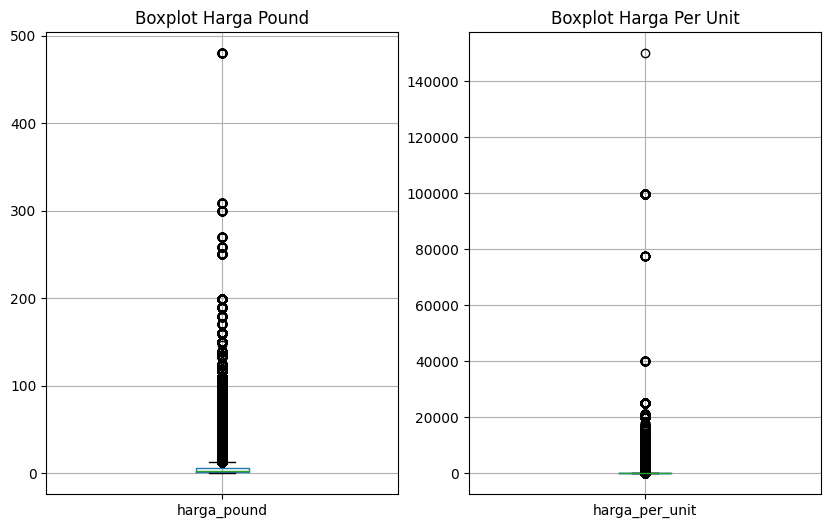

In [ ]:
# Visualisasi boxplot untuk kolom harga_pound dan harga_per_unit
plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
all_data.boxplot(column='harga_pound')
plt.title('Boxplot Harga Pound')

plt.subplot(1, 2, 2)
all_data.boxplot(column='harga_per_unit')
plt.title('Boxplot Harga Per Unit')

plt.show()

Hasil di atas merupakan sebuah visualisasi boxplot dari variabel 'harga_pound' dan 'harga_per_unit'. Jika diamati dari kedua boxplot di atas, bahwasannya terjadi kerentangan harga yang jauh dari masing - masing variabelnya. Untuk variabel 'harga_pound' terjadi kerentangan harga dari 200 ke 500. Sedangkan dari variabel 'harga_per_unit' terjadi kerentangan harga dari 20.000 ke 140.000. Hal ini sebenarnya bisa termasuk ke dalam outlier, akan tetapi variabel 'harga_pund' dan 'harga_per_unit' merupakan variabel yang penting dan ini termasuk kedalam hal yang wajar, maka tidak dianggap sebagai outlier.

## Maksimum & Minimum Data

In [ ]:
# Cek nilai maksimum dan minimum untuk kolom harga_pound
harga_pound_max = all_data['harga_pound'].max()
harga_pound_min = all_data['harga_pound'].min()

# Cek nilai maksimum dan minimum untuk kolom harga_per_unit
harga_per_unit_max = all_data['harga_per_unit'].max()
harga_per_unit_min = all_data['harga_per_unit'].min()

print("Nilai maksimum harga_pound:", harga_pound_max)
print("Nilai minimum harga_pound:", harga_pound_min)

print("Nilai maksimum harga_per_unit:", harga_per_unit_max)
print("Nilai minimum harga_per_unit:", harga_per_unit_min)

Nilai maksimum harga_pound: 479.99
Nilai minimum harga_pound: 0.01
Nilai maksimum harga_per_unit: 150000.0
Nilai minimum harga_per_unit: 0.0


Syntax di atas digunakan untuk menghitung nilai maksimum dan minimum dari kolom 'harga_pound' dan 'harga_per_unit' dari dataframe 'all_data'. Output dari syntax menunjukkan bahwa harga dalam pound berkisar dari 0.01 hingga 479.99, sedangkan harga per unit berkisar dari 0.0 hingga 150000.0.

## Average Harga Per Unit Per Category

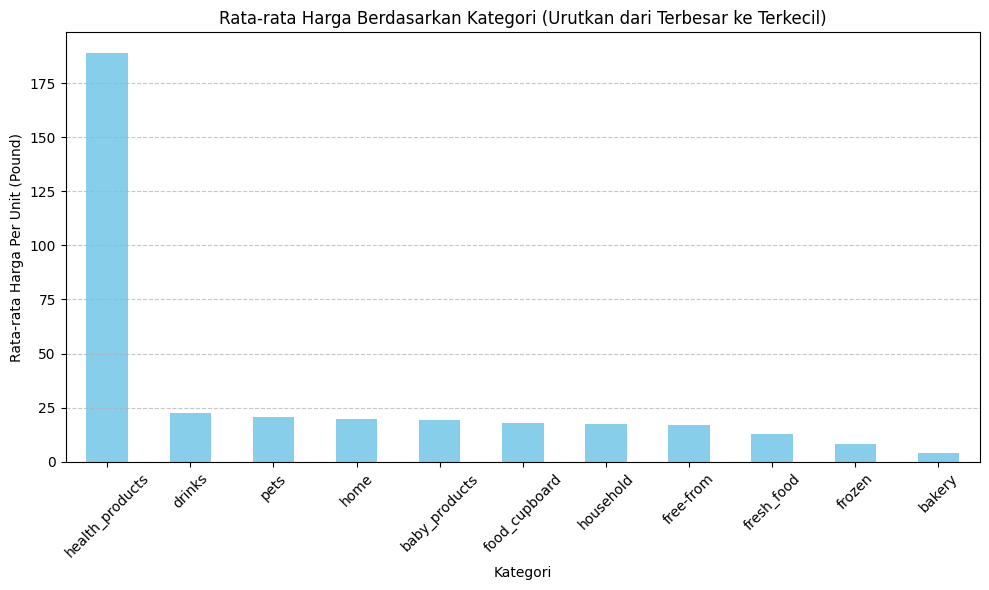

In [ ]:
# Group by 'kategori' and calculate mean harga
kategori_harga_mean = all_data.groupby('kategori')['harga_per_unit'].mean()

# Urutkan dari terbesar ke terkecil
kategori_harga_mean_sorted = kategori_harga_mean.sort_values(ascending=False)

# Plot
kategori_harga_mean_sorted.plot(kind='bar', figsize=(10, 6), color='skyblue')

# Customize plot
plt.title('Rata-rata Harga Berdasarkan Kategori (Urutkan dari Terbesar ke Terkecil)')
plt.xlabel('Kategori')
plt.ylabel('Rata-rata Harga Per Unit (Pound)')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.tight_layout()
plt.show()

Syntax di atas menghasilkan sebuah visualisasi histogram untuk mengetahui Rata - rata Harga Berdasarkan Kategori sesuai dari urutan jumlah rata - rata harega pound yang mana dari terbesar ke terkecil. Dapat diamati bahwasannya kategori 'health_product' memiliki rata - rata harga pound yang paling tinggi, sedangkan kategori 'bakery' memiliki rata - rata harga pound yang paling rendah.

## Average Harga Pound Per Category

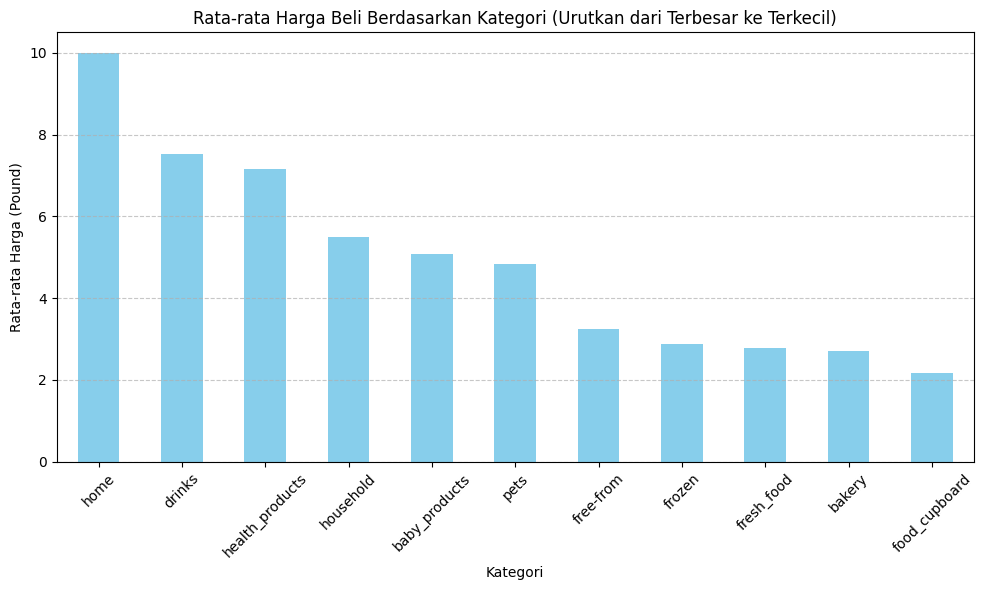

In [ ]:
# Group by 'kategori' and calculate mean harga
kategori_harga_beli_mean = all_data.groupby('kategori')['harga_pound'].mean()

# Urutkan dari terbesar ke terkecil
kategori_harga_beli_mean_sorted = kategori_harga_beli_mean.sort_values(ascending=False)

# Plot
kategori_harga_beli_mean_sorted.plot(kind='bar', figsize=(10, 6), color='skyblue')

# Customize plot
plt.title('Rata-rata Harga Beli Berdasarkan Kategori (Urutkan dari Terbesar ke Terkecil)')
plt.xlabel('Kategori')
plt.ylabel('Rata-rata Harga (Pound)')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.tight_layout()
plt.show()

Output di atas merupakan sebuah visualisasi histogram untuk mengetahui Rata - rata Harga Beli Berdasarkan Kategori sesuai dengan yang memiliki rata - rata harga pound terbesar ke terkecil. Berdasarkan histogram di atas, dapat diamati bahwasannya kategori 'home' memiliki jumlah rata - rata harga pound tertinggi. Kemudian diurutan kedua dan ketiga ada variabel 'drinks' dan 'health-products'. Sementara kategori 'food_cupboard' memiliki rata - rata harga pound paling kecil.

## Total Stock

kategori
bakery              125171
baby_products       154409
pets                157881
frozen              169629
free-from           184989
household           299454
drinks              580672
home                699317
fresh_food          728403
health_products     848091
food_cupboard      1117702
dtype: int64


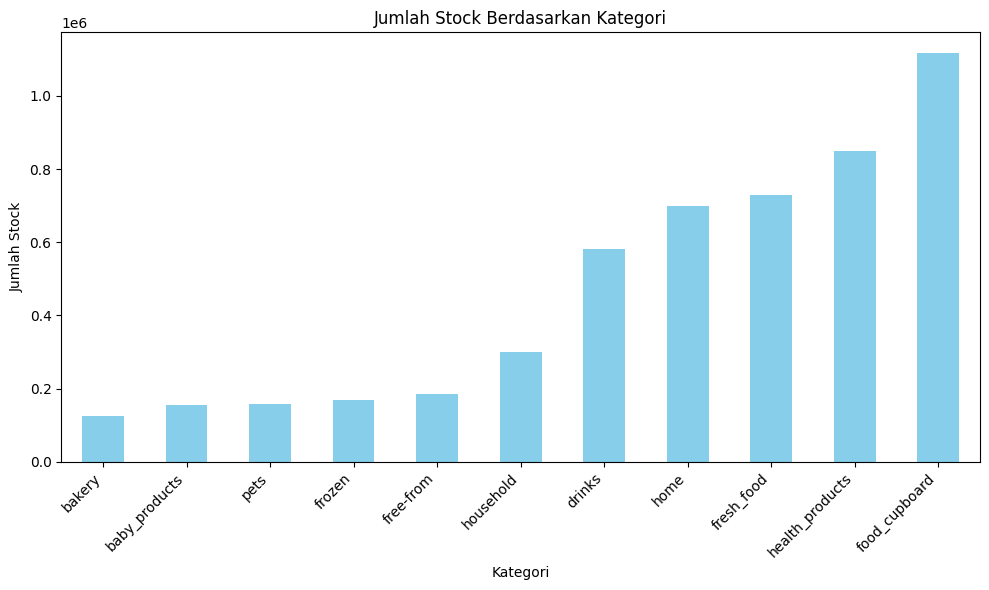

In [ ]:
# Group by 'kategori' and calculate total Stock
kategori_jumlah_stock = all_data.groupby('kategori').size()

# Urutkan dari terendah ke tertinggi
kategori_jumlah_stock_sorted = kategori_jumlah_stock.sort_values(ascending=True)

# Plot
kategori_jumlah_stock_sorted.plot(kind='bar', figsize=(10, 6), color='skyblue')

# Customize plot
plt.title('Jumlah Stock Berdasarkan Kategori')
plt.xlabel('Kategori')
plt.ylabel('Jumlah Stock')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Tampilkan hasil
print(kategori_jumlah_stock_sorted)

# Show plot
plt.show()

Berdasarkan visualisasi data di atas, diketahui jumlah stock berdasarkan kategori dari produk terendah ke jumlah stock paling tinggi. Untuk urutan pertama paling tinggi ditempati oleh kategori food_cupboard, diikuti oleh health_products, dan kategori ketiga paling tinggi yaitu fresh_food. Sementara itu, kategori yang paling rendah stocknya adalah bakery.

## Presentation of own brand

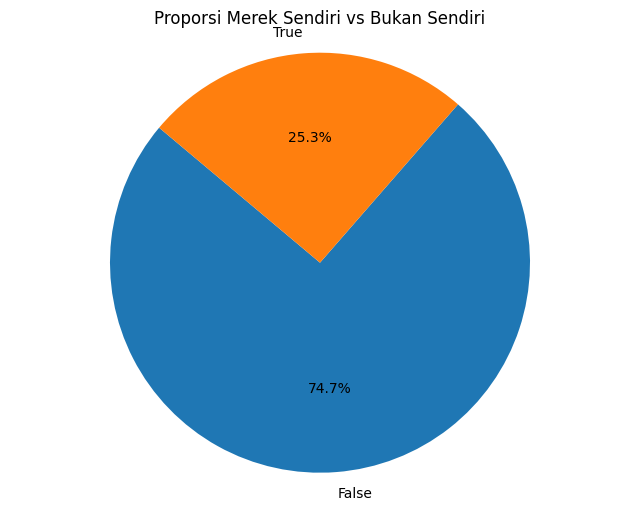

In [ ]:
import matplotlib.pyplot as plt

# Hitung jumlah merek milik sendiri dan bukan milik sendiri
count_brand = all_data['brand_sendiri'].value_counts()

# Visualisasikan dalam diagram lingkaran
plt.figure(figsize=(8, 6))
plt.pie(count_brand, labels=count_brand.index, autopct='%1.1f%%', startangle=140)
plt.title('Proporsi Merek Sendiri vs Bukan Sendiri')
plt.axis('equal')  # Memastikan lingkaran terlihat sebagai lingkaran
plt.show()

Berdasarkan diagram lingkaran di atas diketahui proporsi antara merek sendiri dan bukan merek sendiri. Untuk bukan merek sendiri memiliki proporsi lebih besar daripada merek sendiri yaitu 74,7%. Sedangkan, untuk merek sendiri hanya memiliki proporsi sebesar 25,3%

## 10 Top Item

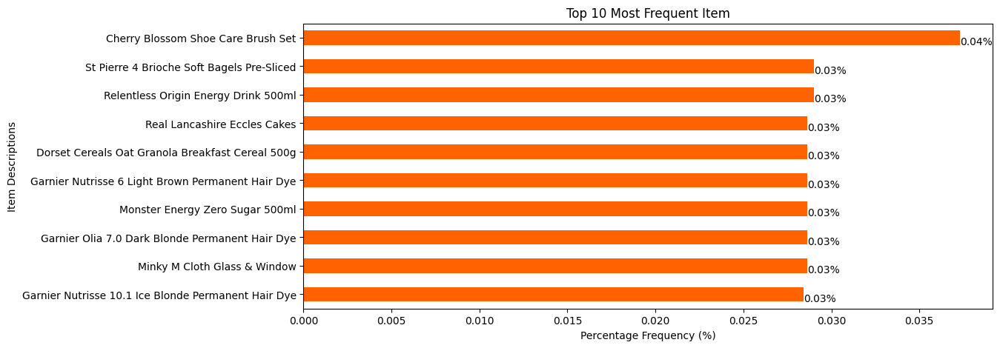

In [ ]:
# Finding the top 10 most frequent item
top_10_item_descriptions = all_data['nama'].value_counts(normalize=True).head(10) * 1000

# Plotting the top 10 most frequent item
plt.figure(figsize=(12, 5))
top_10_item_descriptions.plot(kind='barh', color='#ff6200')

# Adding the percentage frequency on the bars
for index, value in enumerate(top_10_item_descriptions):
    plt.text(value, index+0.25, f'{value:.2f}%', fontsize=10)

plt.title('Top 10 Most Frequent Item')
plt.xlabel('Percentage Frequency (%)')
plt.ylabel('Item Descriptions')
plt.gca().invert_yaxis()
plt.show()


Visualisasi di atas merupakan penggambaran dari top 10 item product sering dibeli konsumen yang digambarkan dengan diagram batang yang diurutkan dari item product paling top. Untuk item products yang paling top yaitu 'Cherry Blossom Shoe Care Brush Set' dengan 0,04%. Lalu diikuti dengan product lainnya yang memiliki persentase sama yaitu 0,03%.

## Top Market

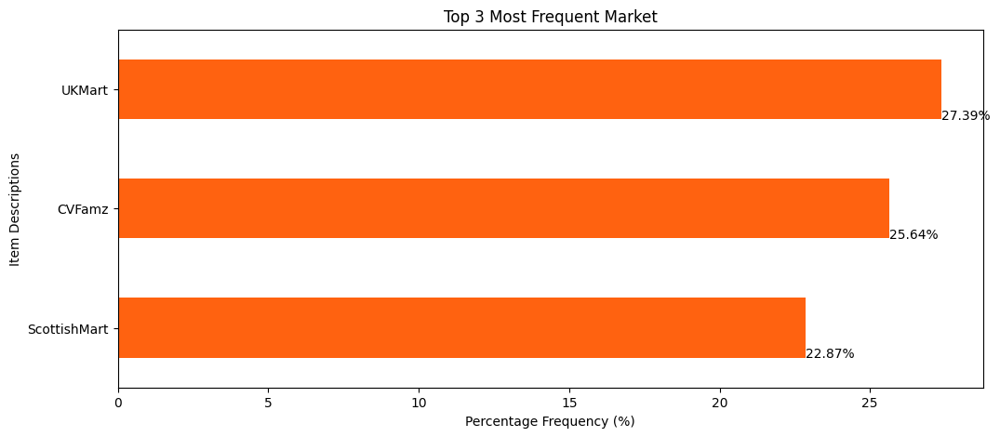

In [ ]:
# Finding the top 3 most frequent market
top_3_market = all_data['nama_toko'].value_counts(normalize=True).head(3) * 100

# Plotting the top 3 most frequent market
plt.figure(figsize=(12, 5))
top_3_market.plot(kind='barh', color='#ff6210')

# Adding the percentage frequency on the bars
for index, value in enumerate(top_3_market):
    plt.text(value, index+0.25, f'{value:.2f}%', fontsize=10)

plt.title('Top 3 Most Frequent Market')
plt.xlabel('Percentage Frequency (%)')
plt.ylabel('Item Descriptions')
plt.gca().invert_yaxis()
plt.show()

Output di atas merupakan diagram batang yang menggambarkan 3 supermarket paling favorit atau sering dikunjungi yang digambarkan menggunakan persentase. Berdasarkan visualisasi di atas diketahui bahwa dari 5 market, UK Mart merupakan supermarket paling favorit dengan persentase 27,39%, lalu diikuti dengan CV Famz dengan persentase 25,64%. Sedangkan Scottish Mart menempati urutan ketiga dengan persentase sebesar 22,87%.

## Top Category Per Market

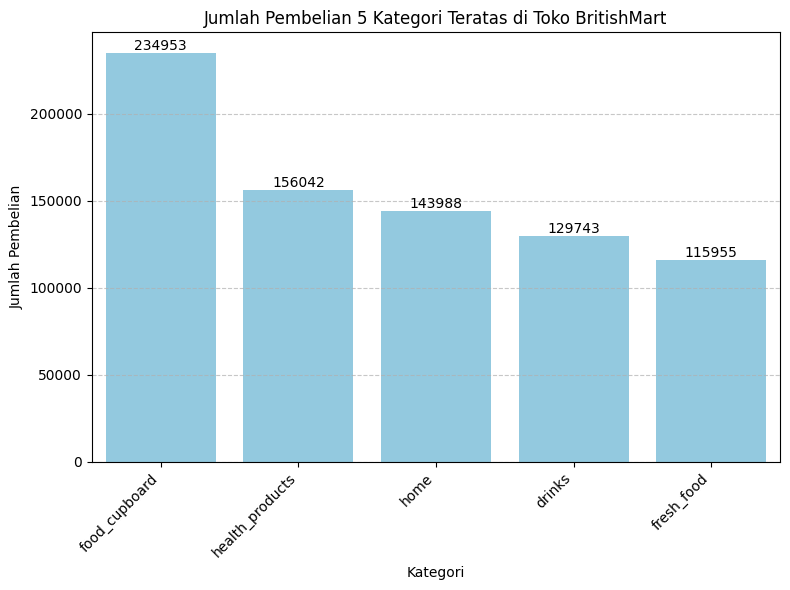

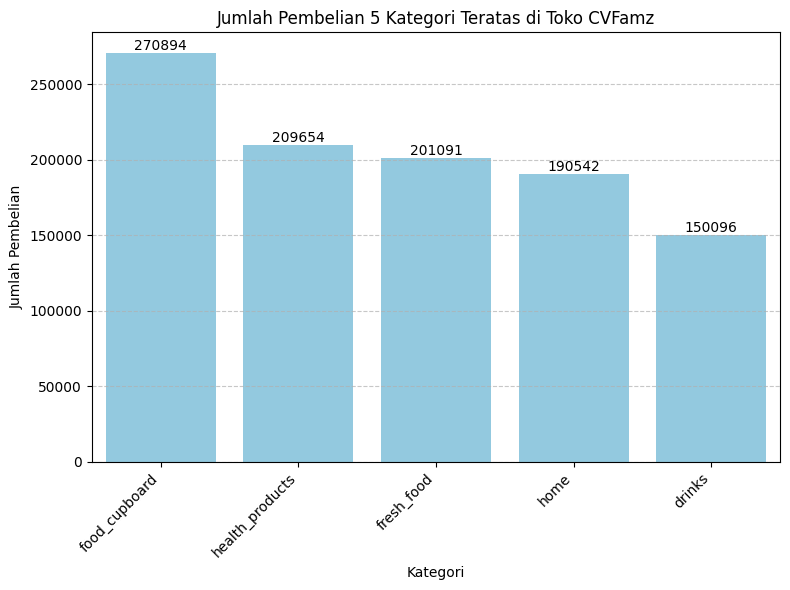

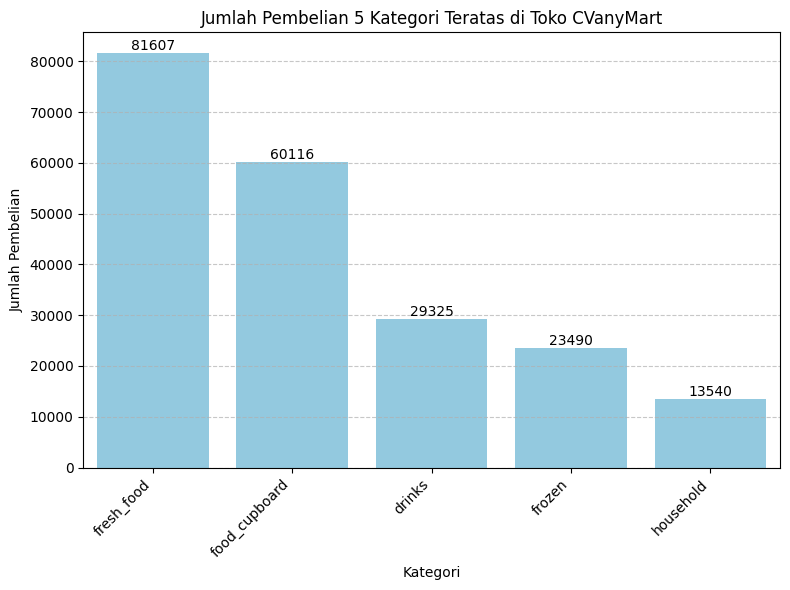

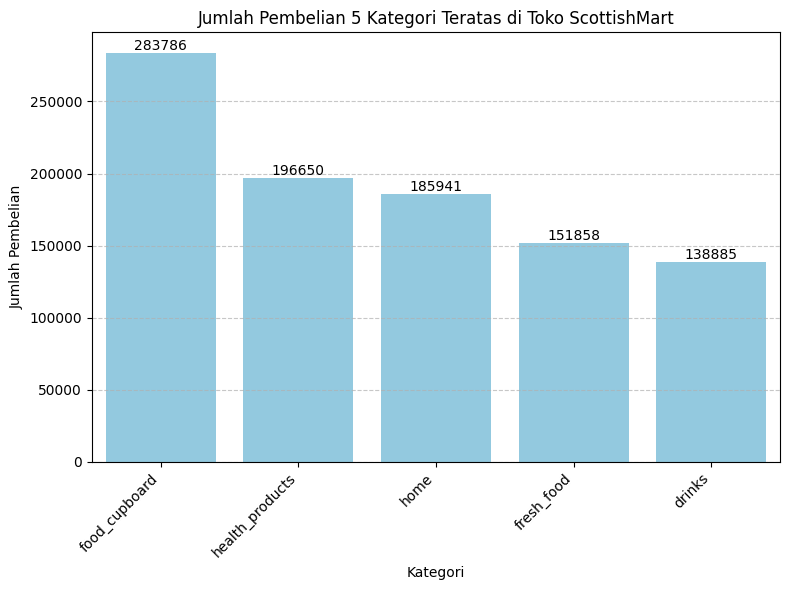

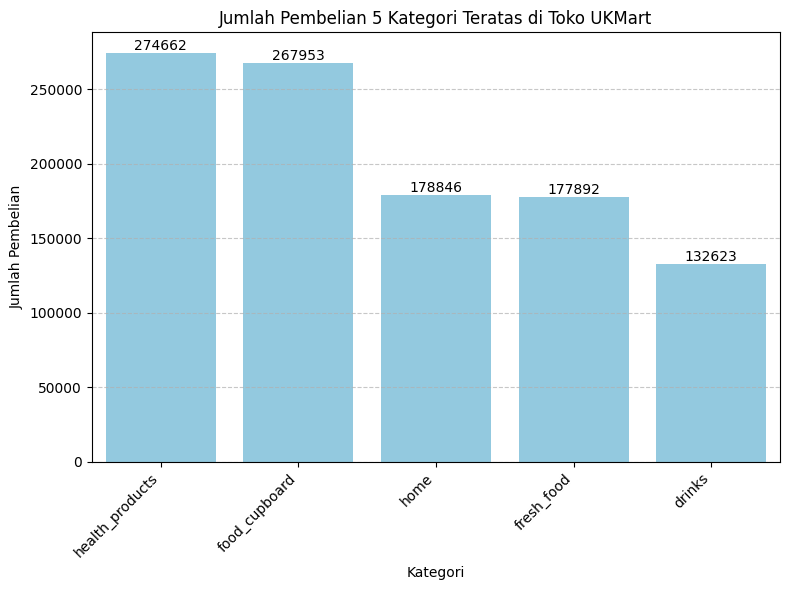

In [ ]:
import seaborn as sns

# Menghitung jumlah pembelian berdasarkan kategori untuk setiap toko
purchase_count_by_store_and_category = all_data.groupby(['nama_toko', 'kategori']).size().unstack(fill_value=0)

# Loop melalui setiap toko untuk membuat plot terpisah
for store in purchase_count_by_store_and_category.index:
    # Mengurutkan jumlah pembelian berdasarkan kategori dari terbesar ke terkecil
    sorted_categories = purchase_count_by_store_and_category.loc[store].sort_values(ascending=False)

    # Memilih hanya 5 kategori teratas
    top_categories = sorted_categories.head(5)

    # Menggunakan satu warna (hijau) untuk semua kategori
    color_palette = sns.color_palette(["skyblue"] * len(top_categories))

    # Membuat satu plot untuk setiap toko di luar loop
    plt.figure(figsize=(8, 6))

    # Membuat bar plot menggunakan seaborn tanpa palette dan menambahkan legend=False
    ax = sns.barplot(x=top_categories.index, y=top_categories.values, hue=top_categories.index, palette=color_palette, saturation=0.75, legend=False)

    # Menambahkan judul dan label sumbu
    plt.title(f'Jumlah Pembelian 5 Kategori Teratas di Toko {store}')
    plt.xlabel('Kategori')
    plt.ylabel('Jumlah Pembelian')

    # Mengatur rotasi label sumbu x untuk kategori
    plt.xticks(rotation=45, ha='right')

    # Menambahkan grid untuk sumbu y
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Menyusun plot agar rapi
    plt.tight_layout()

    # Menambahkan label count di dalam setiap bar
    for p in ax.patches:
        # Mengatur posisi teks di dalam batas bar
        width, height = p.get_width(), p.get_height()
        x, y = p.get_xy()
        ax.annotate(f'{height:.0f}', (x + width/2, y + height), ha='center', va='center', xytext=(0, 5), textcoords='offset points', fontsize=10)


    # Menampilkan plot
    plt.show()


Visualisasi diatas menjelaskan tentang distribusi produk berdasarkan kategori untuk 5 toko yang berbeda. Jika dilihat dari grafik maka bisa di ambil informasi pembelian produk berdasarkan kategori terbanyak tiap toko adalah
- BritishMart adalah `food_cupboard` dengan jumlah pembelian **234.953**
- CVFamz adalah `food_cupboard` dengan jumlah pembelian  **270.894**
- CVanyMart adalah `fresh_food` dengan jumlah pembelian **81.607**
- ScottishMart adalah `food_cupboard` dengan jumlah pembelian **283.786**
- UKMart adalah `health_product` dengan jumlah pembelian **274.662**

## Statistics

In [ ]:
# Convert 'harga_pound' to numeric (errors='coerce' akan menggantikan nilai non-numerik dengan NaN)
all_data['harga_pound'] = pd.to_numeric(all_data['harga_pound'], errors='coerce')

# Drop rows with NaN values in 'harga_pound'
all_data = all_data.dropna(subset=['harga_pound'])

# Analisis statistik deskriptif untuk harga
print("Statistik deskriptif untuk harga:")
print(all_data['harga_pound'].describe())

Statistik deskriptif untuk harga:
count    5.065718e+06
mean     5.234138e+00
std      7.517392e+00
min      1.000000e-02
25%      1.750000e+00
50%      3.000000e+00
75%      6.000000e+00
max      4.799900e+02
Name: harga_pound, dtype: float64


Output di atas menunjukkan statistik deskriptif dari harga_pound yaitu harga yang mewakili harga yang dijual ke konsumen. Untuk jumlah dari harga_pound yaitu sebesar 5.065.718, dengan rata-rata 5.234138, standar deviasi sebesar 7.517392. Untuk harga_pound paling rendah yaitu sebesar 0.01 sementara untuk harga_pound paling tinggi yaitu sebesar 479.99. Hal ini menunjukkan adanya variasi yang cukup signifikan antara harga_pound terkecil dan harga_pound terbesar. Untuk quartil 1 sebesar 1.75, kuartil 2 sebesar 3.0, dan kuartil 3 sebesar 6.0 yang menunjukkan distribusi data yang condong ke kanan (positif). Hal ini menunjukkan bahwa sebagian besar datanya bernilai dibawah nilai rata-ratanya.

## **Market Analysis**

### Daily


#### Daily Average Price Per Unit Per Category From 2021 to 2024

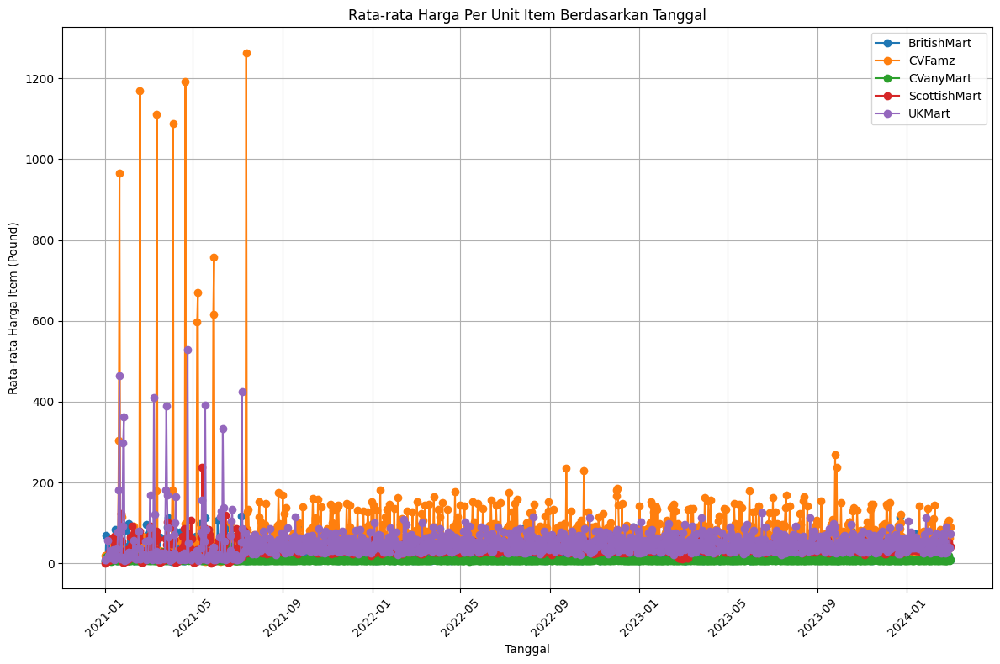

In [ ]:
# Kelompokkan data berdasarkan toko dan tanggal, lalu terapkan fungsi agregasi untuk menghitung rata-rata harga pembelian
rata_harga_per_toko = all_data.groupby(['nama_toko', 'tanggal'])['harga_per_unit'].mean().reset_index()

# Plot
plt.figure(figsize=(12, 8))
for toko in rata_harga_per_toko['nama_toko'].unique():
    data_toko = rata_harga_per_toko[rata_harga_per_toko['nama_toko'] == toko]
    plt.plot(data_toko['tanggal'], data_toko['harga_per_unit'], marker='o', label=toko)

plt.title('Rata-rata Harga Per Unit Item Berdasarkan Tanggal')
plt.xlabel('Tanggal')
plt.ylabel('Rata-rata Harga Item (Pound)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Rata-rata harga item yang berhasil terjual bervariasi antar toko. namun toko CVFamz memiliki harga rata-rata yang lebih tinggi dibandingkan dengan toko lain dibulan tertentu.

Dari visualisasi dapat terlihat dari rentang 2021-01 sampai 2021-07 toko CVFamz berhasil menjual barang dengan rata-rata harga item yang cukup tinggi.

Tren harga rata-rata berbeda-beda untuk setiap toko. Beberapa toko mengalami fluktuasi harga yang signifikan sepanjang waktu, sementara toko lain menunjukkan harga yang lebih stabil.


#### Daily Average Price Per Category From 2021 to 2024

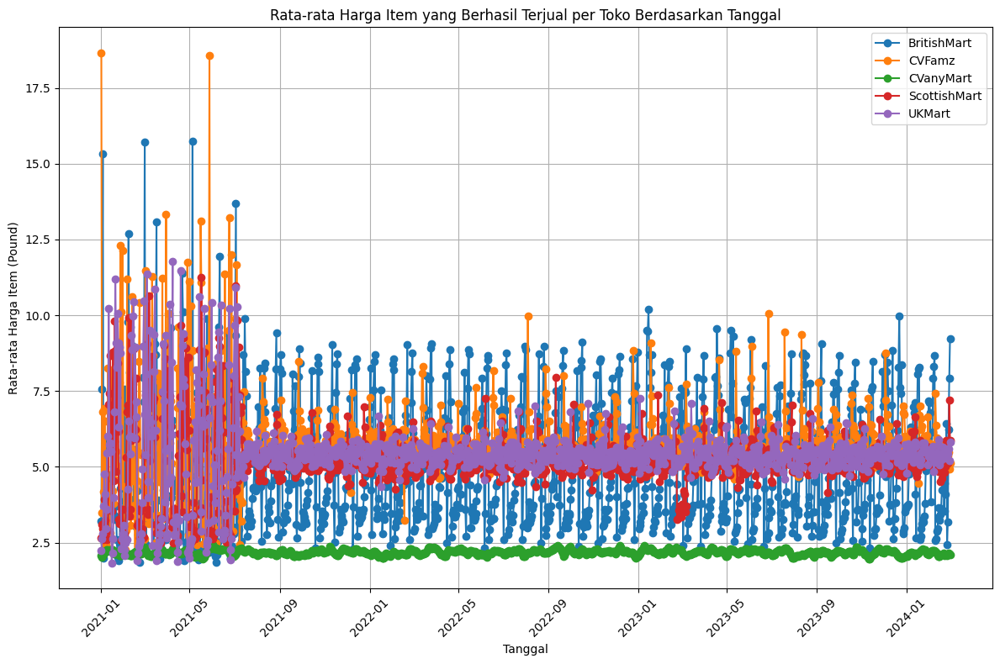

In [ ]:
# Kelompokkan data berdasarkan toko dan tanggal, lalu terapkan fungsi agregasi untuk menghitung rata-rata harga beli
rata_harga_per_toko = all_data.groupby(['nama_toko', 'tanggal'])['harga_pound'].mean().reset_index()

# Plot
plt.figure(figsize=(12, 8))
for toko in rata_harga_per_toko['nama_toko'].unique():
    data_toko = rata_harga_per_toko[rata_harga_per_toko['nama_toko'] == toko]
    plt.plot(data_toko['tanggal'], data_toko['harga_pound'], marker='o', label=toko)

plt.title('Rata-rata Harga Item yang Berhasil Terjual per Toko Berdasarkan Tanggal')
plt.xlabel('Tanggal')
plt.ylabel('Rata-rata Harga Item (Pound)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Analisis rata-rata harga item yang berhasil terjual per toko berdasarkan tanggal memberikan gambaran tentang tren harga, pola musiman, dan perbandingan harga antar toko.

Rata-rata harga item yang berhasil terjual bervariasi antar toko. namun toko CVFamz dan UKMart memiliki harga rata-rata yang lebih tinggi dibandingkan dengan toko lain.

Dari visualisasi dapat terlihat dari rentang 2021-01 sampai 2021-09 toko CVFamz berhasil menjual barang dengan rata-rata membeli item dengan yang cukup tinggi.

Tren harga rata-rata berbeda-beda untuk setiap toko. Beberapa toko mengalami fluktuasi harga yang signifikan sepanjang waktu, sementara toko lain menunjukkan harga yang lebih stabil.

#### Estimated Daily Income

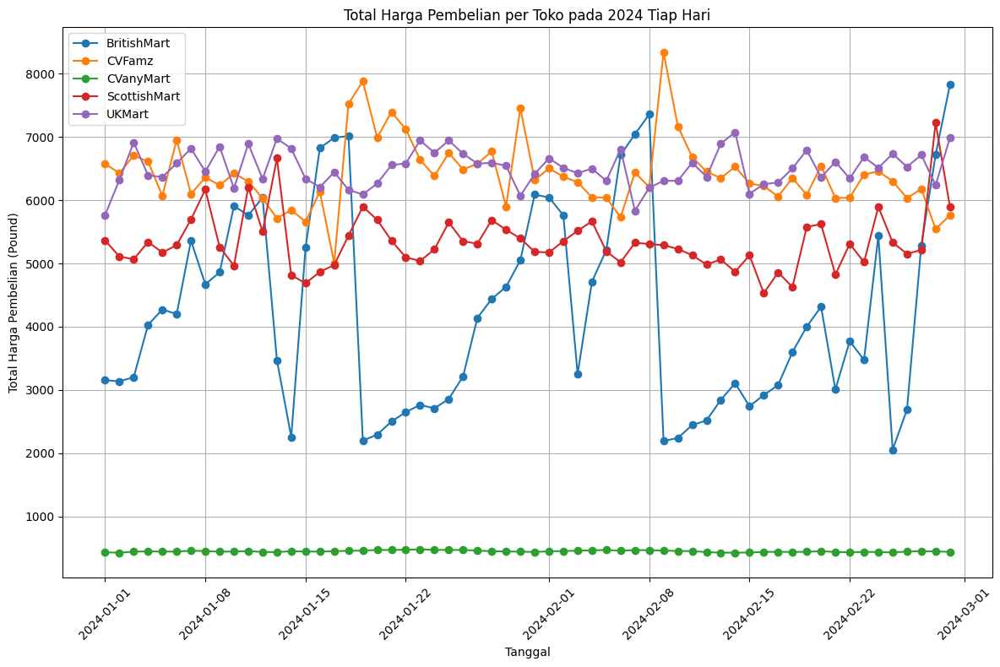

In [ ]:
# Kelompokkan data berdasarkan toko dan tanggal, lalu terapkan fungsi agregasi untuk menghitung total harga pembelian
total_harga_per_toko = all_data.groupby(['nama_toko', 'tanggal'])['harga_pound'].sum().reset_index()

# Filter data hanya untuk 2024
total_harga_per_toko['tanggal'] = pd.to_datetime(total_harga_per_toko['tanggal'])  # Konversi kolom tanggal ke tipe datetime
filtered_data = total_harga_per_toko[(total_harga_per_toko['tanggal'].dt.year == 2024)]

# Plot
plt.figure(figsize=(12, 8))
for toko in filtered_data['nama_toko'].unique():
    data_toko = filtered_data[filtered_data['nama_toko'] == toko]
    plt.plot(data_toko['tanggal'], data_toko['harga_pound'], marker='o', label=toko)

plt.title('Total Harga Pembelian per Toko pada 2024 Tiap Hari')
plt.xlabel('Tanggal')
plt.ylabel('Total Harga Pembelian (Pound)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


Visualisasi Line Chart untuk tahun 2024 hingga Maret menunjukkan tren harga pembelian pada 5 toko. Pada 15 Januari 2024, CVFamz mencatat harga pembelian tertinggi lebih dari 8.000 pound. Harga pembelian terendah dilakukan oleh CVanyhMart, diperkirakan kurang dari 1.000 pound.

#### Input

In [ ]:
#ststis
tahun = 2023
bulan = 3
print ("Tahun : ",tahun)
print ("Bulan : ",bulan)

#dinamis
# tahun = int(input("Masukkan tahun (contoh: 2022): "))
# bulan = int(input("Masukkan bulan (1-12): "))

Tahun :  2023
Bulan :  3


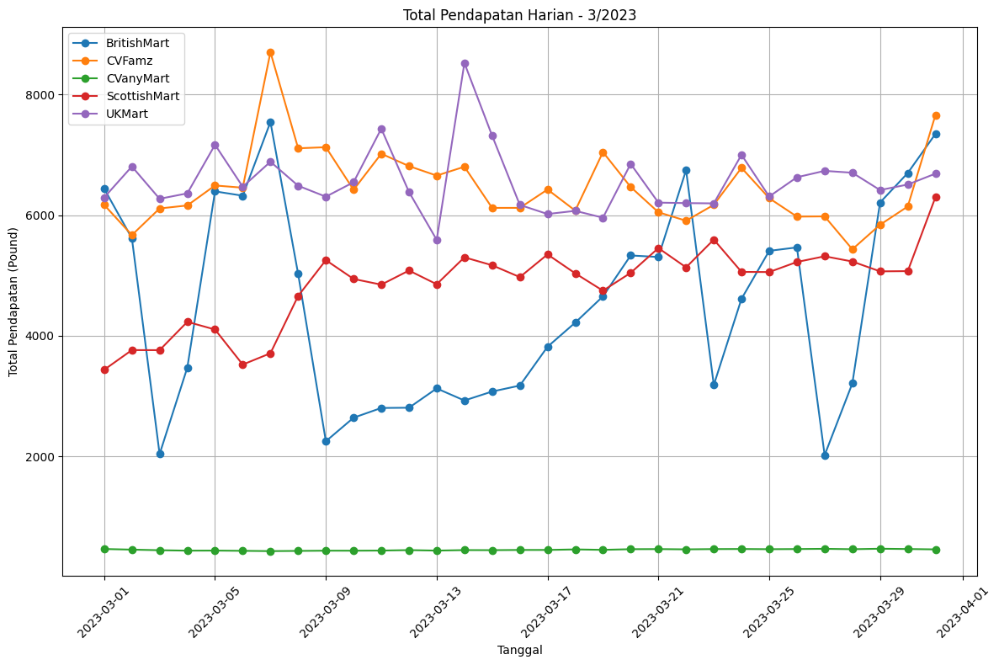

In [ ]:
# Ubah kolom 'tanggal' menjadi tipe datetime
all_data['tanggal'] = pd.to_datetime(all_data['tanggal'])

# Filter data berdasarkan bulan dan tahun
data_filtered = all_data[(all_data['tanggal'].dt.year == tahun) & (all_data['tanggal'].dt.month == bulan)]

# Kelompokkan data berdasarkan tanggal dan nama toko, lalu hitung total pendapatan harian untuk setiap toko
total_pendapatan_harian_per_toko = data_filtered.groupby(['tanggal', 'nama_toko'])['harga_pound'].sum().reset_index()

# Pisahkan data berdasarkan nama toko
data_per_toko = {}

for toko in total_pendapatan_harian_per_toko['nama_toko'].unique():
    data_per_toko[toko] = total_pendapatan_harian_per_toko[total_pendapatan_harian_per_toko['nama_toko'] == toko]

# Plot total pendapatan harian untuk kelima toko dalam satu plot
plt.figure(figsize=(12, 8))

for toko in data_per_toko:
    plt.plot(data_per_toko[toko]['tanggal'], data_per_toko[toko]['harga_pound'], marker='o', linestyle='-', label=toko)

plt.title(f'Total Pendapatan Harian - {bulan}/{tahun}')
plt.xlabel('Tanggal')
plt.ylabel('Total Pendapatan (Pound)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Dari hasil visualisasi terlihat BritishMart,CVFamz, ScottishMart,dan UKMart setiap bulannya mengalami fluktuasi sedangkan CVanyMart setiap bulannya terlihat stabil dibawah 2000

### Monthly

#### Estimated Monthly Income

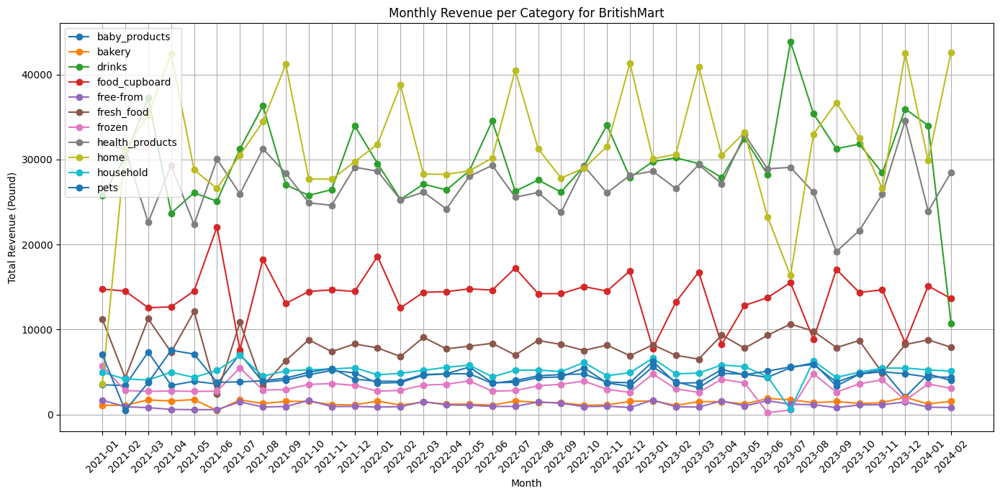

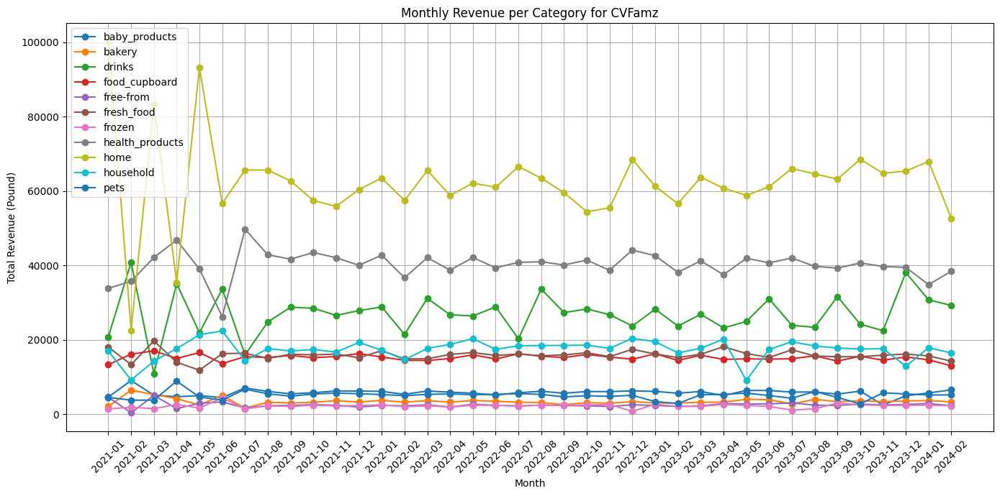

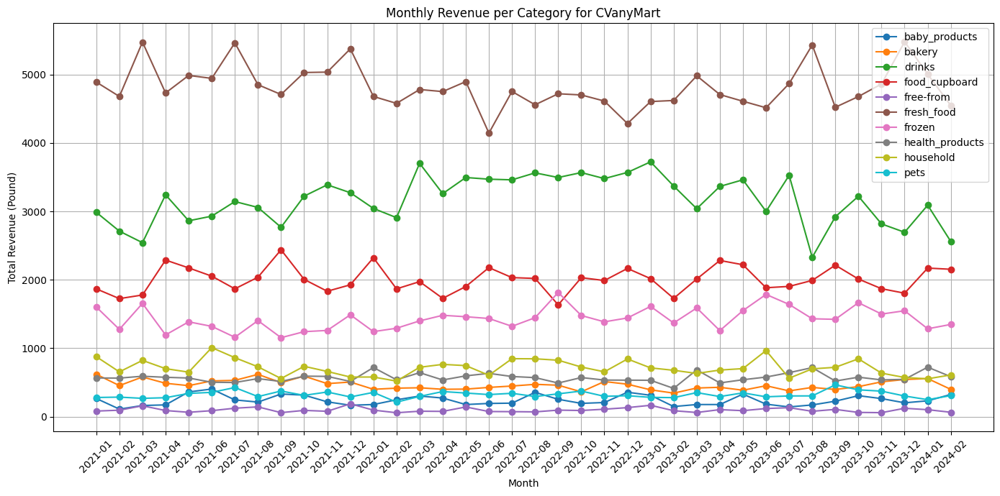

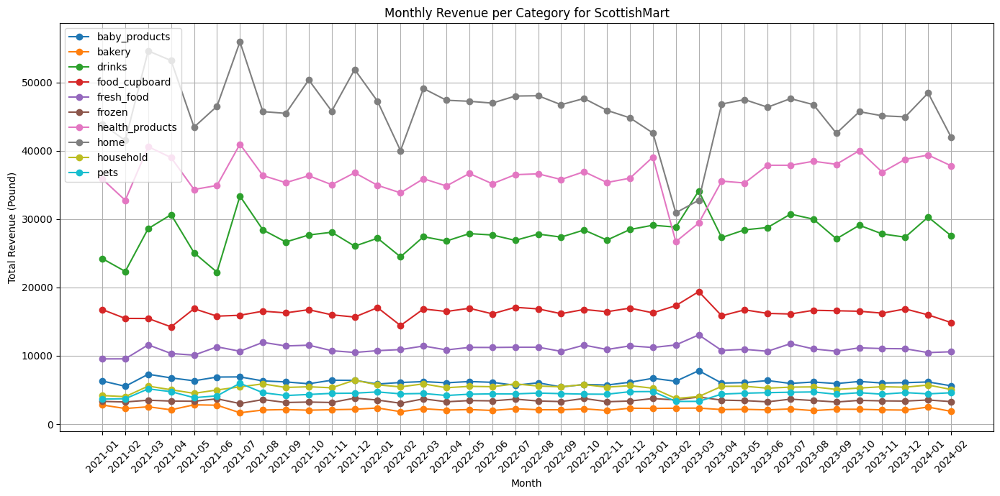

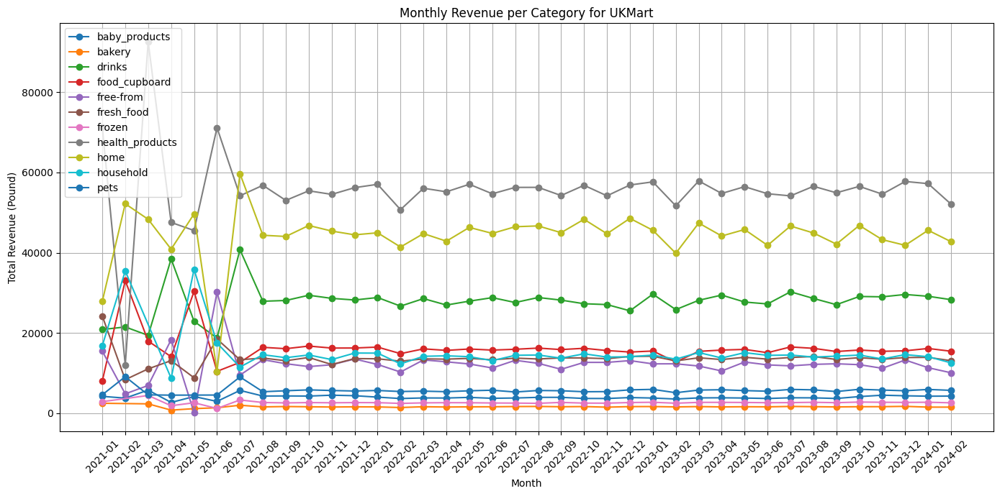

In [ ]:
import matplotlib.pyplot as plt

# Convert 'tanggal' to datetime format
all_data['tanggal'] = pd.to_datetime(all_data['tanggal'], format='%Y-%m-%d')

# Extract year and month from 'tanggal'
all_data['year_month'] = all_data['tanggal'].dt.to_period('M')

# Group by store, category, and year_month and sum the 'harga_pound'
monthly_revenue = all_data.groupby(['nama_toko', 'kategori', 'year_month'])['harga_pound'].sum().reset_index()

# Function to plot line charts
def plot_revenue(data, store_name):
    plt.figure(figsize=(14, 7))
    for category in data['kategori'].unique():
        category_data = data[data['kategori'] == category]
        plt.plot(category_data['year_month'].astype(str), category_data['harga_pound'], marker='o', label=category)
    plt.title(f'Monthly Revenue per Category for {store_name}')
    plt.xlabel('Month')
    plt.ylabel('Total Revenue (Pound)')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each store
for store in monthly_revenue['nama_toko'].unique():
    store_data = monthly_revenue[monthly_revenue['nama_toko'] == store]
    plot_revenue(store_data, store)


Dari hasil linechart total pembelian tiap bulan perkategori ditiap toko ditemukan pada bulan tertentu terdapat lonjakan yang signifikan. hal tersebut bisa terjadi dikarenakan ada event tertentu yang membuat kebutuhan terhadap suatu kategori barang meningkat. contohnya pada bulan **8-2022** pada kategori **drink** tiap toko mengalami peningkatan penjualan hal ini dikarenakan pada bulan **8-2022** wilayah UK mengalami **musim panas**, pada bulan **3-2023** juga mengalami kenaikan penjualan kategori **drink dan foof_cupboard** dikarenakan sedang berlangsungnya pekan olahraga **ALL ENGLAND** yang berlangsung antara tanggal 14-19 maret

#### Monthly Stock

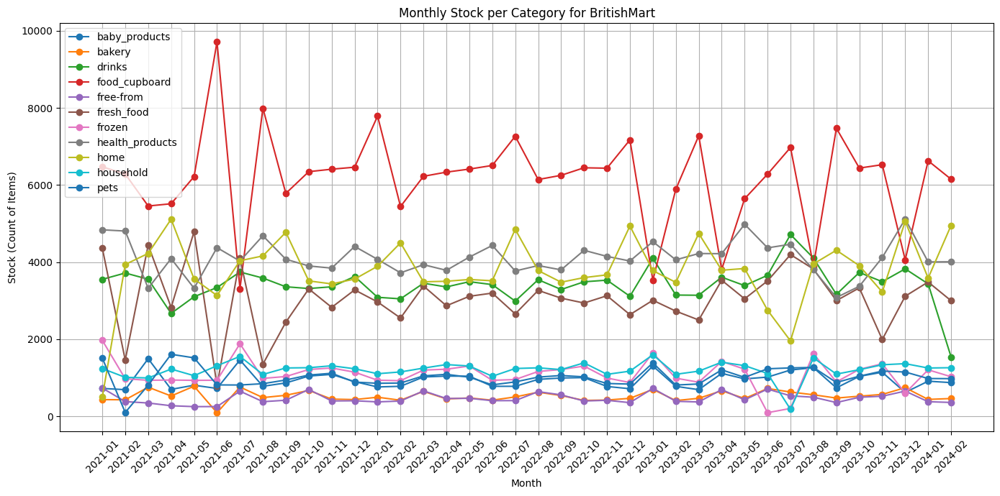

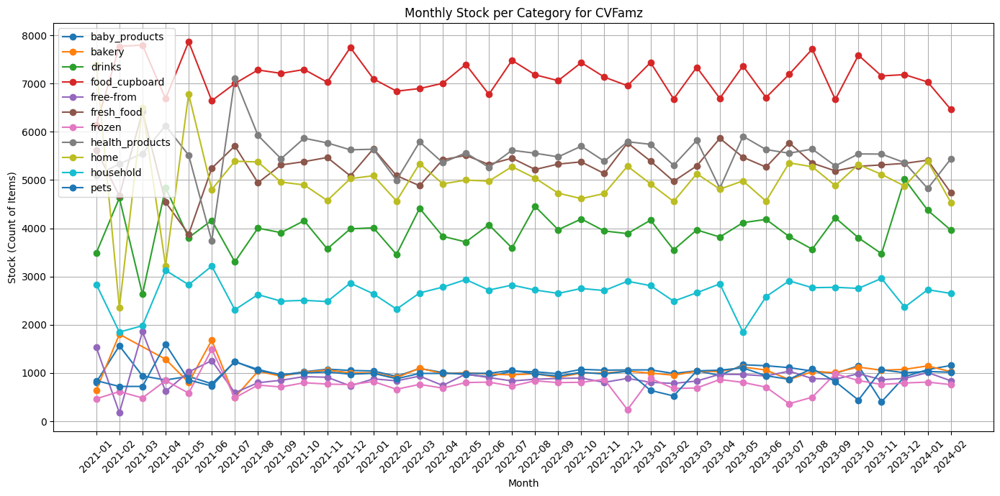

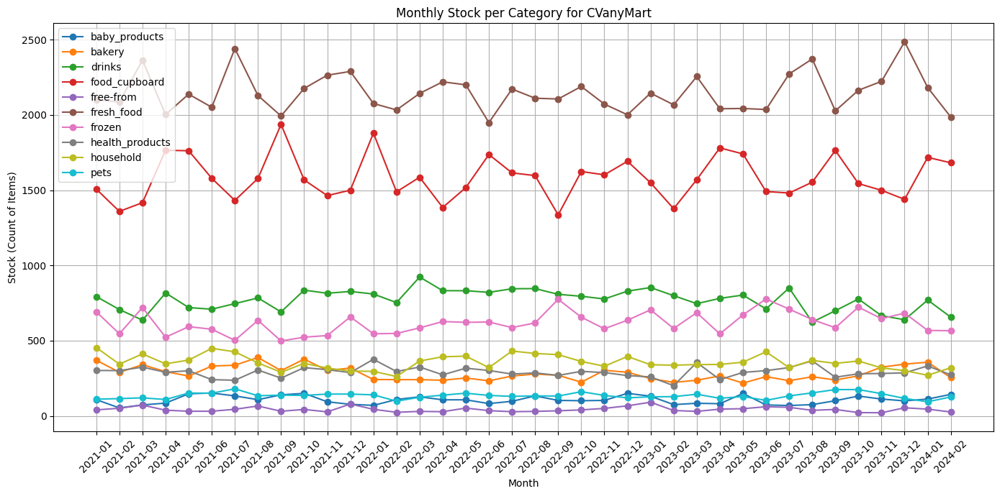

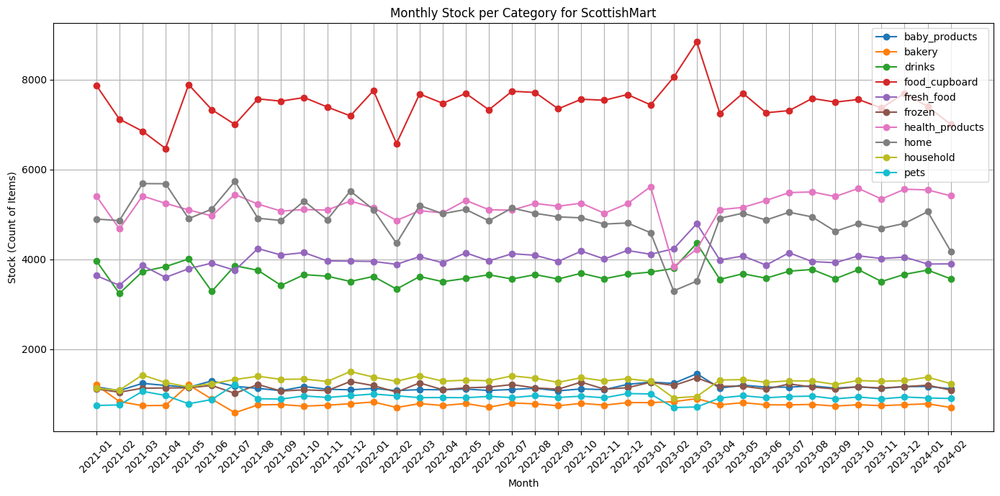

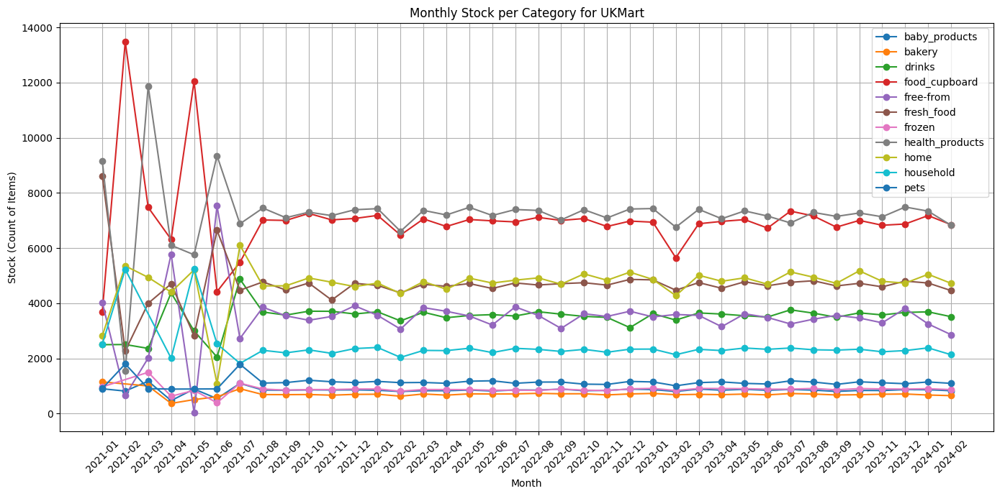

In [ ]:
# Convert 'tanggal' to datetime format
all_data['tanggal'] = pd.to_datetime(all_data['tanggal'], format='%Y-%m-%d')

# Extract year and month from 'tanggal'
all_data['year_month'] = all_data['tanggal'].dt.to_period('M')

# Group by store, category, and year_month and count the occurrences of 'nama'
monthly_stock = all_data.groupby(['nama_toko', 'kategori', 'year_month'])['nama'].count().reset_index(name='stock')

# Function to plot line charts
def plot_stock(data, store_name):
    plt.figure(figsize=(14, 7))
    for category in data['kategori'].unique():
        category_data = data[data['kategori'] == category]
        plt.plot(category_data['year_month'].astype(str), category_data['stock'], marker='o', label=category)
    plt.title(f'Monthly Stock per Category for {store_name}')
    plt.xlabel('Month')
    plt.ylabel('Stock (Count of Items)')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each store
for store in monthly_stock['nama_toko'].unique():
    store_data = monthly_stock[monthly_stock['nama_toko'] == store]
    plot_stock(store_data, store)

Trend yang terjadi
* Pada tahun 2021 terjadi panic buying dikarenakan covid-19 sehingga meningkatnya permintaan pasar
* Adanya kenaikan atau penurunan stock food_cupboard dibulan bulan tertentu, misalnya pada saat natal/holiday dibulan desember yang kemudian turun dibulan januari.
* Adanya event khusus seperti All England merupakan turnamen bulutangkis  pada tanggal 14–19 Maret membuat permintaan akan food_cupboard & drink meningkat

#### Estimated Total Monthly Income From 2021 to 2024

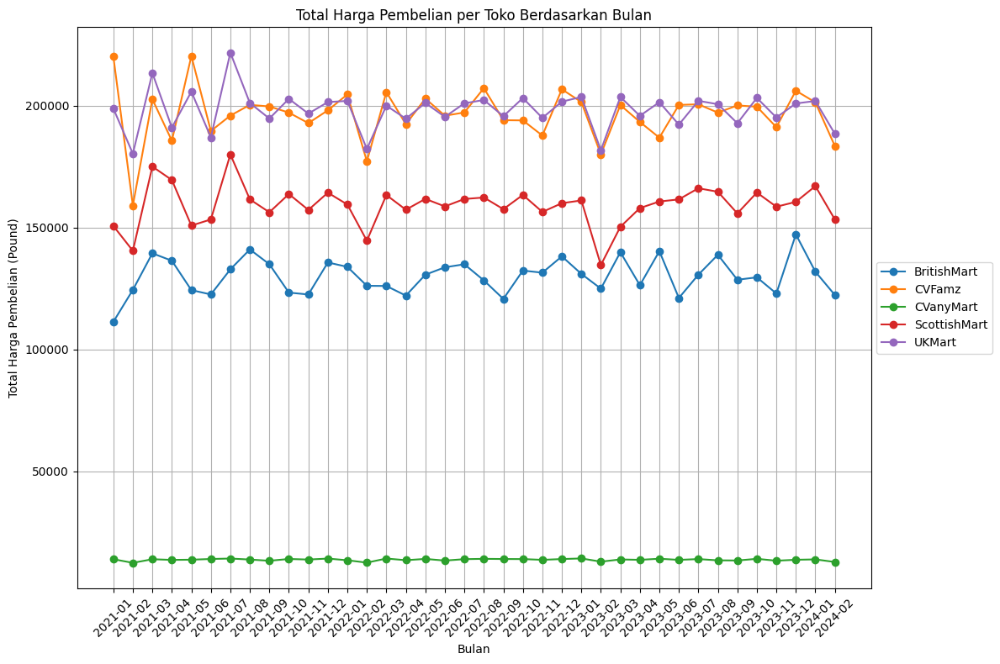

In [ ]:
import matplotlib.pyplot as plt

# Kelompokkan data berdasarkan toko dan bulan, lalu terapkan fungsi agregasi untuk menghitung total harga pembelian
total_harga_per_toko_bulanan = all_data.groupby(['nama_toko', all_data['tanggal'].dt.to_period('M')])['harga_pound'].sum().reset_index()

# Ubah nama kolom tanggal menjadi 'bulan' dan ubah objek Period menjadi string
total_harga_per_toko_bulanan.rename(columns={'tanggal': 'bulan'}, inplace=True)
total_harga_per_toko_bulanan['bulan'] = total_harga_per_toko_bulanan['bulan'].astype(str)

# Plot untuk setiap toko
plt.figure(figsize=(12, 8))
for toko in total_harga_per_toko_bulanan['nama_toko'].unique():
    data_toko = total_harga_per_toko_bulanan[total_harga_per_toko_bulanan['nama_toko'] == toko]
    plt.plot(data_toko['bulan'], data_toko['harga_pound'], marker='o', label=toko)

plt.title('Total Harga Pembelian per Toko Berdasarkan Bulan')
plt.xlabel('Bulan')
plt.ylabel('Total Harga Pembelian (Pound)')
plt.xticks(rotation=45)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid(True)
plt.tight_layout()
plt.show()

  - BritishMart:

    BritishMart mengalami peningkatan total harga pembelian yang signifikan pada bulan Desember 2023, mencapai puncaknya pada bulan Desember 2023 dengan total harga pembelian sekitar 150.000 pound.

  - CVFamz:

  CVFamz mengalami peningkatan total harga pembelian yang signifikan pada bulan Mei 2021, mencapai puncaknya pada bulan Mei 2021 dengan total harga pembelian Lebih dari 200.000 pound.

  - ScottishMart:

  ScottishMart mengalami penurunan total harga pembelian pada bulan Februari 2023, mencapai titik terendah pada bulan februari 2023 dengan total harga pembelian sekitar 130.000 pound.

  - UKMart:

  UKMart mengalami Kenaikan total harga pembelian pada bulan Juli 2021, mencapai titik tertinggi pada bulan Juli 2021 dengan total harga pembelian sekitar 220.000 pound.

  - CVanyMart:

  CVanyMart mengalami fluktuasi total harga pembelian yang tidak signifikan.
  Total harga pembelian CVanyMart relatif stabil selama periode yang ditunjukkan dalam grafik.

#### Total Monthly Stock From 2021 to 2024

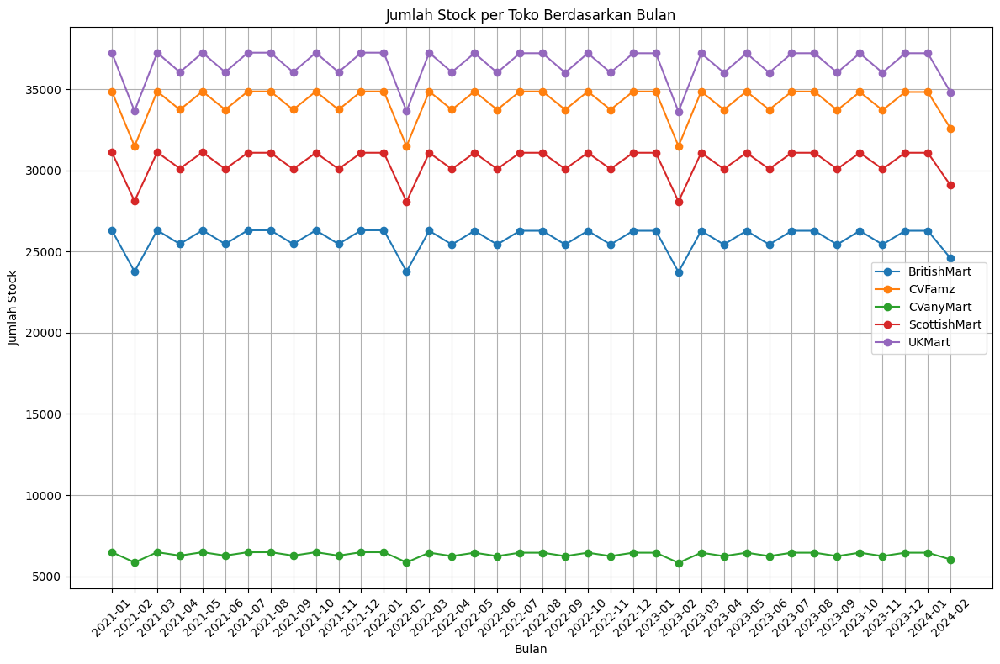

In [ ]:
# Konversi kolom 'tanggal' menjadi tipe data datetime
all_data['tanggal'] = pd.to_datetime(all_data['tanggal'])

# Kelompokkan data berdasarkan toko dan bulan, lalu terapkan fungsi agregasi untuk menghitung jumlah stock
jumlah_stock_per_toko_bulanan = all_data.groupby(['nama_toko', all_data['tanggal'].dt.to_period('M')]).size().reset_index(name='jumlah_stock')

# Ubah nama kolom tanggal menjadi 'bulan' dan ubah objek Period menjadi string
jumlah_stock_per_toko_bulanan.rename(columns={'tanggal': 'bulan'}, inplace=True)
jumlah_stock_per_toko_bulanan['bulan'] = jumlah_stock_per_toko_bulanan['bulan'].astype(str)

# Plot untuk setiap toko
plt.figure(figsize=(12, 8))
for toko in jumlah_stock_per_toko_bulanan['nama_toko'].unique():
    data_toko = jumlah_stock_per_toko_bulanan[jumlah_stock_per_toko_bulanan['nama_toko'] == toko]
    plt.plot(data_toko['bulan'], data_toko['jumlah_stock'], marker='o', label=toko)

plt.title('Jumlah Stock per Toko Berdasarkan Bulan')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Stock')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Visualisasi menunjukkan tren pembelian bulanan yang berbeda untuk setiap toko berdasarkan stock yang tersedia. Beberapa toko seperti BritishMart, ScottishMart, CVFamz, dan UKMart mengalami fluktuasi pembelian diatas 20.000 sepanjang tahun, sementara toko CVanyMart menunjukkan pola pembelian diatas 5000 namun lebih stabil.

Setiap toko mengalami peningkatan pembelian pada bulan-bulan tertentu, seperti pada bulan Desember (mungkin karena musim liburan). Dan Setiap toko mengalami penurunan yang banyak setiap bulan februari

Toko UKMart memiliki jumlah pembelian yang lebih tinggi secara keseluruhan dibandingkan dengan toko lain.

#### Monthly Average Price Per Category

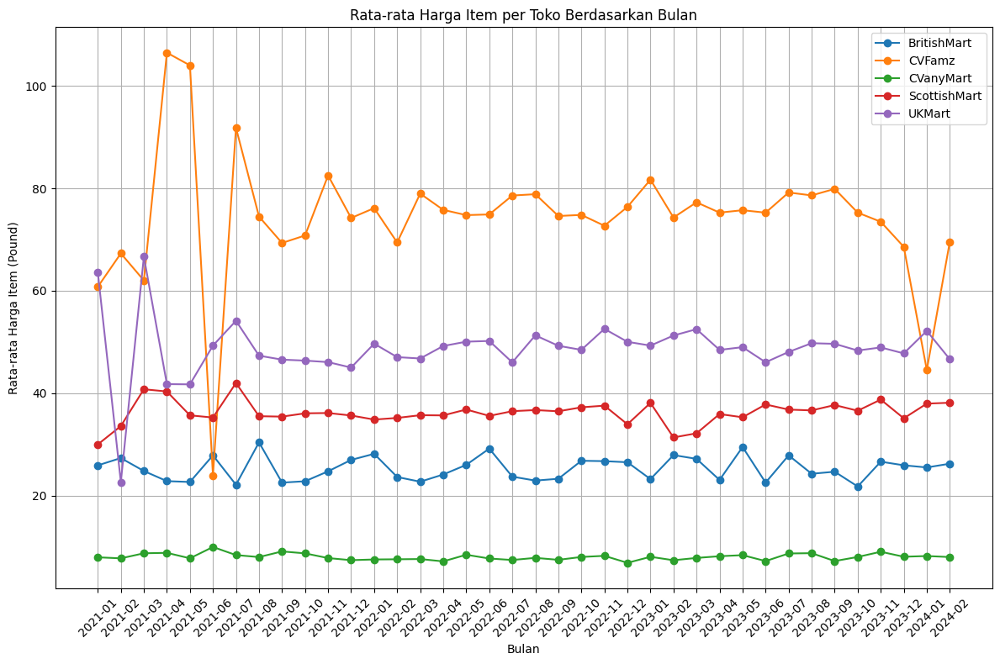

In [ ]:
# Kelompokkan data berdasarkan toko dan bulan, lalu terapkan fungsi agregasi untuk menghitung rata-rata harga pembelian
rata_harga_per_toko_bulanan = all_data.groupby(['nama_toko', all_data['tanggal'].dt.to_period('M')])['harga_per_unit'].mean().reset_index()

# Ubah nama kolom tanggal menjadi 'bulan' dan ubah objek Period menjadi string
rata_harga_per_toko_bulanan.rename(columns={'tanggal': 'bulan'}, inplace=True)
rata_harga_per_toko_bulanan['bulan'] = rata_harga_per_toko_bulanan['bulan'].astype(str)

# Plot untuk setiap toko
plt.figure(figsize=(12, 8))
for toko in rata_harga_per_toko_bulanan['nama_toko'].unique():
    data_toko = rata_harga_per_toko_bulanan[rata_harga_per_toko_bulanan['nama_toko'] == toko]
    plt.plot(data_toko['bulan'], data_toko['harga_per_unit'], marker='o', label=toko)

plt.title('Rata-rata Harga Item per Toko Berdasarkan Bulan')
plt.xlabel('Bulan')
plt.ylabel('Rata-rata Harga Item (Pound)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Analisis rata-rata harga item yang berhasil terjual per toko berdasarkan tanggal memberikan gambaran tentang tren harga, pola musiman, dan perbandingan harga antar toko.

Dari hasil visualisasi diperoleh informasi:

BritishMart
> Toko BritishMart memiliki Harga rata-rata relatif stabil dengan sedikit fluktuasi sepanjang tahun.

CVFamz
> Harga rata-rata mengalami kenaikan yang signifikan pada 2021-03 dan mengalamai penurunan yang signifikan pada 2021-05. CVFamz memiliki harga rata-rata tertinggi di antara semua toko secara keseluruhan.

CVanyMart:
> Harga rata-rata stabil secara keseluruhan. mengalami sedikit kenaikan harga rata-rata dibulan mei 2021. Memiliki harga rata-rata terendah di antara semua toko secara keseluruhan.

ScottishMart:
> Harga rata-rata mengalami tren kenaikan secara keseluruhan dari Januari hingga juli 2021 dan mengalami penurunan yang banyak di rentang januari - februari 2023. Harga rata-rata relatif stabil dengan sedikit fluktuasi. Memiliki rata-rata harga lebih tinggi dari CVanyMart dan BritishMart, tetapi lebih rendah dari CVFamz dan UKMart

UKMart:
> Harga rata-rata mengalami tren kenaikan secara keseluruhan. Penurunan harga rata-rata sangat signifikan pada 2021-02 dan mengalami kenaikai sangat signifikan pada 03-2021. Memiliki harga rata-rata yang lebih tinggi dibandingkan dengan BritishMart, ScottishMart, dan CVanyMart, tetapi lebih rendah dibandingkan dengan CVFamz.

# Feature Engineering

In [ ]:
# Kelompokkan data berdasarkan nama barang dan berikan ID unik
grouped_data = all_data.groupby('nama')

# Buat kolom 'id_barang' dengan ID unik untuk setiap kelompok barang
id_barang = grouped_data.ngroup()

# Tambahkan kolom 'id_barang' ke DataFrame asli
all_data.insert(0, 'id_barang', id_barang)

# Tampilkan lima baris pertama DataFrame yang telah ditambahkan kolom 'id_barang'
all_data.head()

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month
0,6551,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01,2021-01
1,6456,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01,2021-01
2,114177,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01,2021-01
3,6589,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01,2021-01
4,114163,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01,2021-01


mengelompokkan data berdasarkan nama barang menggunakan metode groupby() pada kolom 'nama' dalam DataFrame all_data. Kemudian, kode tersebut memberikan ID unik untuk setiap kelompok barang dengan menggunakan metode ngroup(). Selanjutnya, kolom 'id_barang' yang berisi ID unik tersebut ditambahkan ke DataFrame asli menggunakan metode insert().

In [ ]:
# Membuat kolom baru 'stock_dibeli'
all_data['stock_dibeli'] = all_data['harga_pound'] / all_data['harga_per_unit']

# Mengubah jumlah desimal 'stock_dibeli' menjadi tiga angka dibelakang koma
all_data['stock_dibeli'] = all_data['stock_dibeli'].round(3)

# Menampilkan DataFrame setelah penambahan kolom baru
all_data

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli
0,6551,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01,2021-01,1.000
1,6456,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01,2021-01,1.000
2,114177,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01,2021-01,1.429
3,6589,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01,2021-01,1.000
4,114163,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01,2021-01,1.429
...,...,...,...,...,...,...,...,...,...,...,...
5065974,47532,UKMart,2.70,14.21,kg,Jarlsberg Original 190g,fresh_food,False,2022-04-30,2022-04,0.190
5065975,89645,UKMart,3.00,5.00,kg,Sainsbury's Moroccan Spiced Chicken & Chickpea...,fresh_food,True,2022-05-01,2022-05,0.600
5065976,37338,UKMart,1.25,5.50,kg,"Ginsters Cornish Pasty, 227g",fresh_food,False,2022-05-02,2022-05,0.227
5065977,85296,UKMart,3.00,30.00,kg,"Sainsbury's British Corned Beef Slices, Taste ...",fresh_food,True,2022-05-03,2022-05,0.100



membuat kolom baru bernama 'stock_dibeli' dalam DataFrame all_data. Nilai dalam kolom ini dihasilkan dengan membagi nilai dalam kolom 'harga_pound' dengan nilai dalam kolom 'harga_per_unit'. Selanjutnya, jumlah desimal dalam kolom 'stock_dibeli' diubah menjadi tiga angka dibelakang koma menggunakan metode round(3).

In [ ]:
# Menggabungkan isi kolom 'unit' dan 'stock_dibeli' menjadi satu kolom baru 'unit_stock'
all_data['unit_stock'] = all_data['stock_dibeli'].astype(str) + all_data['unit']

# Menampilkan DataFrame setelah penambahan kolom baru
all_data

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
0,6551,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l
1,6456,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l
2,114177,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01,2021-01,1.429,1.429l
3,6589,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l
4,114163,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01,2021-01,1.429,1.429l
...,...,...,...,...,...,...,...,...,...,...,...,...
5065974,47532,UKMart,2.70,14.21,kg,Jarlsberg Original 190g,fresh_food,False,2022-04-30,2022-04,0.190,0.19kg
5065975,89645,UKMart,3.00,5.00,kg,Sainsbury's Moroccan Spiced Chicken & Chickpea...,fresh_food,True,2022-05-01,2022-05,0.600,0.6kg
5065976,37338,UKMart,1.25,5.50,kg,"Ginsters Cornish Pasty, 227g",fresh_food,False,2022-05-02,2022-05,0.227,0.227kg
5065977,85296,UKMart,3.00,30.00,kg,"Sainsbury's British Corned Beef Slices, Taste ...",fresh_food,True,2022-05-03,2022-05,0.100,0.1kg


menggabungkan isi kolom 'unit' dan 'stock_dibeli' menjadi satu kolom baru bernama 'unit_stock' dalam DataFrame all_data. Untuk melakukan ini, nilai dalam kolom 'stock_dibeli' dikonversi menjadi tipe data string menggunakan metode astype(str), kemudian kedua kolom tersebut digabungkan menggunakan operator penggabungan string '+'. Hasil penggabungan tersebut disimpan dalam kolom 'unit_stock'.

In [ ]:
# Mengurutkan dataset df_le dari nilai terbesar ke terkecil berdasarkan kolom tertentu
sorted_all_data = all_data.sort_values(by='stock_dibeli', ascending=False)
# Ganti 'nama_kolom' dengan nama kolom yang ingin Anda urutkan.
sorted_all_data

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
3481979,22811,ScottishMart,15.50,0.0,unit,Cushelle Quilted Toilet Tissue 24 rolls,household,False,2023-08-18,2023-08,inf,infunit
3654704,22803,ScottishMart,9.95,0.0,unit,Cushelle Quilted 50% Longer Lasting Toilet Tis...,household,False,2024-02-06,2024-02,inf,infunit
2943869,22813,ScottishMart,6.00,0.0,unit,Cushelle Quilted Tubeless 50% Longer Toilet Ti...,household,False,2022-02-27,2022-02,inf,infunit
1936413,22924,CVFamz,1.50,0.0,kg,Cypressa Black Eyed Beans,food_cupboard,False,2023-05-02,2023-05,inf,infkg
3142756,113183,ScottishMart,8.50,0.0,unit,Velvet Classic Quilted Toilet Tissue 24 Rolls,household,False,2022-09-14,2022-09,inf,infunit
...,...,...,...,...,...,...,...,...,...,...,...,...
2073627,82455,CVFamz,5.50,15714.0,kg,Rimmel London Lasting Finish Automatic Lip Lin...,health_products,False,2023-09-01,2023-09,0.0,0.0kg
2073922,21068,CVFamz,3.98,19900.0,kg,Collection IncrediBrow Define+Plus Brunette 2,health_products,False,2023-09-01,2023-09,0.0,0.0kg
2074777,82642,CVFamz,4.95,14143.0,kg,Rimmel London Scandaleyes Exaggerate Eye Defin...,health_products,False,2023-09-02,2023-09,0.0,0.0kg
2074781,20977,CVFamz,3.48,13920.0,kg,Collection Fast Stroke Waterproof Gel Eye Defi...,health_products,False,2023-09-02,2023-09,0.0,0.0kg


hasil tabel memiliki nilai yang infinite(tak terhingga) dan nilai 0(nol) dikarenakan saat membuat kolom baru untuk mengetahui berapa jumlah unit/ukuran unit yang dibeli oleh costumer menggunakan rumus harga_pound/harga_per_unit terdapat data pada kolom harga_per_unit yang tidak memiliki harga atau 0(nol) sehingga muncul nilai tak terhingga

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Membuat salinan DataFrame all_data_le
df_le = all_data.copy()

# Tentukan kolom tertentu yang ingin Anda encode
selected_cols = ['nama_toko','unit','kategori'] # Ganti dengan nama kolom yang Anda inginkan

# Membuat objek LabelEncoder
le = LabelEncoder()

# Mengkodekan setiap kolom yang dipilih secara independen
for col in selected_cols:
    if col in df_le.columns:
        df_le[col] = le.fit_transform(df_le[col])

# Menampilkan lima baris pertama DataFrame yang telah diencode
df_le.head()

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
0,6551,0,1.35,1.35,1,Alpro Oat Long Life Drink,2,False,2021-01-01,2021-01,1.000,1.0l
1,6456,0,2.10,2.10,1,Alpro Almond Chilled Drink,2,False,2021-01-01,2021-01,1.000,1.0l
2,114177,0,1.00,0.70,1,Volvic Touch of Fruit Strawberr…,2,False,2021-01-01,2021-01,1.429,1.429l
3,6589,0,2.10,2.10,1,Alpro Soya Chilled Drink,2,False,2021-01-01,2021-01,1.000,1.0l
4,114163,0,1.00,0.70,1,Volvic Touch of Fruit Lemon & Lim…,2,False,2021-01-01,2021-01,1.429,1.429l


menggunakan LabelEncoder dari pustaka scikit-learn untuk mengkodekan nilai non-numerik dalam DataFrame all_data. Setiap kolom non-numerik diubah menjadi nilai numerik yang sesuai dengan label yang ditentukan oleh LabelEncoder. Hasilnya adalah DataFrame yang telah diencode, di mana nilai-nilai non-numerik telah diubah menjadi nilai-nilai numerik.

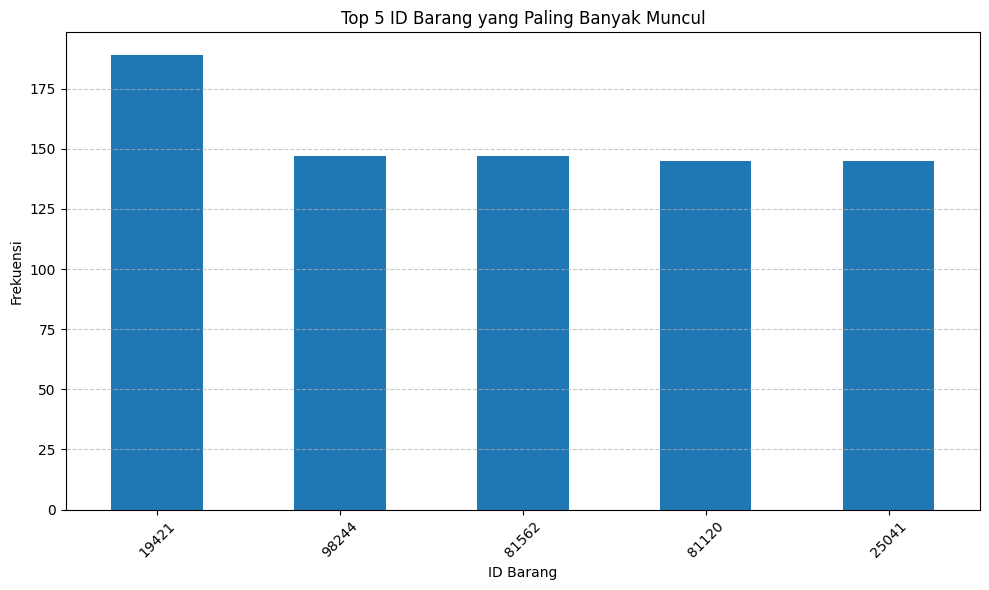

In [ ]:
# Hitung frekuensi munculnya setiap ID barang
id_barang_counts = df_le['id_barang'].value_counts()

# Ambil lima ID barang yang paling banyak muncul
top_id_barang = id_barang_counts.head(5)

# Visualisasikan dalam diagram batang
plt.figure(figsize=(10, 6))
top_id_barang.plot(kind='bar')
plt.title('Top 5 ID Barang yang Paling Banyak Muncul')
plt.xlabel('ID Barang')
plt.ylabel('Frekuensi')
plt.xticks(rotation=45)  # Rotasi label sumbu x agar lebih mudah dibaca
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Hasil visualisasi dari 5 id barang yang sering dibeli oleh pembeli pada semua toko adalah id barang 19421, 98244, 81562, 81120, 25041. dan yang paling banyak dibeli adalah id barang 19421 sebanyak +175 item

# Corelation Matrix


Matriks korelasi adalah tabel dua dimensi yang menunjukkan koefisien korelasi antara setiap pasang variabel dalam dataset. Ini adalah alat statistik yang digunakan untuk memahami hubungan antara variabel-variabel dalam suatu dataset. Setiap elemen dalam matriks korelasi adalah angka yang menunjukkan seberapa kuat hubungan linear antara dua variabel yang sesuai. Nilai korelasi berkisar dari -1 hingga 1, di mana nilai positif menunjukkan hubungan positif, nilai negatif menunjukkan hubungan negatif, dan nilai mendekati nol menunjukkan tidak adanya hubungan linear.

In [ ]:
# Pilih fitur-fitur yang ingin dimasukkan dalam matriks korelasi
selected_features = ['nama_toko','harga_pound','harga_per_unit','unit','kategori','brand_sendiri']

# Buat subset DataFrame yang hanya berisi fitur-fitur tersebut
df = df_le[selected_features]

# Hitung matriks korelasi dari subset DataFrame
correlation_matrix = df.corr()

# Tampilkan matriks korelasi subset
correlation_matrix

,nama_toko,harga_pound,harga_per_unit,unit,kategori,brand_sendiri
nama_toko,1.000000,0.003807,0.000028,-0.016914,0.020571,-0.031140
harga_pound,0.003807,1.000000,0.039073,0.300387,0.176149,-0.111968
harga_per_unit,0.000028,0.039073,1.000000,-0.033127,0.031861,-0.029465
unit,-0.016914,0.300387,-0.033127,1.000000,0.413566,0.019171
kategori,0.020571,0.176149,0.031861,0.413566,1.000000,-0.000937
brand_sendiri,-0.031140,-0.111968,-0.029465,0.019171,-0.000937,1.000000


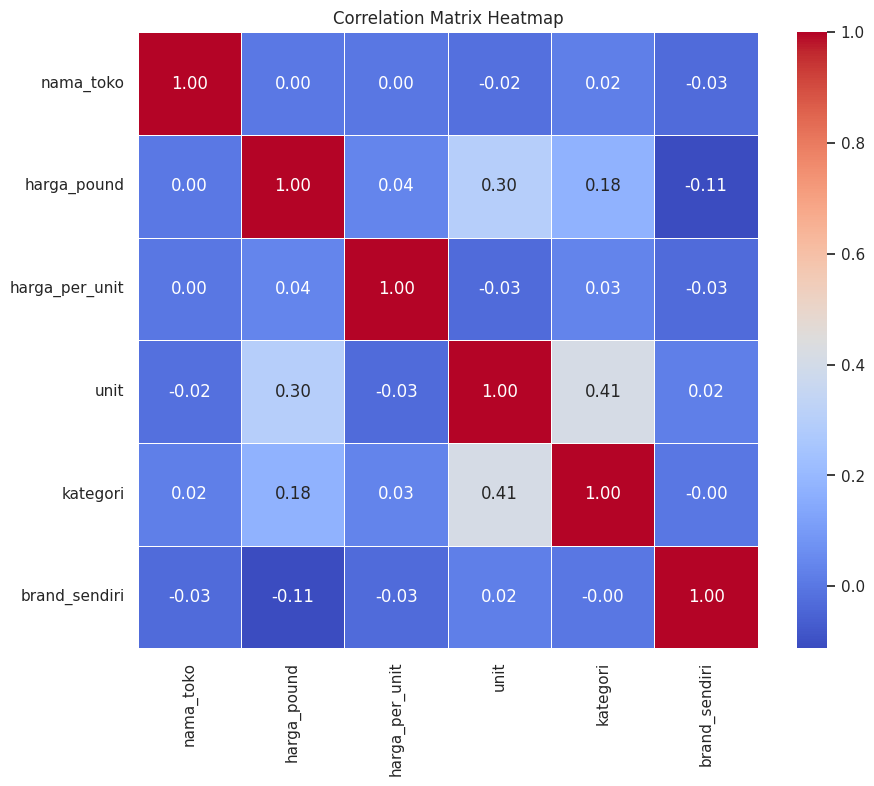

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
sns.set(style="white")

# Create heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()

Hasil visualisasi heat map corelation matrix:
* Ada korelasi positif yang lemah (0,3) antara 'harga_pound' dan 'unit', yang mungkin menunjukkan bahwa semakin tinggi harga per pound suatu produk, semakin besar pula unit yang dibeli.
* Ada korelasi yang cukup kuat (0,41) antara 'unit' dan 'kategori', yang menunjukkan bahwa jenis kategori tertentu cenderung mempengaruhi jumlah unit yang dibeli.
* Ada korelasi negatif yang lemah (-0,11) antara 'harga_pound' dan 'brand_sendiri', yang menunjukkan bahwa harga per pound mungkin berhubungan negatif dengan apakah merek tersebut adalah merek sendiri atau bukan.








In [ ]:
df_le

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
0,6551,0,1.35,1.35,1,Alpro Oat Long Life Drink,2,False,2021-01-01,2021-01,1.000,1.0l
1,6456,0,2.10,2.10,1,Alpro Almond Chilled Drink,2,False,2021-01-01,2021-01,1.000,1.0l
2,114177,0,1.00,0.70,1,Volvic Touch of Fruit Strawberr…,2,False,2021-01-01,2021-01,1.429,1.429l
3,6589,0,2.10,2.10,1,Alpro Soya Chilled Drink,2,False,2021-01-01,2021-01,1.000,1.0l
4,114163,0,1.00,0.70,1,Volvic Touch of Fruit Lemon & Lim…,2,False,2021-01-01,2021-01,1.429,1.429l
...,...,...,...,...,...,...,...,...,...,...,...,...
5065974,47532,4,2.70,14.21,0,Jarlsberg Original 190g,5,False,2022-04-30,2022-04,0.190,0.19kg
5065975,89645,4,3.00,5.00,0,Sainsbury's Moroccan Spiced Chicken & Chickpea...,5,True,2022-05-01,2022-05,0.600,0.6kg
5065976,37338,4,1.25,5.50,0,"Ginsters Cornish Pasty, 227g",5,False,2022-05-02,2022-05,0.227,0.227kg
5065977,85296,4,3.00,30.00,0,"Sainsbury's British Corned Beef Slices, Taste ...",5,True,2022-05-03,2022-05,0.100,0.1kg


# Rekomendation  System

## Content Based Filtering Recomendation

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import matplotlib.pyplot as plt

In [ ]:
# Menggabungkan semua dataset (diasumsikan all_data sudah merupakan gabungan dari semua dataset)
random_sample = all_data.copy()

In [ ]:
# Menghitung jumlah data sebelum penghapusan duplikat
initial_count = random_sample.shape[0]

# Mengidentifikasi dan menandai duplikat berdasarkan kolom 'nama', tetapi mempertahankan baris yang memiliki 'nama_toko' atau 'harga_per_unit' yang berbeda
random_sample['is_duplicate'] = random_sample.duplicated(subset=['nama', 'nama_toko', 'harga_per_unit'], keep=False)

# Menghapus duplikat hanya jika 'nama', 'nama_toko', dan 'harga_per_unit' semuanya sama
random_sample = random_sample[~(random_sample['is_duplicate'] & random_sample.duplicated(subset=['nama'], keep='first'))]

# Menghitung jumlah data setelah penghapusan duplikat
final_count = random_sample.shape[0]

# Menghitung jumlah data yang berubah
num_changed = initial_count - final_count

# Menampilkan jumlah data yang berubah
print(f"Jumlah data awal: {initial_count}")
print(f"Jumlah data setelah penghapusan duplikat: {final_count}")
print(f"Jumlah data yang berubah: {num_changed}")

random_sample.head()

Jumlah data awal: 5065718
Jumlah data setelah penghapusan duplikat: 121746
Jumlah data yang berubah: 4943972


,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock,is_duplicate
0,6551,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True
1,6456,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True
2,114177,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01,2021-01,1.429,1.429l,True
3,6589,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True
4,114163,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01,2021-01,1.429,1.429l,True


Kode ini mengidentifikasi dan menghapus baris duplikat dalam DataFrame random_sample dengan syarat tertentu. Berikut adalah langkah-langkahnya secara singkat. Menghitung jumlah baris awal. Menandai baris yang duplikat berdasarkan kombinasi kolom 'nama', 'nama_toko', dan 'harga_per_unit'. Menghapus baris yang duplikat berdasarkan kolom 'nama', tetapi hanya jika 'nama_toko' dan 'harga_per_unit' juga sama. Menghitung jumlah baris setelah penghapusan duplikat. Menghitung dan menampilkan jumlah baris yang berubah (berkurang)

In [ ]:
# Membuat kolom baru yang merupakan gabungan dari kolom "nama" dan "kategori"
random_sample.loc[:,'nama_kategori'] = random_sample['nama'] + ' - ' + random_sample['kategori']
random_sample

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock,is_duplicate,nama_kategori
0,6551,BritishMart,1.35,1.35,l,Alpro Oat Long Life Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True,Alpro Oat Long Life Drink - drinks
1,6456,BritishMart,2.10,2.10,l,Alpro Almond Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True,Alpro Almond Chilled Drink - drinks
2,114177,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Strawberr…,drinks,False,2021-01-01,2021-01,1.429,1.429l,True,Volvic Touch of Fruit Strawberr… - drinks
3,6589,BritishMart,2.10,2.10,l,Alpro Soya Chilled Drink,drinks,False,2021-01-01,2021-01,1.000,1.0l,True,Alpro Soya Chilled Drink - drinks
4,114163,BritishMart,1.00,0.70,l,Volvic Touch of Fruit Lemon & Lim…,drinks,False,2021-01-01,2021-01,1.429,1.429l,True,Volvic Touch of Fruit Lemon & Lim… - drinks
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5064740,18106,UKMart,3.50,3.50,l,Carex Original Handwash Refill Pack 1L,health_products,False,2024-02-29,2024-02,1.000,1.0l,False,Carex Original Handwash Refill Pack 1L - healt...
5064975,92769,UKMart,3.15,5.50,l,Sanex Moisturising Bath Soak 570ml,health_products,False,2024-02-29,2024-02,0.573,0.573l,False,Sanex Moisturising Bath Soak 570ml - health_pr...
5064993,86879,UKMart,2.40,6.10,kg,Sainsbury's Flourish Lentil Ragu 392g,food_cupboard,True,2024-02-29,2024-02,0.393,0.393kg,False,Sainsbury's Flourish Lentil Ragu 392g - food_c...
5065481,41178,UKMart,25.00,25.00,unit,Habitat Set of 3 Stainless Steel Refill Bottle...,home,False,2024-02-29,2024-02,1.000,1.0unit,False,Habitat Set of 3 Stainless Steel Refill Bottle...


hal ini dilakukan untuk memperkuat hasil dari sistem rekomendasi

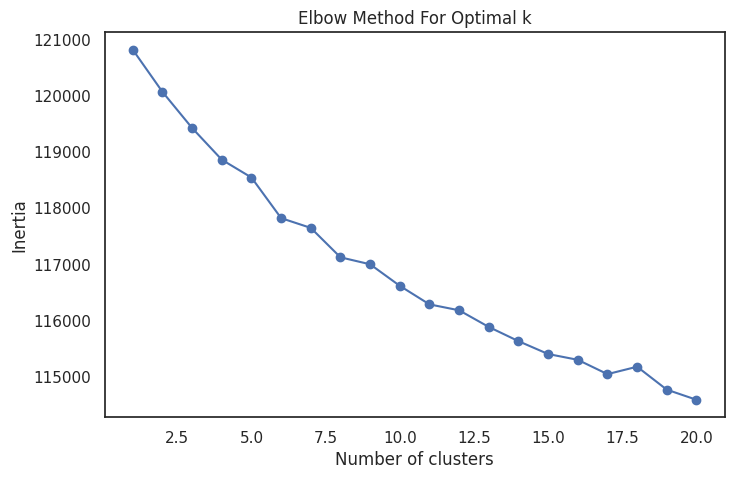

In [ ]:
def plot_elbow_method(data, max_clusters=20):
    vectorizer = TfidfVectorizer(stop_words='english')
    X = vectorizer.fit_transform(data["nama_kategori"])

    inertia = []
    for n_clusters in range(1, max_clusters + 1):
        model = KMeans(n_clusters=n_clusters, init='k-means++', random_state=42)
        model.fit(X)
        inertia.append(model.inertia_)

    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), inertia, marker='o')
    plt.title('Elbow Method For Optimal k')
    plt.xlabel('Number of clusters')
    plt.ylabel('Inertia')
    plt.show()

# Plot the Elbow Method to find the optimal number of clusters
plot_elbow_method(random_sample)

Kode ini membuat plot metode Elbow untuk menentukan jumlah klaster yang optimal dalam analisis klasterisasi. Berikut adalah langkah-langkahnya secara singkat:

1. Memproses Data: Menggunakan TfidfVectorizer untuk mengubah teks dalam kolom nama_kategori menjadi representasi vektor TF-IDF.

2. Menghitung Inertia: Melakukan klasterisasi menggunakan KMeans untuk berbagai jumlah klaster (dari 1 hingga max_clusters). Menyimpan nilai inertia (jumlah kuadrat jarak setiap titik ke pusat klasternya) untuk setiap jumlah klaster.

3. Plot Metode Elbow: Membuat plot yang menunjukkan nilai inertia terhadap jumlah klaster. Plot ini membantu menemukan titik "siku" yang menunjukkan jumlah klaster optimal.

### TF-IDF & Vektorisasi

In [ ]:
# Menggunakan TF-IDF Vectorizer dengan penghapusan stop words bahasa Inggris
vectorizer = TfidfVectorizer(stop_words='english')
X1 = vectorizer.fit_transform(random_sample["nama_kategori"])

# Convert the TF-IDF matrix to a DataFrame
tfidf_df = pd.DataFrame(X1.toarray(), columns=vectorizer.get_feature_names_out())

# Display a sample of the TF-IDF values
print("Sample TF-IDF values:")
tfidf_df.head()

Sample TF-IDF values:


,00,000,000mah,001,002,003,004,005,006,007,...,zywiecka,zzz,zzzs,älska,éclairs,épil,ísey,île,överlöde,łowicz
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


TfidfVectorizer digunakan untuk mengubah teks dalam kolom "nama_kategori" menjadi representasi vektor berbasis TF-IDF (Term Frequency-Inverse Document Frequency). Parameter stop_words='english' menginstruksikan vektorisasi untuk menghapus stop words dalam bahasa Inggris. fit_transform diterapkan pada data teks untuk menghasilkan matriks TF-IDF.

pada tabel adalah hasil dari tf-idf dari tiap suku kata dengan jumlah 24742, hasil dalam bentuk float dengan 1 angka dibelakang koma

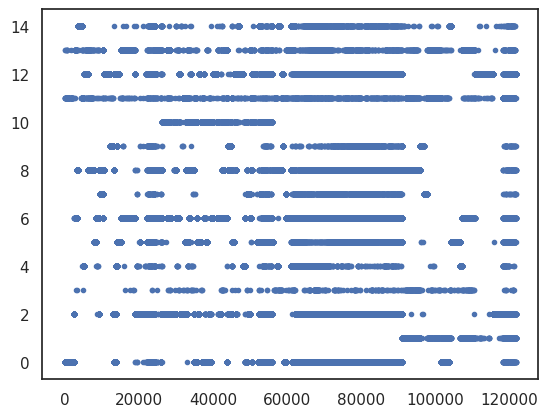

In [ ]:
# Fitting K-Means ke dataset
kmeans = KMeans(n_clusters=15, init='k-means++', random_state=42)
y_kmeans = kmeans.fit_predict(X1)

# Plot hasil klustering
plt.plot(y_kmeans, ".")
plt.show()

Fitting K-Means ke dataset, KMeans adalah algoritma klustering yang mencoba membagi data ke dalam sejumlah kluster yang telah ditentukan. fit_predict melakukan fitting model K-Means ke data TF-IDF dan mengembalikan label kluster untuk setiap data.

Output yang ditampilkan adalah persebaran cluster hasil clustering

In [ ]:
# Inisialisasi model K-Means
true_k = 15
model = KMeans(n_clusters=true_k, init='k-means++', max_iter=100, n_init=1, random_state=42)

# Fitting model ke data
model.fit(X1)

# Menampilkan top terms per cluster
print("Top terms per cluster:")
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names_out()
for i in range(true_k):
    print("Cluster %d:" % i)
    for ind in order_centroids[i, :10]:
        print(' %s' % terms[ind])
    print()

Top terms per cluster:
Cluster 0:
 heinz
 food_cupboard
 soup
 tomato
 baby_products
 sauce
 months
 400g
 nature
 baked

Cluster 1:
 george
 home
 household
 grey
 set
 mug
 cotton
 white
 sheet
 bath

Cluster 2:
 drinks
 75cl
 coffee
 beer
 drink
 water
 tea
 70cl
 lager
 500ml

Cluster 3:
 home
 nutmeg
 habitat
 sainsbury
 morrisons
 black
 set
 pack
 card
 birthday

Cluster 4:
 fresh_food
 asda
 morrisons
 sainsbury
 chicken
 cheese
 british
 extra
 400g
 yogurt

Cluster 5:
 juice
 drinks
 drink
 apple
 fruit
 orange
 fresh_food
 1l
 tropicana
 litre

Cluster 6:
 frozen
 pets
 baby_products
 bakery
 food
 dog
 chicken
 cat
 baby
 adult

Cluster 7:
 household
 washing
 washes
 air
 liquid
 toilet
 sainsbury
 candle
 freshener
 refill

Cluster 8:
 tesco
 fresh_food
 finest
 home
 food_cupboard
 pack
 bakery
 frozen
 400g
 500g

Cluster 9:
 free
 gluten
 sainsbury
 chocolate
 sugar
 organic
 flavour
 vegan
 fresh_food
 alcohol

Cluster 10:
 health_products
 hair
 oreal
 gel
 shampoo
 

menampilkan kata pada tiap cluster yang telah diclustering

Cluster 0: Produk Makanan

Cluster 1: Perlengkapan Rumah Tangga

Cluster 2: Minuman.

Cluster 3: Produk Rumah dan Hadiah

Cluster 4: Produk Segar

Cluster 5: Jus dan Minuman Ringan

Cluster 6: Produk Beku, Hewan Peliharaan, dan Bayi

Cluster 7: Pembersih Rumah Tangga

Cluster 8: Produk Segar dan Makanan Rumah Tangga

Cluster 9: Produk Kesehatan dan Diet

Cluster 10: Produk Perawatan Pribadi

Cluster 11: Bahan Makanan dan Saus

Cluster 12: Bahan Makanan

Cluster 13: Produk Segar dan Makanan Olahan.

Cluster 14: Produk Kesehatan dan Pembersih Rumah Tangga

In [ ]:
# Mendapatkan label klaster untuk setiap sampel
cluster_labels = model.predict(X1)

# Menambahkan label klaster ke DataFrame
random_sample['cluster'] = cluster_labels

menambahkan feature baru pada data yaitu feature cluster. hal ini untuk memudahkan dalam melakukan rekomendasi

In [ ]:
# Fungsi untuk menunjukkan rekomendasi produk
def show_recommendations(product):
    # Transformasi produk input ke dalam bentuk vektor
    Y = vectorizer.transform([product])
    prediction = model.predict(Y)
    cluster_id = prediction[0]

    # Filter data berdasarkan cluster_id
    cluster_data = random_sample[random_sample['cluster'] == cluster_id]

    # Mengambil TF-IDF matrix dari produk dalam klaster yang sama
    cluster_tfidf_matrix = vectorizer.transform(cluster_data['nama_kategori'])

    # Menghitung kesamaan kosinus antara produk input dan produk dalam klaster yang sama
    cosine_similarities = cosine_similarity(Y, cluster_tfidf_matrix).flatten()

    # Mengurutkan produk berdasarkan kesamaan kosinus dan mengambil 10 produk teratas
    similar_indices = cosine_similarities.argsort()[:-11:-1]
    similar_items = cluster_data.iloc[similar_indices]

    # Mengurutkan produk berdasarkan harga_per_unit terendah
    similar_items = similar_items.sort_values(by='harga_pound')

    # Menampilkan informasi produk yang direkomendasikan
    print("Produk yang direkomendasikan:")
    for idx, (index, row) in enumerate(similar_items.iterrows()):
        print("Nama Toko:", row['nama_toko'])
        print("Nama Barang:", row['nama'])
        print("Harga :", row['harga_pound'])
        print("Satuan Unit:", row['unit_stock'])
        print("Kategori:", row['kategori'])
        print("Cosine Similarity: {:.4f}".format(cosine_similarities[similar_indices[idx]]))
        print("----------------------------------")

Pada fungsi show_recomendation nama produk yang akan dicari rekomendasinya akan dilakukan vektorisasi, tfidf dan cosine similarity agar hasil rekomendasi sesuai dengan apa yang dicari.

In [ ]:
#Statis (otomatis)
product = "indomie Goreng Noodle"

#Dinamis (manual)
#product = input("Masukkan nama produk yang ingin Anda cari: ")

show_recommendations(product)

Produk yang direkomendasikan:
Nama Toko: BritishMart
Nama Barang: Indomie Instant Noodles Chicken Flavour
Harga : 0.6
Satuan Unit: 0.07kg
Kategori: food_cupboard
Cosine Similarity: 0.5172
----------------------------------
Nama Toko: ScottishMart
Nama Barang: INDOMIE INSTANT NOODLES CHICKEN FLAVOUR 70G
Harga : 0.6
Satuan Unit: 0.07kg
Kategori: food_cupboard
Cosine Similarity: 0.4637
----------------------------------
Nama Toko: BritishMart
Nama Barang: Indomie Special Chicken Instant Noodles
Harga : 0.99
Satuan Unit: 0.075kg
Kategori: food_cupboard
Cosine Similarity: 0.4571
----------------------------------
Nama Toko: CVFamz
Nama Barang: Pot Noodle King Beef & Tomato Noodle
Harga : 1.0
Satuan Unit: 0.114kg
Kategori: food_cupboard
Cosine Similarity: 0.4235
----------------------------------
Nama Toko: CVFamz
Nama Barang: Mama Mi Goreng
Harga : 1.1
Satuan Unit: 0.08kg
Kategori: food_cupboard
Cosine Similarity: 0.3935
----------------------------------
Nama Toko: BritishMart
Nama Barang:

hasil dari rekomendasi contenst based filtering adalah hasil dari tf-idf dan vektoriasi yang kemudian product yang dicari akan dilakukan perhitungan cosine similarity untuk melihat kesamaan konten nama barang atau kesamaan kata dari barang. nilai cosine similarity berada diantara 1 dan 0 semakin dekat dengan angka 1 maka semakin mirip kata atau konten yang direkomendasikan

## Another Recomendation

In [ ]:
import pandas as pd
from tabulate import tabulate
import random

combined_df = all_data.copy()

# Fungsi rekomendasi produk berdasarkan penjualan tertinggi
def recommend_top_selling_products(combined_df, top_n=10):
    top_selling_products = combined_df.groupby('nama').agg({'harga_pound': 'sum'}).reset_index()
    top_selling_products = top_selling_products.sort_values(by='harga_pound', ascending=False)
    top_selling_products = top_selling_products.merge(combined_df[['nama', 'nama_toko', 'unit', 'kategori']], on='nama').drop_duplicates(subset=['nama', 'nama_toko'])
    return top_selling_products.head(top_n)

# Fungsi rekomendasi produk berdasarkan harga terbaik
def recommend_best_priced_products(combined_df, top_n=10):
    average_price_per_unit = combined_df['harga_pound'].mean()
    best_priced_products = combined_df[combined_df['harga_pound'] < average_price_per_unit]
    best_priced_products = best_priced_products.drop_duplicates(subset=['nama']).sort_values(by='harga_pound')
    return best_priced_products[['nama', 'harga_pound', 'nama_toko', 'kategori', 'brand_sendiri']].head(top_n)

# Fungsi rekomendasi produk berdasarkan kombinasi penjualan dan harga terbaik
def recommend_combined_products(combined_df, top_n=10):
    combined_df['total_sales'] = combined_df['harga_pound']
    combined_df['sales_price_score'] = combined_df['total_sales'] / combined_df['harga_pound']
    best_combined_products = combined_df.sort_values(by='sales_price_score', descending=False).drop_duplicates(subset=['nama'])
    return best_combined_products[['nama', 'harga_pound', 'nama_toko', 'kategori']].head(top_n)

# Fungsi rekomendasi produk berdasarkan kategori terpopuler
def recommend_cheapest_products_by_category(combined_df):
    unique_categories = combined_df['kategori'].unique()
    print("\nKategori yang tersedia:")
    for idx, category in enumerate(unique_categories, start=1):
        print(f"{idx}. {category}")

    try:
        category_choice = int(input("\nMasukkan nomor kategori yang Anda pilih: "))
        if 1 <= category_choice <= len(unique_categories):
            selected_category = unique_categories[category_choice - 1]
            category_products = combined_df[combined_df['kategori'] == selected_category]
            cheapest_products = category_products.sort_values(by='harga_pound').head(10)
            if not cheapest_products.empty:
                print(f"\nRekomendasi Produk dengan Harga Per Unit Termurah dari Kategori: {selected_category}")
                display_table(cheapest_products[['nama_toko', 'nama', 'harga_pound', 'unit', 'kategori']])
            else:
                print(f"Tidak ada produk yang ditemukan dalam kategori '{selected_category}'.")
        else:
            print("Pilihan kategori tidak valid.")
    except ValueError:
        print("Masukkan harus berupa angka.")

# Fungsi rekomendasi produk secara acak
def recommend_random_products(combined_df, top_n=10):
    random_products = combined_df.sample(n=top_n)
    return random_products

Dimulai dari Membuat salinan dari dataframe all_data ke dalam variabel combined_df untuk memastikan data asli tetap utuh. beberapa fungsi rekomendasi lain :

*   **recommend_top_selling_products**: Fungsi ini mengelompokkan produk berdasarkan nama, menghitung total penjualan (harga_pound), kemudian mengurutkannya dari penjualan tertinggi ke terendah, dan mengembalikan 10 produk teratas.

*   **recommend_best_priced_products**: Fungsi ini memilih produk yang harganya di bawah harga rata-rata per unit, kemudian mengurutkannya dari harga termurah, dan mengembalikan 10 produk terbaik.

*   **recommend_combined_products**:Fungsi ini menghitung skor kombinasi penjualan dan harga (total penjualan dibagi harga per unit), kemudian mengurutkannya dari skor tertinggi dan mengembalikan 10 produk terbaik berdasarkan skor tersebut.

*  **recommend_cheapest_products_by_category**: Fungsi ini meminta pengguna memilih kategori, kemudian menampilkan 10 produk dengan harga per unit termurah dalam kategori tersebut.

*   **recommend_random_products**: Fungsi ini memilih secara acak sejumlah produk (default 10) dari combined_df dan mengembalikannya.







In [ ]:
# Fungsi untuk menampilkan hasil dalam bentuk tabel
def display_table(df):
    print(tabulate(df, headers='keys', tablefmt='psql', showindex=False))

Fungsi ini menerima sebuah dataframe df sebagai input dan menampilkan isi dataframe tersebut dalam bentuk tabel.

In [ ]:
# Fungsi untuk menampilkan menu dan memproses pilihan pengguna
def main_menu():
    print("\n========== MENU REKOMENDASI PRODUK ==========")
    print("1. Rekomendasi Produk dengan Penjualan Tertinggi")
    print("2. Rekomendasi Produk dengan Harga Terbaik")
    print("3. Rekomendasi Produk dengan Kombinasi Penjualan dan Harga Terbaik")
    print("4. Rekomendasi Produk secara Acak")
    print("5. Rekomendasi Produk Sesuai Nama")
    print("6. Rekomendasi Produk dari Kategori Terpopuler")
    print("7. Keluar")
    print("=============================================")

    choice = input("Masukkan pilihan Anda (1/2/3/4/5/6/7): ")

    if choice not in ['1', '2', '3', '4', '5', '6', '7']:
        print("Pilihan tidak valid, silakan coba lagi.")
        return main_menu()

    return choice

while True:
    user_choice = main_menu()

    if user_choice == '1':
        print("\n========== Rekomendasi Produk dengan Penjualan Tertinggi ==========")
        display_table(recommend_top_selling_products(combined_df))
    elif user_choice == '2':
        print("\n========== Rekomendasi Produk dengan Harga Terbaik ==========")
        display_table(recommend_best_priced_products(combined_df))
    elif user_choice == '3':
        print("\n========== Rekomendasi Produk dengan Kombinasi Penjualan dan Harga Terbaik ==========")
        display_table(recommend_combined_products(combined_df))
    elif user_choice == '4':
        print("\n========== Rekomendasi Produk secara Acak ==========")
        display_table(recommend_random_products(combined_df))
    elif user_choice == '5':
        while True:
            print("\n========== Rekomendasi Produk Berdasarkan Nama ==========")
            product = input("\nMasukkan nama produk yang ingin Anda cari: ")
            show_recommendations(product)
            continue_choice = input("\nApakah Anda ingin mencari produk lain? (y/n): ").lower()
            if continue_choice == 'n':
                break
            elif continue_choice == 'y':
                continue
            else:
                print("Input tidak valid. Silakan masukkan 'y' untuk ya atau 'n' untuk tidak.")
    elif user_choice == '6':
        while True:
            print("\n========== Rekomendasi Produk dari Kategori Terpopuler ==========")
            recommend_cheapest_products_by_category(combined_df)
            continue_choice = input("\nApakah Anda ingin melihat rekomendasi dari kategori lain? (y/n): ").lower()
            if continue_choice == 'n':
                break
            elif continue_choice == 'y':
                continue
            else:
                print("Input tidak valid. Silakan masukkan 'y' untuk ya atau 'n' untuk tidak.")
    elif user_choice == '7':
        print("\nKeluar dari program.")
        break

    # Tanyakan apakah pengguna ingin melihat rekomendasi lainnya atau keluar
    continue_choice = input("\nApakah Anda ingin kembali ke menu utama? (y/n): ").lower()
    if continue_choice == 'n':
        print("\nTerima kasih telah menggunakan sistem rekomendasi!")
        break
    elif continue_choice == 'y':
        continue
    else:
        print("Input tidak valid. Silakan masukkan 'y' untuk ya atau 'n' untuk tidak.")


========== MENU REKOMENDASI PRODUK ==========
1. Rekomendasi Produk dengan Penjualan Tertinggi
2. Rekomendasi Produk dengan Harga Terbaik
3. Rekomendasi Produk dengan Kombinasi Penjualan dan Harga Terbaik
4. Rekomendasi Produk secara Acak
5. Rekomendasi Produk Sesuai Nama
6. Rekomendasi Produk dari Kategori Terpopuler
7. Keluar
Masukkan pilihan Anda (1/2/3/4/5/6/7): 1

========== Rekomendasi Produk dengan Penjualan Tertinggi ==========
+---------------------------------------+-----------------+-------------+-----------------+--------+-----------------+
| nama                                  |   harga_pound_x | nama_toko   |   harga_pound_y | unit   | kategori        |
|---------------------------------------+-----------------+-------------+-----------------+--------+-----------------|
| Xbox Series X Console                 |         20639.6 | CVFamz      |          479.99 | unit   | home            |
| Oral-B iO 3 Black Electric Toothbrush |         14680   | CVFamz      |          

Membuat tampilan untuk menampilkan fitur fitur dan pilihan operasi untuk melakukan rekomendasi.

## Deployment Using Streamlit

In [ ]:
# import streamlit as st
# import pandas as pd
# from sklearn.feature_extraction.text import TfidfVectorizer
# from sklearn.cluster import KMeans
# from sklearn.metrics.pairwise import cosine_similarity

# all_data = pd.read_csv("alldata.csv")

# @st.cache_data
# def prepare_data(all_data):
#     # Copy dataset for manipulation
#     combined_df = all_data.copy()

#     # Create a new column that combines "nama" and "kategori"
#     combined_df['nama_kategori'] = combined_df['nama'] + ' - ' + combined_df['kategori']

#     # Use TF-IDF Vectorizer with English stop words removal
#     vectorizer = TfidfVectorizer(stop_words='english')
#     X1 = vectorizer.fit_transform(combined_df["nama_kategori"])

#     # Fit K-Means to the dataset
#     kmeans = KMeans(n_clusters=15, init='k-means++', random_state=42)
#     y_kmeans = kmeans.fit_predict(X1)

#     # Initialize K-Means model
#     true_k = 15
#     model = KMeans(n_clusters=true_k, init='k-means++', max_iter=100, n_init=1, random_state=42)

#     # Fit model to data
#     model.fit(X1)

#     # Get cluster labels for each sample
#     cluster_labels = model.predict(X1)

#     # Add cluster labels to DataFrame
#     combined_df['cluster'] = cluster_labels

#     return combined_df, vectorizer, model

# # Prepare the data for recommendations
# random_sample, vectorizer, model = prepare_data(all_data)

# @st.cache_data
# # Function to show recommendations
# def show_recommendations(product):
#     # Transformasi produk input ke dalam bentuk vektor
#     Y = vectorizer.transform([product])
#     prediction = model.predict(Y)
#     cluster_id = prediction[0]

#     # Filter data berdasarkan cluster_id
#     cluster_data = random_sample[random_sample['cluster'] == cluster_id]

#     # Mengambil TF-IDF matrix dari produk dalam klaster yang sama
#     cluster_tfidf_matrix = vectorizer.transform(cluster_data['nama_kategori'])

#     # Menghitung kesamaan kosinus antara produk input dan produk dalam klaster yang sama
#     cosine_similarities = cosine_similarity(Y, cluster_tfidf_matrix).flatten()

#     # Mengurutkan produk berdasarkan kesamaan kosinus dan mengambil 10 produk teratas
#     similar_indices = cosine_similarities.argsort()[:-11:-1]
#     similar_items = cluster_data.iloc[similar_indices]

#     # Mengurutkan produk berdasarkan harga_per_unit terendah
#     similar_items = similar_items.sort_values(by='harga_pound')
#     return similar_items

# @st.cache_data
# # Function to recommend top selling products
# def recommend_top_selling_products(combined_df, top_n=10):
#     top_selling_products = combined_df.groupby('nama').agg({'harga_pound': 'sum'}).reset_index()
#     top_selling_products = top_selling_products.sort_values(by='harga_pound', ascending=False)
#     top_selling_products = top_selling_products.merge(combined_df[['nama', 'nama_toko', 'harga_pound', 'unit', 'kategori']], on='nama').drop_duplicates()
#     return top_selling_products.head(top_n)

# @st.cache_data
# # Function to recommend best priced products
# def recommend_best_priced_products(combined_df, top_n=10):
#     average_price_per_unit = combined_df['harga_pound'].mean()
#     best_priced_products = combined_df[combined_df['harga_pound'] < average_price_per_unit]
#     best_priced_products = best_priced_products.drop_duplicates(subset=['nama']).sort_values(by='harga_pound')
#     return best_priced_products.head(top_n)

# @st.cache_data
# # Function to recommend random products
# def recommend_random_products(combined_df, top_n=10):
#     random_products = combined_df.sample(n=top_n)
#     return random_products

# @st.cache_data
# # Fungsi rekomendasi produk berdasarkan kategori terpopuler
# def recommend_cheapest_products_by_category(combined_df):
#     unique_categories = combined_df['kategori'].unique()
#     print("\nKategori yang tersedia:")
#     for idx, category in enumerate(unique_categories, start=1):
#         print(f"{idx}. {category}")

#     try:
#         category_choice = int(input("\nMasukkan nomor kategori yang Anda pilih: "))
#         if 1 <= category_choice <= len(unique_categories):
#             selected_category = unique_categories[category_choice - 1]
#             category_products = combined_df[combined_df['kategori'] == selected_category]
#             cheapest_products = category_products.sort_values(by='harga_pound').head(10)
#             if not cheapest_products.empty:
#                 print(f"\nRekomendasi Produk dengan Harga Per Unit Termurah dari Kategori: {selected_category}")
#                 display_table(cheapest_products[['nama_toko', 'nama', 'harga_pound', 'unit', 'kategori', 'harga_per_unit']])
#             else:
#                 print(f"Tidak ada produk yang ditemukan dalam kategori '{selected_category}'.")
#         else:
#             print("Pilihan kategori tidak valid.")
#     except ValueError:
#         print("Masukkan harus berupa angka.")

# def display_table(df):
#     st.table(df)

# # Streamlit app
# st.title("Product Recommendation System")

# menu = ["Home", "Recommendation by Name", "Top Selling Products", "Best Priced Products", "Random Products", "Cheapest Products by Category"]
# choice = st.sidebar.selectbox("Menu", menu)

# if choice == "Home":
#     st.subheader("Home")
#     st.subheader("Information")
#     st.markdown('''
#     UMKM have an important role in the national economy, namely as the main contributors to Gross Domestic Product and job creation. Based on data in 2024 there will be 83.3 million registered and unregistered UMKM, some of which have similar or even the same products.

#     :cherry_blossom: Pricing is important for UMKM to be able to compete better with imported products and to compete with products between UMKM

#     :cherry_blossom: A system that can predict product trends that will be popular helps UMKM manage stock more efficiently

#     Having the 2 things above can help UMKM increase sales and attract consumers
#                 ''')
#     st.subheader("The Data Set")
#     st.markdown("This dataset consists of product sales information in various stores. There are five DataFrames, each of which contains data related to price, unit, product name, category and other relevant information. The following is an explanation of each column in this dataset: ")

#     st.markdown("**nama_toko:** Name of the shop where the product is sold. This column contains information about the different store names.")
#     st.markdown("**harga_pound:** Product price in pounds. This column shows the total price of the product.")
#     st.markdown("**harga_per_unit:** Price per unit of product. It shows the price per unit of the product sold.")
#     st.markdown("**unit:** The units of the product sold (for example, liters, kilograms, pcs). This column contains information about the unit of measurement of the product.")
#     st.markdown("**nama:** Product name. This column contains the names of the products sold.")
#     st.markdown("**kategori:** Category of the product. It covers various categories like food, drinks, household necessities, etc.")
#     st.markdown("**brand_sendiri:** Indicator of whether the product is a shop's own brand (private label). The value is a boolean (True or False).")
#     st.markdown("**tanggal:** The date the sales or price data was recorded. This column shows when the data was taken.")

#     st.dataframe(all_data.sample(15))

# elif choice == "Recommendation by Name":
#     st.subheader("Recommendation by Product Name")
#     product = st.text_input("Enter product name")
#     if st.button("Show Recommendations"):
#         recommendations = show_recommendations(product)
#         if not recommendations.empty:
#             st.write("Recommended Products:")
#             for index, row in recommendations.iterrows():
#                 st.write(f"Nama Toko: {row['nama_toko']}")
#                 st.write(f"Nama Barang: {row['nama']}")
#                 st.write(f"Harga Pound: {row['harga_pound']}")
#                 st.write(f"Kategori: {row['kategori']}")
#                 st.write("----------------------------------")
#         else:
#             st.write("No recommendations found.")

# elif choice == "Top Selling Products":
#     st.subheader("Top Selling Products")
#     top_selling_products = recommend_top_selling_products(all_data)
#     st.table(top_selling_products)

# elif choice == "Best Priced Products":
#     st.subheader("Best Priced Products")
#     best_priced_products = recommend_best_priced_products(all_data)
#     st.table(best_priced_products)

# elif choice == "Random Products":
#     st.subheader("Random Products")
#     random_products = recommend_random_products(all_data)
#     st.table(random_products)

# elif choice == "Cheapest Products by Category":
#     st.subheader("Cheapest Products by Category")
#     unique_categories = all_data['kategori'].unique()
#     category = st.selectbox("Choose a category", unique_categories)
#     if category:
#         category_products = all_data[all_data['kategori'] == category]
#         cheapest_products = category_products.sort_values(by='harga_per_unit').head(10)
#         display_table(cheapest_products)

Berikut adalh link deployment [https://cbfmarketrecomendation.streamlit.app/:](https://cbfmarketrecomendation.streamlit.app/)

# **Peramalan Harga pada Toko UKMart**

Menggunakan model ARIMA (AutoRegressive Integrated Moving Average) dan SARIMA (Seasonal AutoRegressive Integrated Moving Average) untuk memramalkan harga di masa depan dalam konteks penjualan supermarket memiliki beberapa alasan yang kuat, yaitu:

* Model ARIMA
1. ARIMA memiliki kemampuan untuk menangani data non-stasioner melalui proses differencing, sehingga membuat data menjadi stasioner dan lebih mudah untuk dimodelkan.

2. Model ARIMA menggabungkan komponen autoregressive (AR) dan moving average (MA). Komponen AR memperhitungkan hubungan antara pengamatan saat ini dan pengamatan masa lalu, sementara komponen MA memperhitungkan kesalahan (residuals) dari model di masa lalu. Sehingga memungkinkan model ARIMA untuk menangkap pola-pola kompleks dalam data penjualan dan harga.

* Model SARIMA
1. Data penjualan supermarket sering kali menunjukkan pola musiman, seperti peningkatan penjualan selama liburan atau penurunan penjualan pada bulan-bulan tertentu. SARIMA menambahkan komponen musiman ke model ARIMA, sehingga dapat menangkap dan memperhitungkan efek musiman dalam ramalan.

2. Dengan menambahkan komponen musiman (Seasonal), SARIMA dapat menangkap pola musiman yang berulang dengan interval tetap, misalnya mingguan, bulanan, atau tahunan, yang sangat umum dalam data penjualan supermarket.

Penggunaan model ARIMA dan SARIMA untuk memramalkan harga di masa depan dalam konteks penjualan supermarket didorong oleh kemampuan model ini untuk menangani data deret waktu yang kompleks, mengidentifikasi pola dan musiman, serta memberikan ramalan yang lebih akurat. Model-model ini membantu supermarket dalam membuat keputusan yang lebih baik terkait penetapan harga, perencanaan stok, dan strategi pemasaran, sehingga meningkatkan efisiensi operasional dan profitabilitas.

##Identifikasi Statisioneritas, Pola Musiman (Seasonal), ACF, dan PACF data UK Mart

In [ ]:
# Membuat salinan DataFrame all_data_le
ukm = all_data[all_data['nama_toko'] == 'UKMart'].copy()
ukm.head()

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
3678335,6569,UKMart,1.50,3.00,kg,Alpro Plain Unsweetened No Sugars Plant-Based ...,fresh_food,False,2021-01-01,2021-01,0.500,0.5kg
3678336,22250,UKMart,1.65,0.82,l,Cravendale Filtered Fresh Skimmed Milk Fresher...,fresh_food,False,2021-01-01,2021-01,2.012,2.012l
3678337,22252,UKMart,1.65,0.82,l,Cravendale Filtered Fresh Whole Milk 2L Freshe...,fresh_food,False,2021-01-01,2021-01,2.012,2.012l
3678338,86723,UKMart,0.90,0.90,kg,Sainsbury's Fairtrade Bananas Loose,fresh_food,True,2021-01-01,2021-01,1.000,1.0kg
3678339,85412,UKMart,1.45,0.64,l,Sainsbury's British Semi Skimmed Milk 2.27L (4...,fresh_food,True,2021-01-01,2021-01,2.266,2.266l


syntax di atas untuk memanggil dataset bersih yang dibutuhkan dalam ramalan yaitu dataset toko UK Mart

Berikut adalah langkah Cek stasioneritas, digunakan dalam analisis deret waktu (time series) untuk memastikan bahwa karakteristik statistik dari deret waktu (seperti mean dan varians) tidak berubah sepanjang waktu.

* Cek statisioneritas data sampel dengan metode Augmented Dickey-Fuller (ADF)

In [ ]:
#Stasioneritas UK Mart
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

# Membaca data
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])
time_series = ukm['tanggal']

# Menggunakan subset data untuk mengurangi penggunaan memori
subset_size = 10000
time_series_subset = time_series[:subset_size]

# Uji stasioneritas menggunakan ADF pada subset data
result_adf = adfuller(time_series_subset)
print('Data Asli')
print('ADF Statistic:', result_adf[0])
print('p-value:', result_adf[1])
print('Critical Values:', result_adf[4])

# Jika data tidak stasioner, lakukan differencing pertama pada subset
if result_adf[1] > 0.05:
    time_series_diff = time_series_subset.diff().dropna()

    # Uji stasioneritas pada data yang telah di-differencing
    result_adf_diff = adfuller(time_series_diff)
    print('\nData yang telah di-differencing')
    print('ADF Statistic (Differenced):', result_adf_diff[0])
    print('p-value (Differenced):', result_adf_diff[1])
    print('Critical Values (Differenced):', result_adf_diff[4])

Data Asli
ADF Statistic: 2.8293909488758024
p-value: 1.0
Critical Values: {'1%': -3.4310041633725734, '5%': -2.861829101294412, '10%': -2.566923883481157}

Data yang telah di-differencing
ADF Statistic (Differenced): -100.06009414543219
p-value (Differenced): 0.0
Critical Values (Differenced): {'1%': -3.431004228818807, '5%': -2.8618291302145686, '10%': -2.566923898875394}


Data asli menunjukkan tidak statisioner karena p-value < 0.05 menunjukkan data tidak statisioner, maka dilakukan diferencing sebanyak 1 kali sebelum membangun model ARIMA atau SARIMA, karena data tersebut memenuhi asumsi stasioneritas yang diperlukan untuk model-model ini.

Berikut akan ditunjukkan pola musiman (seasonal) data UK Mart beserta ACF dan PACF nya.

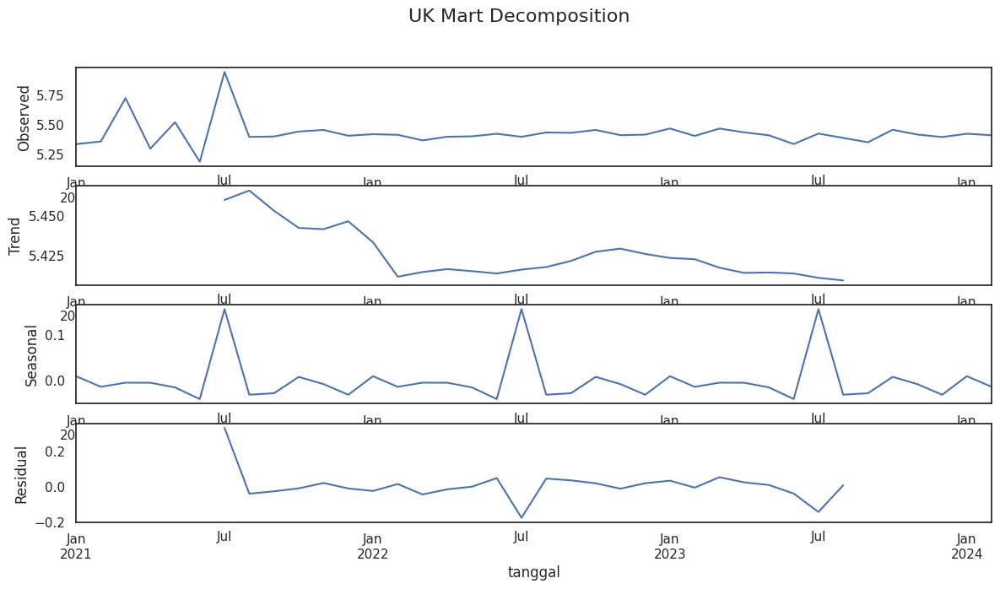

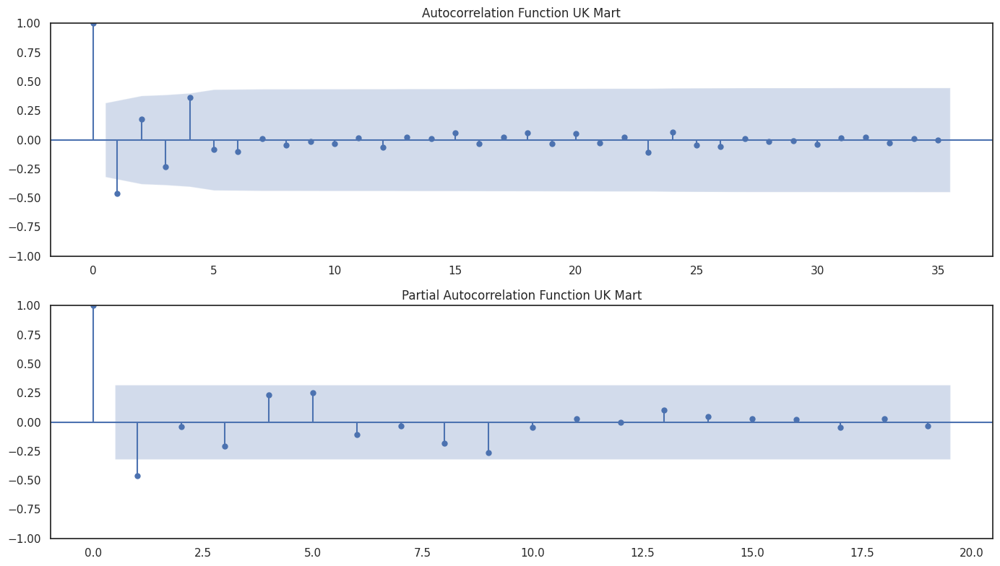

In [ ]:
#Pola Musiman UK Mart
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('UK Mart Decomposition', fontsize=16)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function UK Mart')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function UK Mart')

plt.tight_layout()
plt.show()

* Berdasarkan identifikasi seasonal, data UK Mart menunjukkan
data memiliki pola seasonal. Sehingga data ini dapat menggunakan model SARIMA (Seasonal Arima)
*  ACF membantu kita memahami seberapa baik nilai masa lalu dari data deret waktu menjelaskan nilai saat ini.
* PACF mengukur korelasi antara observasi dalam deret waktu dengan observasi pada lag yang berbeda, dengan mengontrol efek dari lags yang lebih rendah

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Baby Products

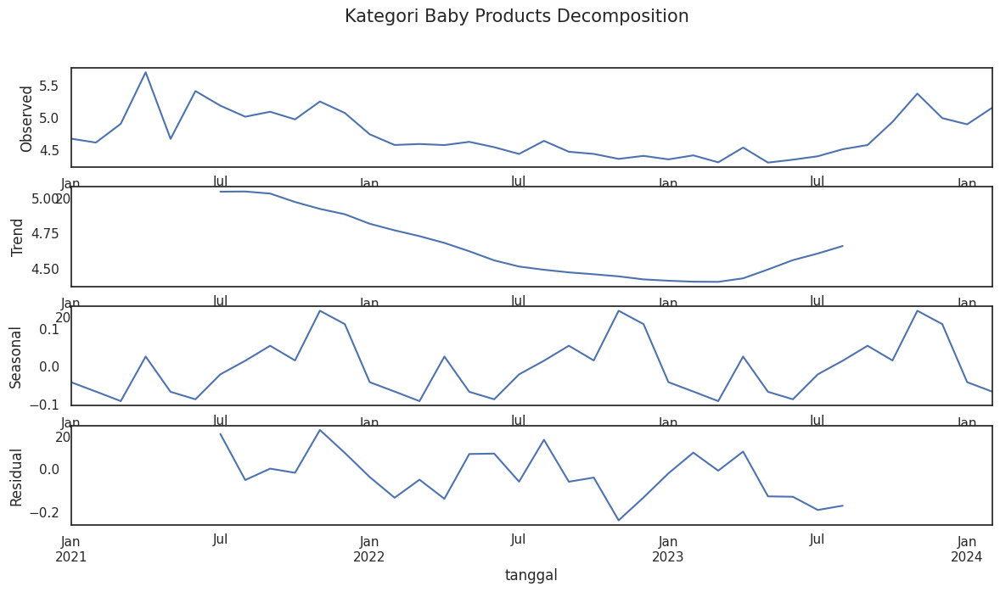

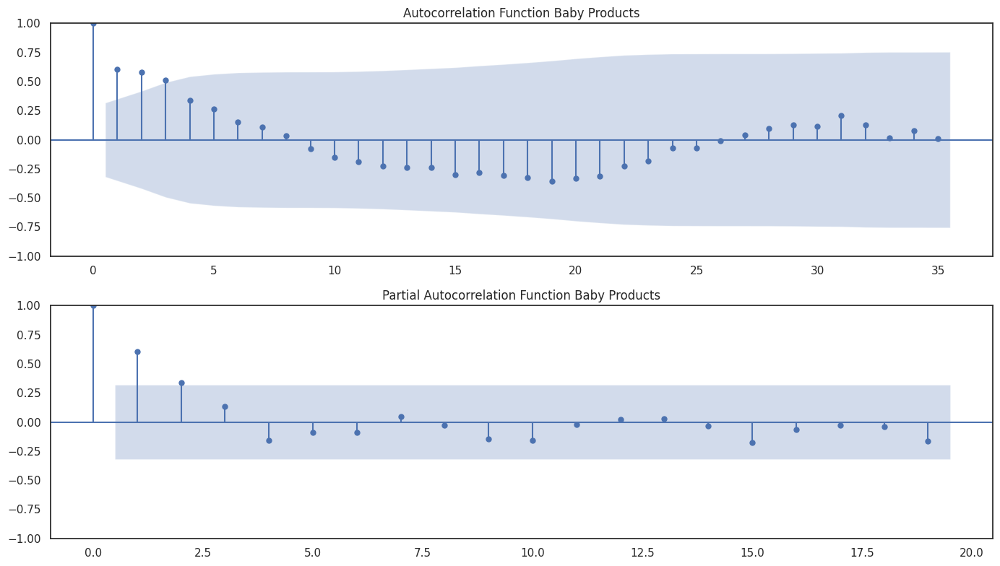

In [ ]:
#Pola Musiman Kategori baby_products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_baby = ukm[ukm['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Products Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Baby Products')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Baby Products')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Bakery

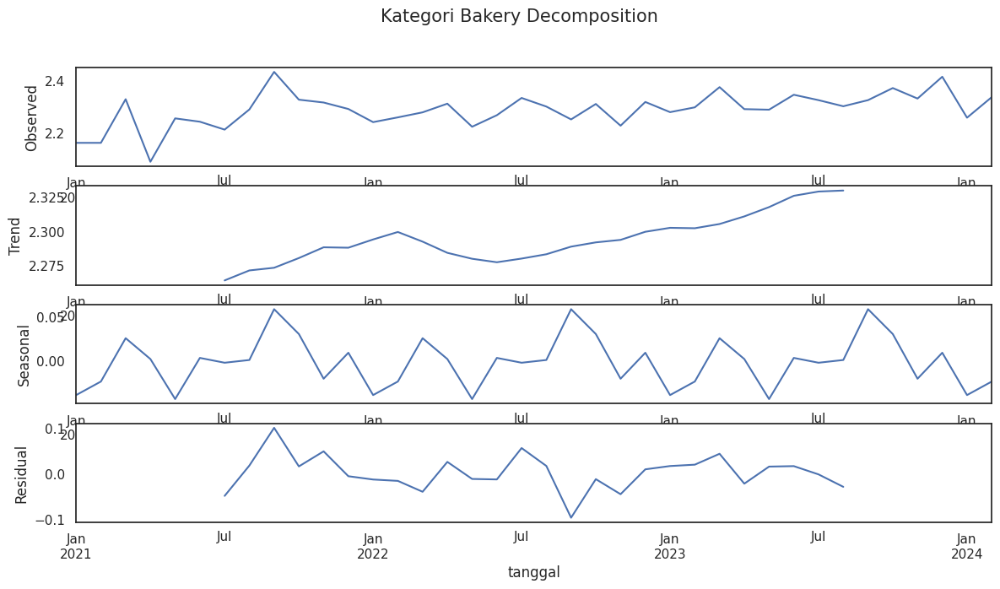

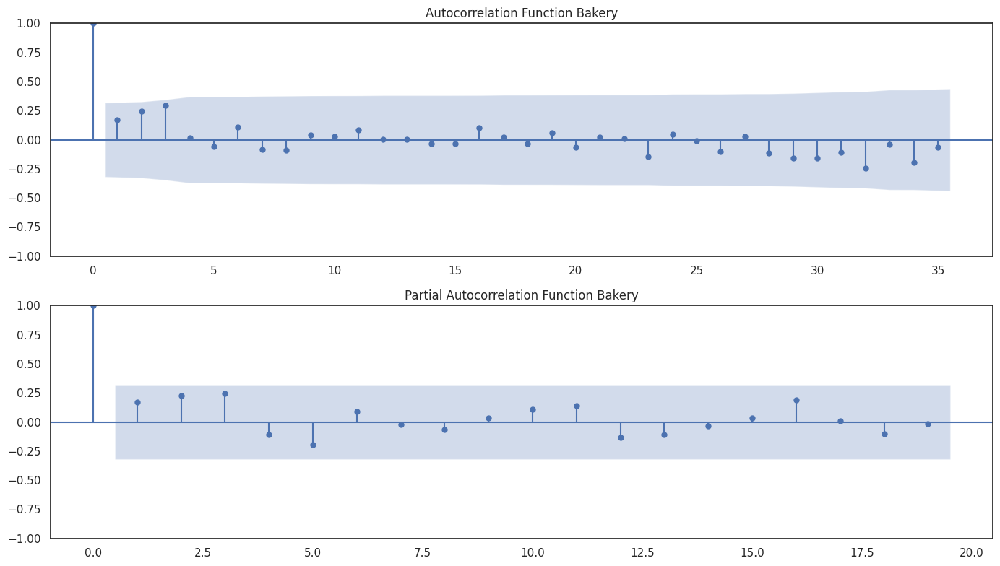

In [ ]:
#Pola Musiman Kategori bakery
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_bakery = ukm[ukm['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Bakery Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Bakery')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Bakery')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Drinks

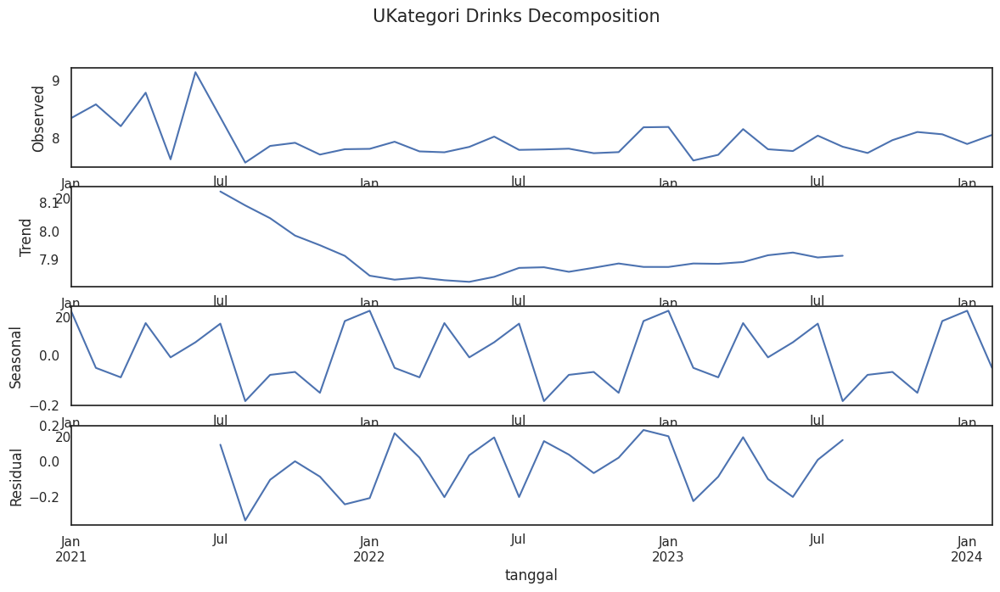

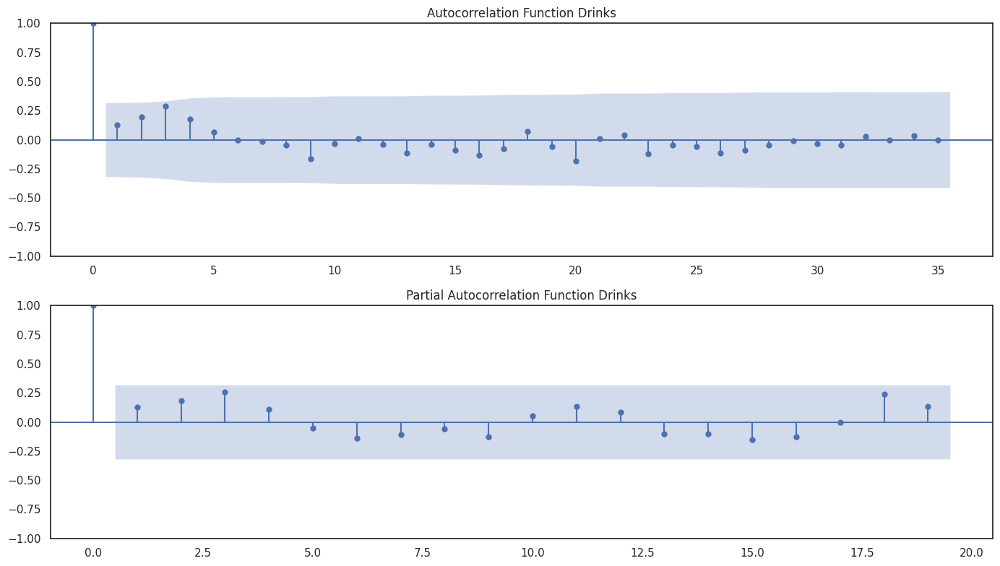

In [ ]:
#Pola Musiman Kategori drinks
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'Drinks' saja
ukm_drinks = ukm[ukm['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori Drinks
df_monthly = ukm_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('UKategori Drinks Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Drinks')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Drinks')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Food Cupboard

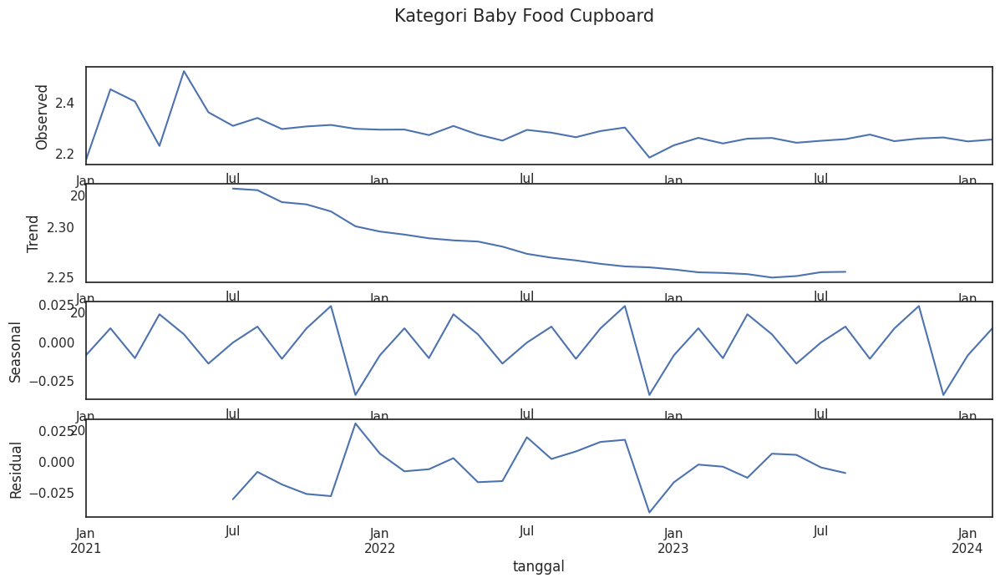

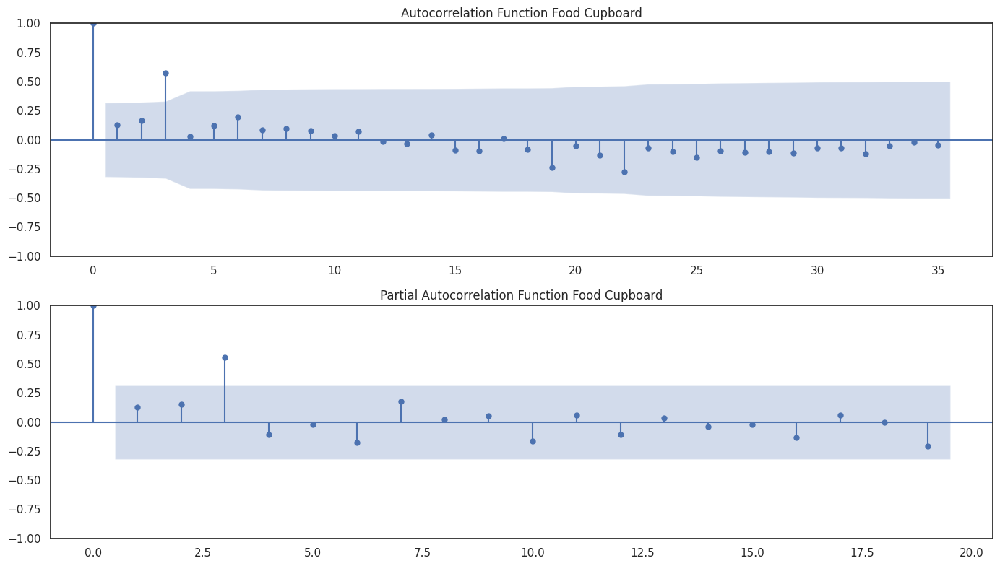

In [ ]:
#Pola Musiman Kategori food_cupboard
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'food_cupboard' saja
ukm_foodc = ukm[ukm['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori food_cupboard
df_monthly = ukm_foodc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Food Cupboard', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Food Cupboard')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Food Cupboard')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Free From

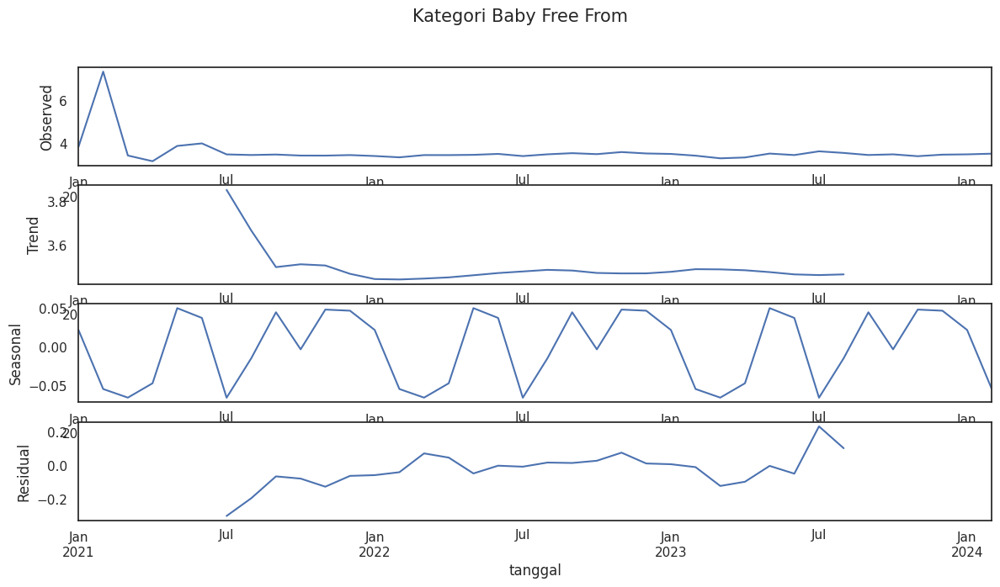

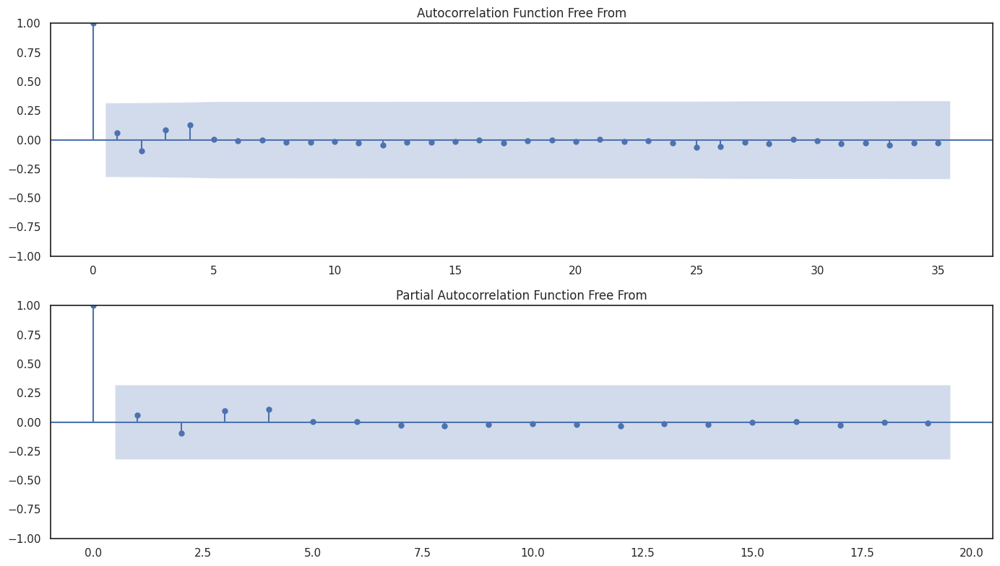

In [ ]:
#Pola Musiman Kategori free-from
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'free-from' saja
ukm_ff = ukm[ukm['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori free-from
df_monthly = ukm_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Free From', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Free From')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Free From')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Fresh Food

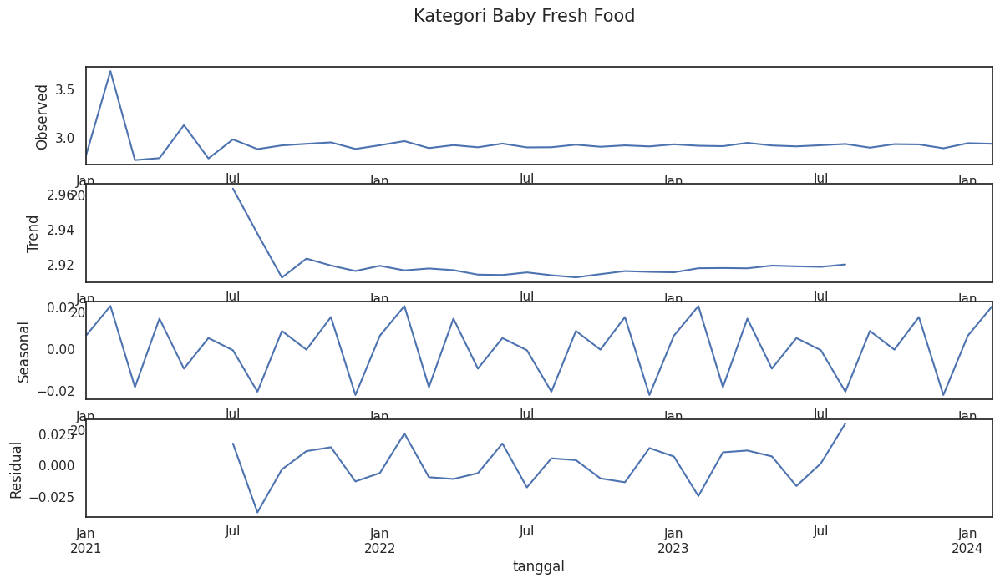

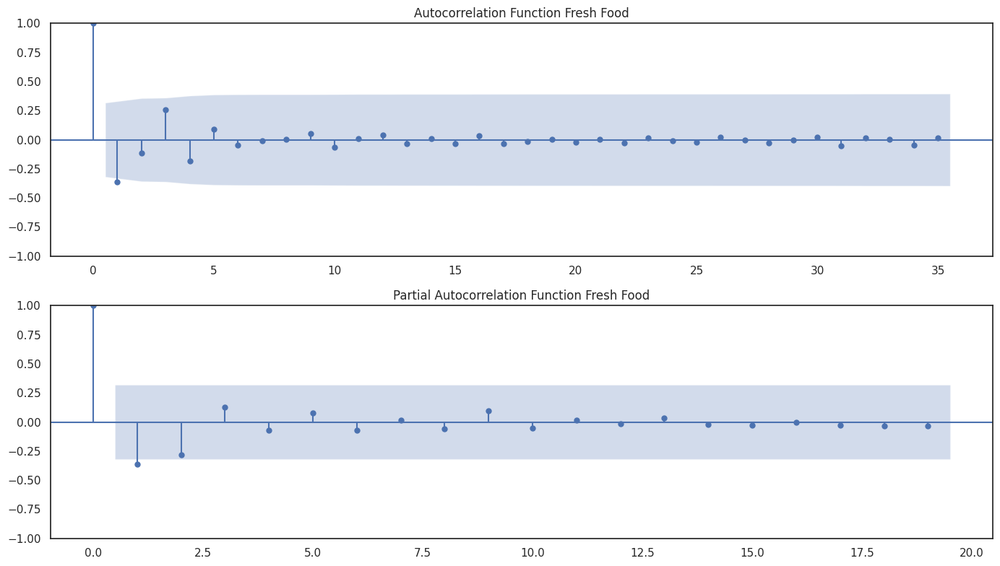

In [ ]:
#Pola Musiman Kategori fresh_food
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'fresh_food' saja
ukm_fresh = ukm[ukm['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori fresh_food
df_monthly = ukm_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Fresh Food', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Fresh Food')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Fresh Food')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Frozen

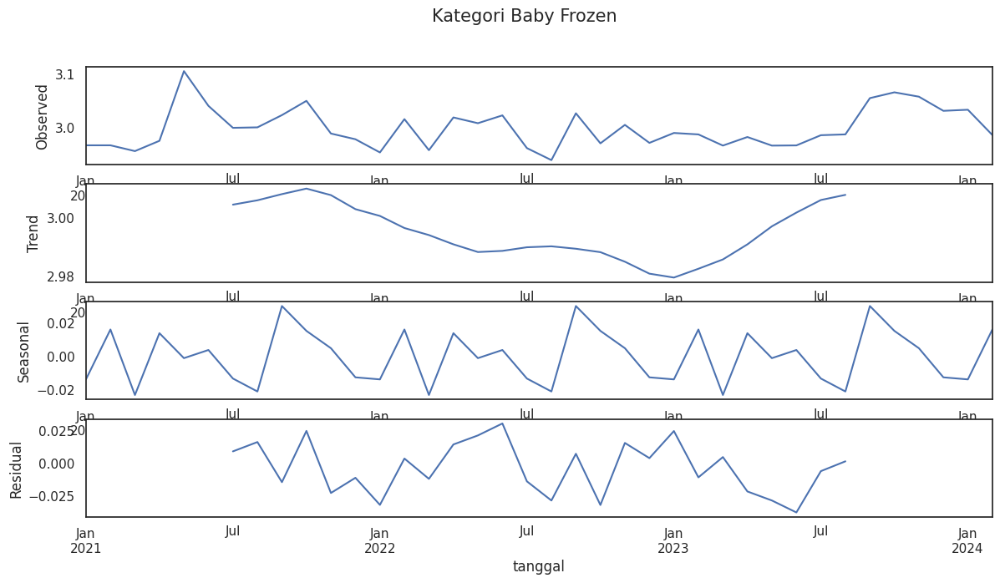

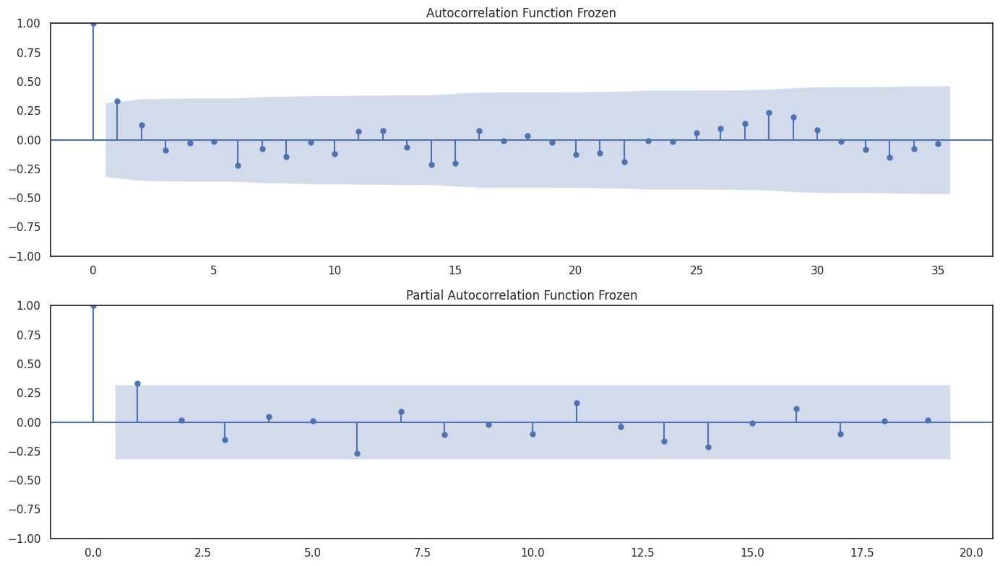

In [ ]:
#Pola Musiman Kategori frozen
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'frozen' saja
ukm_frozen = ukm[ukm['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori frozen
df_monthly = ukm_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Frozen', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Frozen')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Frozen')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Health Product

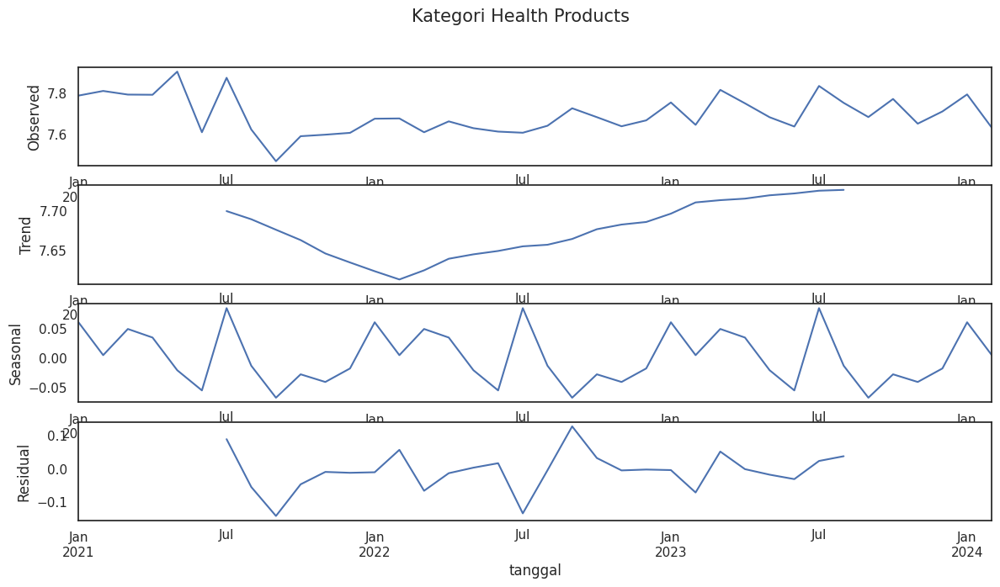

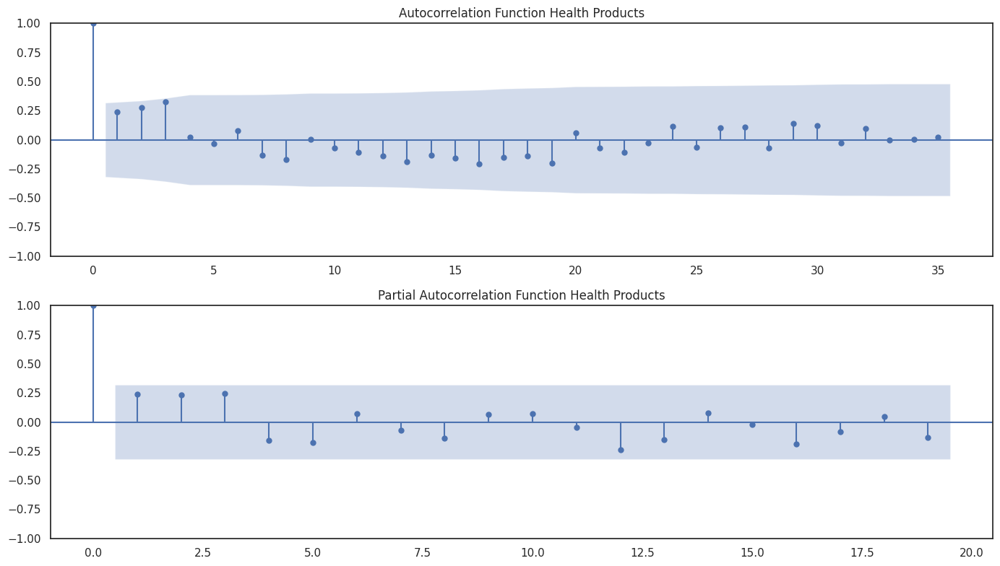

In [ ]:
#Pola Musiman Kategori health_products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'health_products' saja
ukm_health = ukm[ukm['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori health_products
df_monthly = ukm_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Health Products', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Health Products')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Health Products')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Home

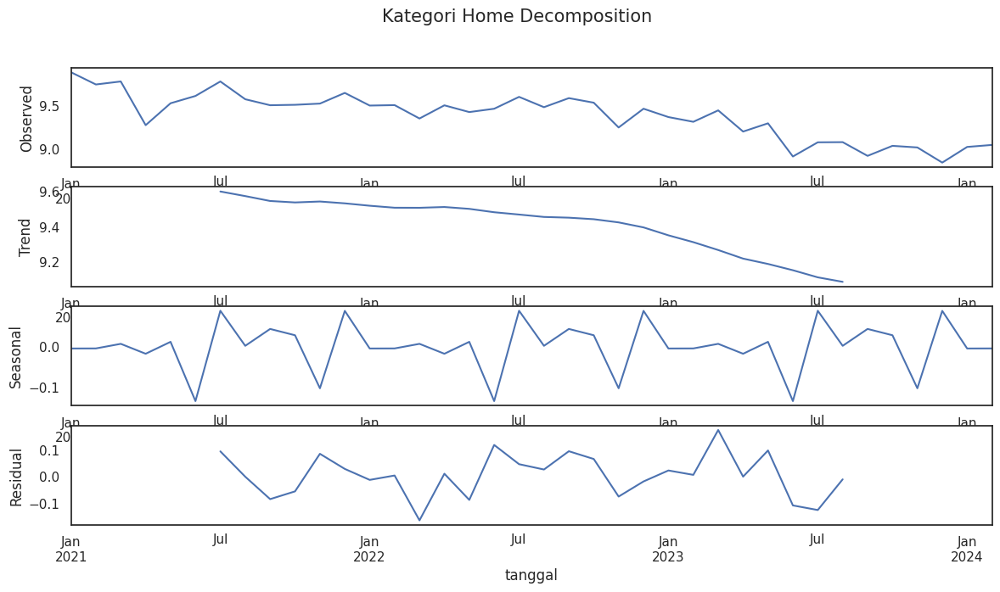

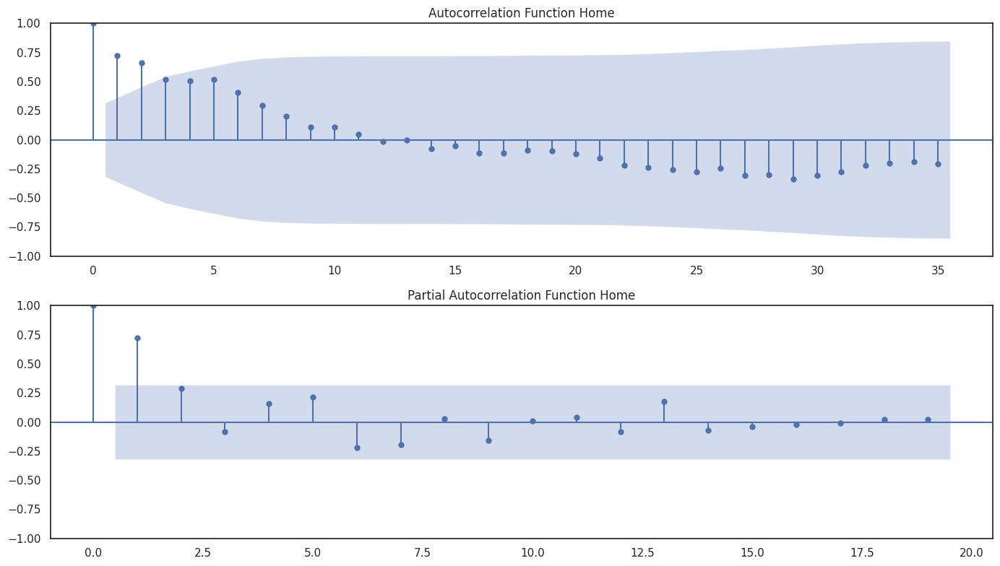

In [ ]:
#Pola Musiman Kategori home
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'home' saja
ukm_home = ukm[ukm['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori home
df_monthly = ukm_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Home Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Home')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Home')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori House Hold

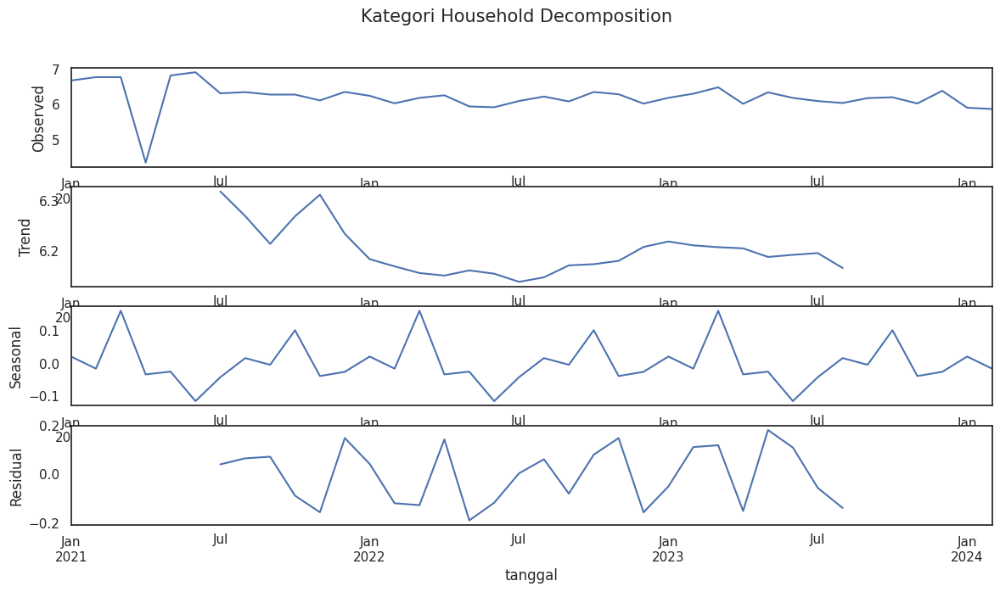

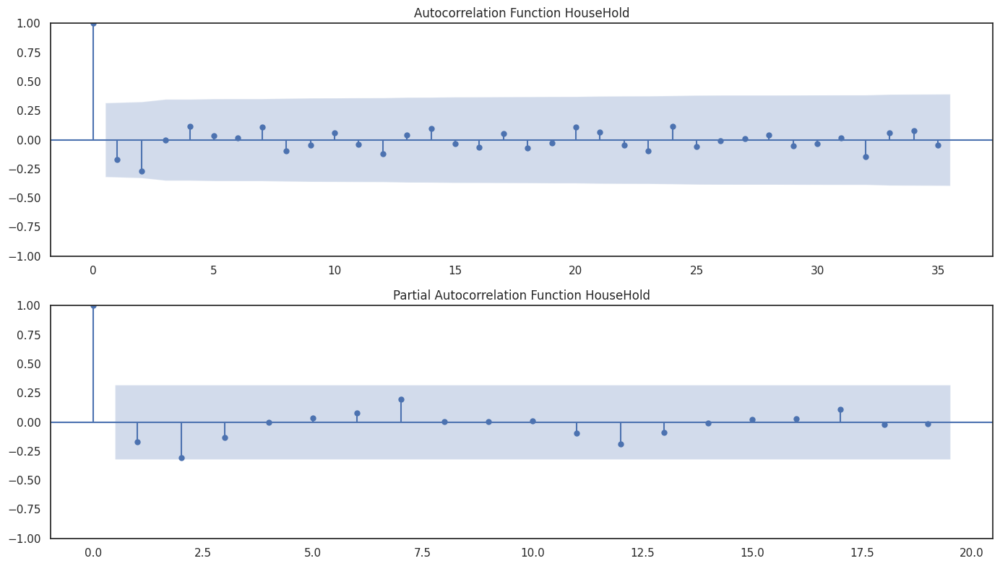

In [ ]:
#Pola Musiman Kategori household
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'household' saja
ukm_household = ukm[ukm['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori household
df_monthly = ukm_household.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Household Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function HouseHold')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function HouseHold')

plt.tight_layout()
plt.show()

Berikut adalah identifikasi pola musiman, ACF dan PACF data UK Mart kategori Pets

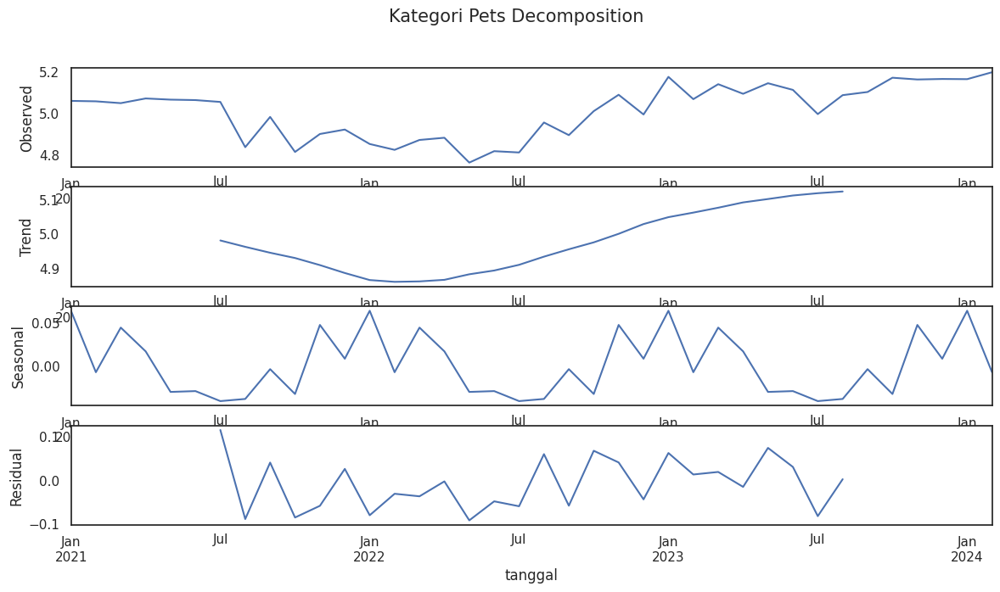

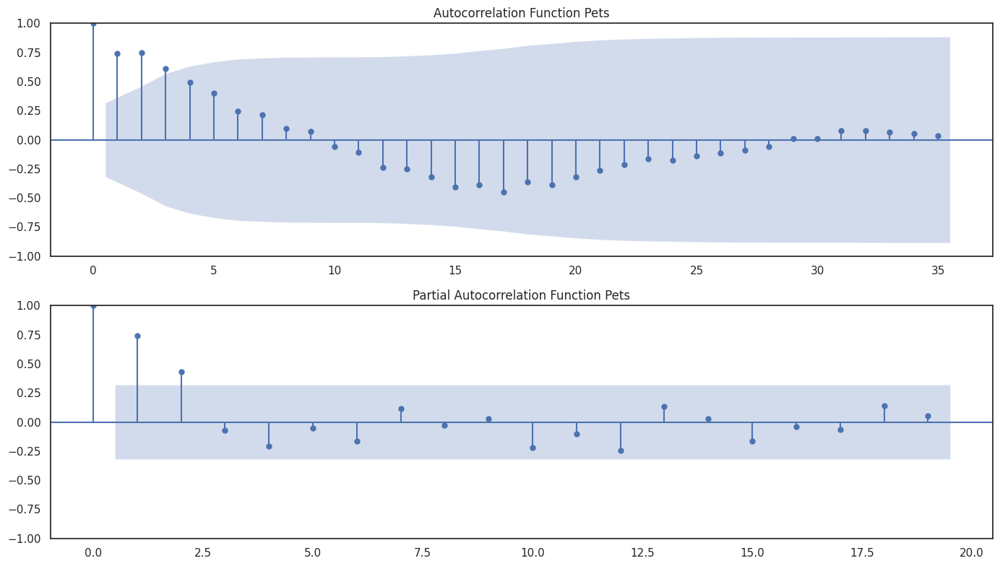

In [ ]:
#Pola Musiman Kategori pets
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'pets' saja
ukm_pets = ukm[ukm['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori pets
df_monthly = ukm_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Pets Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Pets')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Pets')

plt.tight_layout()
plt.show()

## Baby Products

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "baby_products"

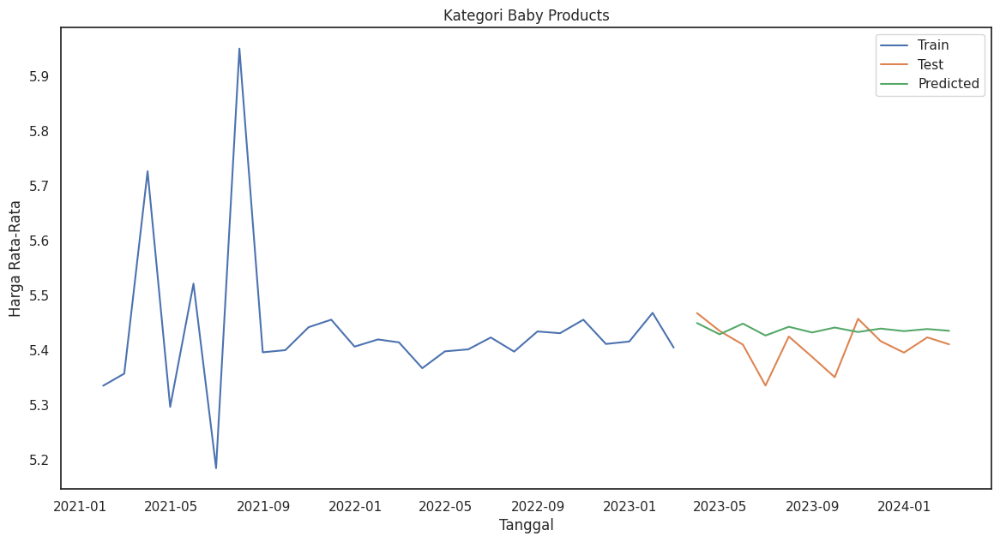

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.437145
2025-02-28    5.436927
2025-03-31    5.437101
2025-04-30    5.436962
2025-05-31    5.437073
2025-06-30    5.436984
2025-07-31    5.437056
2025-08-31    5.436998
2025-09-30    5.437044
2025-10-31    5.437007
2025-11-30    5.437037
2025-12-31    5.437013
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Baby Products: 0.044861408631293336
Standar deviasi: 0.006809733713629278
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(3, 0, 1)   Log Likelihood                  20.037
Date:                Fri, 07 Jun 2024   AIC                            -28.074
Time:                        07:49:42   BIC                            -20.525
Sample:                    01-31-2021   HQIC                           -25.900
                         - 02-28-2023                             

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/kalman_filter.py:2473: ValueWarning: Dynamic prediction specified to begin during out-of-sample forecasting period, and so has no effect.
  warn('Dynamic prediction specified to begin during'


In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_bp = ukm[ukm['kategori'] =='baby_products']
df_monthly = ukm.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(3, 0, 1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Baby Products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'baby_products'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.044, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.0067.

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Best ARIMA order: (0, 2, 0) with RMSE: 0.23860334181350473


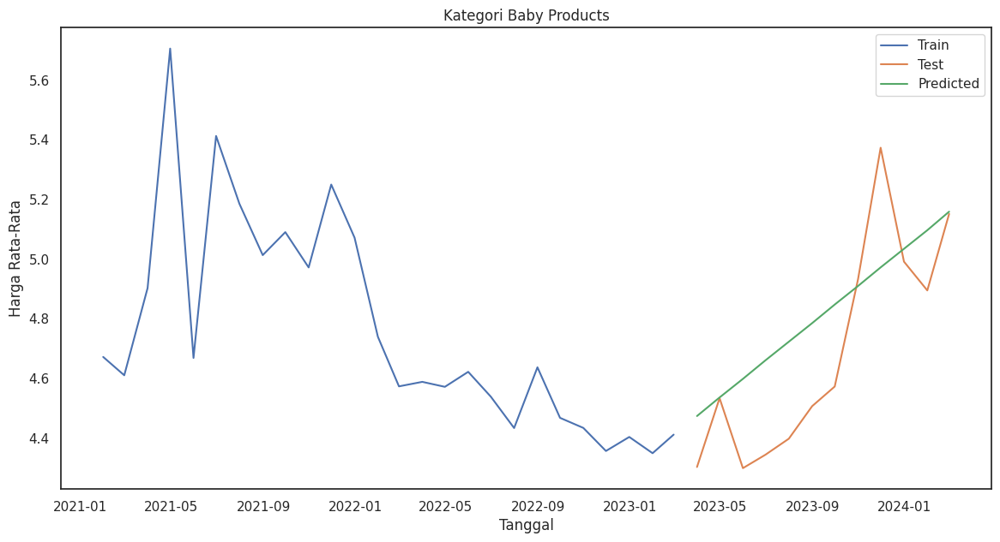

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.845175
2025-02-28    5.907528
2025-03-31    5.969881
2025-04-30    6.032235
2025-05-31    6.094588
2025-06-30    6.156942
2025-07-31    6.219295
2025-08-31    6.281649
2025-09-30    6.344002
2025-10-31    6.406355
2025-11-30    6.468709
2025-12-31    6.531062
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Baby Products: 0.23860334181350473
Standar deviasi: 0.21524726953334095
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 2, 0)   Log Likelihood                 -21.980
Date:                Fri, 07 Jun 2024   AIC                             45.960
Time:                        07:49:44   BIC                             47.138
Sample:                    01-31-2021   HQIC                            46.272
                         - 02-28-2023                               

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_bp = ukm[ukm['kategori'] == 'baby_products']
df_monthly = ukm_bp.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Baby Products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Setelah membuat base line model, kami mencoba untuk melakukan tuning. Dan hasilnya ternyata malah menunjukkan nilai RMSE dan standar deviasi yang lebih tinggi yaitu 0.23 dan 0.21.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "baby_products"

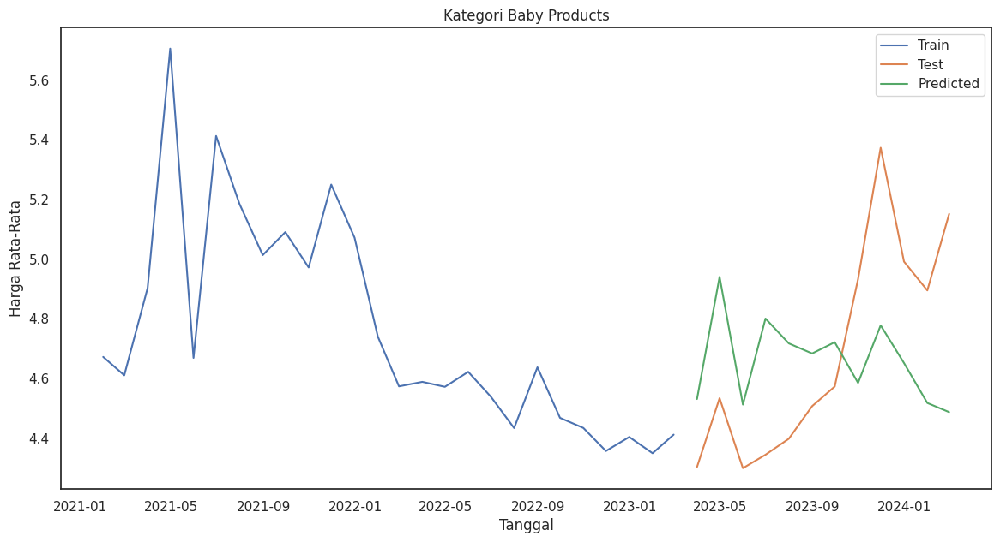

RMSE Kategori baby_products: 0.3878744212777937
Standar deviasi: 0.1337910801373491
AIC: 24.19763524364705
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(3, 0, 1)x(0, 1, 1, 12)   Log Likelihood                  -6.099
Date:                            Fri, 07 Jun 2024   AIC                             24.198
Time:                                    07:49:46   BIC                             28.032
Sample:                                01-31-2021   HQIC                            23.843
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1  

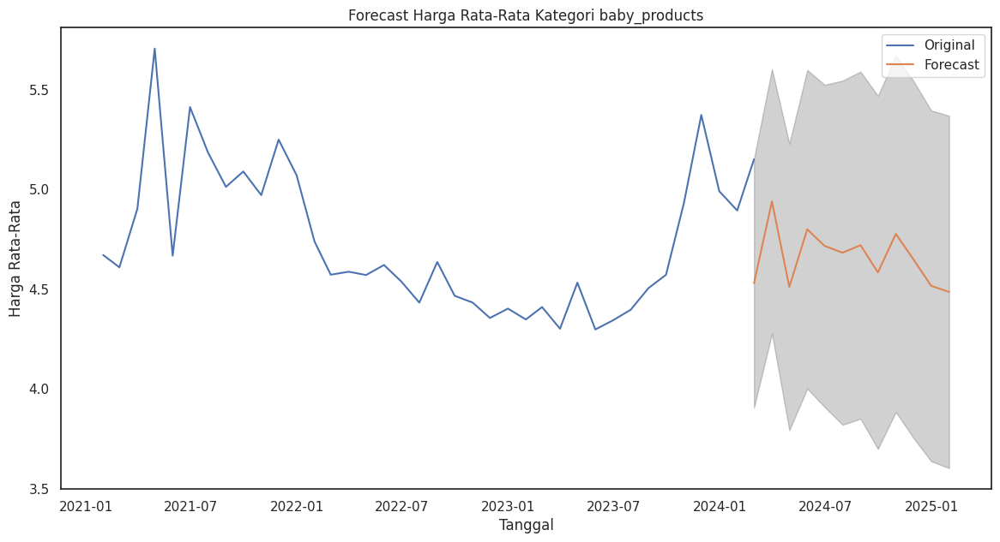

In [ ]:
#Baby Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_baby = ukm[ukm['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3,0,1), seasonal_order=(0,1,1,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori baby_products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori baby_products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori baby_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model SARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'baby_products'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.382, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.1337.

SARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 4.704490712481268
SARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 2.56712642014388
SARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.47725714269005437
SARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.6816379268552463
SARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.7809849331700686
SARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.8563205638611102
SARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 2.0468502512202043
SARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 3.0373254046107117
SARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 4.571487026866675
SARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 2.455986683300481
SARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.4761342879891494
SARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.4760455976405196
SARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.782064048366715
SARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.8760994156406999
SARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 1.5376151246775442
SARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.4760455976405196
SARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 4.420068294359124
SARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE:

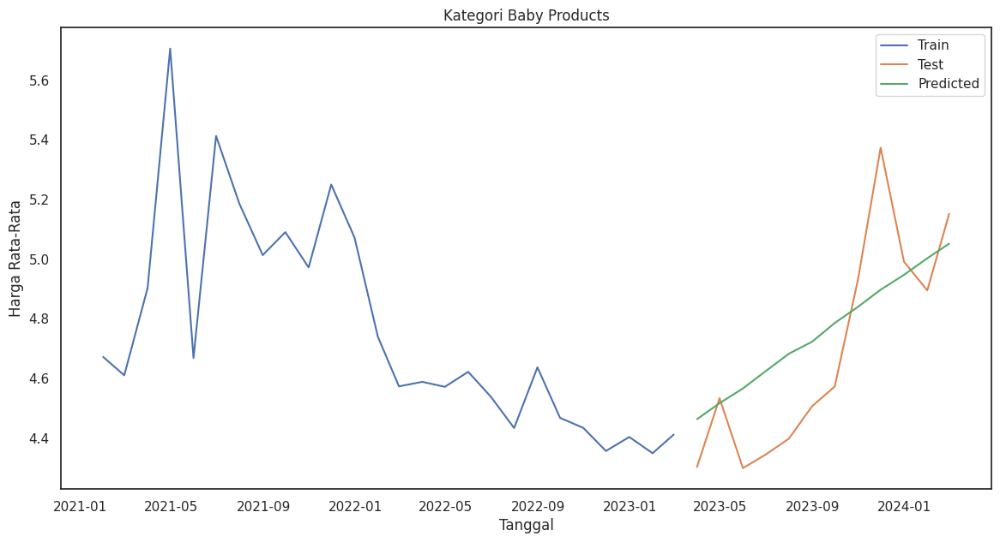

RMSE Kategori Baby Products : 0.22523387516097287
Standar deviasi: 0.186268537157358
AIC: -2.8251308082645537
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(0, 2, 0)x(1, 0, [1], 12)   Log Likelihood                   4.413
Date:                              Fri, 07 Jun 2024   AIC                             -2.825
Time:                                      07:50:02   BIC                             -1.631
Sample:                                  01-31-2021   HQIC                            -3.578
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

In [ ]:
#Tuning kategori baby product dengan menggunakan for loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
import itertools
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_baby = ukm[ukm['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'SARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest SARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Baby Products : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Baby Products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Bakery

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "bakery"

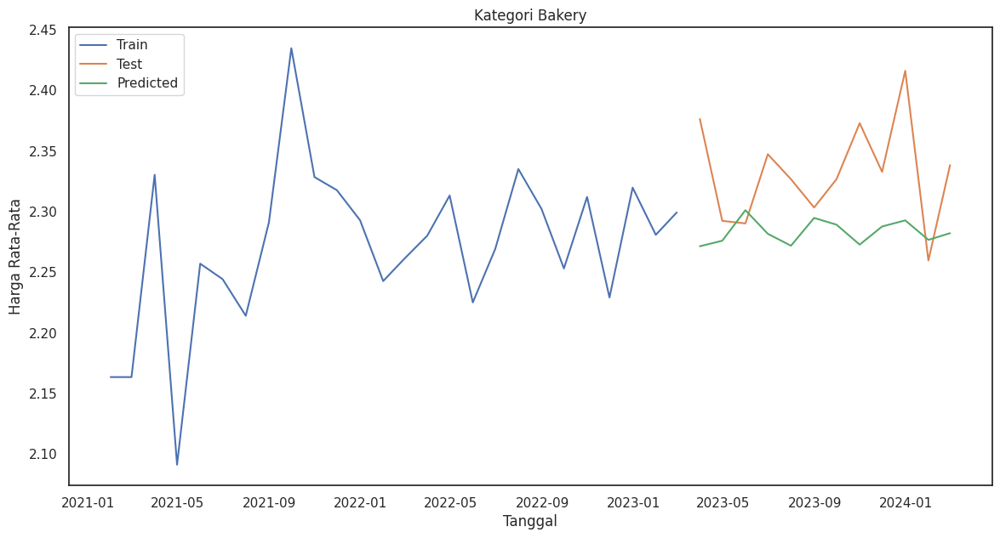

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.288347
2025-02-28    2.282258
2025-03-31    2.282523
2025-04-30    2.287638
2025-05-31    2.284260
2025-06-30    2.281905
2025-07-31    2.286284
2025-08-31    2.285630
2025-09-30    2.282236
2025-10-31    2.284892
2025-11-30    2.286199
2025-12-31    2.283092
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Bakery: 0.06514058063933074
Standar deviasi: 0.009480276385107423
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 3)   Log Likelihood                  33.864
Date:                Fri, 07 Jun 2024   AIC                            -55.727
Time:                        07:50:03   BIC                            -48.414
Sample:                    01-31-2021   HQIC                           -53.699
                         - 02-28-2023                                     

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_bk = ukm[ukm['kategori'] =='bakery']
df_monthly = ukm_bk.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 1, 3))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Bakery: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Syntax di atas digunakan untuk memRamalan harga kategori 'bakery' di masa depan. Dengan menggunakan angka order (2, 1, 3) didapatkan hasil RMSE sebesar 0.064 dan nilai stdnya 0.006. Grafiknya pun masih terjadi overfitting.

Best ARIMA order: (2, 2, 2) with RMSE: 0.04212814384926838


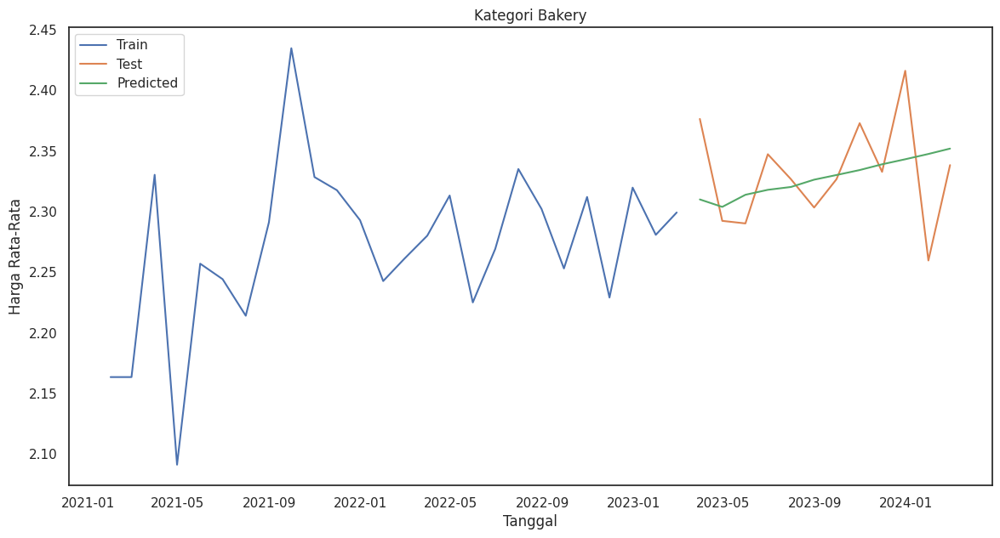

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.399742
2025-02-28    2.404094
2025-03-31    2.408447
2025-04-30    2.412799
2025-05-31    2.417152
2025-06-30    2.421504
2025-07-31    2.425857
2025-08-31    2.430209
2025-09-30    2.434561
2025-10-31    2.438914
2025-11-30    2.443266
2025-12-31    2.447619
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Bakery: 0.04212814384926838
Standar deviasi: 0.014764284420611852
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 2, 2)   Log Likelihood                  27.781
Date:                Fri, 07 Jun 2024   AIC                            -45.562
Time:                        07:50:06   BIC                            -39.672
Sample:                    01-31-2021   HQIC                           -44.000
                         - 02-28-2023                                     

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_bk = ukm[ukm['kategori'] == 'bakery']
df_monthly = ukm_bk.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Bakery: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Setelah membuat bashline model, maka dilanjutkan proses tunning. Didapatkan hasil bahwasannya nilai RMSEnya lebih kecil yaitu 0.041 dan nilai standar deviasinya menjadi 0.014. Akan tetapi jika dilihat dari grafik, garis Ramalannya mengalami kenaikan.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "bakery"

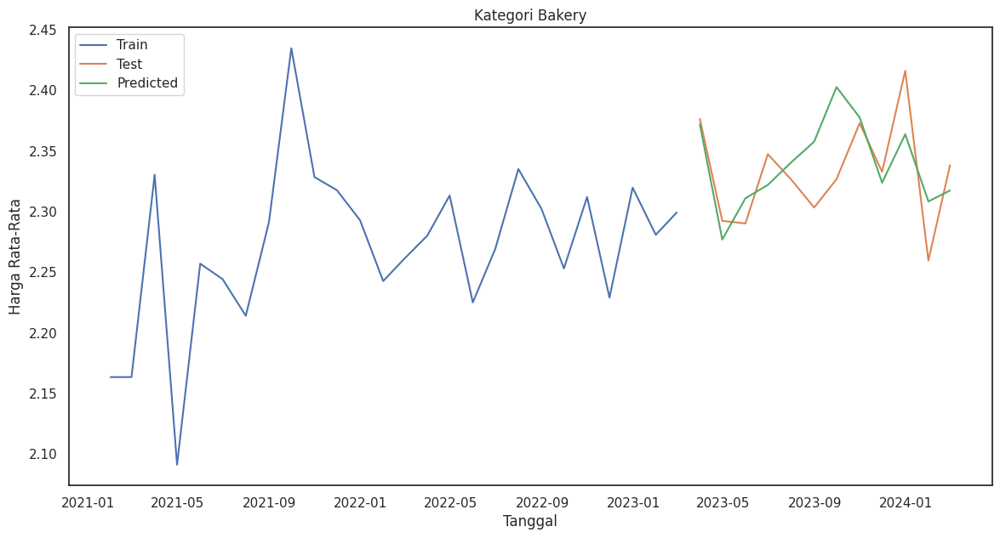

RMSE Kategori bakery: 0.03638009378155461
Standar deviasi: 0.03435105372338881
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 2, 1)x(0, 1, 1, 12)   Log Likelihood                   7.497
Date:                            Fri, 07 Jun 2024   AIC                             -4.994
Time:                                    07:50:07   BIC                             -2.570
Sample:                                01-31-2021   HQIC                            -5.892
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7659      0.473   

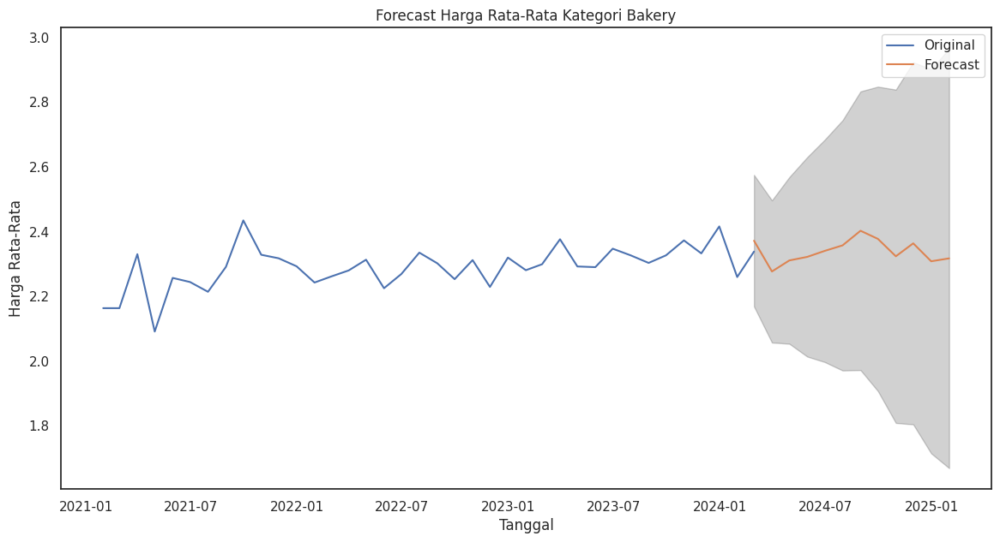

In [ ]:
#Bakery
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_bakery = ukm[ukm['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,2,1), seasonal_order=(0,1,1,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)

print(f"RMSE Kategori bakery: {rmse}")
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori bakery untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'bakery'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.035, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.0342.

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 2.3322386769643066
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.2252159629846222
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.06535057381645881
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.08860666928803211
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.05415530231910194
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.09458940413707491
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.0905902147116975
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.08805182838914614
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 2.25367700402382
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 1.1572250075522532
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.06594934317217983
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.06594661762668184
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.05444714641333948
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.09489540061470622
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.09068256930060604
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.06594661762668184
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 2.1834656678241484
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 1.

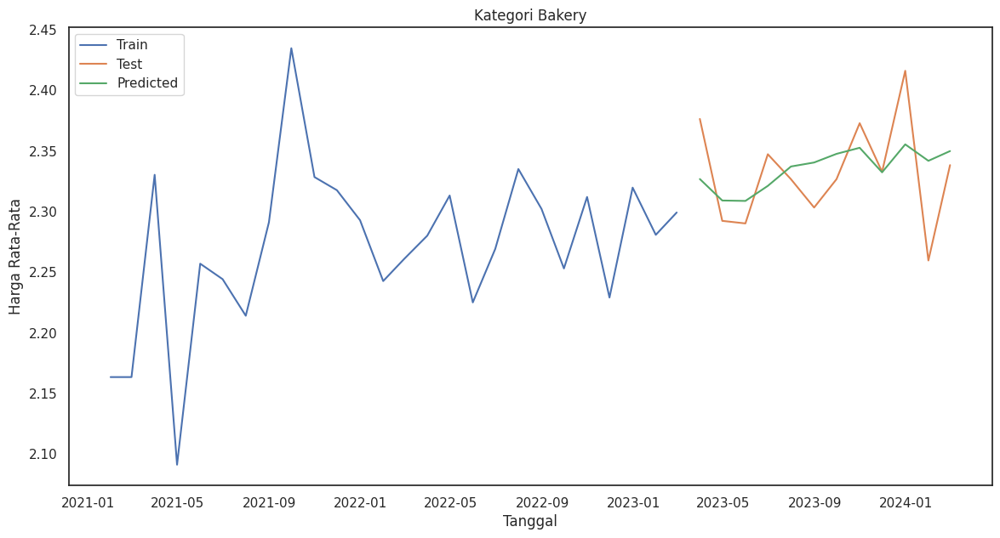

RMSE Kategori Bakery : 0.037275788322656316
Standar deviasi: 0.015300608403010132
AIC: -34.121847271802785
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 0, 0)x(1, 0, [1], 12)   Log Likelihood                  21.061
Date:                              Fri, 07 Jun 2024   AIC                            -34.122
Time:                                      07:50:25   BIC                            -31.862
Sample:                                  01-31-2021   HQIC                           -34.586
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------

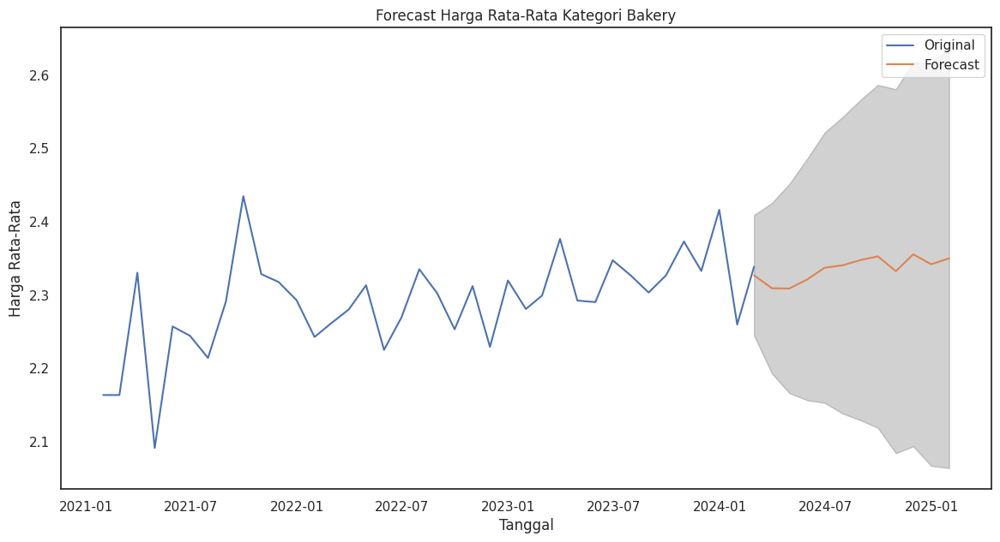

In [ ]:
#Tuning Bakery menggunakan for loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
import itertools
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_bakery = ukm[ukm['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Bakery : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Home untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Dari hasil tuning memperoleh parameter terbaik namun metric evaluasi RMSE lebih besar dari sebelumnya, sehingga hasil tuning ini tidak lebih baik dari sebelumnya

##Drinks

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "drinks"

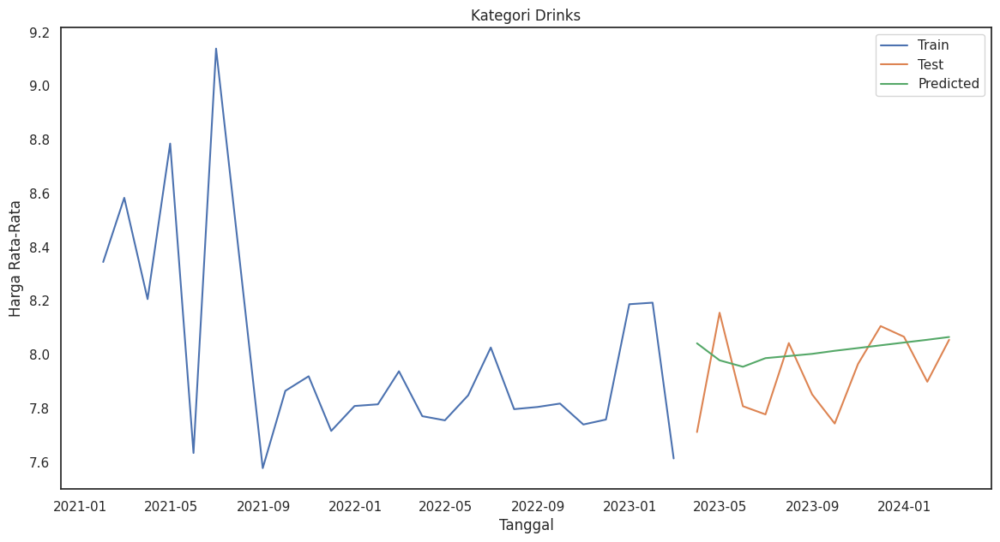

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    8.178635
2025-02-28    8.188936
2025-03-31    8.199238
2025-04-30    8.209540
2025-05-31    8.219842
2025-06-30    8.230144
2025-07-31    8.240445
2025-08-31    8.250747
2025-09-30    8.261049
2025-10-31    8.271351
2025-11-30    8.281653
2025-12-31    8.291954
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Drinks: 0.16779896157228122
Standar deviasi: 0.03232348857501262
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 2, 3)   Log Likelihood                 -11.954
Date:                Fri, 07 Jun 2024   AIC                             35.908
Time:                        07:50:26   BIC                             42.976
Sample:                    01-31-2021   HQIC                            37.783
                         - 02-28-2023                                      

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_dr = ukm[ukm['kategori'] =='drinks']
df_monthly = ukm_dr.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 2, 3))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Drinks: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas merupakan syntax untuk membuat Ramalan harga dengan model ARIMA pada kategori 'drinks'. Di atas saya menggunakan nilai order (2, 2, 3) dengan didapatkan hasil RMSEnya 0.168 dan stdnya sebesar 0.033.

Best ARIMA order: (1, 0, 1) with RMSE: 0.15119948738100006


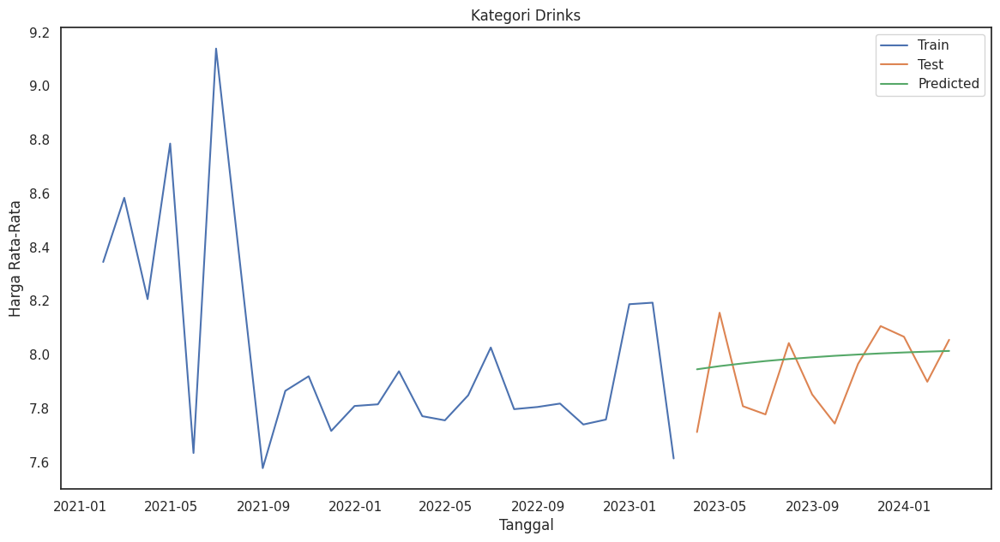

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    8.026512
2025-02-28    8.026943
2025-03-31    8.027314
2025-04-30    8.027633
2025-05-31    8.027908
2025-06-30    8.028144
2025-07-31    8.028347
2025-08-31    8.028522
2025-09-30    8.028672
2025-10-31    8.028802
2025-11-30    8.028913
2025-12-31    8.029009
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Drinks: 0.15119948738100006
Standar deviasi: 0.021287355271999105
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 0, 1)   Log Likelihood                 -10.124
Date:                Fri, 07 Jun 2024   AIC                             28.248
Time:                        07:50:28   BIC                             33.280
Sample:                    01-31-2021   HQIC                            29.697
                         - 02-28-2023                                     

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_dr = ukm[ukm['kategori'] == 'drinks']
df_monthly = ukm_dr.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Drinks: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Kemudian, kami melakukan proses tunning untuk mendapatkan nilai RMSE yang lebih rendah lagi. Sehingga didapatkan nilai RMSE sebesar 0.15 dan stdnya sebesar 0.021. Walaupun terjadi penurunan sedikit, akan tetapi hasil tersebut berpengaruh terhadap model. Grafiknya pun juga mengalami kenaikan.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "drinks"

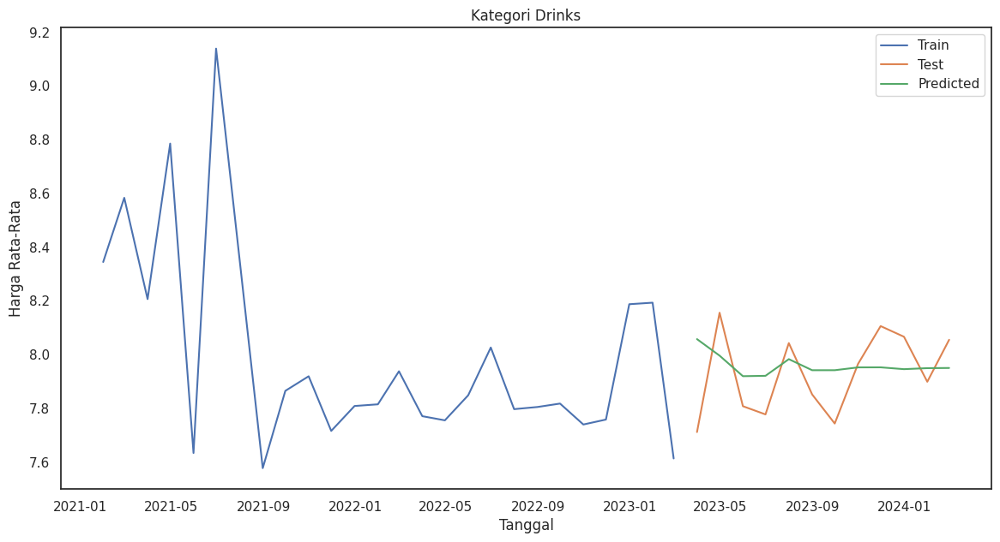

RMSE Kategori drinks: 0.15309558731030598
Standar deviasi: 0.03614183002040543
AIC: 27.060940859829863
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(3, 1, 0)   Log Likelihood                  -9.530
Date:                Fri, 07 Jun 2024   AIC                             27.061
Time:                        07:50:29   BIC                             31.936
Sample:                    01-31-2021   HQIC                            28.413
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9563      0.155     -6.151      0.000      -1.261      -0.652
ar.L2         -0.6290      0

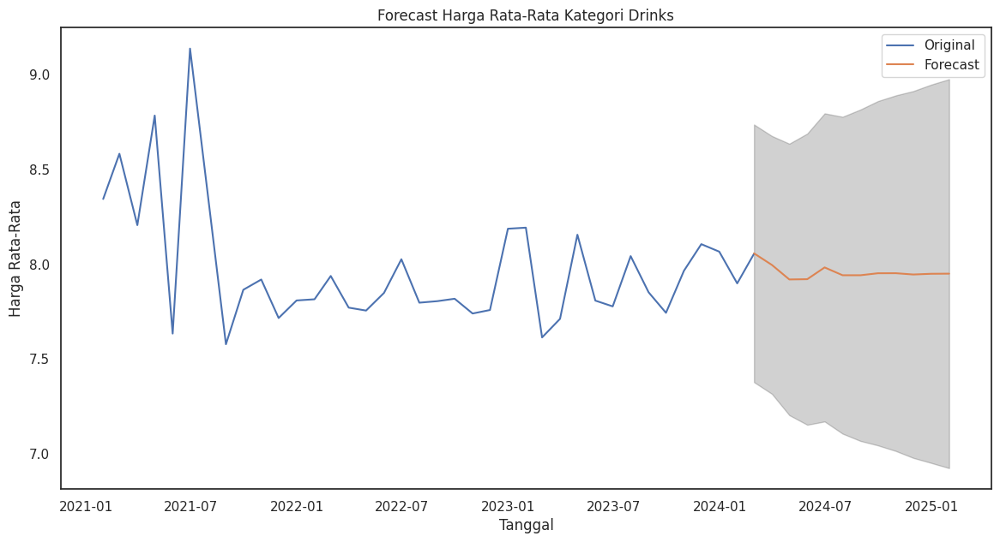

In [ ]:
#Drinks
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_drinks = ukm[ukm['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3,1,0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori drinks: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Drinks untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'drinks'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.152, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.035.

Best SARIMA parameters: ((2, 1, 2), (0, 0, 2, 12)) with RMSE: 0.12339660511600033


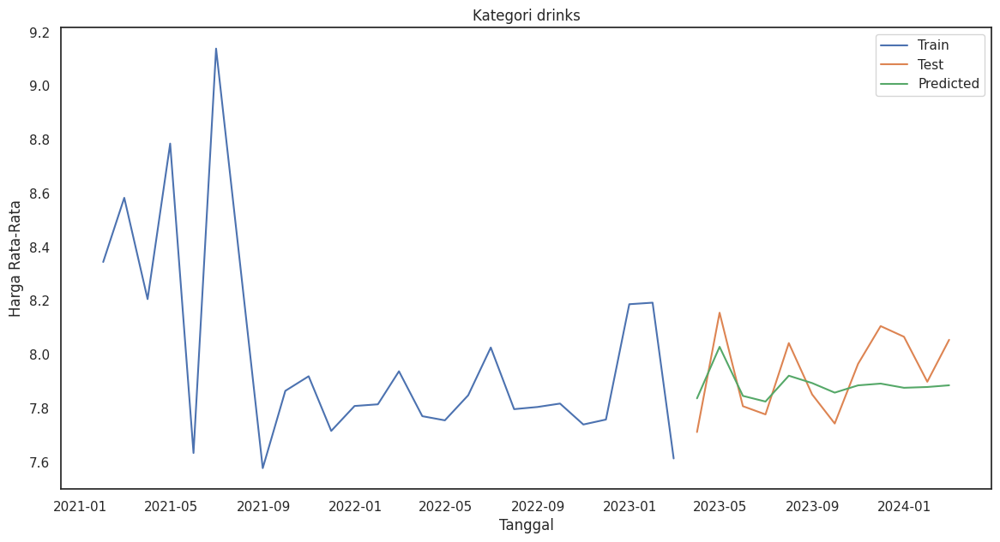

RMSE Kategori Drinks: 0.12339660511600033
Standar deviasi: 0.05026996266903427
AIC: 14.0
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 1, 2)x(0, 0, 2, 12)   Log Likelihood                   0.000
Date:                            Fri, 07 Jun 2024   AIC                             14.000
Time:                                    07:51:21   BIC                                nan
Sample:                                01-31-2021   HQIC                               nan
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3905    

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_drinks = ukm[ukm['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Drinks: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Drinks untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Food Cupboard

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "food_cupboard"

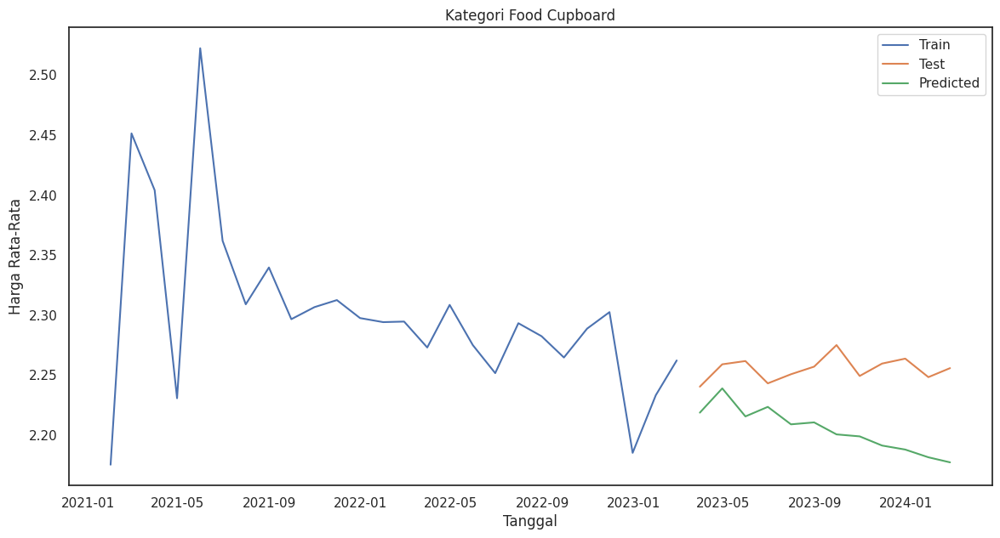

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.120375
2025-02-28    2.115251
2025-03-31    2.110097
2025-04-30    2.104965
2025-05-31    2.099817
2025-06-30    2.094680
2025-07-31    2.089535
2025-08-31    2.084396
2025-09-30    2.079252
2025-10-31    2.074112
2025-11-30    2.068970
2025-12-31    2.063829
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Food Cupboard: 0.055055804016529576
Standar deviasi: 0.01753942748030466
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 2, 3)   Log Likelihood                  27.574
Date:                Fri, 07 Jun 2024   AIC                            -45.148
Time:                        07:51:21   BIC                            -39.258
Sample:                    01-31-2021   HQIC                           -43.585
                         - 02-28-2023                              

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fc = ukm[ukm['kategori'] =='food_cupboard']
df_monthly = ukm_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1, 2, 3))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Food Cupboard: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas menggunakan model ARIMA untuk memRamalan harga rata-rata bulanan dari kategori produk 'food_cupboard'. RMSE (Root Mean Square Error) dihitung untuk mengukur kinerja model pada data uji, dengan hasil RMSE sebesar 0.055. Standar deviasi dari Ramalan juga dihitung, dengan hasil standar deviasi sebesar 0.017. Gambar grafik dari garis Ramalan mengalami penurunan.

Best ARIMA order: (1, 1, 1) with RMSE: 0.009204350882639767


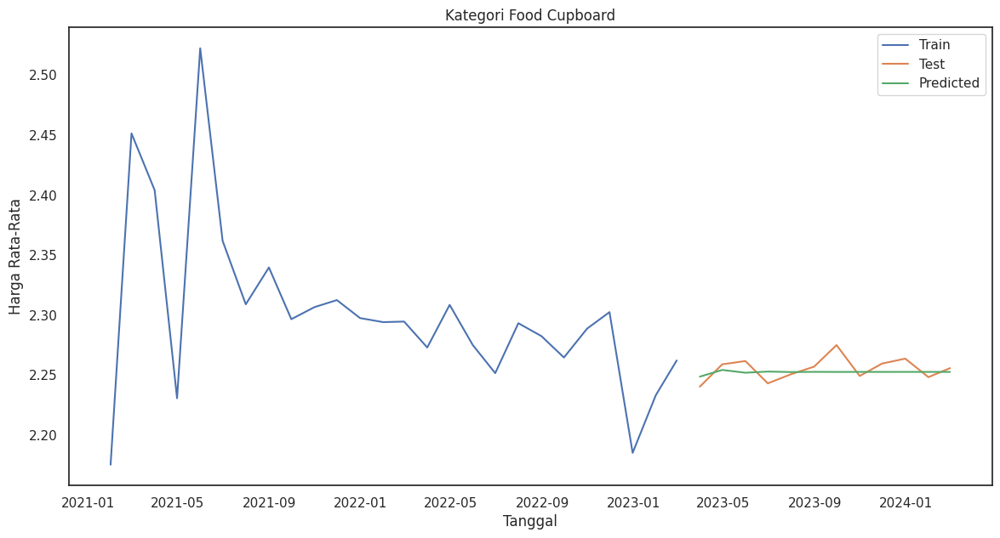

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.252675
2025-02-28    2.252675
2025-03-31    2.252675
2025-04-30    2.252675
2025-05-31    2.252675
2025-06-30    2.252675
2025-07-31    2.252675
2025-08-31    2.252675
2025-09-30    2.252675
2025-10-31    2.252675
2025-11-30    2.252675
2025-12-31    2.252675
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Food Cupboard: 0.009204350882639767
Standar deviasi: 0.001228151957002397
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  30.698
Date:                Fri, 07 Jun 2024   AIC                            -55.395
Time:                        07:51:24   BIC                            -51.739
Sample:                    01-31-2021   HQIC                           -54.381
                         - 02-28-2023                             

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fc = ukm[ukm['kategori'] == 'food_cupboard']
df_monthly = ukm_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Food Cupboard: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Lalu, dilakukan proses tunning untuk mencari nilai RMSE yang rendah. Sehingga didapatkan nilai RMSE sebesar 0.009 dan stdnya 0.001.Akan tetapi pada proses tuning ini, grafik dari garis Ramalannya menunjukkan garis yang landai.

Best ARIMA order: (1, 1, 1) with RMSE: 0.009204350882639767


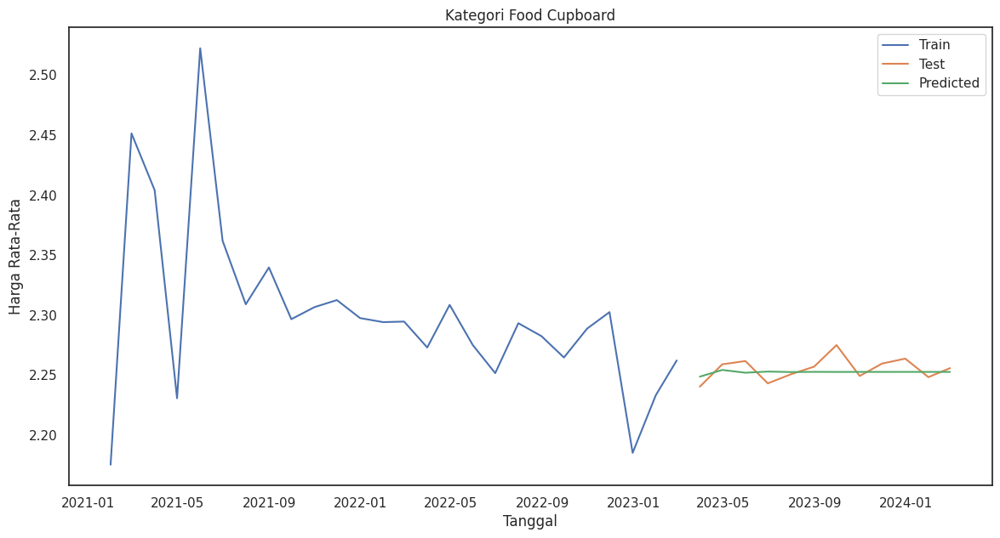

Persentase kenaikan harga tiap bulan untuk tahun 2025:
            harga_rata  persentase_kenaikan
2025-02-28    2.252675         8.989520e-10
2025-03-31    2.252675        -3.716260e-10
2025-04-30    2.252675         1.536301e-10
2025-05-31    2.252675        -6.351806e-11
2025-06-30    2.252675         2.625886e-11
2025-07-31    2.252675        -1.086234e-11
2025-08-31    2.252675         4.494760e-12
2025-09-30    2.252675        -1.853103e-12
2025-10-31    2.252675         7.688405e-13
2025-11-30    2.252675        -3.154218e-13
2025-12-31    2.252675         1.379970e-13


In [ ]:
#Presentase Kenaikan Harga Tiap Bulan
import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fc = ukm[ukm['kategori'] == 'food_cupboard']
df_monthly = ukm_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Menghitung persentase kenaikan harga tiap bulan untuk tahun 2025
forecast_df = pd.DataFrame({'harga_rata': forecast})
forecast_df['harga_shifted'] = forecast_df['harga_rata'].shift(1)
forecast_df['persentase_kenaikan'] = ((forecast_df['harga_rata'] - forecast_df['harga_shifted']) / forecast_df['harga_shifted']) * 100

# Drop the first row since it will have NaN for persentase_kenaikan
forecast_df = forecast_df.dropna()

# Menampilkan hasil persentase kenaikan harga tiap bulan untuk tahun 2025
print("Persentase kenaikan harga tiap bulan untuk tahun 2025:")
print(forecast_df[['harga_rata', 'persentase_kenaikan']])


###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "food_cupboard"

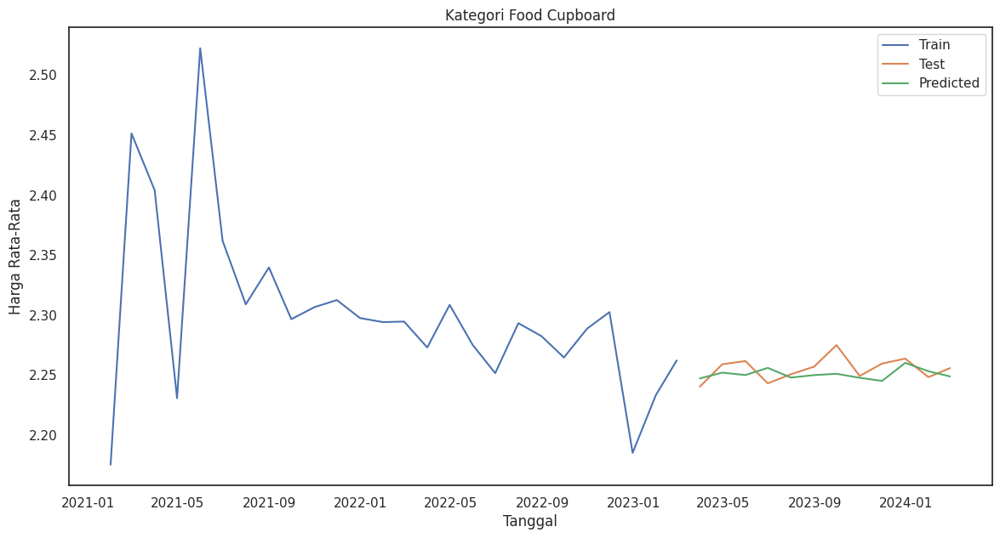

RMSE Kategori food_cupboard: 0.01049749218428167
Standar deviasi: 0.003978535702867028
AIC: -39.20415301996416
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 0, 0)x(1, 0, 0, 12)   Log Likelihood                  23.602
Date:                            Fri, 07 Jun 2024   AIC                            -39.204
Time:                                    07:51:28   BIC                            -34.172
Sample:                                01-31-2021   HQIC                           -37.755
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.

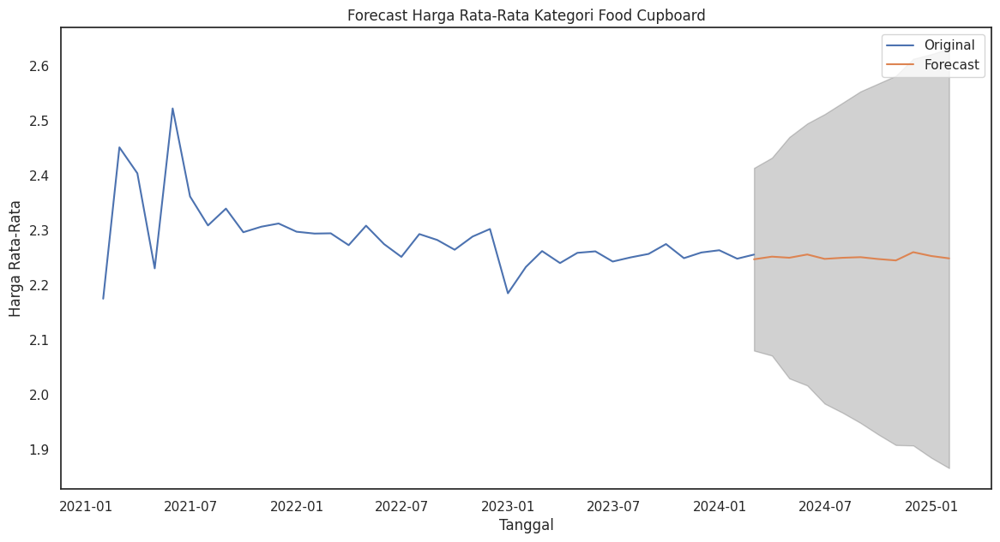

In [ ]:
#Food_Cupboard
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_fc = ukm[ukm['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,0,0), seasonal_order=(1, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori food_cupboard: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Food Cupboard untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'food_cupboard'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.01, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.0039.

Best SARIMA parameters: ((1, 1, 0), (0, 0, 1, 12)) with RMSE: 0.008953823308619165


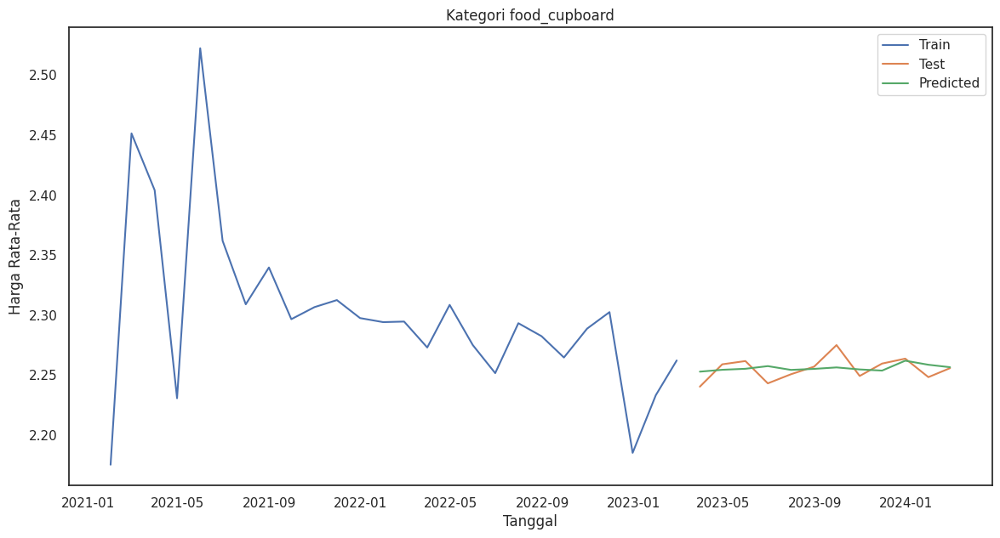

RMSE Kategori Fresh Food: 0.008953823308619165
Standar deviasi: 0.0023868158594894653
AIC: -36.656237156211866
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 1, 0)x(0, 0, [1], 12)   Log Likelihood                  21.328
Date:                              Fri, 07 Jun 2024   AIC                            -36.656
Time:                                      07:52:22   BIC                            -35.202
Sample:                                  01-31-2021   HQIC                           -37.195
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------

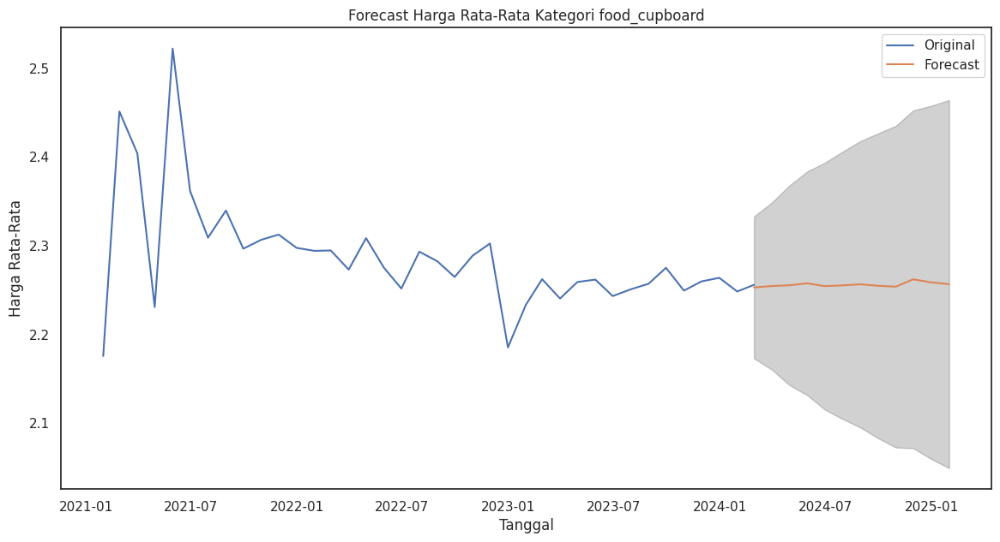

In [ ]:
#Tuning Forloop kategori Food Cupboard
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_food_cupboard = ukm[ukm['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_food_cupboard.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori food_cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori food_cupboard untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori food_cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Free From

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "Free-from"

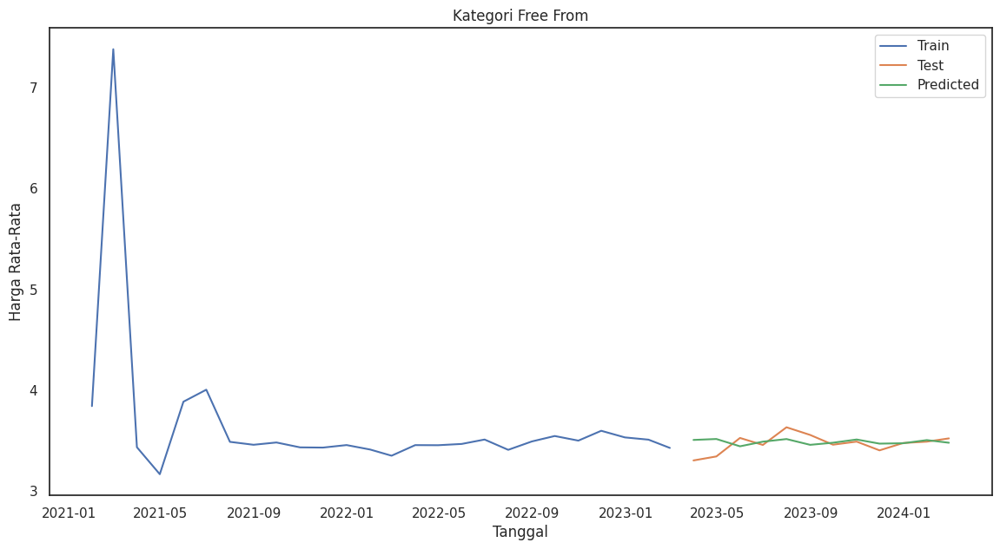

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.486856
2025-02-28    3.490171
2025-03-31    3.480642
2025-04-30    3.484952
2025-05-31    3.489655
2025-06-30    3.482602
2025-07-31    3.483928
2025-08-31    3.488789
2025-09-30    3.484091
2025-10-31    3.483542
2025-11-30    3.487841
2025-12-31    3.485113
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Free From: 0.09555638286997929
Standar deviasi: 0.022804163862731822
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                 -28.944
Date:                Fri, 07 Jun 2024   AIC                             63.888
Time:                        07:52:24   BIC                             67.544
Sample:                    01-31-2021   HQIC                            64.902
                         - 02-28-2023                                  

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_Ff = ukm[ukm['kategori'] =='free-from']
df_monthly = ukm_Ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 1, 0))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Free From: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas merupakan implementasi model ARIMA untuk memRamalan harga rata-rata bulanan kategori produk 'free-from'. Model digunakan untuk melakukan forecasting dari Januari hingga Desember 2025. Dari syntax di atas didapatkan hasil RMSE sebesar 0.095 diikuti dengan std sebesar 0.022.

Best ARIMA order: (1, 1, 0) with RMSE: 0.08764037134583318


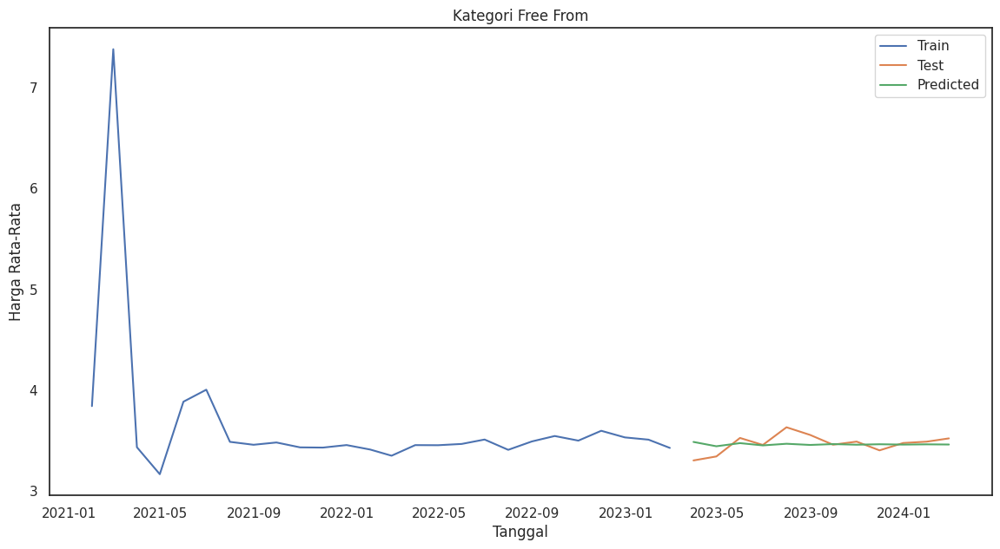

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.462619
2025-02-28    3.462584
2025-03-31    3.462610
2025-04-30    3.462591
2025-05-31    3.462604
2025-06-30    3.462595
2025-07-31    3.462602
2025-08-31    3.462597
2025-09-30    3.462600
2025-10-31    3.462598
2025-11-30    3.462600
2025-12-31    3.462598
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Free: 0.08764037134583318
Standar deviasi: 0.010340579214445277
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 0)   Log Likelihood                 -32.208
Date:                Fri, 07 Jun 2024   AIC                             68.416
Time:                        07:52:25   BIC                             70.853
Sample:                    01-31-2021   HQIC                            69.092
                         - 02-28-2023                                       

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_Ff = ukm[ukm['kategori'] == 'free-from']
df_monthly = ukm_Ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Free: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Setelah itu, dilakukan proses tunning seperti pada kategori lainnya. Berdasarkan output di atas, diperoleh nili RMSEnya sebesar 0.087 dan nilai stdnya 0.010. Nilai RMSE dan std ini merupakan nilai lebih kecil dari nilai sebelum dilakukan tunning.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "free-from"

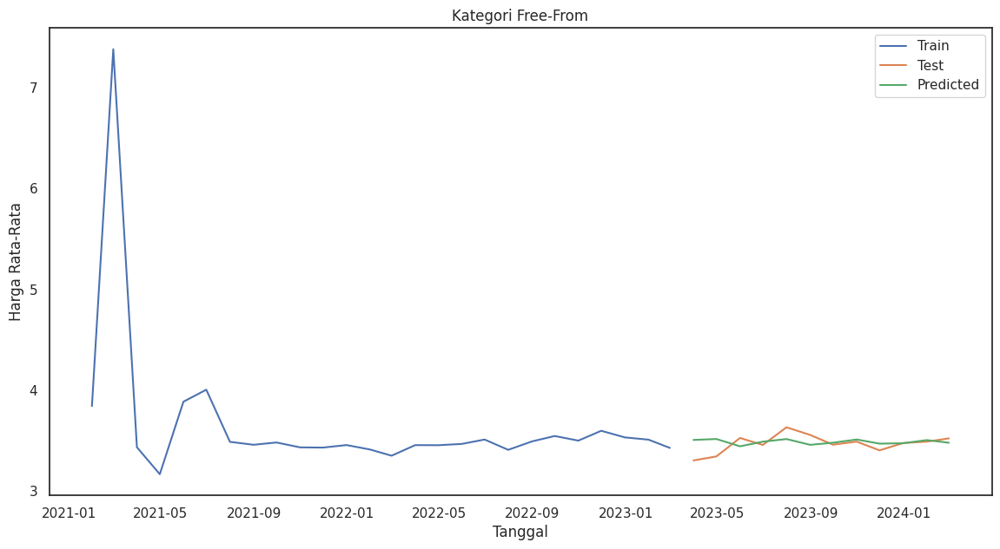

RMSE Kategori free_from: 0.09555638286997929
Standar deviasi: 0.022804163862731822
AIC: 63.8878578255872
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 -28.944
Date:                Fri, 07 Jun 2024   AIC                             63.888
Time:                        07:52:26   BIC                             67.544
Sample:                    01-31-2021   HQIC                            64.902
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7404      0.342     -2.164      0.030      -1.411      -0.070
ar.L2         -0.8284     

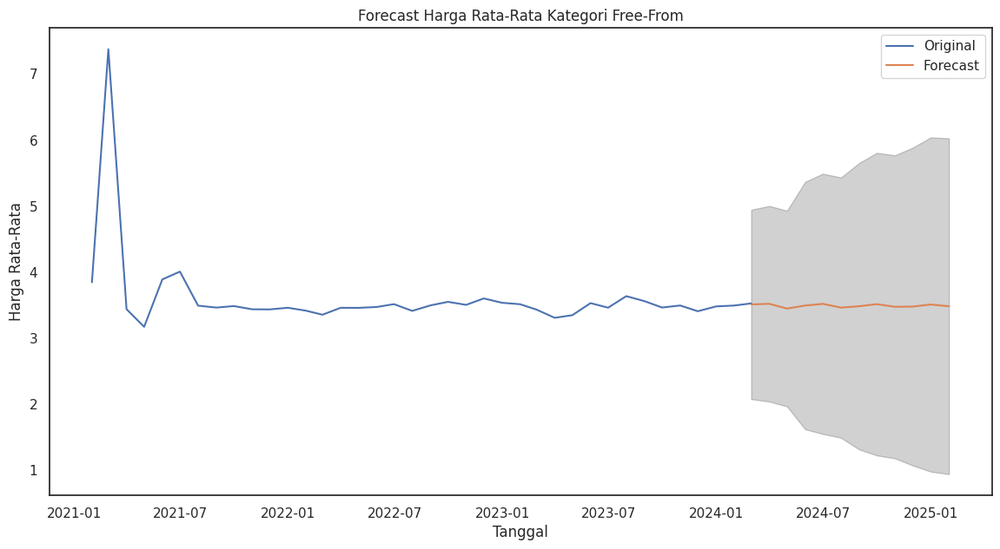

In [ ]:
#Free-From
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_ff = ukm[ukm['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori free_from: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Free-From untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'free-from'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.095, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.022.

Best SARIMA parameters: ((0, 1, 2), (0, 0, 0, 12)) with RMSE: 0.07344179015405647


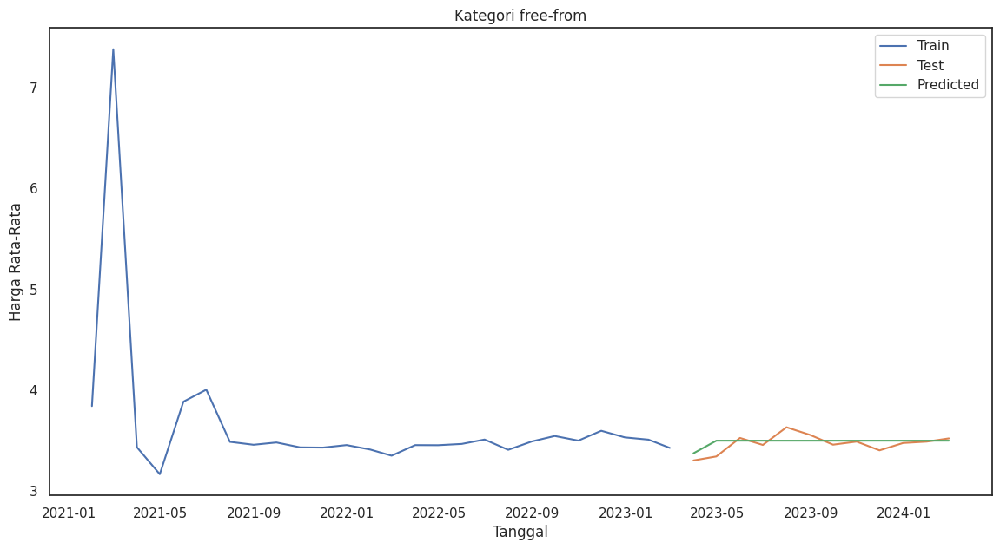

RMSE Kategori Fresh Food: 0.07344179015405647
Standar deviasi: 0.03449798570493229
AIC: -18.27216819164638
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(0, 1, 2)   Log Likelihood                  12.136
Date:                Fri, 07 Jun 2024   AIC                            -18.272
Time:                        07:53:24   BIC                            -14.999
Sample:                    01-31-2021   HQIC                           -17.501
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.267e-05   3220.505  -3.93e-09      1.000   -6312.075    6312.074
ma.L2         -1.0000   

In [ ]:
#Tuning Free-from
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_ff = ukm[ukm['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori free-from')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Fresh Food

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "fresh_food"

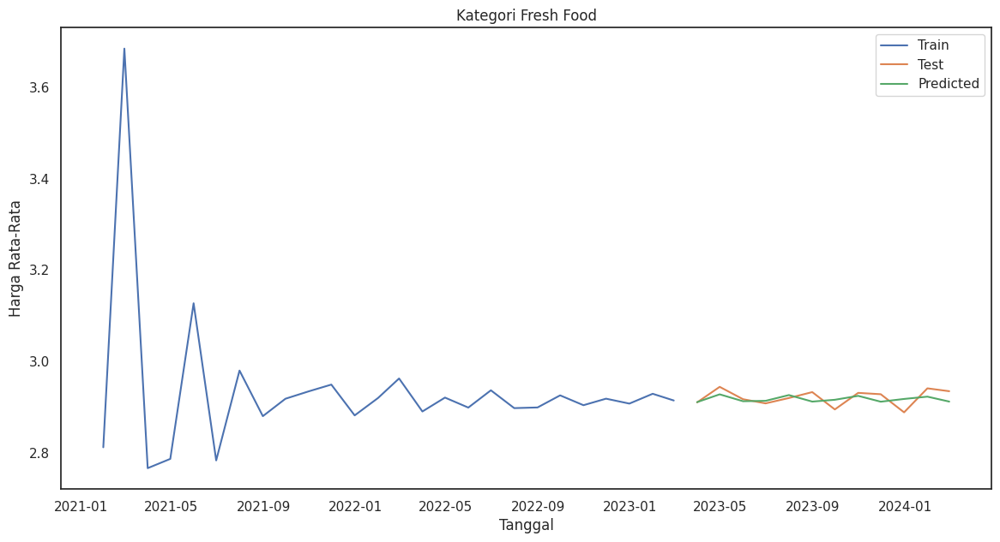

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.917804
2025-02-28    2.915083
2025-03-31    2.920514
2025-04-30    2.917135
2025-05-31    2.915877
2025-06-30    2.920264
2025-07-31    2.916689
2025-08-31    2.916580
2025-09-30    2.919910
2025-10-31    2.916437
2025-11-30    2.917169
2025-12-31    2.919506
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Fresh Food: 0.01646825843074423
Standar deviasi: 0.00604657650791533
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                  12.471
Date:                Fri, 07 Jun 2024   AIC                            -18.942
Time:                        07:53:24   BIC                            -15.285
Sample:                    01-31-2021   HQIC                           -17.928
                         - 02-28-2023                                  

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fr = ukm[ukm['kategori'] =='fresh_food']
df_monthly = ukm_fr.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 1, 0))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Fresh Food: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas melakukan analisis dan Ramalan terhadap data harga rata-rata bulanan untuk kategori "fresh_food". Data dibagi menjadi data latih (train) dan data uji (test), dengan data uji berisi 12 bulan terakhir. Selain itu, dilakukan juga peramalan harga untuk bulan Januari hingga Desember 2025. Hasil Ramalan tersebut dicetak bersama dengan Root Mean Squared Error (RMSE) senilai 0.016  untuk mengevaluasi kinerja model dengan standar deviasinya sebesar 0.006.

Best ARIMA order: (2, 1, 1) with RMSE: 0.01356421529200213


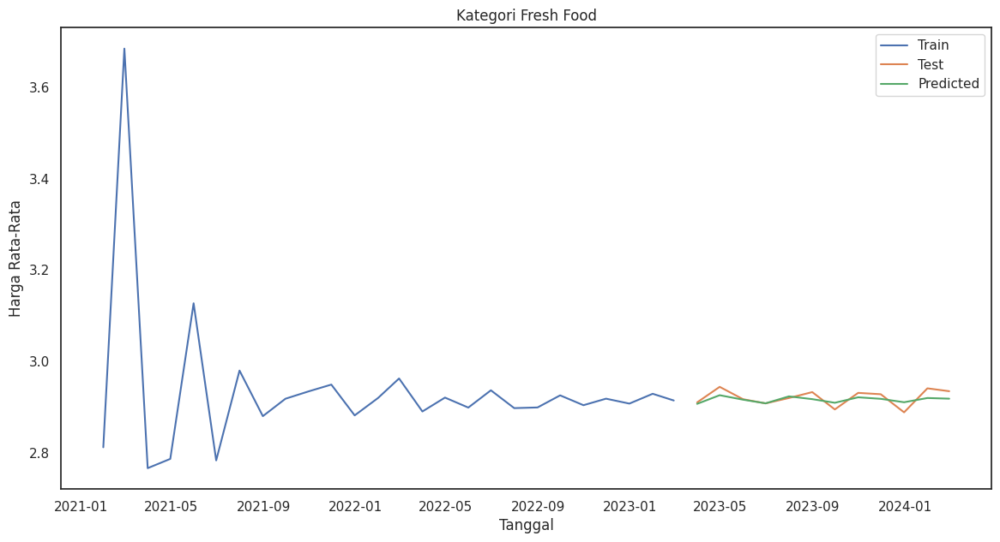

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.916692
2025-02-28    2.918158
2025-03-31    2.914738
2025-04-30    2.916386
2025-05-31    2.917930
2025-06-30    2.915196
2025-07-31    2.916193
2025-08-31    2.917699
2025-09-30    2.915558
2025-10-31    2.916082
2025-11-30    2.917481
2025-12-31    2.915839
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Fresh Food: 0.01356421529200213
Standar deviasi: 0.005934869502309375
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 1)   Log Likelihood                  12.887
Date:                Fri, 07 Jun 2024   AIC                            -17.774
Time:                        07:53:27   BIC                            -12.899
Sample:                    01-31-2021   HQIC                           -16.422
                         - 02-28-2023                                 

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fr = ukm[ukm['kategori'] == 'fresh_food']
df_monthly = ukm_fr.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Fresh Food: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Lalu, dilakukan proses tunning untuk memperoleh hasil RMSE dan stdnya yang lebih kecil. Berdasarkan outputnya nilai RMSE menjadi 0.013 dan nilai stdnya 0.005. Jika diamati emang sangat kecil penurunannya, akan tetapi hasil ini tentunya berpengaruh terhadap model.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "fresh_food"

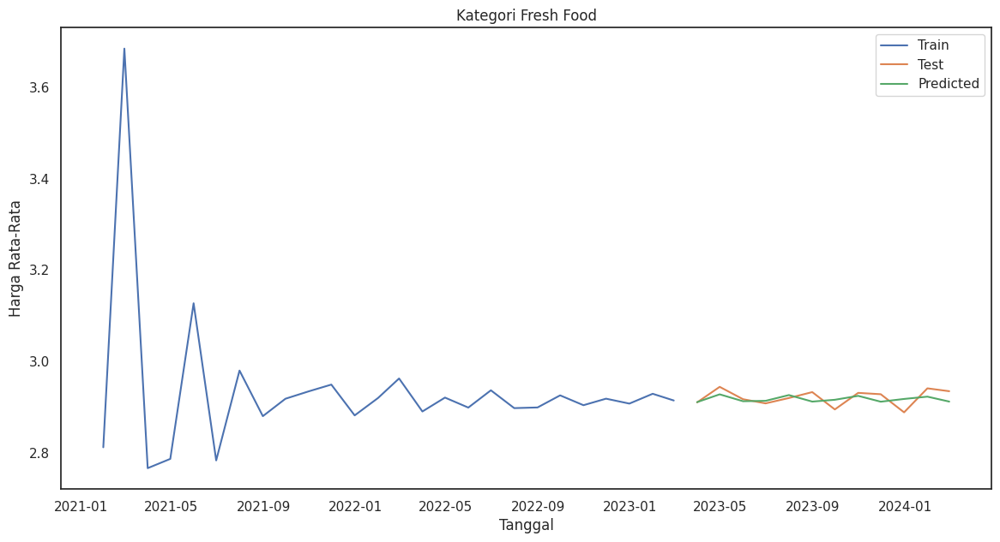

RMSE Kategori Fresh Food: 0.01646825843074423
Standar deviasi: 0.00604657650791533
AIC: -18.94188029340177
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 0)   Log Likelihood                  12.471
Date:                Fri, 07 Jun 2024   AIC                            -18.942
Time:                        07:53:28   BIC                            -15.285
Sample:                    01-31-2021   HQIC                           -17.928
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0725      0.103    -10.439      0.000      -1.274      -0.871
ar.L2         -0.8989   

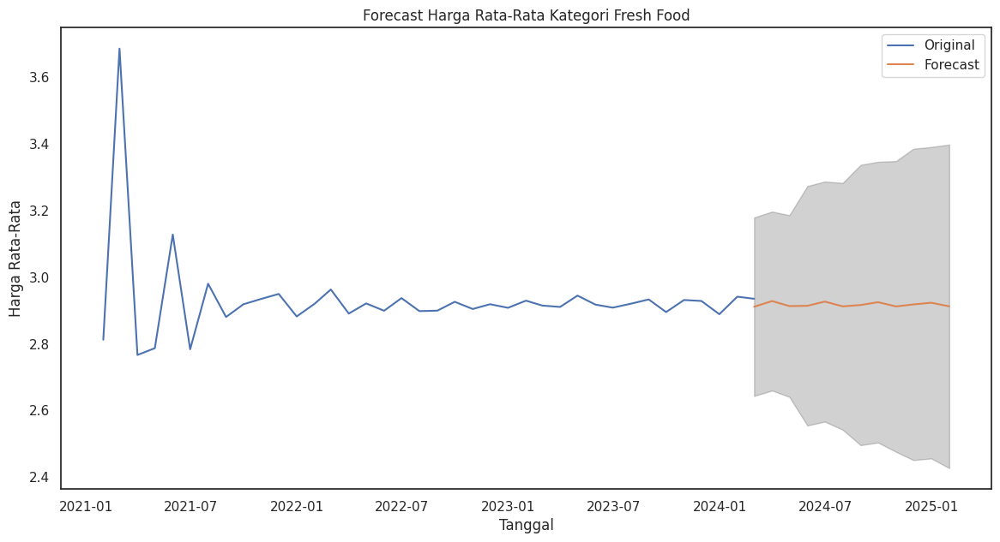

In [ ]:
#Fresh_Food
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_fresh = ukm[ukm['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Fresh Food untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'fresh_food'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.016, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.006.

Best SARIMA parameters: ((2, 2, 2), (0, 0, 1, 12)) with RMSE: 0.016351514707749405


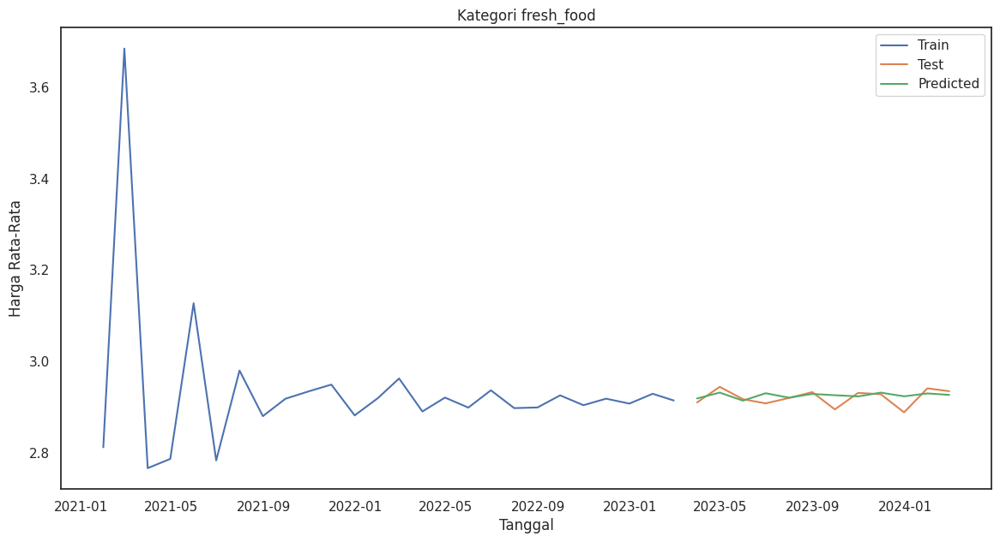

RMSE Kategori Fresh Food: 0.016351514707749405
Standar deviasi: 0.005308207753480701
AIC: -39.82675666505469
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 2, 2)x(0, 0, [1], 12)   Log Likelihood                  25.913
Date:                              Fri, 07 Jun 2024   AIC                            -39.827
Time:                                      07:54:26   BIC                            -38.643
Sample:                                  01-31-2021   HQIC                           -42.380
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_fresh = ukm[ukm['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori fresh_food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Frozen

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "frozen"

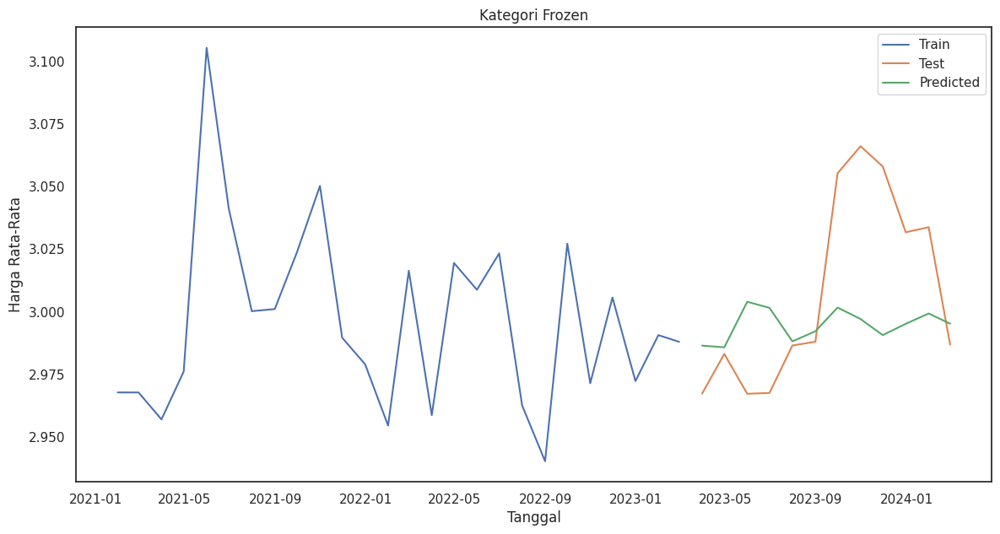

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.995895
2025-02-28    2.995014
2025-03-31    2.995453
2025-04-30    2.996049
2025-05-31    2.995620
2025-06-30    2.995238
2025-07-31    2.995625
2025-08-31    2.995851
2025-09-30    2.995522
2025-10-31    2.995404
2025-11-30    2.995672
2025-12-31    2.995718
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Frozen: 0.038329606513857056
Standar deviasi: 0.00591634180667471
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 0, 2)   Log Likelihood                  51.819
Date:                Fri, 07 Jun 2024   AIC                            -91.637
Time:                        07:54:27   BIC                            -84.089
Sample:                    01-31-2021   HQIC                           -89.464
                         - 02-28-2023                                     

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fz = ukm[ukm['kategori'] =='frozen']
df_monthly = ukm_fz.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 0, 2))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Frozen: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas merupakan syntax yang saya gunakan untuk membuat Ramalan harga dari kategori 'frozen' dengan menggunakan model ARIMA. Pada syntax di atas saya menggunakan nilai order (2, 0, 2) dengan hasil RMSE sebesar 0.038 dan std sebesar 0.005. Bentuk grafiknya pun kurang bagus.

Best ARIMA order: (1, 2, 0) with RMSE: 0.03440615420142096


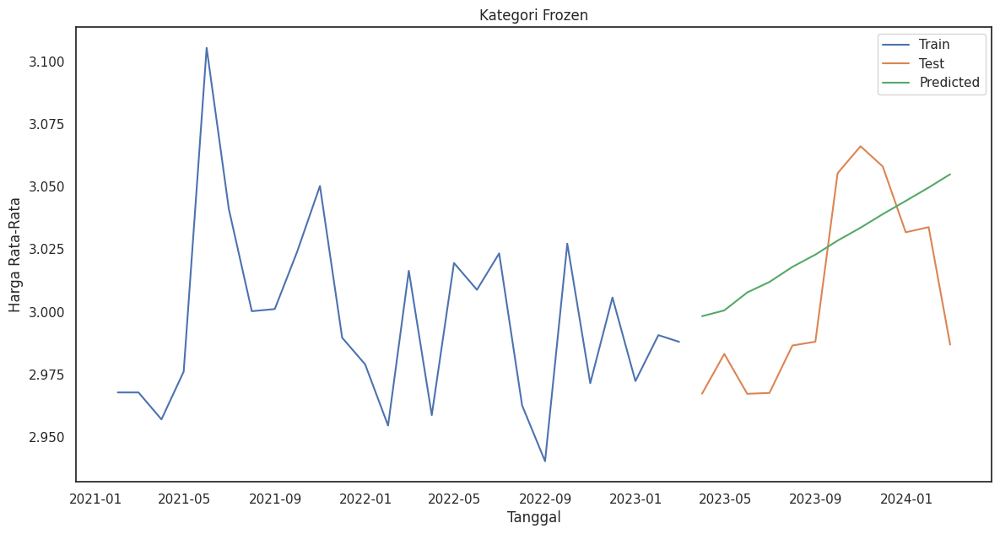

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.113390
2025-02-28    3.118708
2025-03-31    3.124026
2025-04-30    3.129344
2025-05-31    3.134662
2025-06-30    3.139980
2025-07-31    3.145298
2025-08-31    3.150616
2025-09-30    3.155933
2025-10-31    3.161251
2025-11-30    3.166569
2025-12-31    3.171887
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Frozen: 0.03440615420142096
Standar deviasi: 0.018205116101248423
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 2, 0)   Log Likelihood                  32.062
Date:                Fri, 07 Jun 2024   AIC                            -60.124
Time:                        07:54:30   BIC                            -57.768
Sample:                    01-31-2021   HQIC                           -59.499
                         - 02-28-2023                                     

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_fr = ukm[ukm['kategori'] == 'frozen']
df_monthly = ukm_fr.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Frozen: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Selanjutnya, dilakukan proses tunning. Proses tunning ini berguna untuk mengurangi hasil RMSEnya. Dari output menunjukkan hasil RMSE sebesar 0.034, akan tetapi pada kategori ini nilai stdnya lebih besar daripada sebelum dilakukan proses tuning.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "frozen"

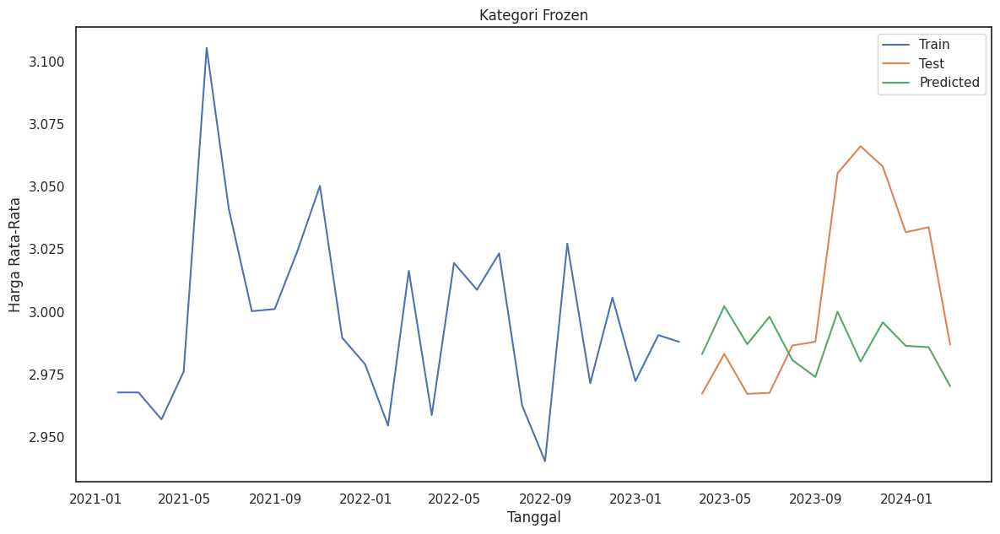

RMSE Kategori Frozen: 0.041904329385987586
Standar deviasi: 0.009794736654346619
AIC: -69.68248961230088
                                         SARIMAX Results                                          
Dep. Variable:                                 harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 0, 2)x(1, 0, [1, 2, 3], 12)   Log Likelihood                  43.841
Date:                                    Fri, 07 Jun 2024   AIC                            -69.682
Time:                                            07:54:33   BIC                            -58.360
Sample:                                        01-31-2021   HQIC                           -66.422
                                             - 02-28-2023                                         
Covariance Type:                                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------

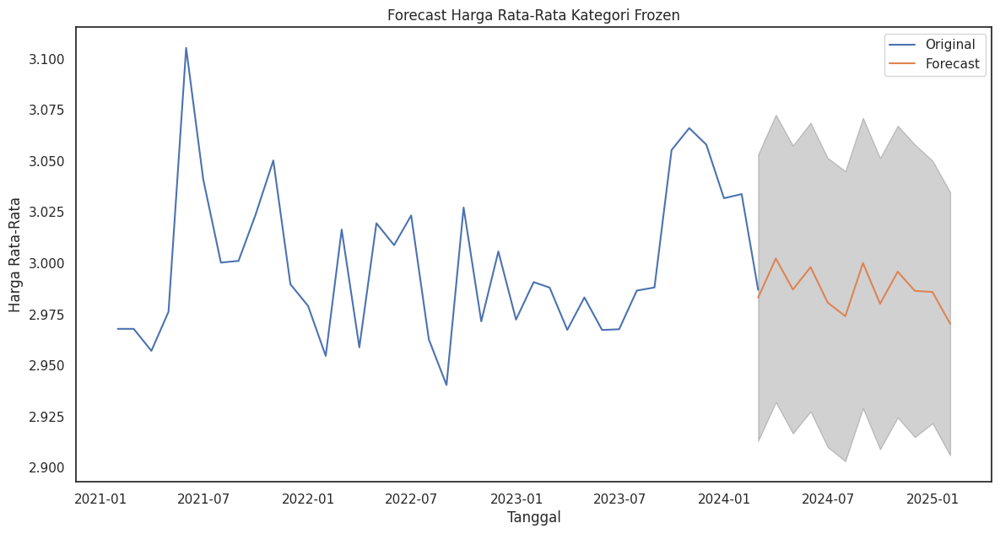

In [ ]:
#Frozen
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_frozen = ukm[ukm['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,0,2), seasonal_order=(1,0, 3, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Frozen: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'frozen'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.0426, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.00962.

Best SARIMA parameters: ((0, 2, 2), (1, 0, 1, 12)) with RMSE: 0.03017483678160863


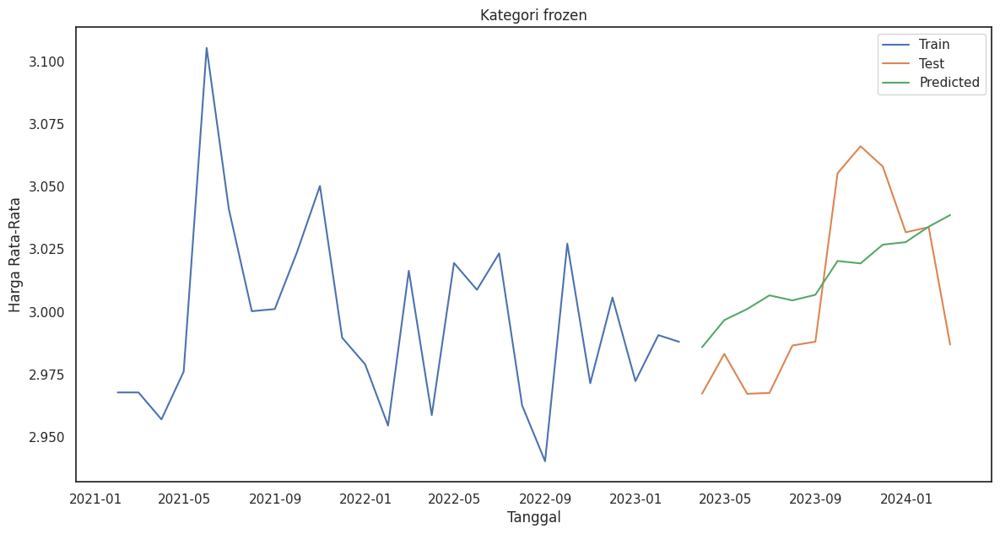

RMSE Kategori Fresh Food: 0.03017483678160863
Standar deviasi: 0.015488266052115748
AIC: -25.237607207932243
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(0, 2, 2)x(1, 0, [1], 12)   Log Likelihood                  17.619
Date:                              Fri, 07 Jun 2024   AIC                            -25.238
Time:                                      07:55:32   BIC                            -24.251
Sample:                                  01-31-2021   HQIC                           -27.366
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_frozen = ukm[ukm['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Health Products

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "health_products"

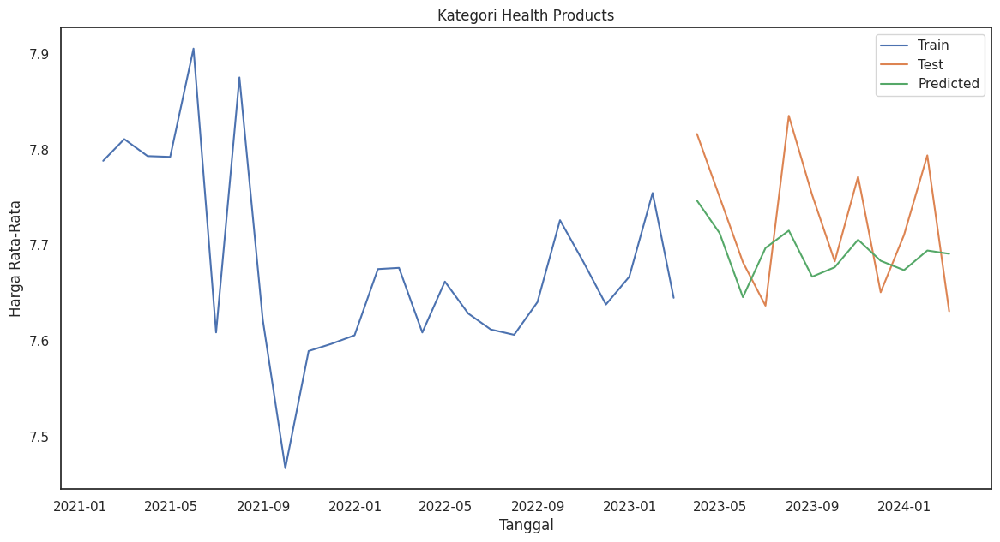

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    7.684655
2025-02-28    7.686132
2025-03-31    7.687244
2025-04-30    7.685627
2025-05-31    7.685645
2025-06-30    7.686794
2025-07-31    7.686202
2025-08-31    7.685677
2025-09-30    7.686365
2025-10-31    7.686395
2025-11-30    7.685887
2025-12-31    7.686121
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Health Products: 0.0666047519425858
Standar deviasi: 0.02508920584318173
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(3, 0, 2)   Log Likelihood                  28.397
Date:                Fri, 07 Jun 2024   AIC                            -42.794
Time:                        07:55:33   BIC                            -33.988
Sample:                    01-31-2021   HQIC                           -40.258
                         - 02-28-2023                              

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hp = ukm[ukm['kategori'] =='health_products']
df_monthly = ukm_hp.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(3, 0, 2))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Health Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Health Products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas untuk memRamalan harga pada kategori 'health-products'. Dalam syntax di atas kami menggunakan nilai order (3, 0, 2) didapatkan nilai RMSEnya 0.066 dan nilai stdnya 0.025.

Best ARIMA order: None with AIC: inf


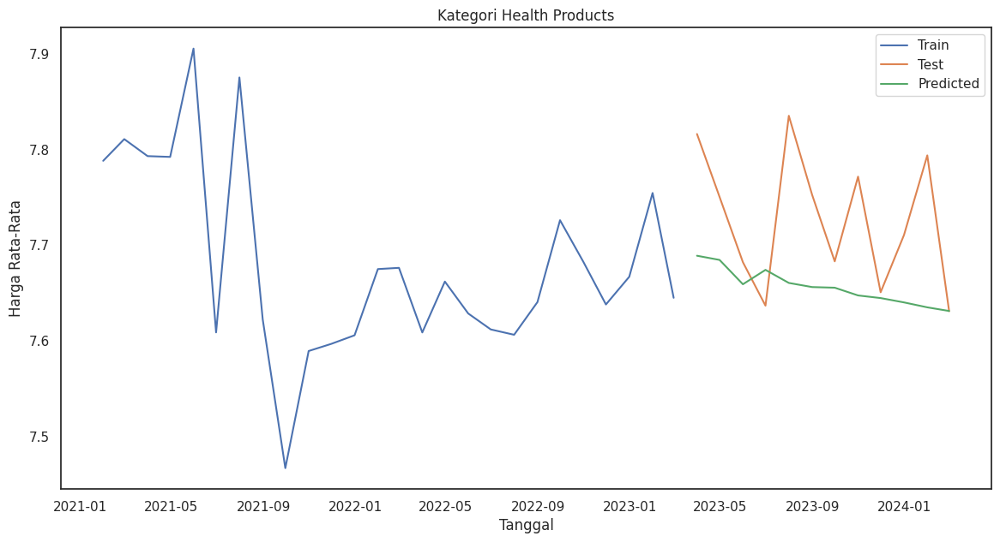

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    7.581737
2025-02-28    7.577260
2025-03-31    7.572790
2025-04-30    7.568317
2025-05-31    7.563843
2025-06-30    7.559372
2025-07-31    7.554899
2025-08-31    7.550426
2025-09-30    7.545954
2025-10-31    7.541481
2025-11-30    7.537008
2025-12-31    7.532536
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Health Products: 0.09513058522700342
Standar deviasi: 0.01771055406913082
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 2, 2)   Log Likelihood                  20.964
Date:                Fri, 07 Jun 2024   AIC                            -31.929
Time:                        07:55:35   BIC                            -26.039
Sample:                    01-31-2021   HQIC                           -30.366
                         - 02-28-2023                             

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hp = ukm[ukm['kategori'] == 'health_products']
df_monthly = ukm_hp.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_aic = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Evaluasi model dengan AIC
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with AIC: {best_aic}")

# Ramalan pada data test dengan model terbaik
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Health Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Health Products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Kemudian, dilakukan proses tunning

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "Health_products"

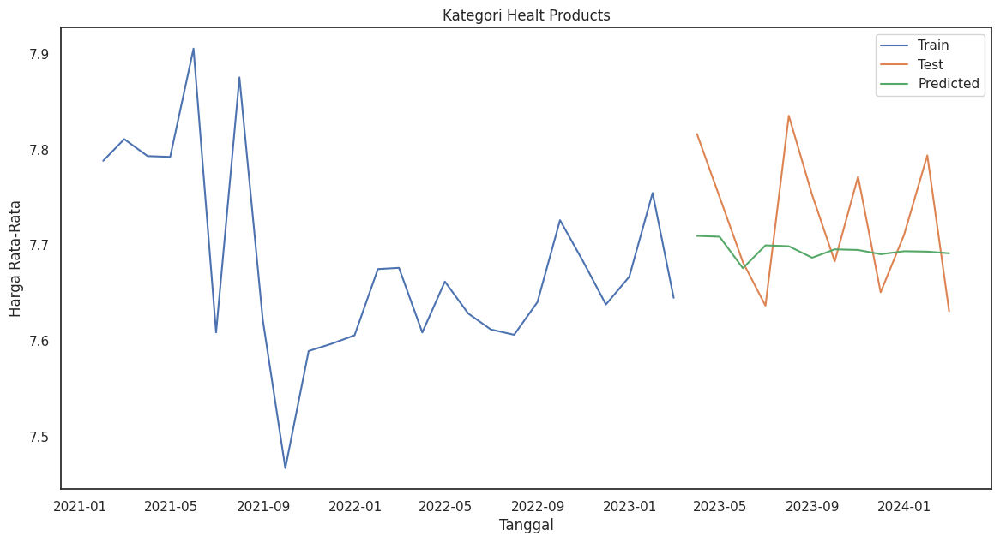

RMSE Kategori Healt Products: 0.07167874066479335
Standar deviasi: 0.008708927033188901
AIC: -30.518344009324473
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(3, 0, 2)   Log Likelihood                  21.259
Date:                Fri, 07 Jun 2024   AIC                            -30.518
Time:                        07:55:36   BIC                            -22.970
Sample:                    01-31-2021   HQIC                           -28.345
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2745      0.994      0.276      0.782      -1.674       2.223
ar.L2          0.2

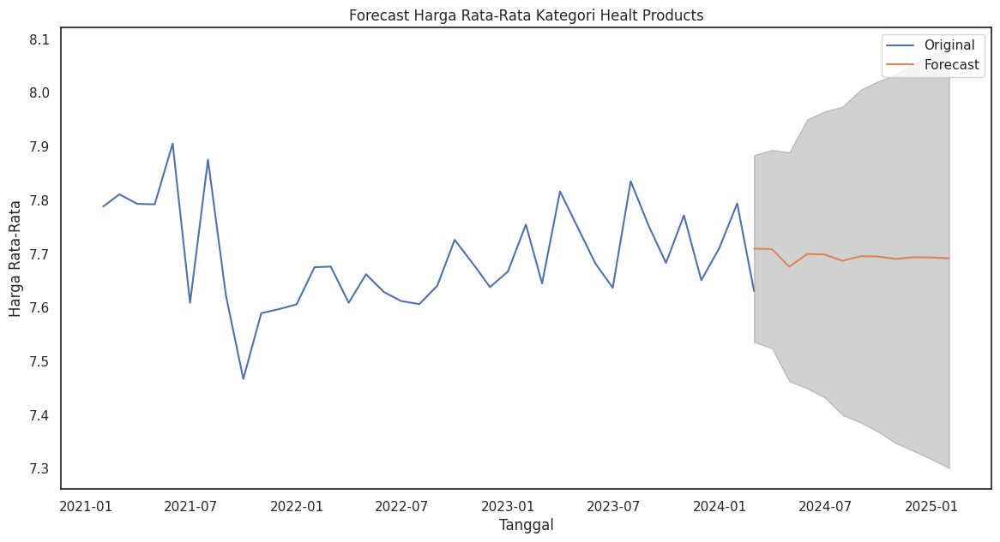

In [ ]:
#Health Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_health = ukm[ukm['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3,0,2), seasonal_order=(0,0,0,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Healt Products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Healt Products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'health_products'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.0716, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.0087.

Best SARIMA parameters: ((2, 1, 2), (0, 0, 0, 12)) with RMSE: 0.07206944982398765


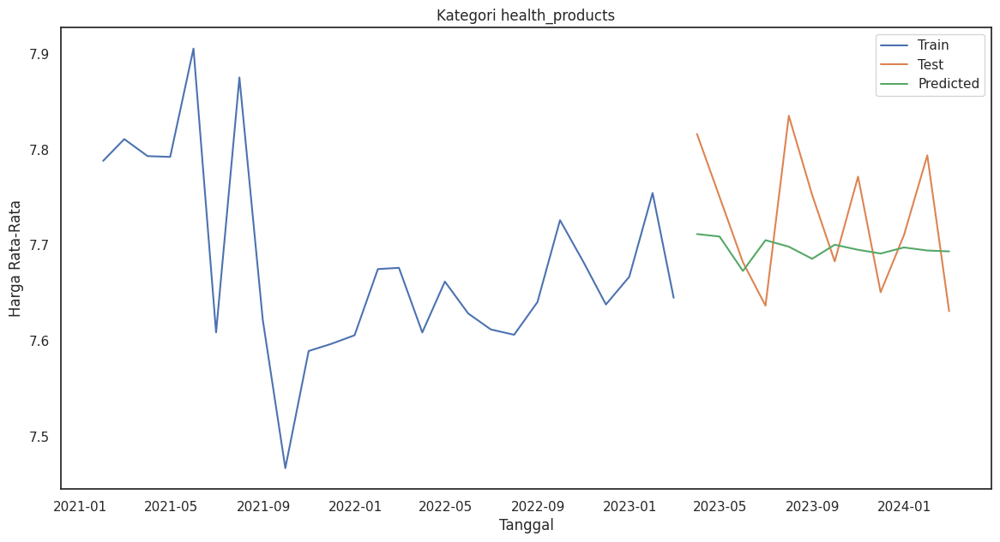

RMSE Kategori Fresh Food: 0.07206944982398765
Standar deviasi: 0.009955044090928138
AIC: -31.33685192389055
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 2)   Log Likelihood                  20.668
Date:                Fri, 07 Jun 2024   AIC                            -31.337
Time:                        07:56:29   BIC                            -25.882
Sample:                    01-31-2021   HQIC                           -30.052
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8532      0.735     -1.161      0.246      -2.294       0.587
ar.L2         -0.5734  

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_health = ukm[ukm['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori health_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Health Products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning memperoleh parameter terbaik namun metric evaluasi RMSE lebih besar dari sebelumnya, sehingga hasil tuning ini tidak lebih baik dari sebelumnya

##Home

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "home"

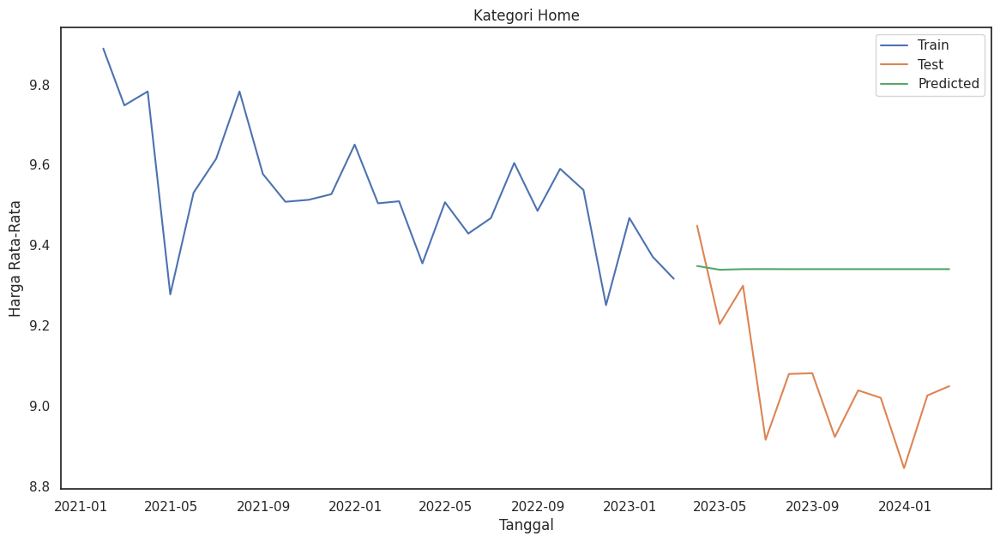

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    9.34027
2025-02-28    9.34027
2025-03-31    9.34027
2025-04-30    9.34027
2025-05-31    9.34027
2025-06-30    9.34027
2025-07-31    9.34027
2025-08-31    9.34027
2025-09-30    9.34027
2025-10-31    9.34027
2025-11-30    9.34027
2025-12-31    9.34027
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Home: 0.3083734474654029
Standar deviasi: 0.0022508624056553628
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                  11.494
Date:                Fri, 07 Jun 2024   AIC                            -16.987
Time:                        07:56:29   BIC                            -13.331
Sample:                    01-31-2021   HQIC                           -15.973
                         - 02-28-2023                                         
Covarianc

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hm = ukm[ukm['kategori'] =='home']
df_monthly = ukm_hm.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 1, 0))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Home: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas digunakan untuk memRamalan harga di masa depan dari kategori Home. Di atas saya mencoba memRamalan menggunakan nilai order (2, 1, 0) didapatkan hasil RMSE 0.30 dan std 0.0025 serta grafik yang menunjukkan sangat overfitting.

Best ARIMA order: (0, 2, 1) with RMSE: 0.15347091780087585


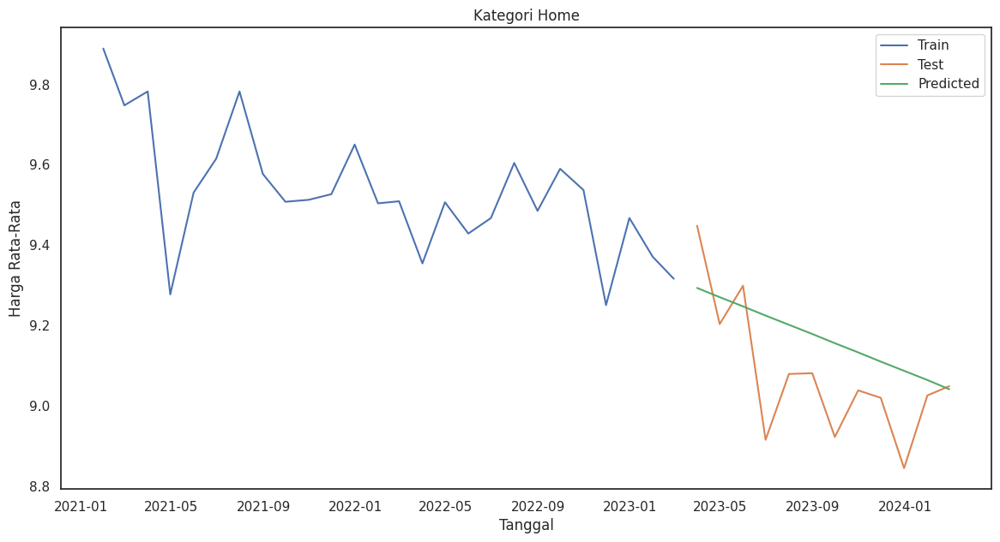

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    8.789710
2025-02-28    8.766811
2025-03-31    8.743911
2025-04-30    8.721011
2025-05-31    8.698111
2025-06-30    8.675211
2025-07-31    8.652312
2025-08-31    8.629412
2025-09-30    8.606512
2025-10-31    8.583612
2025-11-30    8.560712
2025-12-31    8.537813
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Home: 0.15347091780087585
Standar deviasi: 0.07905129611355957
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 2, 1)   Log Likelihood                   6.957
Date:                Fri, 07 Jun 2024   AIC                             -9.914
Time:                        07:56:32   BIC                             -7.558
Sample:                    01-31-2021   HQIC                            -9.289
                         - 02-28-2023                                        

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hm = ukm[ukm['kategori'] == 'home']
df_monthly = ukm_hm.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Home: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Hasil tuningan di atas memang mengalami penurunan dari segi nilai RMSE dan stdnya. Akan tetapi hasil grafik garis Ramalannya juga mengalami penurunan.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "home"

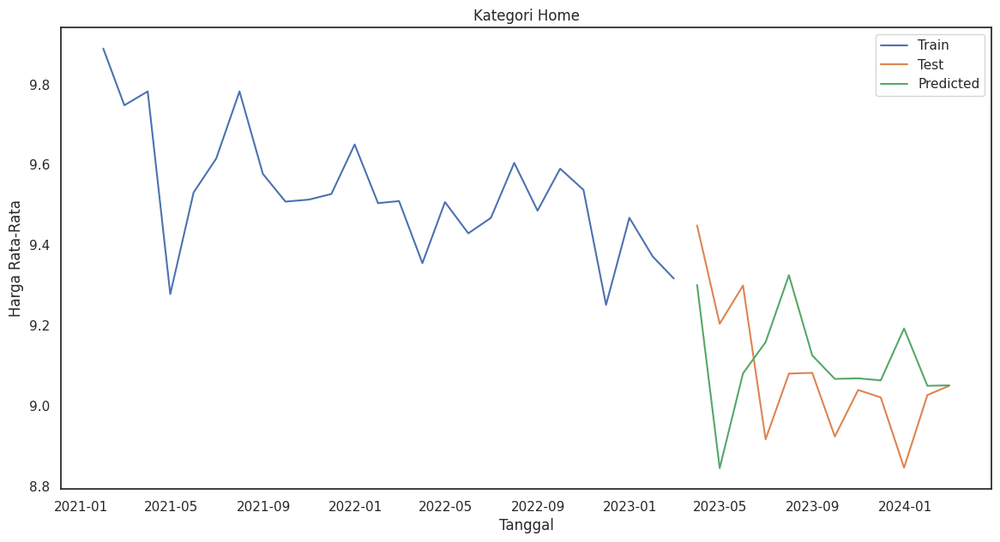

RMSE Kategori Home : 0.19654055106297516
Standar deviasi: 0.12122105147114712
AIC: 4.617074155707777
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 1, 0)x(2, 1, 0, 12)   Log Likelihood                   2.691
Date:                            Fri, 07 Jun 2024   AIC                              4.617
Time:                                    07:56:35   BIC                              7.442
Sample:                                01-31-2021   HQIC                             4.036
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1        

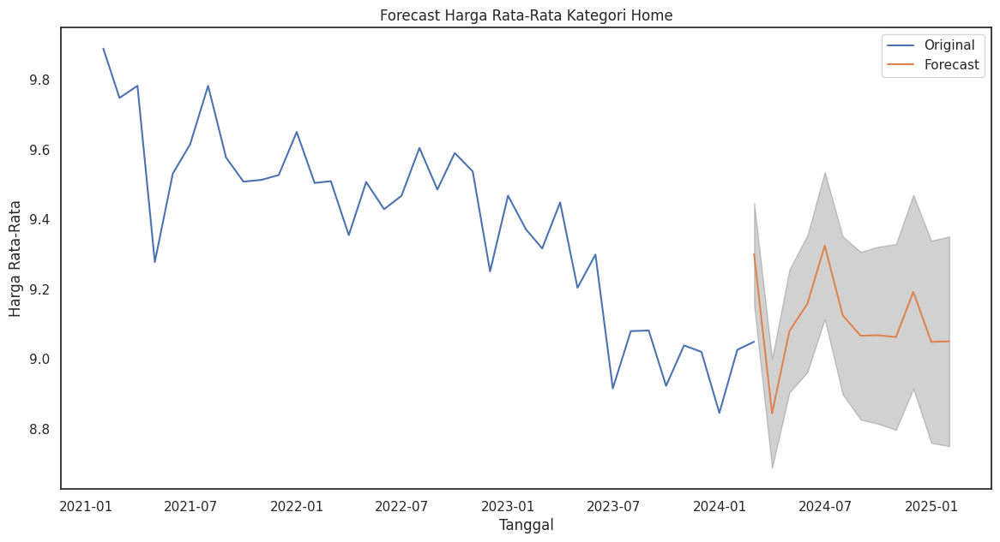

In [ ]:
#Home
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_home = ukm[ukm['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(2,1,0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Home : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Home untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'home'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.1965, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.121.

Best SARIMA parameters: ((1, 2, 2), (2, 0, 0, 12)) with RMSE: 0.13018656127624353


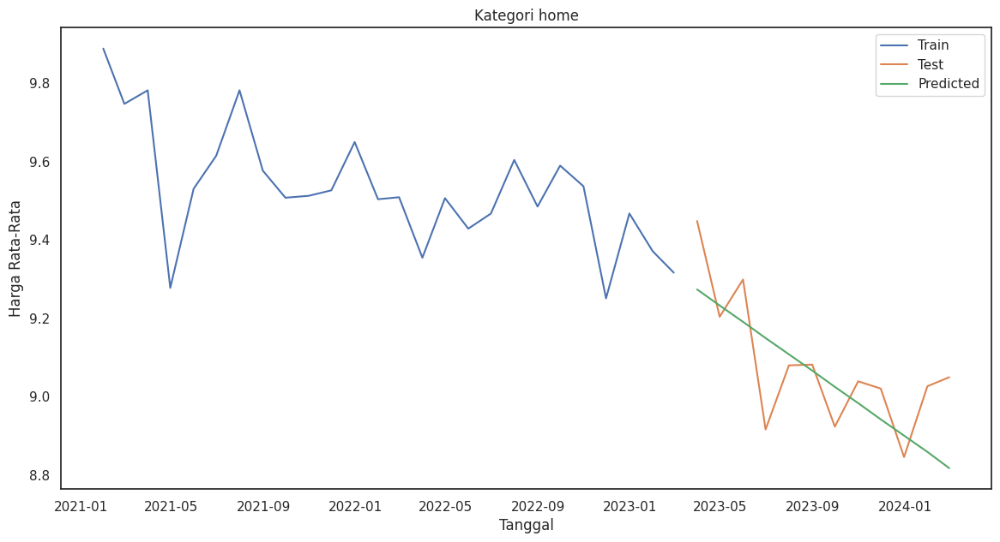

RMSE Kategori Home: 0.13018656127624353
Standar deviasi: 0.1433723024586211
AIC: 12.0
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 2, 2)x(2, 0, [], 12)   Log Likelihood                   0.000
Date:                             Fri, 07 Jun 2024   AIC                             12.000
Time:                                     07:57:29   BIC                                nan
Sample:                                 01-31-2021   HQIC                               nan
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.355

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_home = ukm[ukm['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Home: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Home untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Household

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "household"

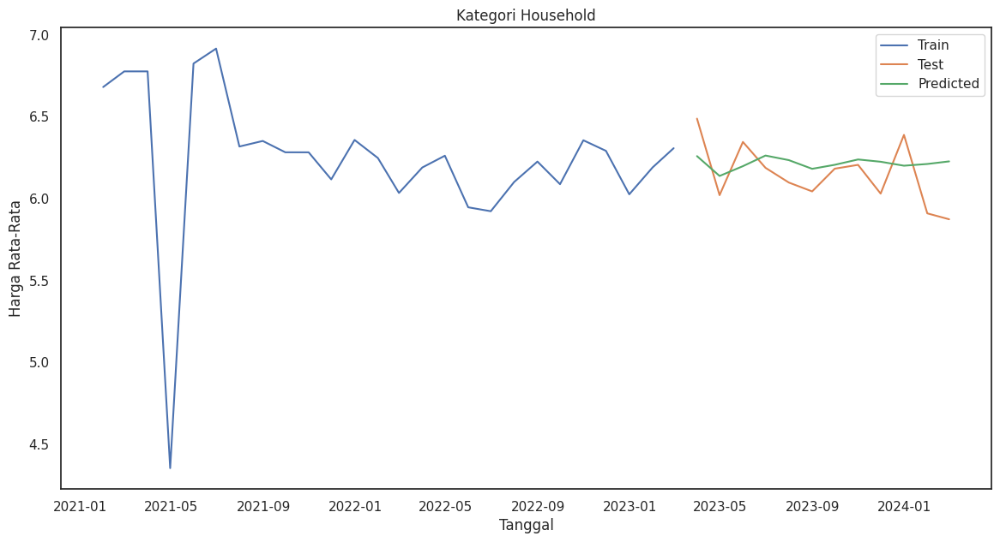

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    6.216320
2025-02-28    6.218028
2025-03-31    6.217408
2025-04-30    6.216231
2025-05-31    6.216649
2025-06-30    6.217456
2025-07-31    6.217177
2025-08-31    6.216622
2025-09-30    6.216809
2025-10-31    6.217191
2025-11-30    6.217065
2025-12-31    6.216803
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Household: 0.18760113763700187
Standar deviasi: 0.03298865594111979
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(3, 0, 2)   Log Likelihood                 -13.221
Date:                Fri, 07 Jun 2024   AIC                             40.441
Time:                        07:57:30   BIC                             49.248
Sample:                    01-31-2021   HQIC                            42.977
                         - 02-28-2023                                   

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hh = ukm[ukm['kategori'] =='household']
df_monthly = ukm_hh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(3, 0, 2))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Household: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas menggunakan model ARIMA untuk memRamalan harga rata-rata bulanan dari kategori produk 'household'. Output menunjukkan bahwa model ARIMA memberikan Ramalan yang cukup baik dengan RMSE 0.18, yang menunjukkan kesalahan Ramalan rata-rata yang kecil, dan standar deviasi 0.032, menunjukkan variabilitas Ramalan yang relatif rendah.

Best ARIMA order: (1, 2, 1) with RMSE: 0.16168190319093667


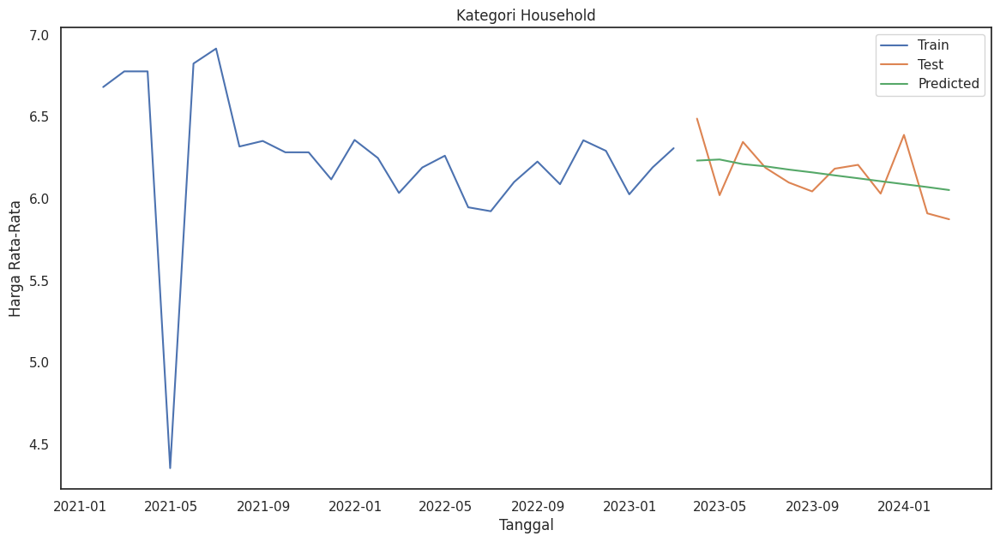

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.855515
2025-02-28    5.837600
2025-03-31    5.819685
2025-04-30    5.801770
2025-05-31    5.783855
2025-06-30    5.765940
2025-07-31    5.748026
2025-08-31    5.730111
2025-09-30    5.712196
2025-10-31    5.694281
2025-11-30    5.676366
2025-12-31    5.658451
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Household: 0.16168190319093667
Standar deviasi: 0.060366697415018815
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 2, 1)   Log Likelihood                 -25.732
Date:                Fri, 07 Jun 2024   AIC                             57.464
Time:                        07:57:32   BIC                             60.998
Sample:                    01-31-2021   HQIC                            58.402
                         - 02-28-2023                                  

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_hh = ukm[ukm['kategori'] == 'household']
df_monthly = ukm_hh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Household: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Pada kategori 'household' ini, sama seperti pada kategori 'home'. Memang nilai RMSE dan stdnya lebih kecil, akan tetapi grafik dari garis Ramalannya pun mengikuti pola penurunan.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "household"

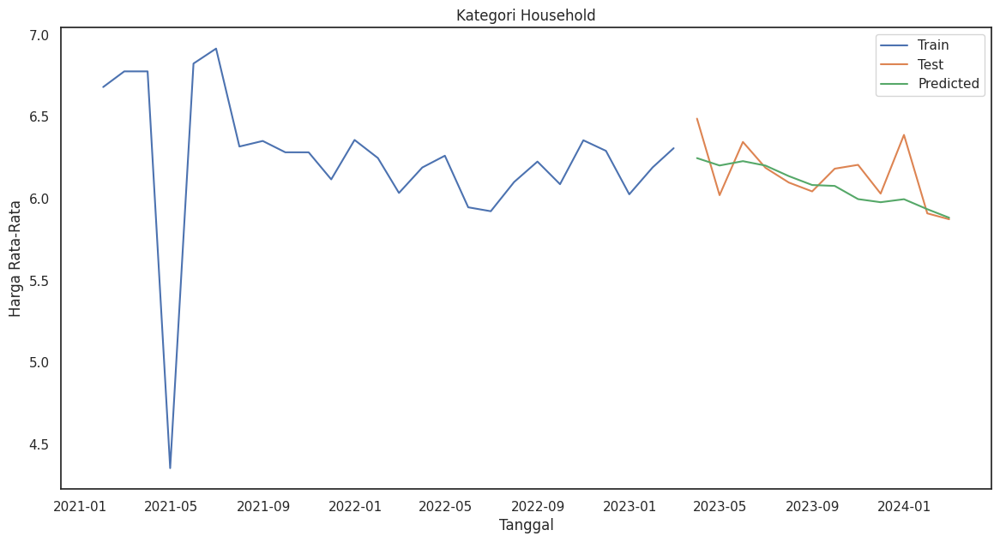

RMSE Kategori Household : 0.16348143337603474
Standar deviasi: 0.11800161640676766
AIC: 66.46548894340845
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 0, 0)x(1, 0, 0, 12)   Log Likelihood                 -30.233
Date:                            Fri, 07 Jun 2024   AIC                             66.465
Time:                                    07:57:33   BIC                             70.240
Sample:                                01-31-2021   HQIC                            67.552
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1   

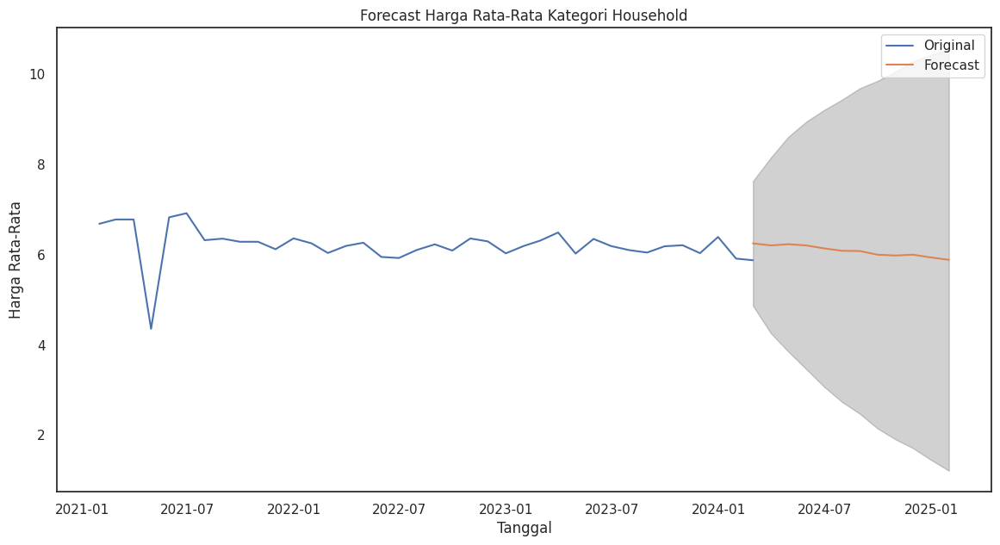

In [ ]:
#Household
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'bakery' saja
ukm_household = ukm[ukm['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_household.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], oorder=(0,3,3), seasonal_order=(1,0,0,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Household : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Household untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'pets'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.1634, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.118.

Best SARIMA parameters: ((0, 1, 2), (0, 0, 1, 12)) with RMSE: 0.15524531586838622


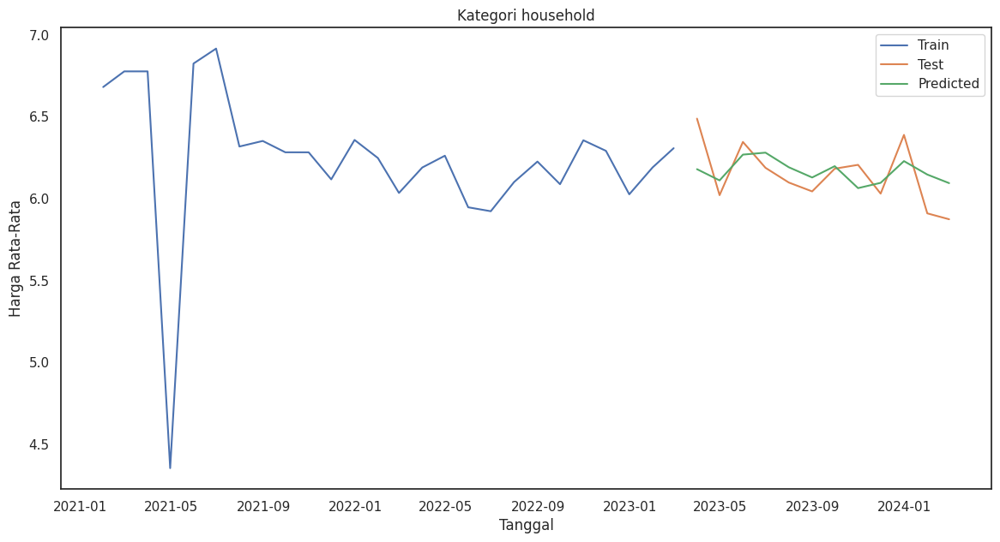

RMSE Kategori Fresh Food: 0.15524531586838622
Standar deviasi: 0.06748368597444673
AIC: -1.3675361692000578
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(0, 1, 2)x(0, 0, [1], 12)   Log Likelihood                   4.684
Date:                              Fri, 07 Jun 2024   AIC                             -1.368
Time:                                      07:58:24   BIC                             -0.157
Sample:                                  01-31-2021   HQIC                            -2.695
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_household = ukm[ukm['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_household.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())
# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

##Pets

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "pets"

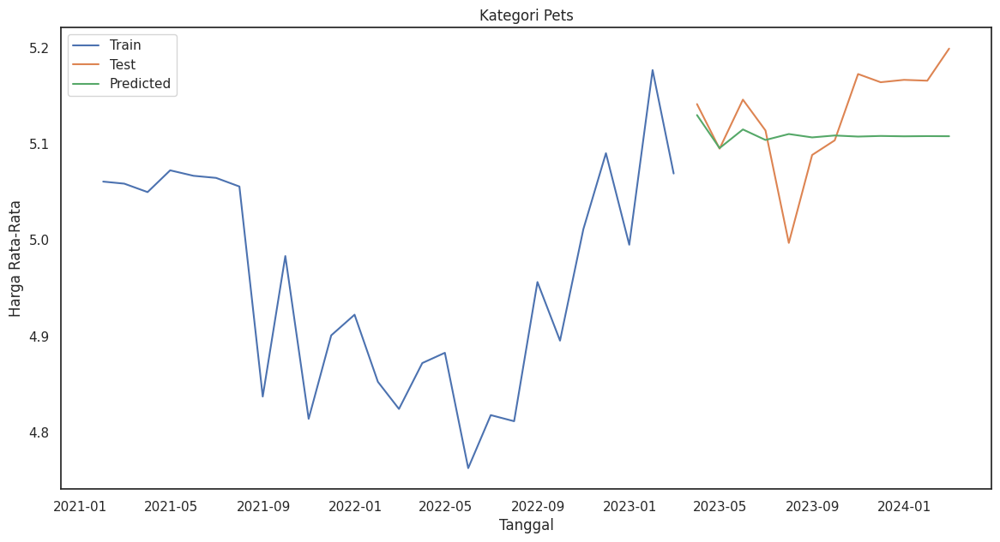

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.108046
2025-02-28    5.108046
2025-03-31    5.108046
2025-04-30    5.108046
2025-05-31    5.108046
2025-06-30    5.108046
2025-07-31    5.108046
2025-08-31    5.108046
2025-09-30    5.108046
2025-10-31    5.108046
2025-11-30    5.108046
2025-12-31    5.108046
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Pets: 0.05543094092132228
Standar deviasi: 0.007593256486006051
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                  27.888
Date:                Fri, 07 Jun 2024   AIC                            -49.776
Time:                        07:58:25   BIC                            -46.119
Sample:                    01-31-2021   HQIC                           -48.762
                         - 02-28-2023                                       

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_pe = ukm[ukm['kategori'] =='pets']
df_monthly = ukm_pe.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(2, 1, 0))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Pets: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())


Syntax di atas merupakan implementasi dari analisis data time series menggunakan model ARIMA. Data dibagi menjadi data pelatihan dan data uji untuk evaluasi model. Dari analisis ARIMA didapatkan nilai RMSEnya sebesar 0.055 dan nilai stdnya 0.0075.

Best ARIMA order: (2, 1, 1) with RMSE: 0.05179874685949534


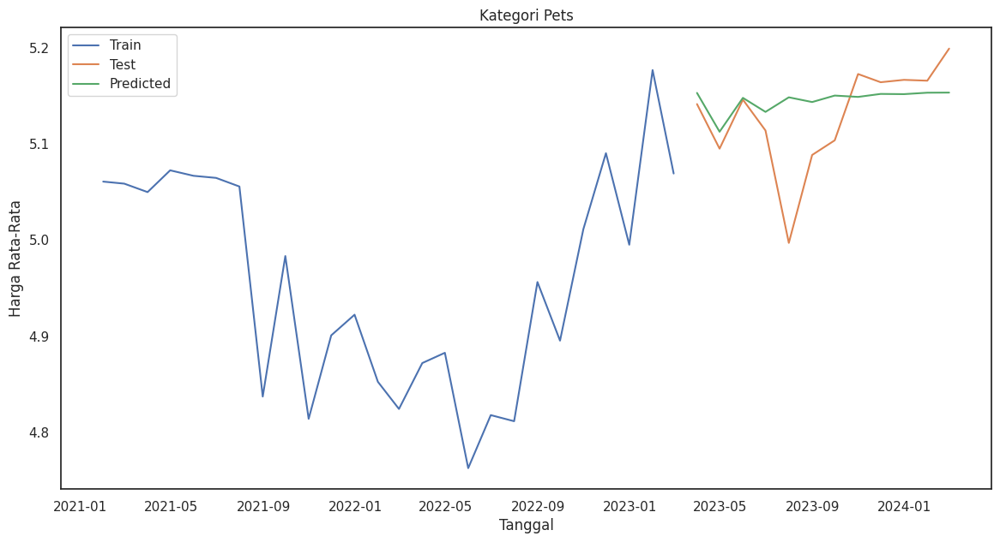

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.155568
2025-02-28    5.155597
2025-03-31    5.155622
2025-04-30    5.155639
2025-05-31    5.155654
2025-06-30    5.155665
2025-07-31    5.155675
2025-08-31    5.155681
2025-09-30    5.155687
2025-10-31    5.155691
2025-11-30    5.155694
2025-12-31    5.155697
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Pets: 0.05179874685949534
Standar deviasi: 0.011338615564030635
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 1)   Log Likelihood                  28.177
Date:                Fri, 07 Jun 2024   AIC                            -48.355
Time:                        07:58:27   BIC                            -43.479
Sample:                    01-31-2021   HQIC                           -47.003
                         - 02-28-2023                                       

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data berdasarkan kategori yang dipilih
ukm_pe = ukm[ukm['kategori'] == 'pets']
df_monthly = ukm_pe.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Pets: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())


Sama halnya dengan pada kategori sebelumnya, pada kategori pets nilai RMSE dan stdnya mengalami penurunan. Akan tetapi hasil grafik garis Ramalannya pun mengikuti penurunan juga.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "pets"

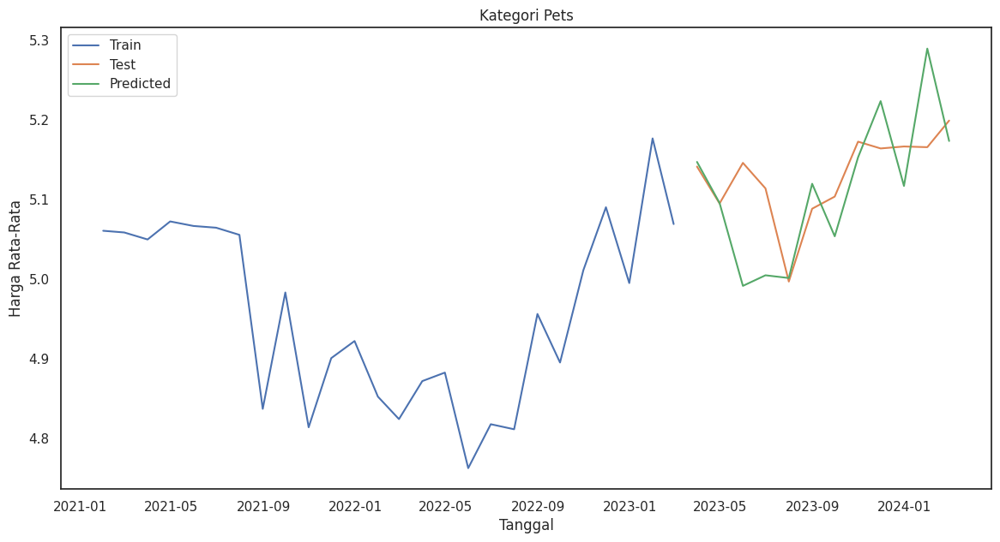

RMSE Kategori Pets : 0.07171889469105906
Standar deviasi: 0.08788847239163068
AIC: -5.201532445842142
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(3, 0, 1)x(0, 1, [], 12)   Log Likelihood                   7.601
Date:                             Fri, 07 Jun 2024   AIC                             -5.202
Time:                                     07:58:28   BIC                             -2.006
Sample:                                 01-31-2021   HQIC                            -5.497
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L

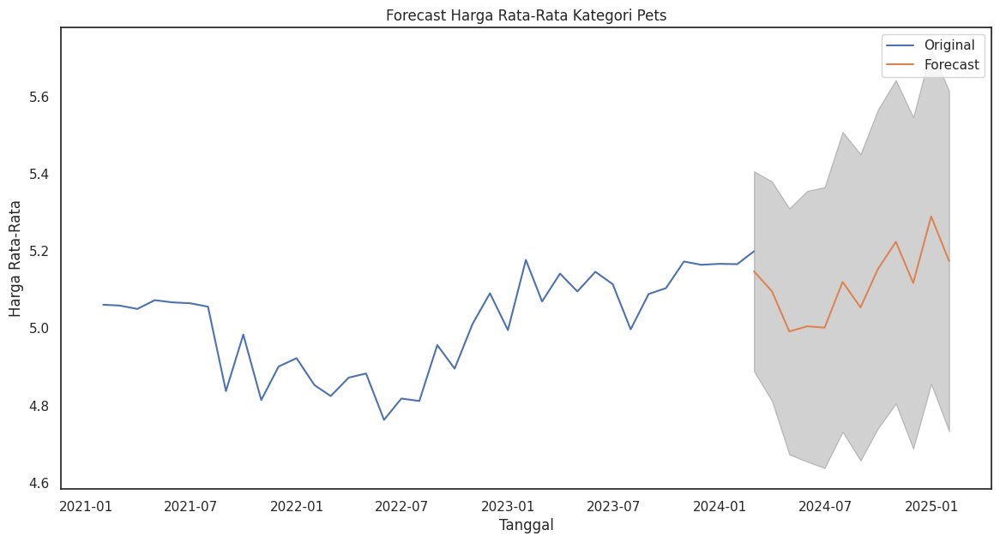

In [ ]:
#Tuning Manual Pets
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'pets' saja
ukm_pets = ukm[ukm['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = ukm_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3, 0, 1), seasonal_order=(0, 1, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Pets : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Pets untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Syntax di atas adalah implementasi model ARIMA untuk memRamalan harga rata-rata bulanan produk kategori 'pets'. Nilai RMSE (Root Mean Square Error) dihitung untuk mengevaluasi kinerja model pada data pengujian dengan nilai sebesar 0.071, dan standar deviasi dari Ramalan dihitung untuk memahami variabilitas Ramalan dengan nilai sebesar 0.0878.

Best SARIMA parameters: ((1, 2, 1), (0, 0, 2, 12)) with RMSE: 0.046963635098013545


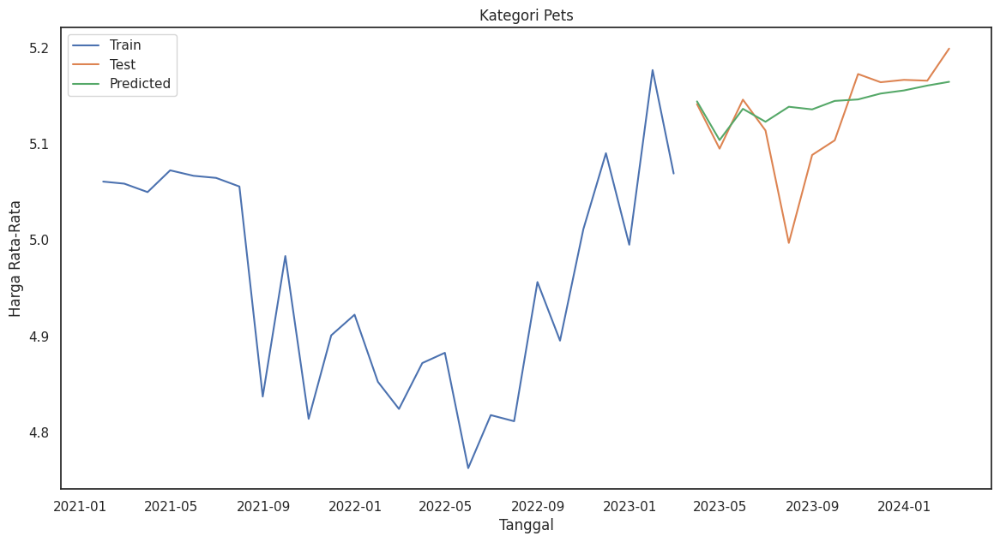

RMSE Kategori Fresh Food: 0.046963635098013545
Standar deviasi: 0.016000658229345967
AIC: 10.0
                                        SARIMAX Results                                        
Dep. Variable:                              harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 2, 1)x(0, 0, [1, 2], 12)   Log Likelihood                   0.000
Date:                                 Fri, 07 Jun 2024   AIC                             10.000
Time:                                         07:59:21   BIC                                nan
Sample:                                     01-31-2021   HQIC                               nan
                                          - 02-28-2023                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product
import warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
ukm['tanggal'] = pd.to_datetime(ukm['tanggal'])

# Filter data untuk kategori 'baby_products' saja
ukm_pets = ukm[ukm['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = ukm_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q and P, D, Q ranges
p = d = q = range(0, 3)
P = D = Q = range(0, 3)
s = [12]  # Seasonal period

# Generate all different combinations of p, d, q, P, D, Q, and s
pdq = list(product(p, d, q))
seasonal_pdq = list(product(P, D, Q, s))

# Grid search to find the best hyperparameters
best_rmse = float('inf')
best_params = None

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=param_seasonal,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit(disp=False)

            # Ramalan pada data test
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            if rmse < best_rmse:
                best_rmse = rmse
                best_params = (param, param_seasonal)
        except Exception as e:
            continue

print(f'Best SARIMA parameters: {best_params} with RMSE: {best_rmse}')

# Fit model dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params[0],
                             seasonal_order=best_params[1],
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Pets untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

Dari hasil tuning diperoleh parameter terbaik dengan RMSE lebih kecil dari sebelumnya

#**Ramalan Harga pada Toko CV Famz**

Menggunakan model ARIMA (AutoRegressive Integrated Moving Average) dan SARIMA (Seasonal AutoRegressive Integrated Moving Average) untuk memramalkan harga di masa depan dalam konteks penjualan supermarket memiliki beberapa alasan yang kuat, yaitu:

* Model ARIMA
1. ARIMA memiliki kemampuan untuk menangani data non-stasioner melalui proses differencing, sehingga membuat data menjadi stasioner dan lebih mudah untuk dimodelkan.

2. Model ARIMA menggabungkan komponen autoregressive (AR) dan moving average (MA). Komponen AR memperhitungkan hubungan antara pengamatan saat ini dan pengamatan masa lalu, sementara komponen MA memperhitungkan kesalahan (residuals) dari model di masa lalu. Sehingga memungkinkan model ARIMA untuk menangkap pola-pola kompleks dalam data penjualan dan harga.

* Model SARIMA
1. Data penjualan supermarket sering kali menunjukkan pola musiman, seperti peningkatan penjualan selama liburan atau penurunan penjualan pada bulan-bulan tertentu. SARIMA menambahkan komponen musiman ke model ARIMA, sehingga dapat menangkap dan memperhitungkan efek musiman dalam ramalan.

2. Dengan menambahkan komponen musiman (Seasonal), SARIMA dapat menangkap pola musiman yang berulang dengan interval tetap, misalnya mingguan, bulanan, atau tahunan, yang sangat umum dalam data penjualan supermarket.

Penggunaan model ARIMA dan SARIMA untuk memramalkan harga di masa depan dalam konteks penjualan supermarket didorong oleh kemampuan model ini untuk menangani data deret waktu yang kompleks, mengidentifikasi pola dan musiman, serta memberikan ramalan yang lebih akurat. Model-model ini membantu supermarket dalam membuat keputusan yang lebih baik terkait penetapan harga, perencanaan stok, dan strategi pemasaran, sehingga meningkatkan efisiensi operasional dan profitabilitas.

##Identifikasi Statisioneritas, Pola Musiman (Seasonal), ACF, dan PACF data CVFamz

In [ ]:
# Membuat salinan DataFrame all_data_le
CVFM = all_data[all_data['nama_toko']=='CVFamz'].copy()
CVFM.head()

,id_barang,nama_toko,harga_pound,harga_per_unit,unit,nama,kategori,brand_sendiri,tanggal,year_month,stock_dibeli,unit_stock
979866,100516,CVFamz,45.00,45.00,unit,TP-Link Tapo C310 Outdoor Security Wi-Fi Camera,home,False,2021-01-01,2021-01,1.0,1.0unit
979867,6914,CVFamz,55.00,55.00,unit,Amazon Echo Dot 5Th Gen Charcoal,home,False,2021-01-01,2021-01,1.0,1.0unit
979868,28341,CVFamz,20.00,4.00,m,Energizer UK 3 Pin Smart 5m Flexi Strip Light,home,False,2021-01-01,2021-01,5.0,5.0m
979869,98902,CVFamz,3.65,0.73,unit,Status Electrical PVC Insulating Tape 10 Metre...,home,False,2021-01-01,2021-01,5.0,5.0unit
979870,114630,CVFamz,17.00,17.00,unit,Wahl Colour Trim Stubble & Beard Trimmer,home,False,2021-01-01,2021-01,1.0,1.0unit


syntax di atas untuk memanggil dataset bersih yang dibutuhkan dalam Ramalan yaitu dataset toko CV Famz

Cek stasioneritas digunakan dalam analisis deret waktu (time series) untuk memastikan bahwa karakteristik statistik dari deret waktu tersebut, seperti mean dan varians, tidak berubah sepanjang waktu. Ini penting karena banyak metode analisis dan model statistik, seperti ARIMA (AutoRegressive Integrated Moving Average), mengasumsikan bahwa data yang dianalisis adalah stasioner. Jika data tidak stasioner, model tersebut dapat memberikan hasil yang tidak akurat atau menyesatkan.

Berikut adalah cek statisioneritas dengan metode Augmented Dickey-Fuller (ADF)

In [ ]:
#Stasioneritas CV FAMZ
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Membaca data
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])
time_series = CVFM['tanggal']

# Menggunakan subset data untuk mengurangi penggunaan memori
subset_size = 10000
time_series_subset = time_series[:subset_size]

# Uji stasioneritas menggunakan ADF pada subset data
result_adf = adfuller(time_series_subset)
print('Data Asli')
print('ADF Statistic:', result_adf[0])
print('p-value:', result_adf[1])
print('Critical Values:', result_adf[4])

# Jika data tidak stasioner, lakukan differencing pertama pada subset
if result_adf[1] > 0.05:
    time_series_diff = time_series_subset.diff().dropna()

    # Uji stasioneritas pada data yang telah di-differencing
    result_adf_diff = adfuller(time_series_diff)
    print('\n Data yang telah di-differencing')
    print('ADF Statistic (Differenced):', result_adf_diff[0])
    print('p-value (Differenced):', result_adf_diff[1])
    print('Critical Values (Differenced):', result_adf_diff[4])

Data Asli
ADF Statistic: 2.829348889168271
p-value: 1.0
Critical Values: {'1%': -3.4310041633725734, '5%': -2.861829101294412, '10%': -2.566923883481157}

 Data yang telah di-differencing
ADF Statistic (Differenced): -100.06009414543217
p-value (Differenced): 0.0
Critical Values (Differenced): {'1%': -3.431004228818807, '5%': -2.8618291302145686, '10%': -2.566923898875394}


Karena data asli menunjukkan tidak statisioner, maka dilakukan diferencing sebanyak 1 kali sebelum membangun model ARIMA atau SARIMA, karena data tersebut memenuhi asumsi stasioneritas yang diperlukan untuk model-model ini.

Berikut adalah pola musiman (seasonal) data CV Famz beserta ACF dan PACF nya.

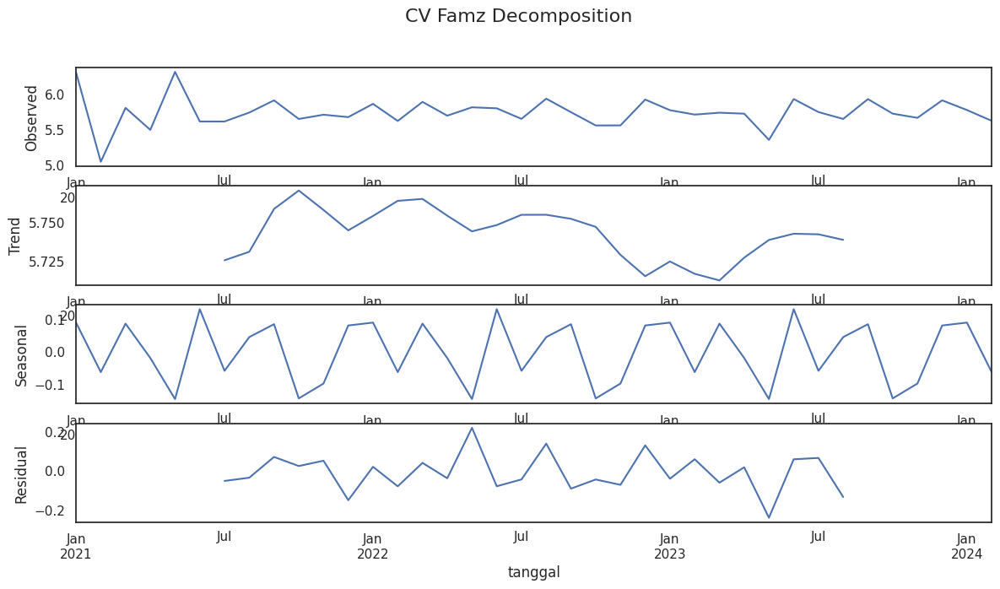

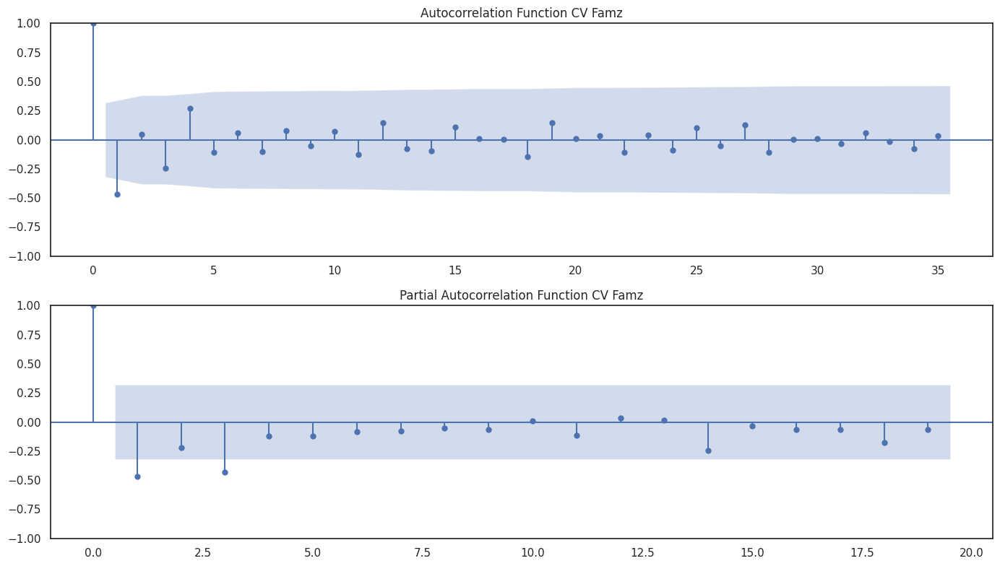

In [ ]:
#Pola Musiman CVFamz
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])
df_monthly = CVFM.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('CV Famz Decomposition', fontsize=16)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function CV Famz')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function CV Famz')

plt.tight_layout()
plt.show()

Berdasarkan identifikasi seasonal, data CVFamz menunjukkan data memiliki pola seasonal. Sehingga data ini dapat menggunakan model SARIMA (Seasonal Arima)
ACF membantu kita memahami seberapa baik nilai masa lalu dari data deret waktu menjelaskan nilai saat ini.
PACF mengukur korelasi antara observasi dalam deret waktu dengan observasi pada lag yang berbeda, dengan mengontrol efek dari lags yang lebih rendah

Berikut adalah pola musiman (seasonal) Kategori Home data CVFamz beserta ACF dan PACF nya.

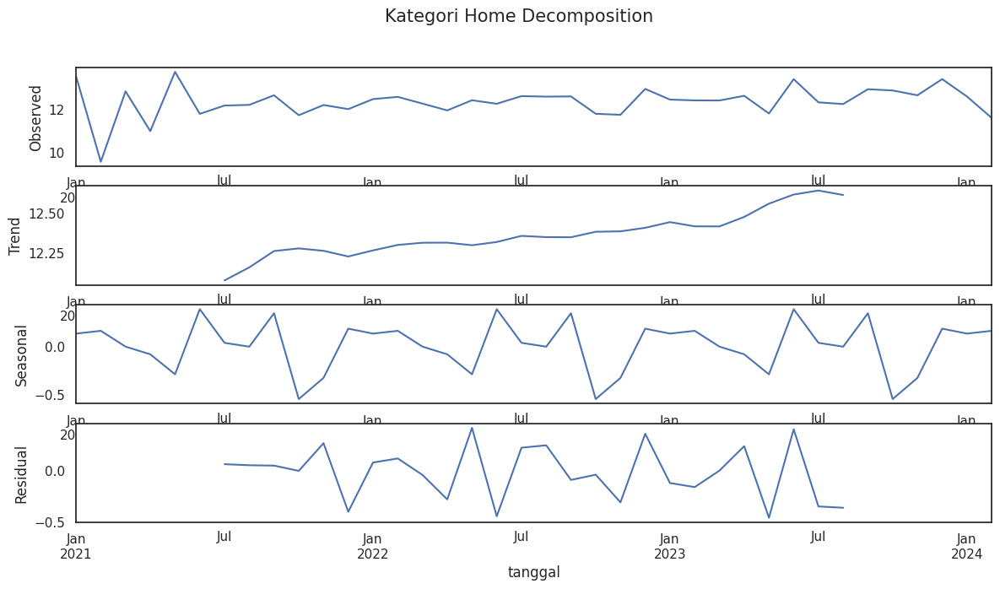

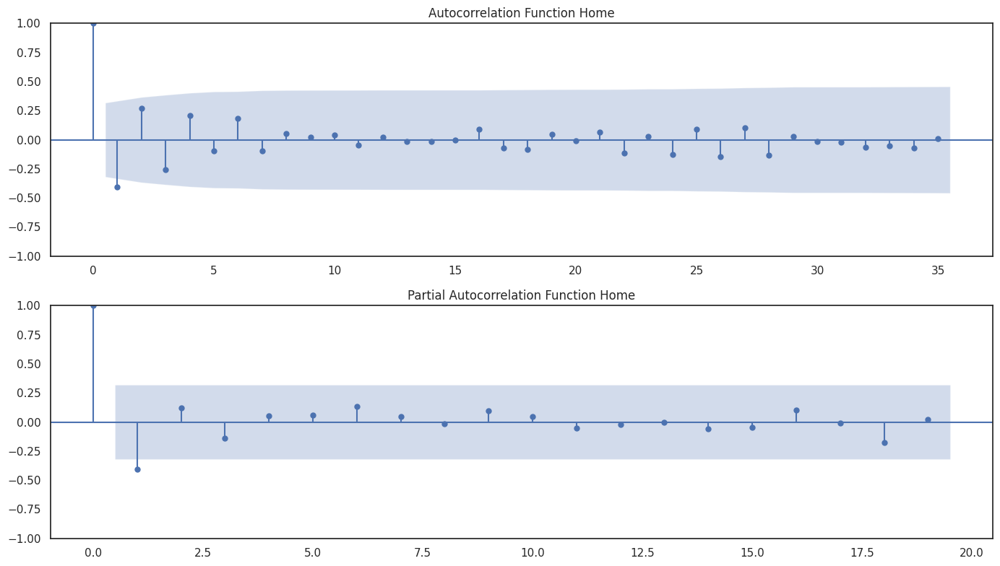

In [ ]:
#Pola Musiman Kategori baby_products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'baby_products' saja
CVFM_home = CVFM[CVFM['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Home Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Home')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Home')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Food Cupboard data CVFamz beserta ACF dan PACF nya.

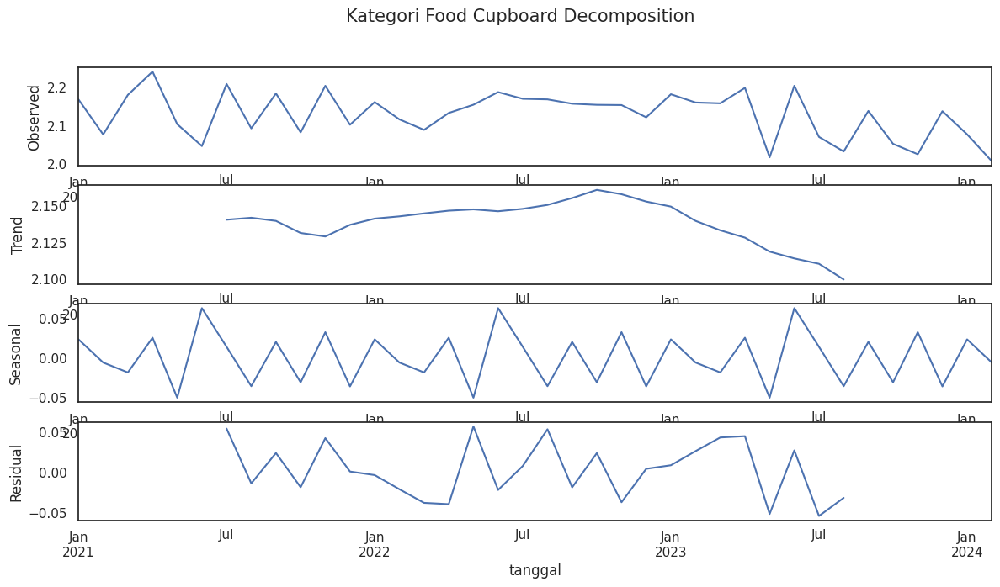

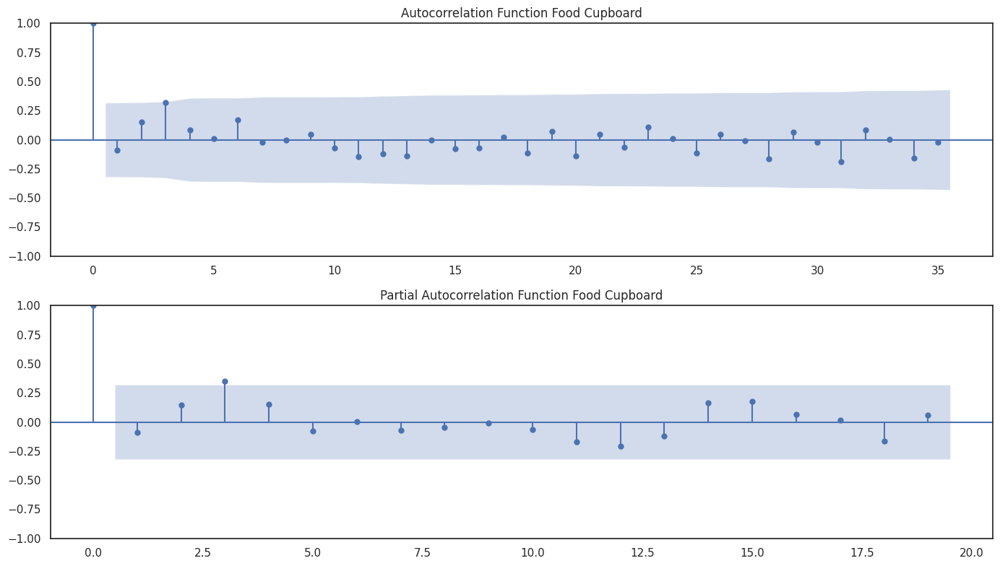

In [ ]:
#Pola Musiman Kategori Food Cupboard
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'baby_products' saja
CVFM_fc = CVFM[CVFM['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = CVFM_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Food Cupboard Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Food Cupboard')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Food Cupboard')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Fresh Food data CVFamz beserta ACF dan PACF nya.

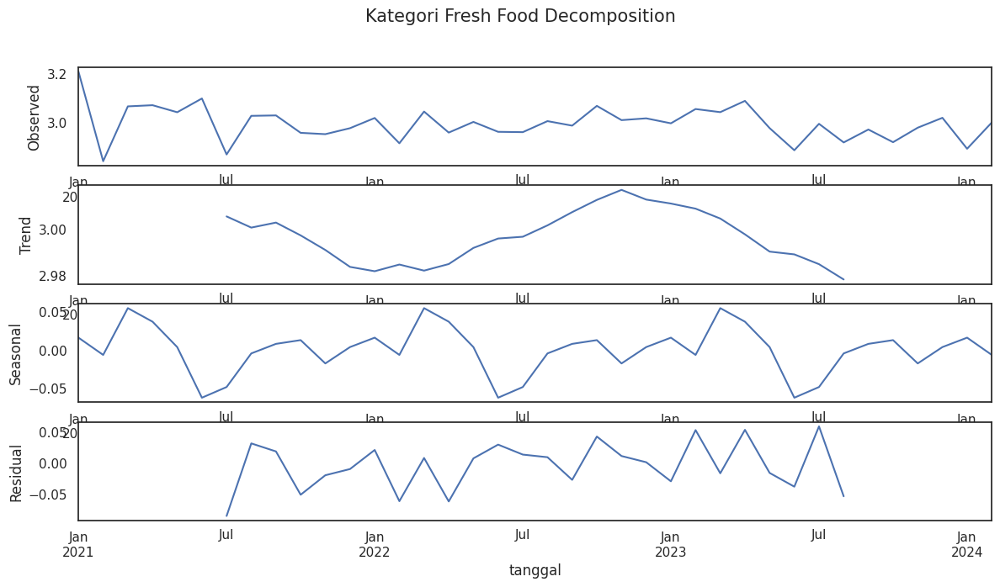

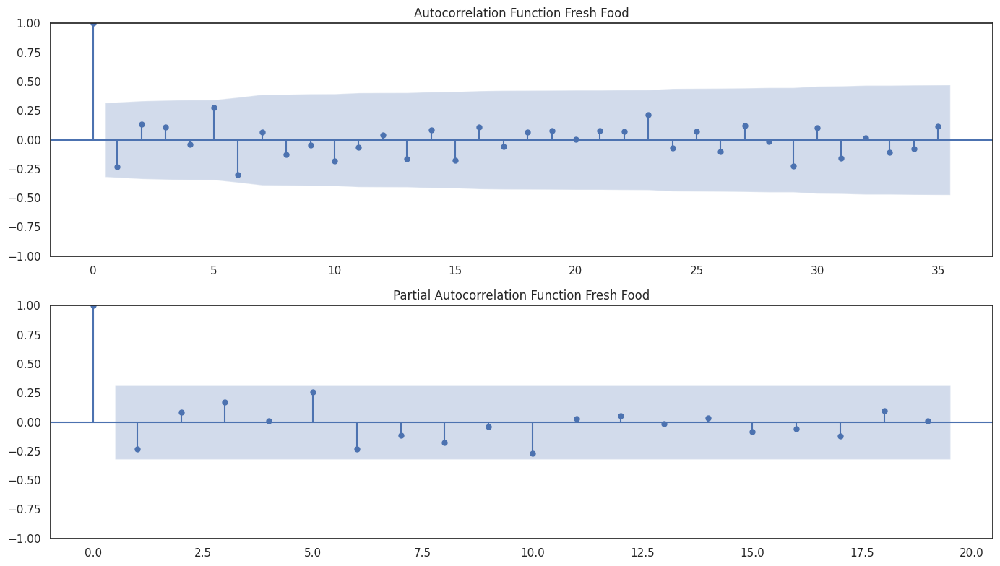

In [ ]:
#Pola Musiman Kategori Fresh Food
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'baby_products' saja
CVFM_fresh = CVFM[CVFM['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = CVFM_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Fresh Food Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Fresh Food')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Fresh Food')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Health Products data CVFamz beserta ACF dan PACF nya.

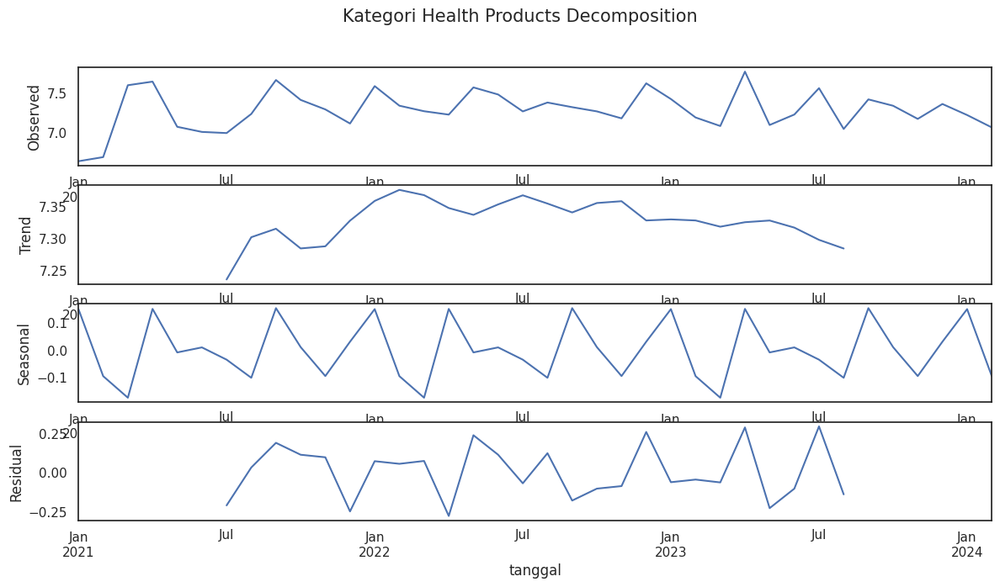

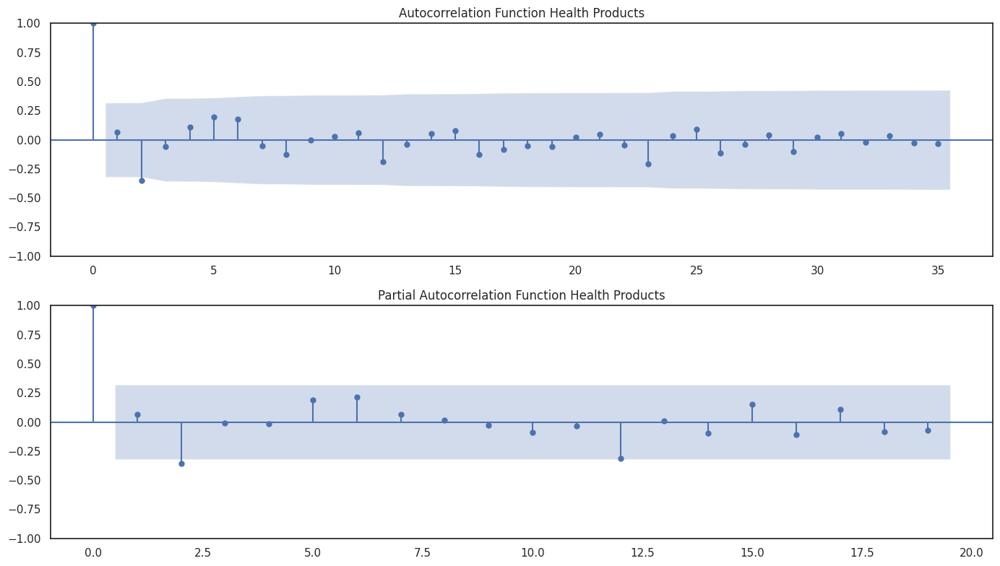

In [ ]:
#Pola Musiman Kategori health products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'baby_products' saja
CVFM_health = CVFM[CVFM['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = CVFM_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Health Products Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Health Products')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Health Products')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Free From data CVFamz beserta ACF dan PACF nya.

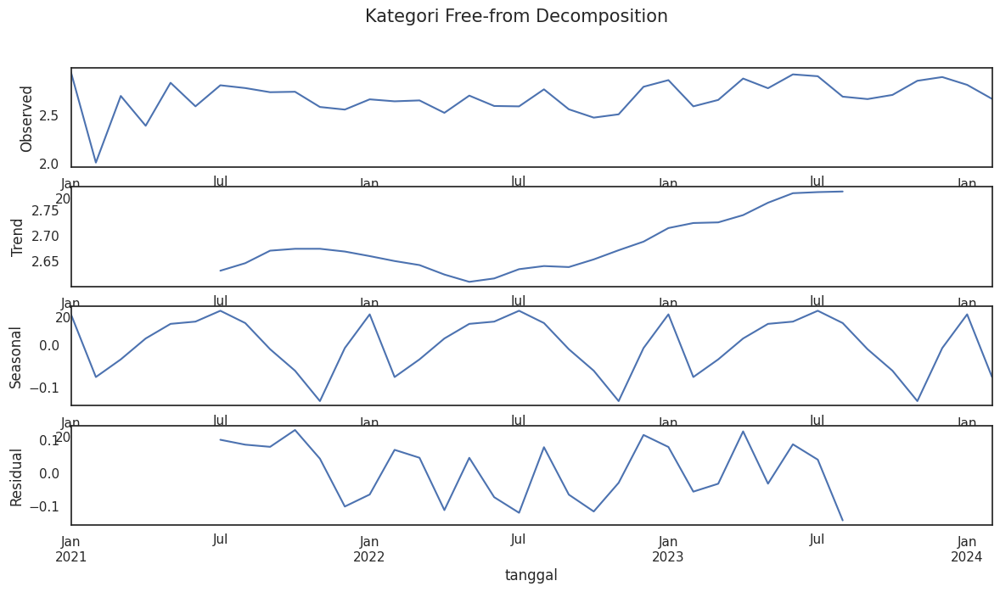

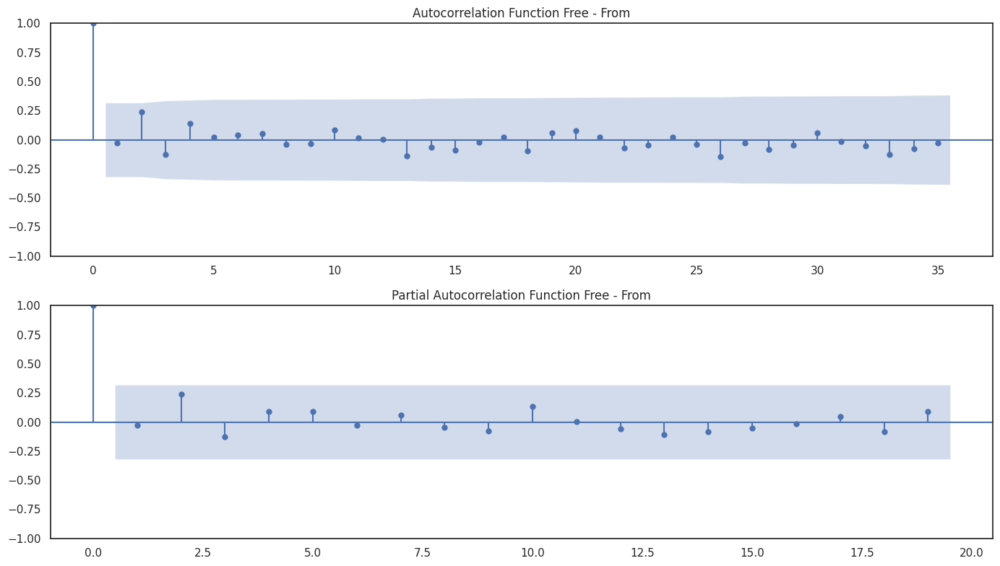

In [ ]:
#Pola Musiman Kategori baby_products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'free-from' saja
CVFM_ff = CVFM[CVFM['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori free-from
df_monthly = CVFM_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Free-from Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Free - From')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Free - From')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Household data CVFamz beserta ACF dan PACF nya.

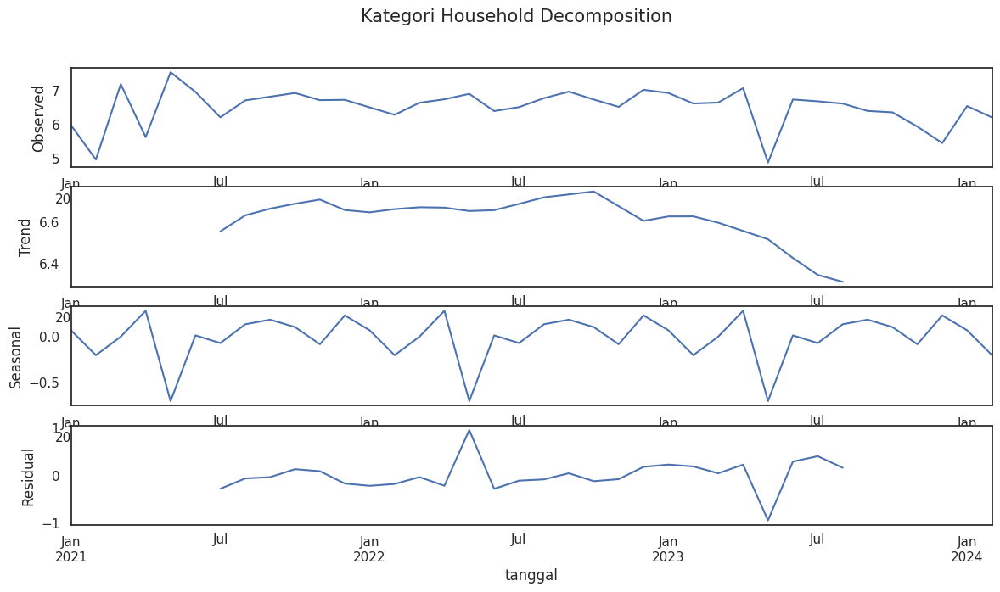

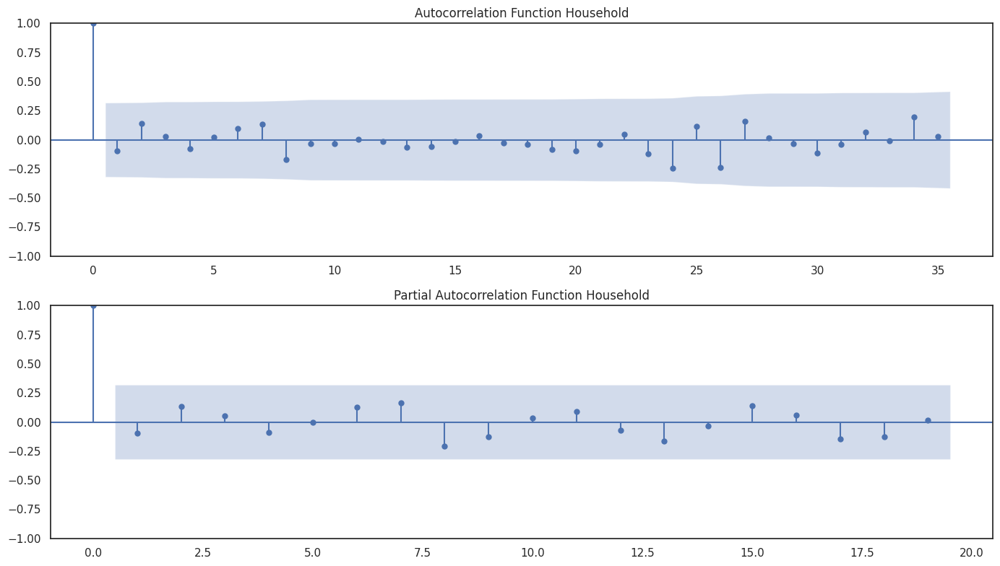

In [ ]:
#Pola Musiman Kategori Household
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'Household' saja
CVFM_hh = CVFM[CVFM['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori household
df_monthly = CVFM_hh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Household Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Household')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Household')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Drinks data CVFamz beserta ACF dan PACF nya.

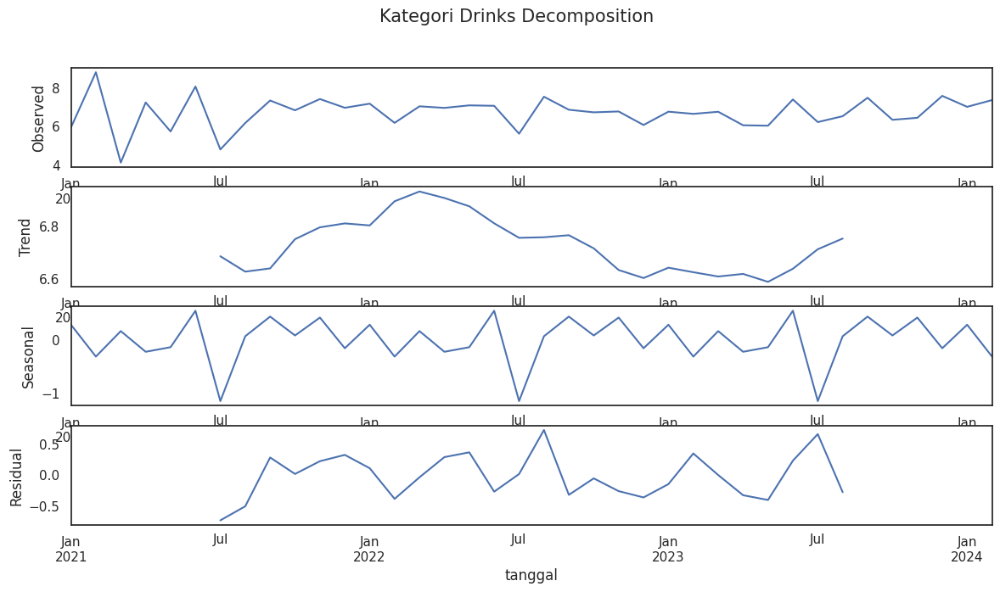

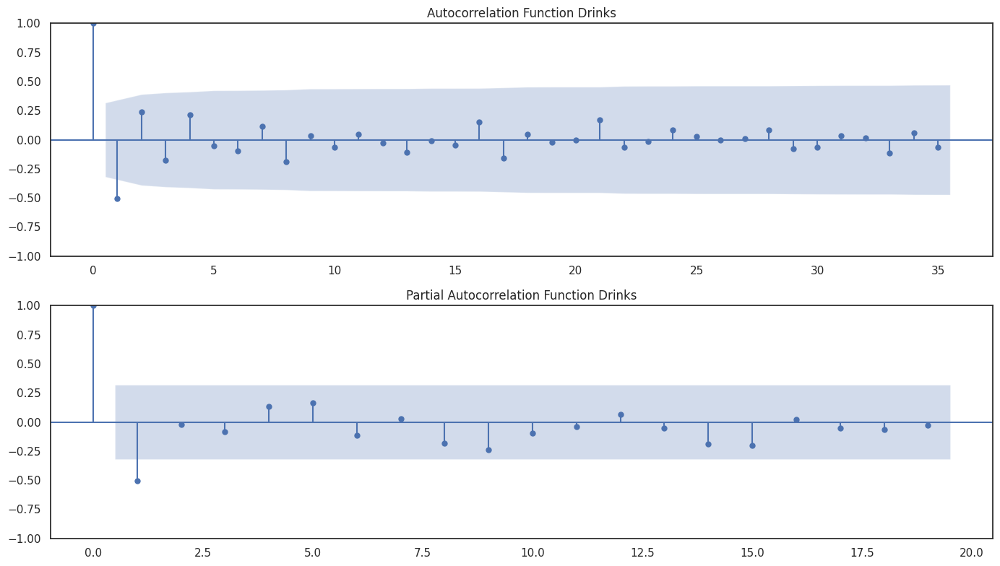

In [ ]:
#Pola Musiman Kategori drinks
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'drinks' saja
CVFM_drinks = CVFM[CVFM['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori drinks
df_monthly = CVFM_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Drinks Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Drinks')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Drinks')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Pets data CVFamz beserta ACF dan PACF nya.

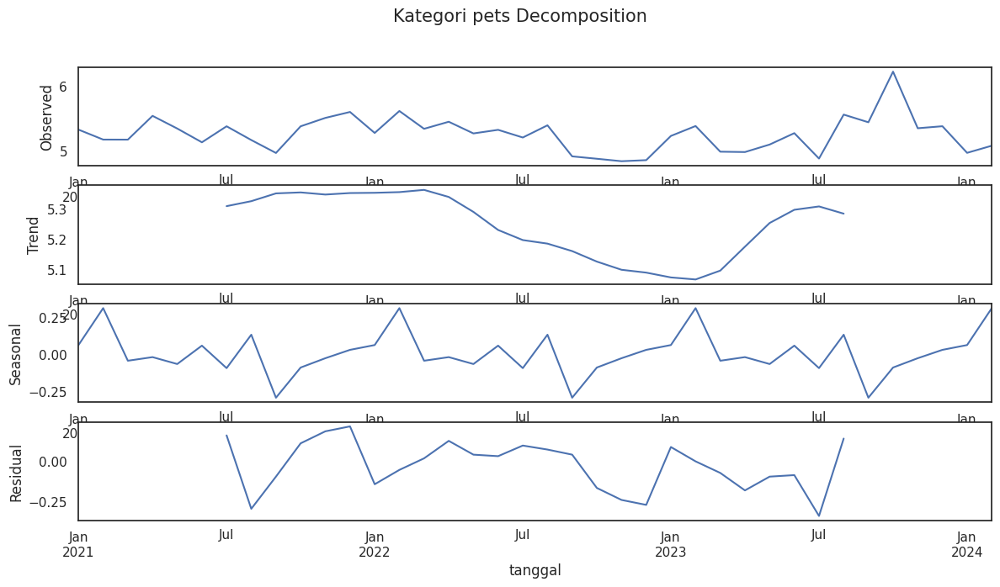

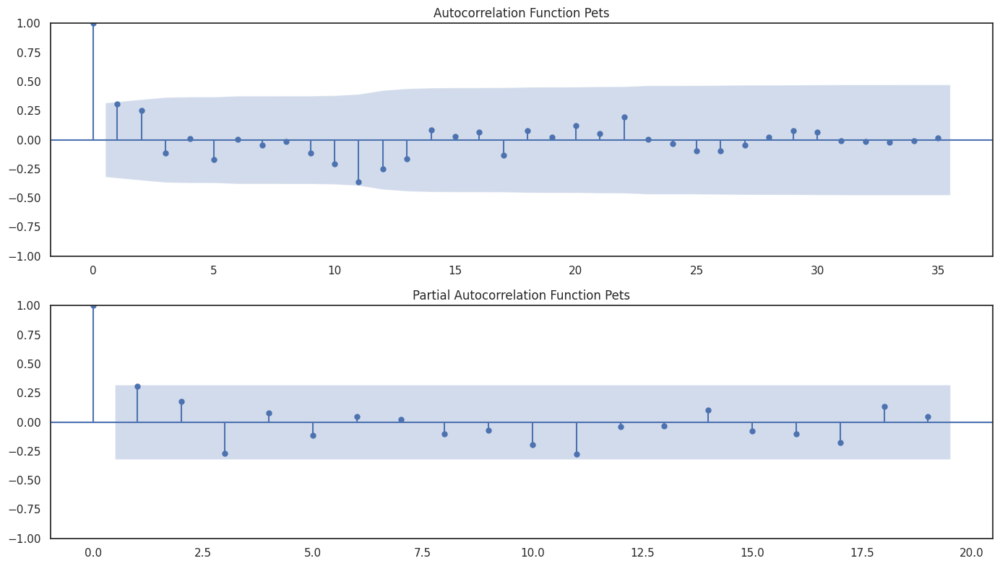

In [ ]:
#Pola Musiman Kategori pets
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'pets' saja
CVFM_pets = CVFM[CVFM['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori pets
df_monthly = CVFM_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori pets Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Pets')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Pets')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Frozen data CVFamz beserta ACF dan PACF nya.

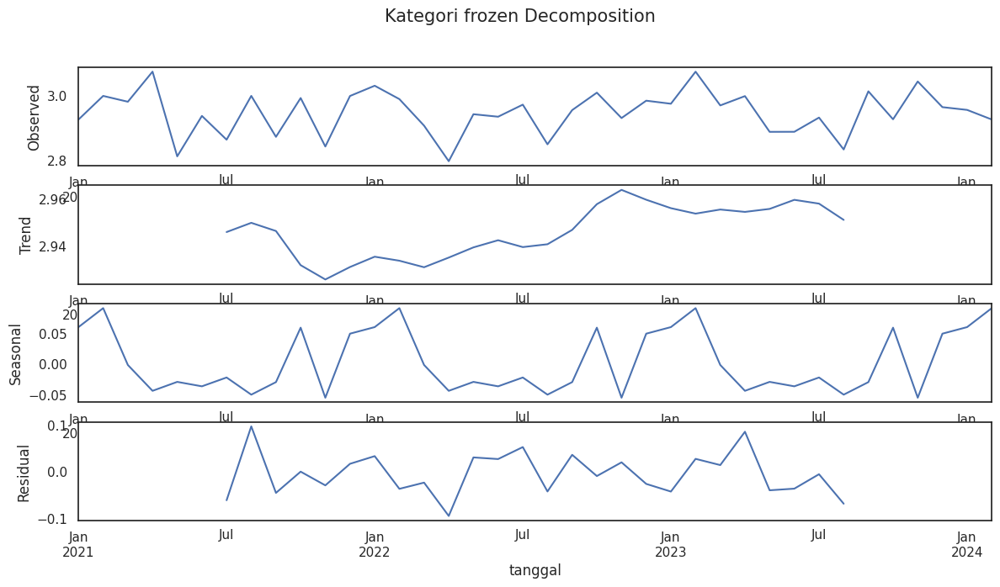

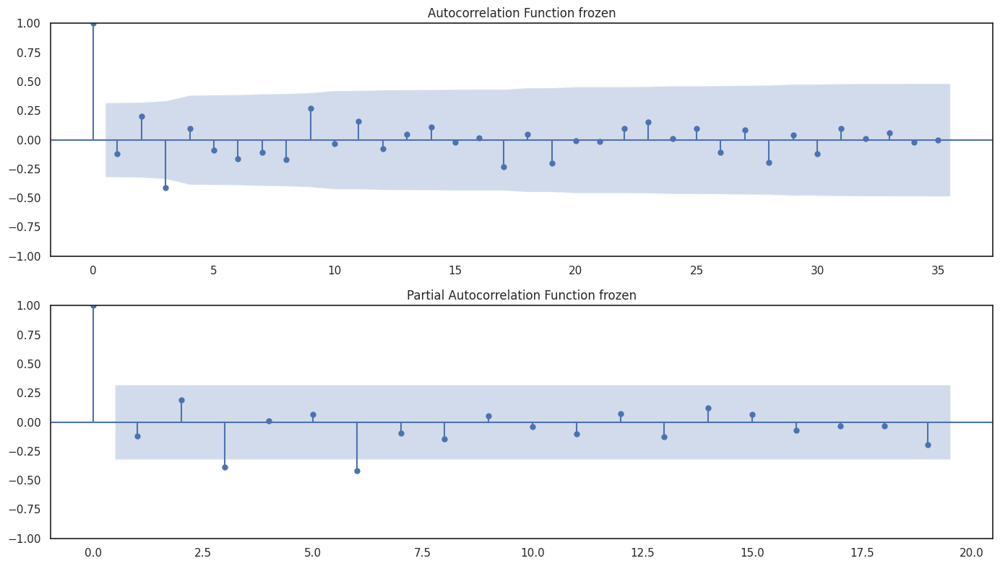

In [ ]:
#Pola Musiman Kategori Frozen
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'frozen' saja
CVFM_frozen = CVFM[CVFM['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori frozen
df_monthly = CVFM_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori frozen Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function frozen')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function frozen')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Bakery data CVFamz beserta ACF dan PACF nya.

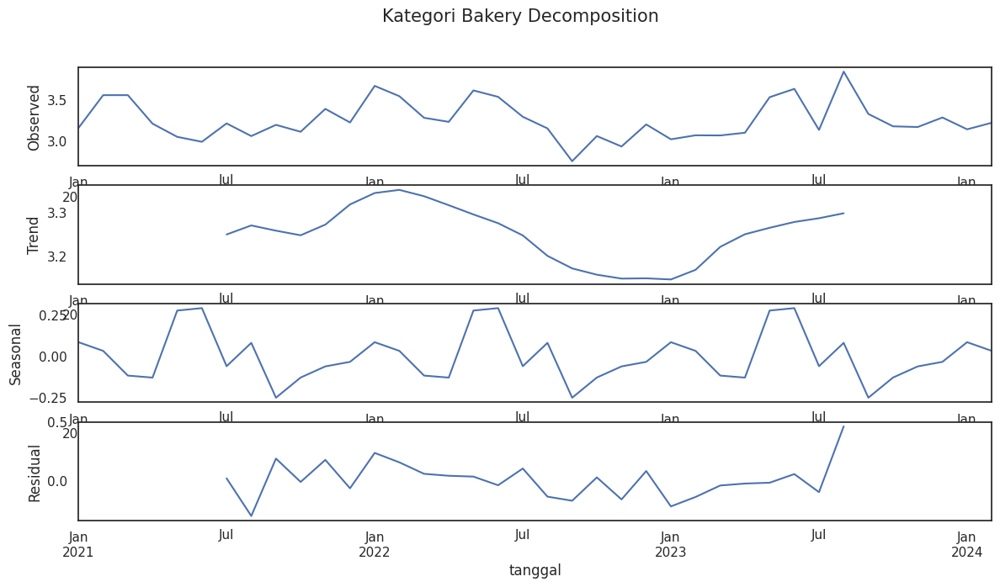

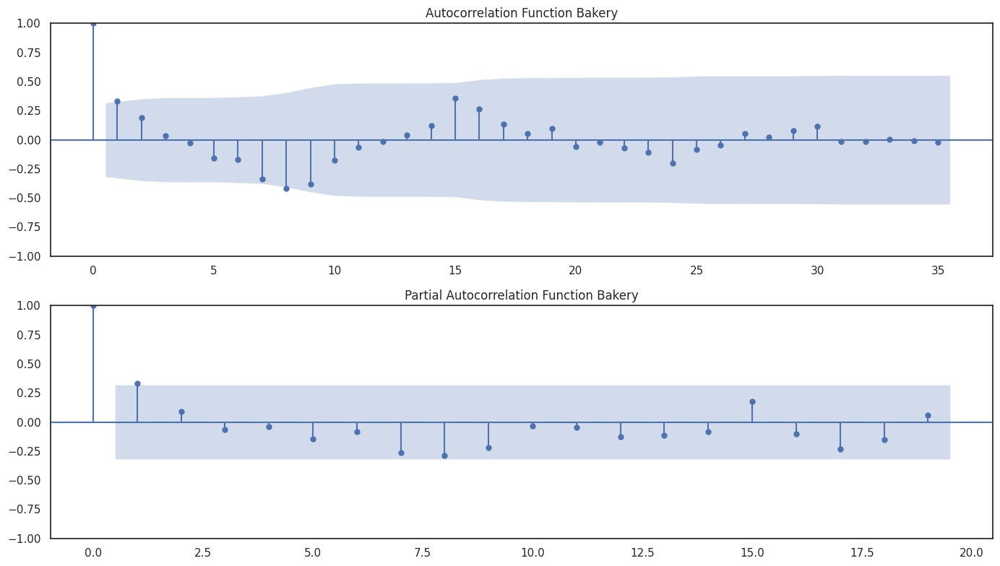

In [ ]:
#Pola Musiman Kategori bakery
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_bakery = CVFM[CVFM['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Bakery Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Bakery')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Bakery')

plt.tight_layout()
plt.show()

Berikut adalah pola musiman (seasonal) Kategori Baby Products data CVFamz beserta ACF dan PACF nya.

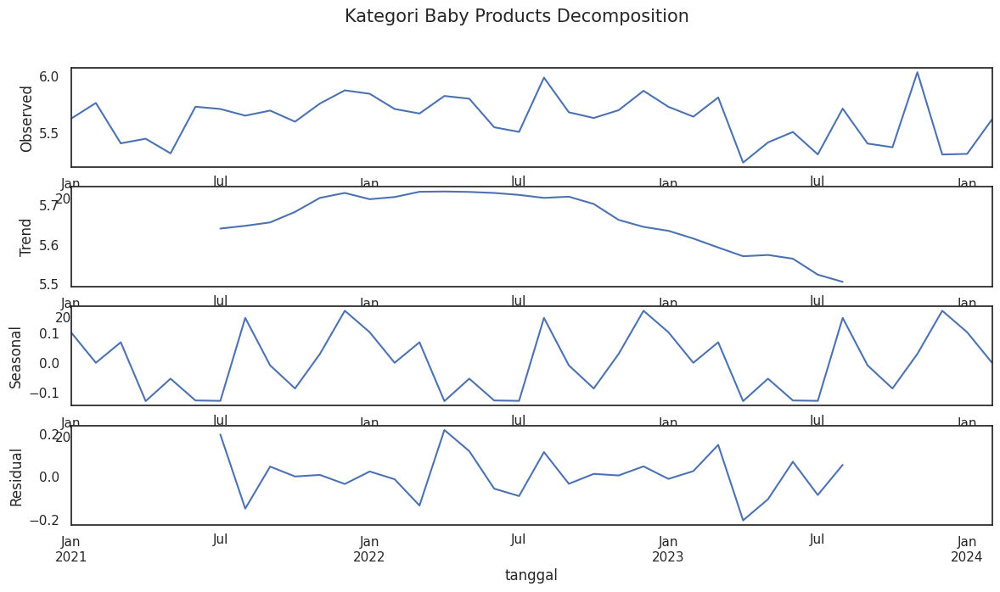

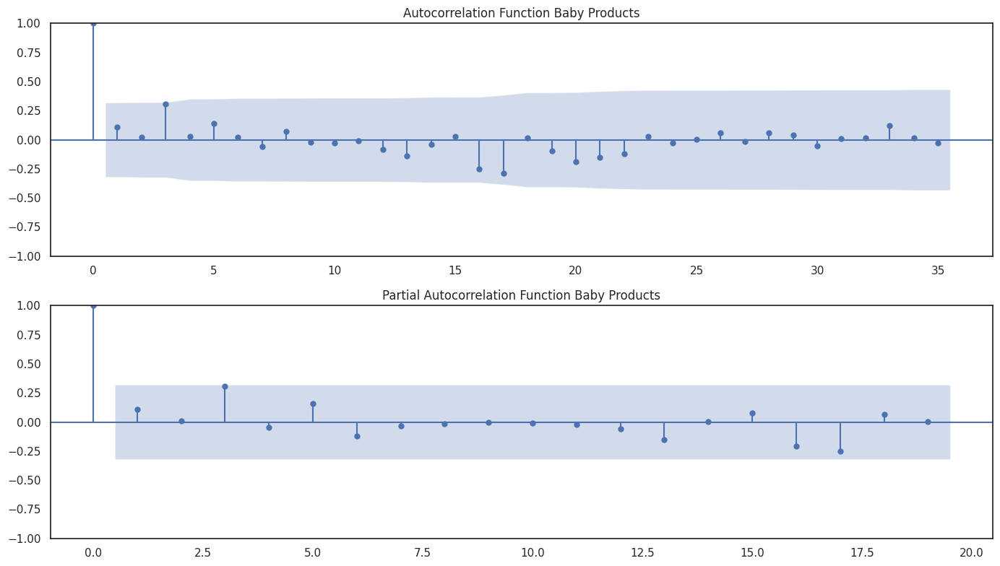

In [ ]:
#Pola Musiman Kategori baby_products
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'baby_products' saja
CVFM_baby = CVFM[CVFM['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori baby_products
df_monthly = CVFM_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Melakukan dekomposisi musiman
decomposition = seasonal_decompose(df_monthly['harga_rata'], model='additive', period=12)

# Menampilkan hasil dekomposisi
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14,7))
fig.suptitle('Kategori Baby Products Decomposition', fontsize=15)
decomposition.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
decomposition.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
decomposition.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
decomposition.resid.plot(ax=ax4)
ax4.set_ylabel('Residual')
plt.show()

# Plot ACF dan PACF
fig, ax = plt.subplots(2, 1, figsize=(14, 8))

# Plot ACF
plot_acf(df_monthly['harga_rata'], lags=35, ax=ax[0])
ax[0].set_title('Autocorrelation Function Baby Products')

# Plot PACF
plot_pacf(df_monthly['harga_rata'], lags=19, ax=ax[1])
ax[1].set_title('Partial Autocorrelation Function Baby Products')

plt.tight_layout()
plt.show()

##home

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "home"

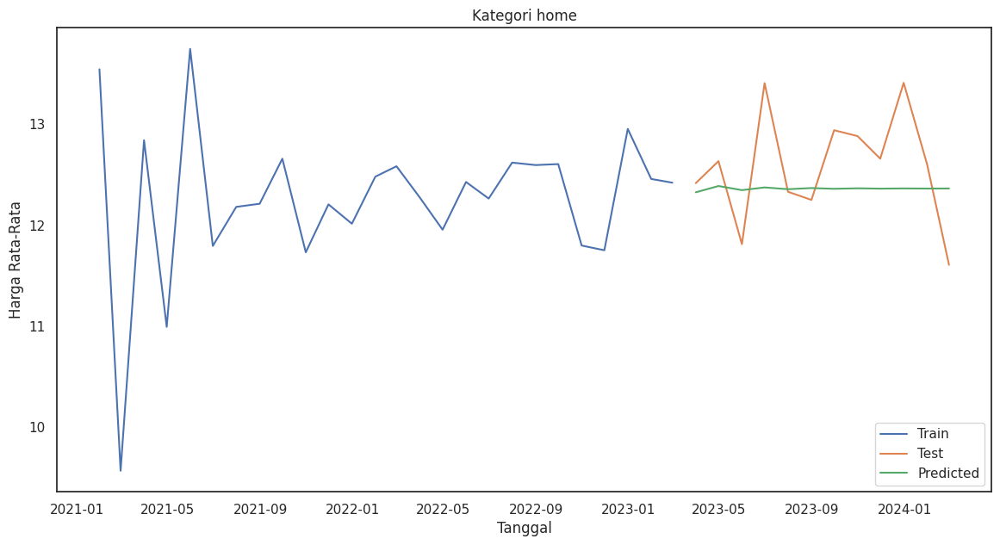

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    12.364037
2025-02-28    12.364042
2025-03-31    12.364039
2025-04-30    12.364041
2025-05-31    12.364040
2025-06-30    12.364041
2025-07-31    12.364040
2025-08-31    12.364040
2025-09-30    12.364040
2025-10-31    12.364040
2025-11-30    12.364040
2025-12-31    12.364040
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori home: 0.5664859584994411
Standar deviasi: 0.014241500987889903
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -26.136
Date:                Fri, 07 Jun 2024   AIC                             58.271
Time:                        07:59:47   BIC                             61.928
Sample:                    01-31-2021   HQIC                            59.285
                         - 02-28-2023                            

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] =='home']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1, 1, 1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori home: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Syntax di atas untuk meramal harga rata-rata bulanan dari produk berdasarkan kategori 'home' menggunakan model ARIMA. Diketahui bahwa nilai RMSE (Root Mean Square Error) sebesar 0,56648 sebagai evaluasi kinerja model pada data pengujian. Sedangkan, untuk standar deviasinya sebesar 0,01424 yang dihitung untuk memahami variabilitas Ramalan.

Best ARIMA order: (1, 2, 2) with RMSE: 0.5406498915142969


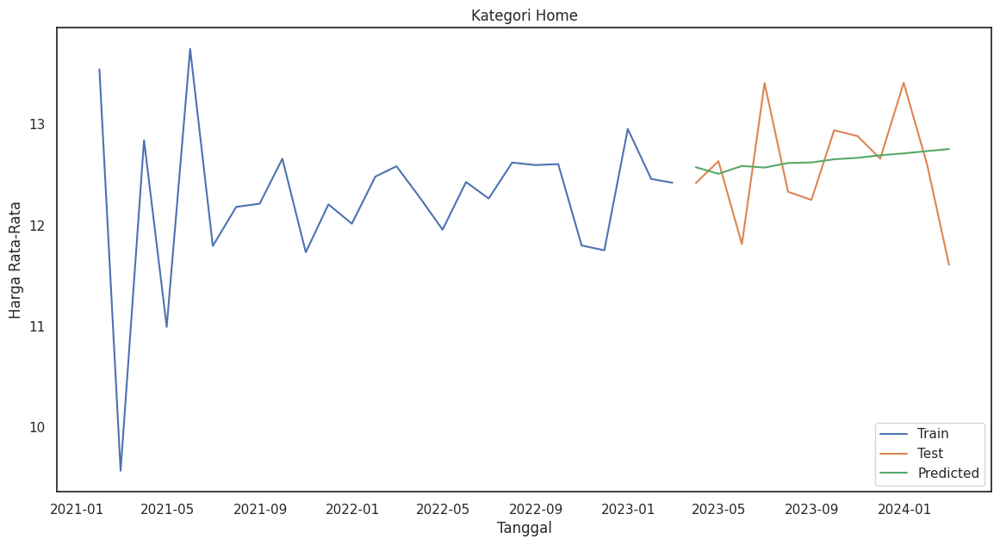

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    12.987056
2025-02-28    13.008157
2025-03-31    13.029270
2025-04-30    13.050375
2025-05-31    13.071486
2025-06-30    13.092593
2025-07-31    13.113702
2025-08-31    13.134810
2025-09-30    13.155919
2025-10-31    13.177027
2025-11-30    13.198136
2025-12-31    13.219244
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori home: 0.5406498915142969
Standar deviasi: 0.07099026403351685
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 2, 2)   Log Likelihood                 -28.297
Date:                Fri, 07 Jun 2024   AIC                             64.594
Time:                        07:59:49   BIC                             69.306
Sample:                    01-31-2021   HQIC                            65.844
                         - 02-28-2023                             

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'home']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori home: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah melakukan baseline ARIMA menggunakan order (1,1,1), dilakukan tuning menggunakan for loop untuk mencari best model ARIMA dalam kategori 'home'. Ditemukan bahwa order terbaik yaitu (1,2,2) dengan nilai RMSE lebih kecil yaitu 0,5406. Namun, standar deviasi pada order ini lebih besar yaitu 0,0709. Grafik yang dihasilkan menggambarkan bahwa Ramalan mengalami kenaikan.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "home"

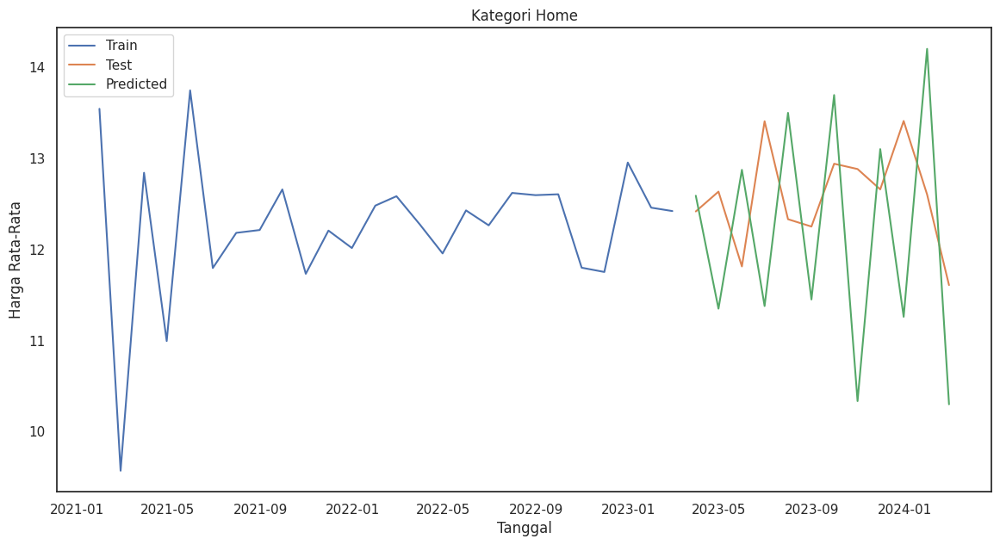

RMSE Kategori Home : 1.4457488482599725
Standar deviasi: 1.267527482434959
AIC: 47.12677113014581
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 1, 0)x(2, 1, 0, 12)   Log Likelihood                 -18.563
Date:                            Fri, 07 Jun 2024   AIC                             47.127
Time:                                    07:59:53   BIC                             49.952
Sample:                                01-31-2021   HQIC                            46.546
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1

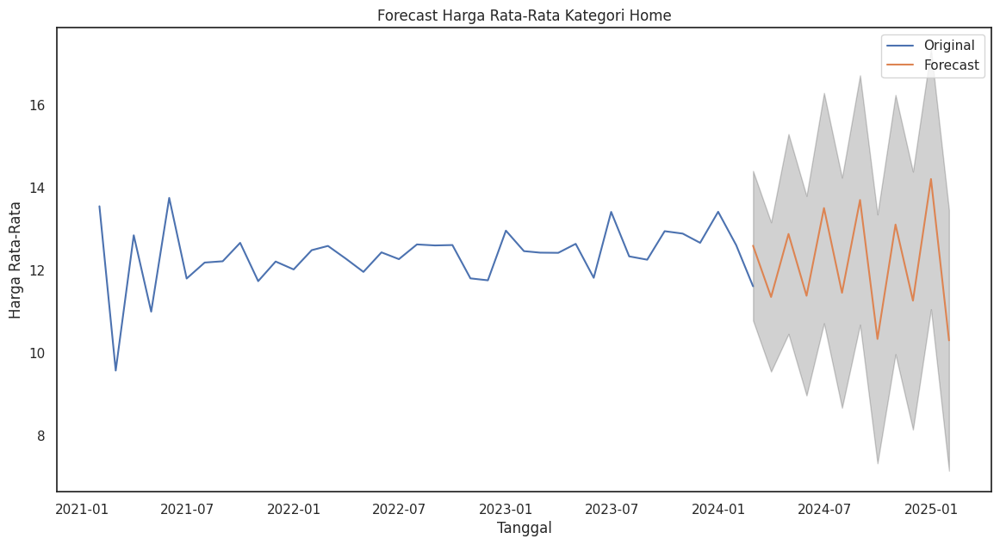

In [ ]:
#Home
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'home' saja
CVFM_home = CVFM[CVFM['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori home
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(2,1,0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Home : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Home untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 12.59111226207755
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 6.607336562277503
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.6688718709014422
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.681225718959035
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.6400326927898357
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.6676827444016904
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.6799702669598973
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.6817037548047387
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 12.243187168761606
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 6.3266506128739
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.6683981168586247
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.6683976307251556
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.642345709369823
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.7877032666717713
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.6783542216422659
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.6683976307251556
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 11.785358198533043
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 5.971827737817545


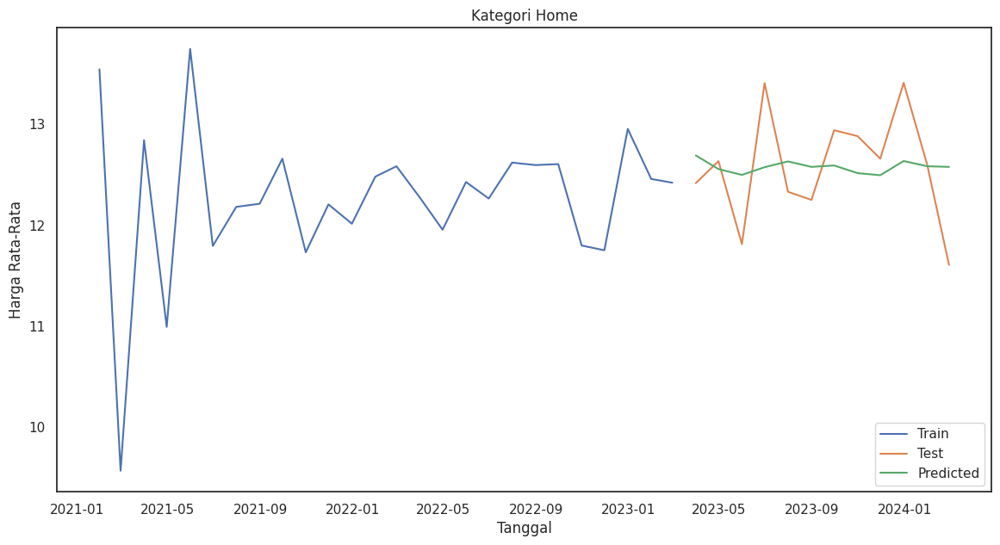

RMSE Kategori Home : 0.5216783211904896
Standar deviasi: 0.05535405384665981
AIC: 23.309731885722748
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 1, 1)x(1, 0, 1, 12)   Log Likelihood                  -5.655
Date:                            Fri, 07 Jun 2024   AIC                             23.310
Time:                                    08:00:09   BIC                             25.697
Sample:                                01-31-2021   HQIC                            21.805
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1        

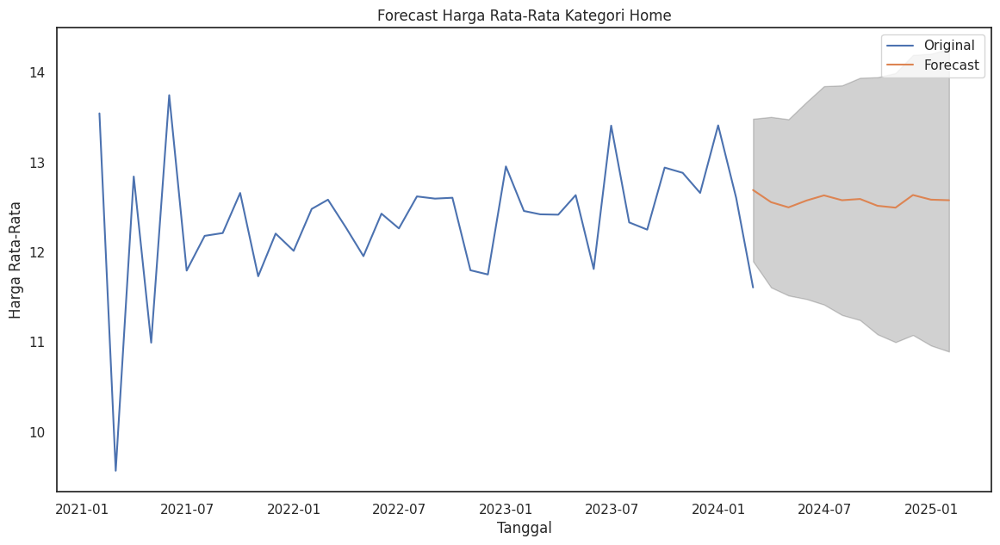

In [ ]:
#Home
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
import itertools


# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'home' saja
CVFM_home = CVFM[CVFM['kategori'] == 'home']

# Mengagregasi data per bulan untuk kategori home
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Home : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Home untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Home')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##food_cupboard

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "food_cupboard"

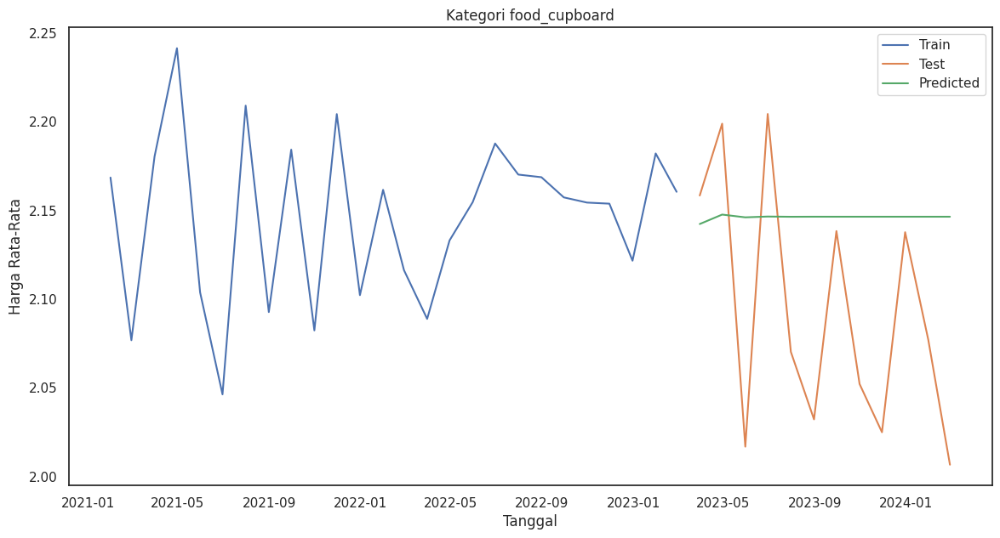

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.146443
2025-02-28    2.146443
2025-03-31    2.146443
2025-04-30    2.146443
2025-05-31    2.146443
2025-06-30    2.146443
2025-07-31    2.146443
2025-08-31    2.146443
2025-09-30    2.146443
2025-10-31    2.146443
2025-11-30    2.146443
2025-12-31    2.146443
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori food_cupboard: 0.08652953600138462
Standar deviasi: 0.0012130557317432168
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  40.557
Date:                Fri, 07 Jun 2024   AIC                            -75.114
Time:                        08:00:11   BIC                            -71.457
Sample:                    01-31-2021   HQIC                           -74.100
                         - 02-28-2023                             

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_food = CVFM[CVFM['kategori'] =='food_cupboard']
df_monthly = CVFM_food.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1, 1, 1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori food_cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori food_cupboard: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Hasil di atas untuk mengetahui Ramalan harga rata-rata bulanan menggunakan model ARIMA dengan kategori 'food_cupboard' berdasarkan baseline yaitu order (1,1,1). Diketahui bahwa nilai RMSE sebesar 0,0865 dan standar deviasi yang dihasilkan sebesar 0,00121. Diketahui juga berdasarkan grafik, hasil Ramalan mengalami overfitting.

Best ARIMA order: (1, 0, 0) with RMSE: 0.08618719686764739


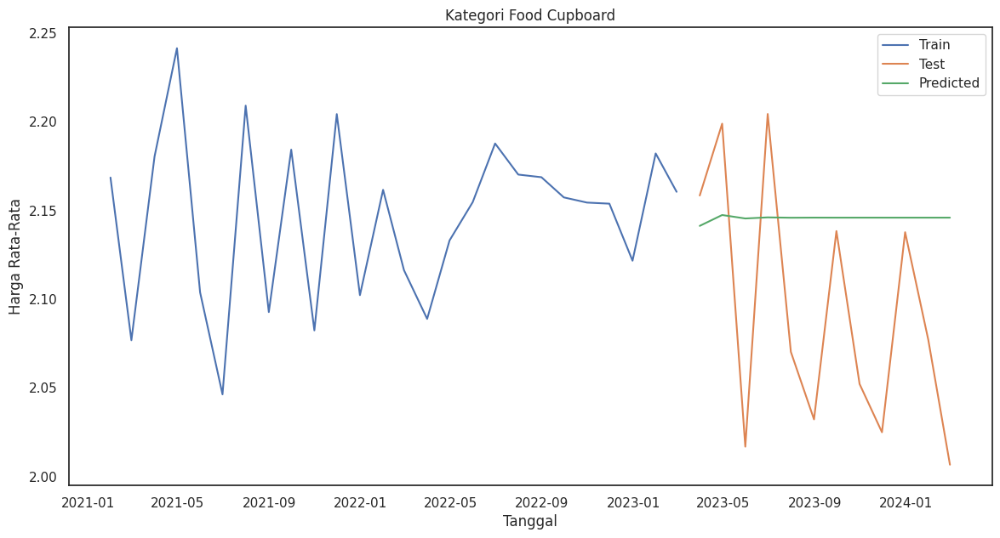

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.14592
2025-02-28    2.14592
2025-03-31    2.14592
2025-04-30    2.14592
2025-05-31    2.14592
2025-06-30    2.14592
2025-07-31    2.14592
2025-08-31    2.14592
2025-09-30    2.14592
2025-10-31    2.14592
2025-11-30    2.14592
2025-12-31    2.14592
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori food cupboard: 0.08618719686764739
Standar deviasi: 0.0013818480090250313
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 0, 0)   Log Likelihood                  44.659
Date:                Fri, 07 Jun 2024   AIC                            -83.318
Time:                        08:00:14   BIC                            -79.544
Sample:                    01-31-2021   HQIC                           -82.231
                         - 02-28-2023                                         

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'food_cupboard']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori food cupboard: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning secara manual diketahui nilai RMSE sebesar 0,0861 dimana besarannya lebih kecil dibanding model baseline (1,1,1). Untuk nilai standar deviasi yang dihasilkan sebesar 0,001381 yang lebih besar dibanding baseline-nya.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "food_cupboard"

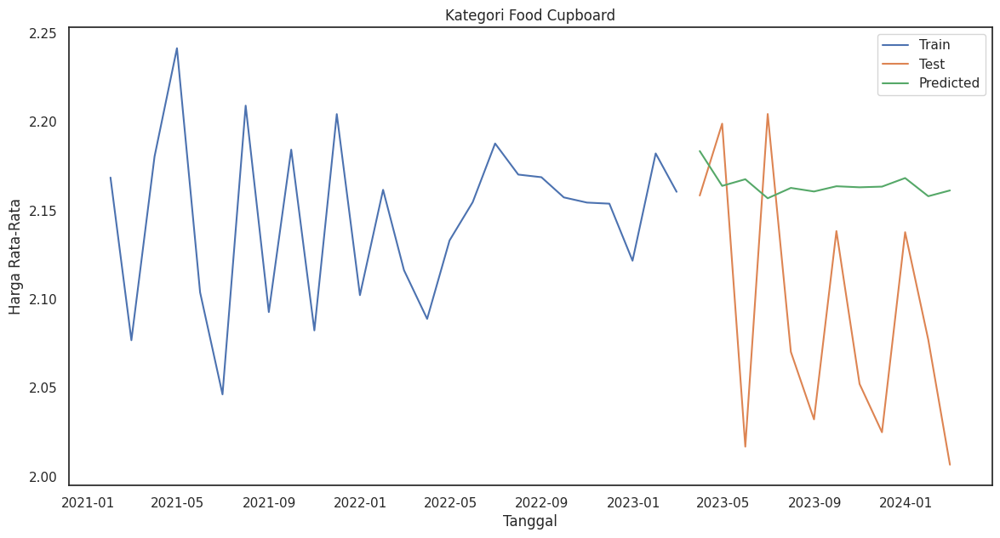

RMSE Kategori food_cupboard: 0.0980050913602051
Standar deviasi: 0.0065579533641167125
AIC: -57.73290026440894
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 0, 0)x(1, 0, 0, 12)   Log Likelihood                  32.866
Date:                            Fri, 07 Jun 2024   AIC                            -57.733
Time:                                    08:00:15   BIC                            -52.701
Sample:                                01-31-2021   HQIC                           -56.284
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.

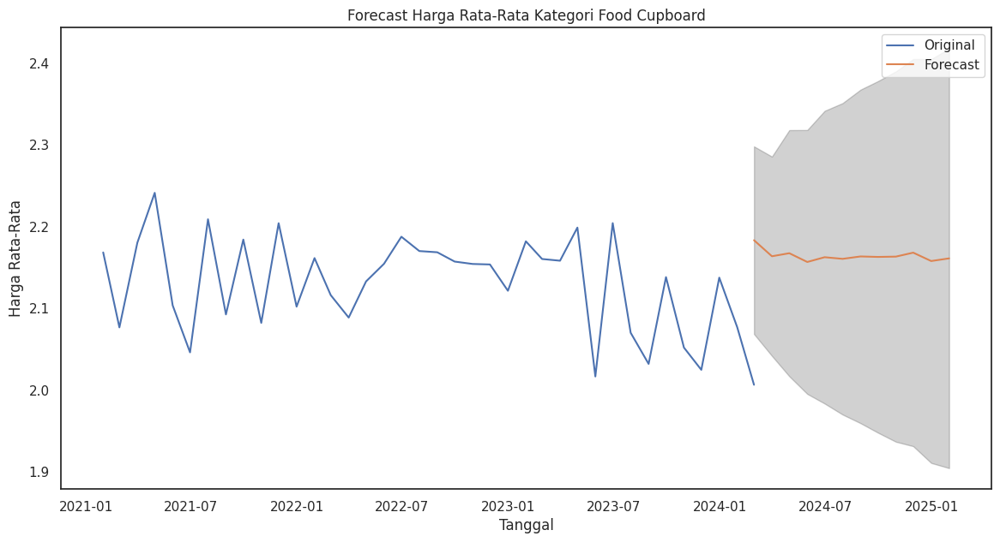

In [ ]:
#Food_Cupboard
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_fc = CVFM[CVFM['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,0,0), seasonal_order=(1, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori food_cupboard: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Food Cupboard untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 2.0942905086298422
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.0500069552524582
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.0997209893603782
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.11769880129712985
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.10505067887437987
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.12015881911138973
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.1435750048265492
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.14997468740602124
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 2.0319785815635627
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 0.9964426750013996
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.10028440266851854
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.10005145561641499
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.10577580399695397
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.11685470299690785
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.12866319549598698
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.10005145561641499
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 2.030042928049282
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 1.

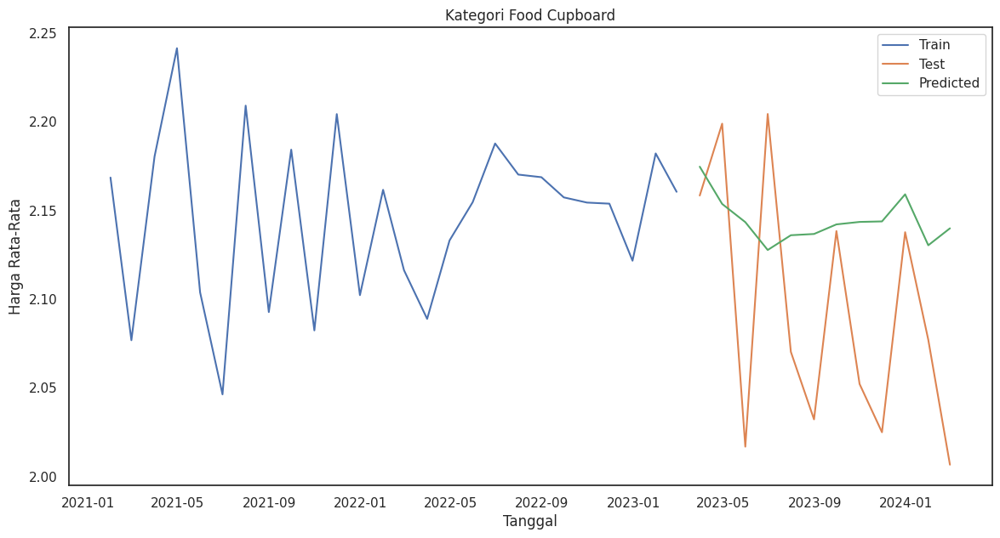

RMSE Kategori food_cupboard: 0.08312003578726453
Standar deviasi: 0.012408006579108843
AIC: -42.129381518713906
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(0, 1, 1)x(0, 0, 1, 12)   Log Likelihood                  24.065
Date:                            Fri, 07 Jun 2024   AIC                            -42.129
Time:                                    08:00:35   BIC                            -40.936
Sample:                                01-31-2021   HQIC                           -42.882
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma

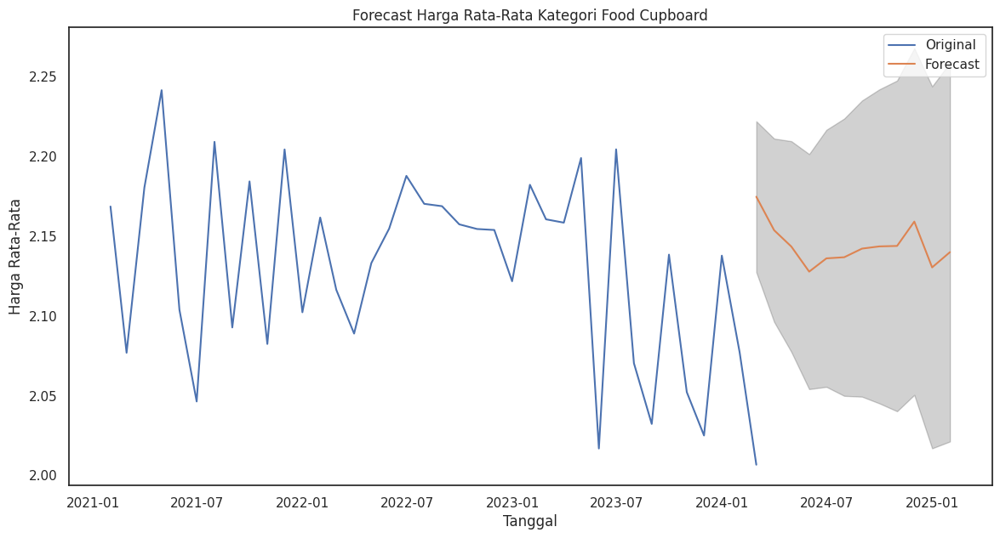

In [ ]:
#Food_Cupboard
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_fc = CVFM[CVFM['kategori'] == 'food_cupboard']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_fc.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()
# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori food_cupboard: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Food Cupboard untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Food Cupboard')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Fresh_Food

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "fresh_food"

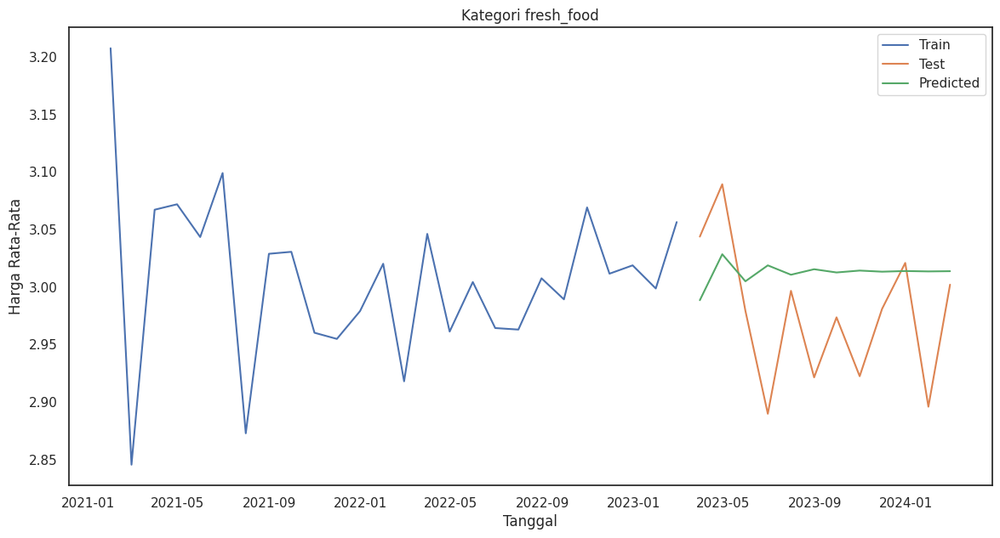

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.013618
2025-02-28    3.013618
2025-03-31    3.013618
2025-04-30    3.013618
2025-05-31    3.013618
2025-06-30    3.013618
2025-07-31    3.013618
2025-08-31    3.013618
2025-09-30    3.013618
2025-10-31    3.013618
2025-11-30    3.013618
2025-12-31    3.013618
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori fresh_food : 0.06961156703861178
Standar deviasi: 0.008888751152571444
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  31.350
Date:                Fri, 07 Jun 2024   AIC                            -56.700
Time:                        08:00:36   BIC                            -53.043
Sample:                    01-31-2021   HQIC                           -55.686
                         - 02-28-2023                                

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_fresh = CVFM[CVFM['kategori'] =='fresh_food']
df_monthly = CVFM_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori fresh_food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori fresh_food : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Diketahui nilai RMSE pada Ramalan harga rata-rata bulanan kategori 'fresh food' sebesar 0,0696 dan nilai standar deviasi yang dihasilkan sebesar 0,0088.

Best ARIMA order: (0, 0, 2) with RMSE: 0.06476424417953268


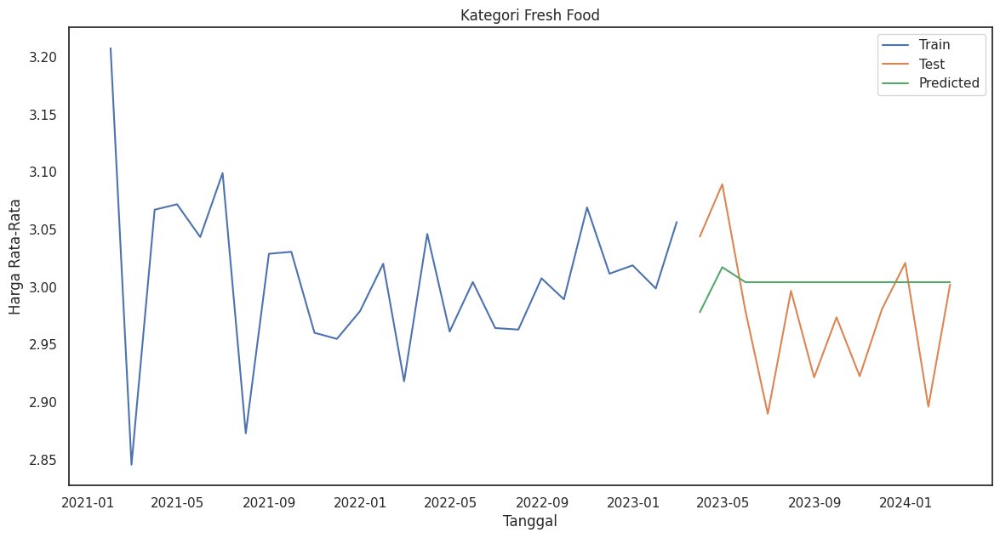

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.004138
2025-02-28    3.004138
2025-03-31    3.004138
2025-04-30    3.004138
2025-05-31    3.004138
2025-06-30    3.004138
2025-07-31    3.004138
2025-08-31    3.004138
2025-09-30    3.004138
2025-10-31    3.004138
2025-11-30    3.004138
2025-12-31    3.004138
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori fresh food: 0.06476424417953268
Standar deviasi: 0.008358543929500575
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 0, 2)   Log Likelihood                  35.297
Date:                Fri, 07 Jun 2024   AIC                            -62.593
Time:                        08:00:39   BIC                            -57.561
Sample:                    01-31-2021   HQIC                           -61.144
                         - 02-28-2023                                 

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'fresh_food']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori fresh food: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning diketahui berdasarkan order (0,0,2) dihasilkan nilai RMSE sebesar 0,06476 yang lebih kecil dari baseline model dan nilai standar deviasi yang lebih kecil juga yaitu 0,00835.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "fresh_food"

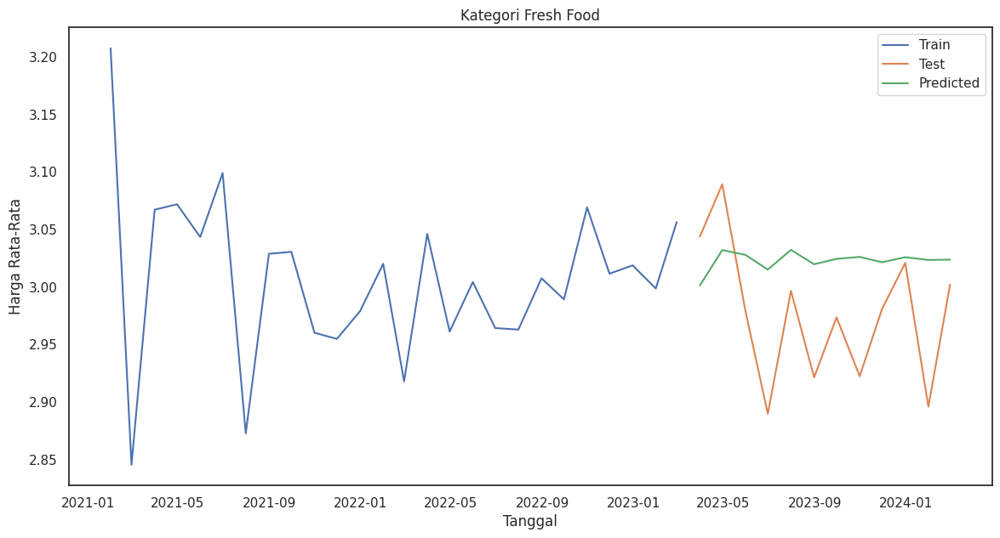

RMSE Kategori Fresh Food: 0.0741037180711758
Standar deviasi: 0.007969168543657538
AIC: -53.57671769847713
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 0)   Log Likelihood                  29.788
Date:                Fri, 07 Jun 2024   AIC                            -53.577
Time:                        08:00:39   BIC                            -49.920
Sample:                    01-31-2021   HQIC                           -52.563
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1548      0.171     -6.762      0.000      -1.489      -0.820
ar.L2         -0.5697   

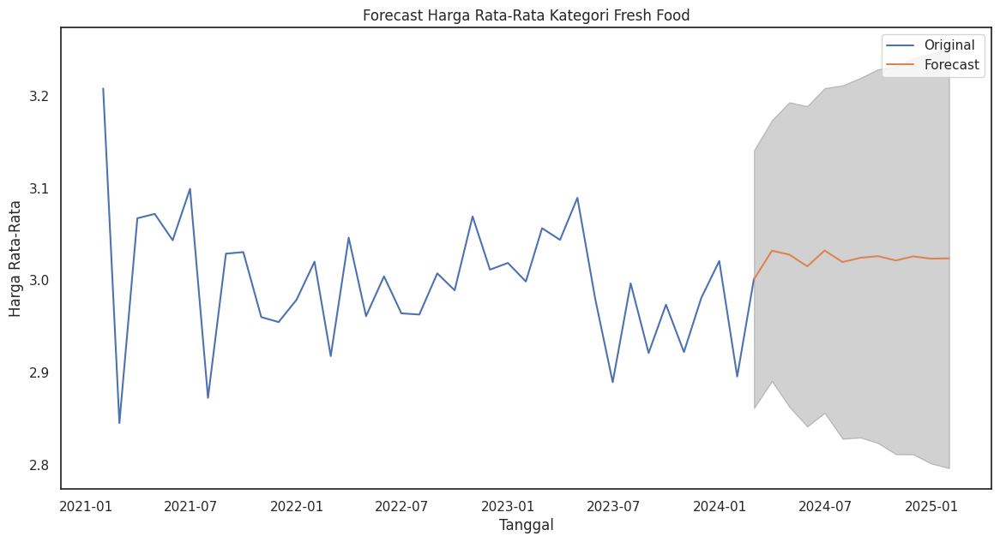

In [ ]:
#Fresh_Food
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_fresh = CVFM[CVFM['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Fresh Food untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 2.976855987128264
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.5178180533258963
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.0749521797355295
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.09462170623937699
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.07208769668759756
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.09508162752245283
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.08723641689672748
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.1902492073997229
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 2.977925746531396
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 3.099175306554192
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.07495079438351594
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.07497995482786786
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.0727995331286158
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.07546099986949285
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.096031985011967
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.07497995482786786
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 2.8796877272430876
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 3.38928

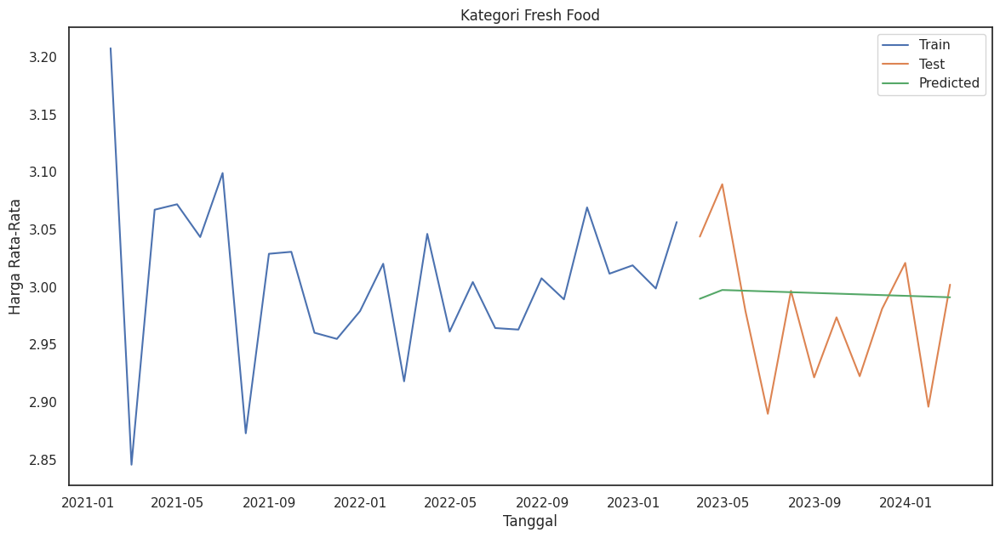

RMSE Kategori Fresh Food: 0.06064607802135247
Standar deviasi: 0.002278827736485956
AIC: -58.863842838506756
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(1, 0, 2)   Log Likelihood                  33.432
Date:                Fri, 07 Jun 2024   AIC                            -58.864
Time:                        08:00:58   BIC                            -54.322
Sample:                    01-31-2021   HQIC                           -57.722
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9998      0.001   1155.686      0.000       0.998       1.001
ma.L1         -1.0994 

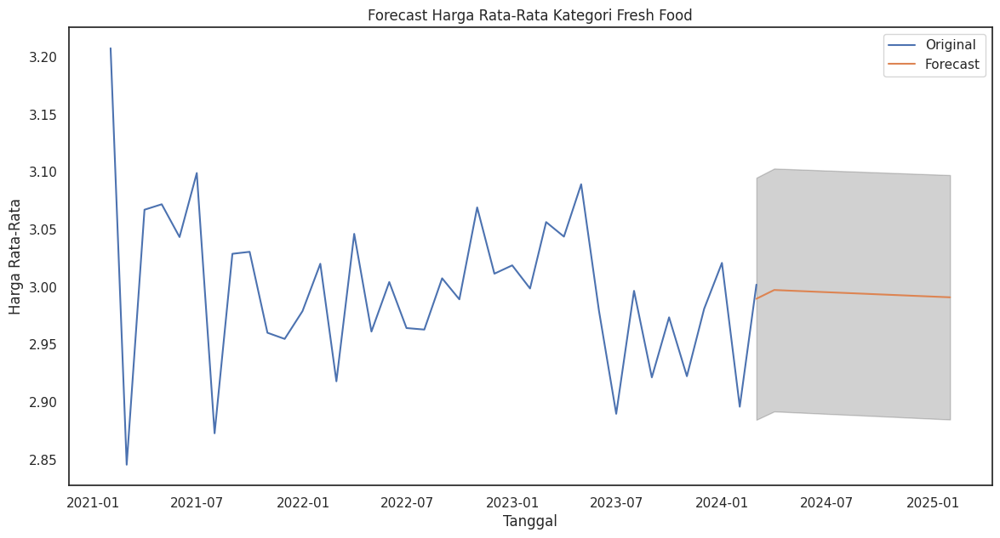

In [ ]:
#Fresh_Food
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_fresh = CVFM[CVFM['kategori'] == 'fresh_food']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_fresh.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]
# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Fresh Food: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Fresh Food untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Fresh Food')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Health_Products

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "health_products"

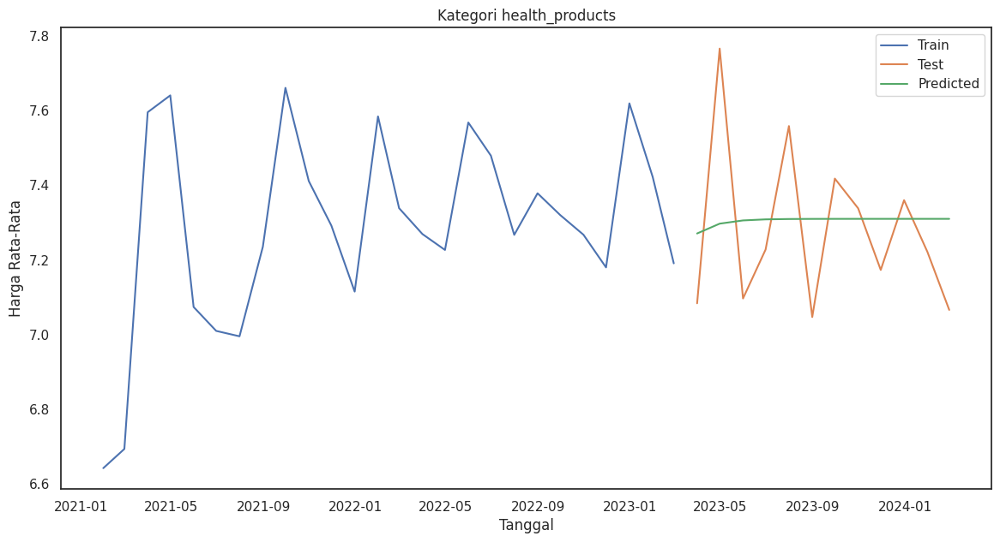

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    7.309756
2025-02-28    7.309756
2025-03-31    7.309756
2025-04-30    7.309756
2025-05-31    7.309756
2025-06-30    7.309756
2025-07-31    7.309756
2025-08-31    7.309756
2025-09-30    7.309756
2025-10-31    7.309756
2025-11-30    7.309756
2025-12-31    7.309756
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori health_products : 0.21156706346998266
Standar deviasi: 0.01093890305793195
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  -2.530
Date:                Fri, 07 Jun 2024   AIC                             11.061
Time:                        08:01:00   BIC                             14.717
Sample:                    01-31-2021   HQIC                            12.075
                         - 02-28-2023                            

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_health = CVFM[CVFM['kategori'] =='health_products']
df_monthly = CVFM_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori health_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori health_products : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Berdasarkan Ramalan yang dilakukan pada kategori 'health products' menggunakan model ARIMA diketahui nilai RMSE sebesar 0,2115 dan nilai standar deviasi sebesar 0,0109. Diketahui pula hasil Ramalan yang cenderung lurus (flat).

Best ARIMA order: (2, 1, 0) with RMSE: 0.20778978642162985


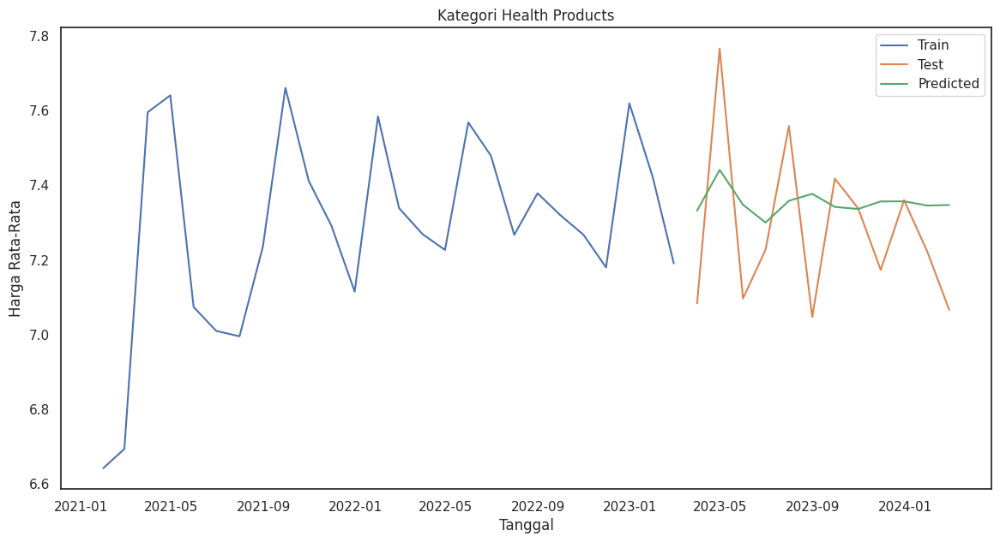

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    7.349775
2025-02-28    7.350010
2025-03-31    7.350048
2025-04-30    7.349912
2025-05-31    7.349910
2025-06-30    7.349985
2025-07-31    7.349976
2025-08-31    7.349935
2025-09-30    7.349946
2025-10-31    7.349967
2025-11-30    7.349958
2025-12-31    7.349948
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori health products: 0.20778978642162985
Standar deviasi: 0.03183227444840702
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                  -2.363
Date:                Fri, 07 Jun 2024   AIC                             10.727
Time:                        08:01:02   BIC                             14.383
Sample:                    01-31-2021   HQIC                            11.741
                         - 02-28-2023                             

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'health_products']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Health Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori health products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Diketahui nilai RMSE yang dihasilkan setelah dituning menjadi lebih kecil sebesar 0,2077 dan standar deviasi yang cenderung lebih besar yaitu 0,0318.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "health_products"

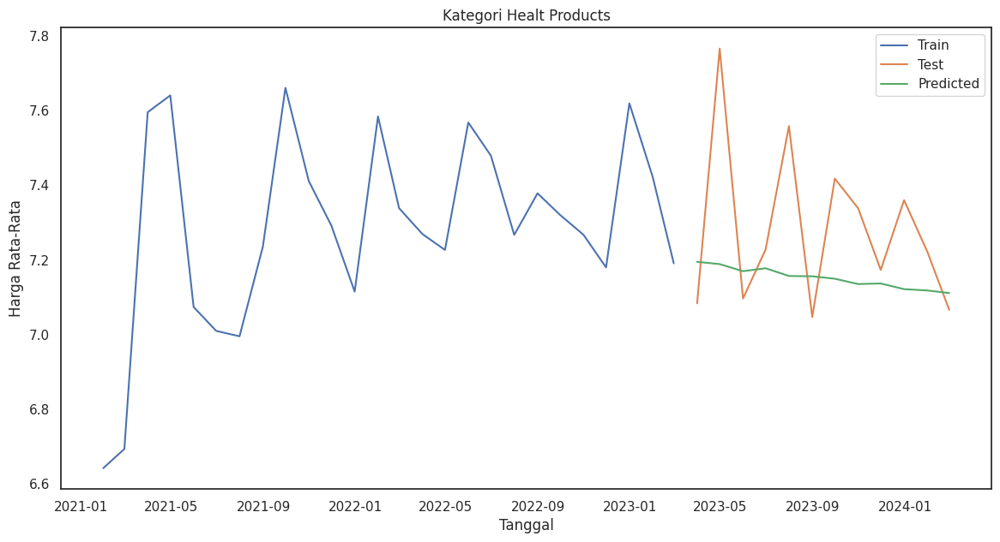

RMSE Kategori Healt Products: 0.2433052311286455
Standar deviasi: 0.02651575853067787
AIC: 28.63283843752022
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(3, 0, 2)   Log Likelihood                  -8.316
Date:                Fri, 07 Jun 2024   AIC                             28.633
Time:                        08:01:03   BIC                             36.181
Sample:                    01-31-2021   HQIC                            30.807
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4531      0.777     -0.583      0.560      -1.975       1.069
ar.L2          0.6437 

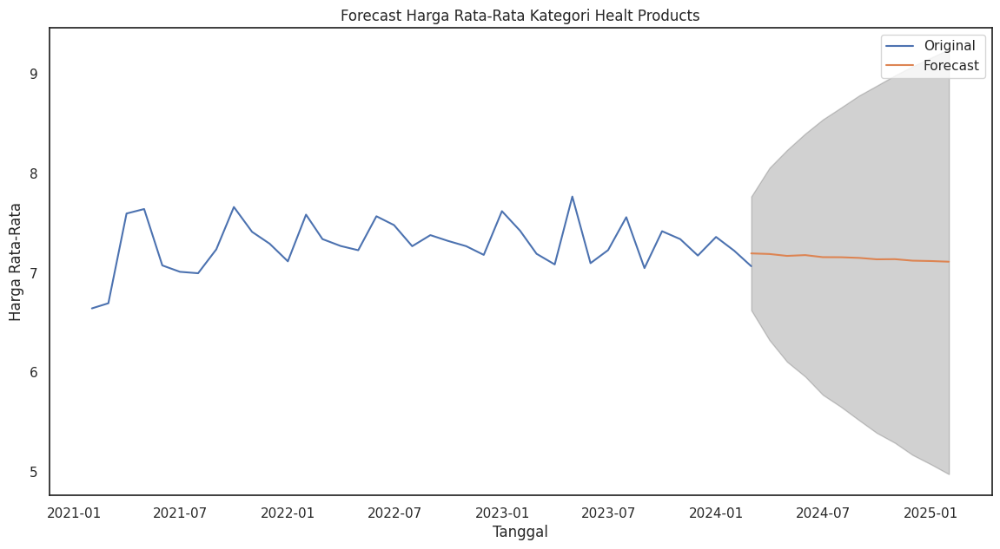

In [ ]:
#Health Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_health = CVFM[CVFM['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3,0,2), seasonal_order=(0,0,0,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Healt Products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Healt Products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 7.282511433599518
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 3.728572431931148
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.28032907566453896
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.24563960156921855
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.3291354289616421
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.28048674252086675
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.25159814944442566
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.2467606331393314
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 7.0685242693220065
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 3.5514992306514754
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.2793601279675997
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.2797050108683321
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.32913224702474153
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.23185215545131363
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.251925554880694
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.2797050108683321
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 7.064355707274824
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 3.3826845

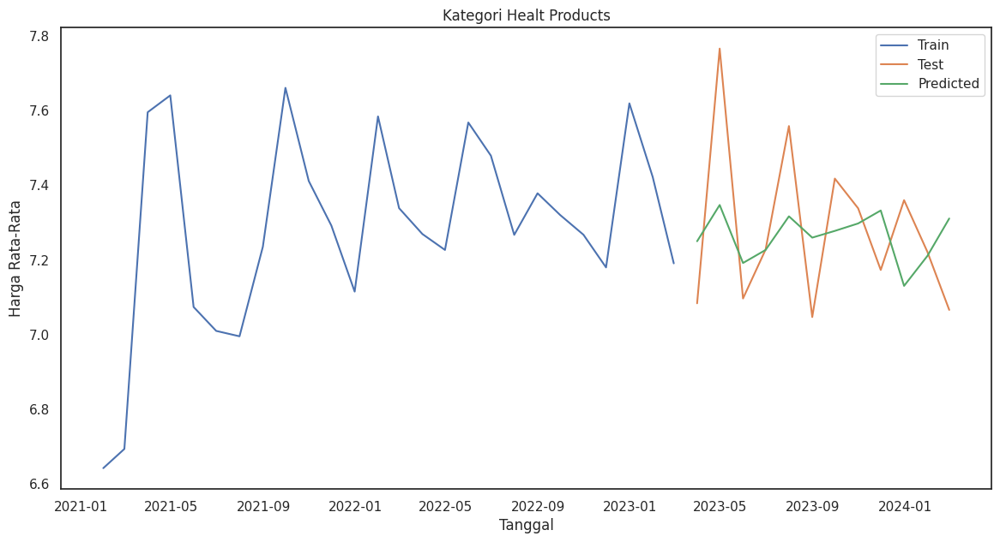

RMSE Kategori Healt Products: 0.19900086349483423
Standar deviasi: 0.06149490172810747
AIC: -0.08135243147566307
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 0, 2)x(1, 0, [1], 12)   Log Likelihood                   6.041
Date:                              Fri, 07 Jun 2024   AIC                             -0.081
Time:                                      08:01:19   BIC                              2.306
Sample:                                  01-31-2021   HQIC                            -1.586
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

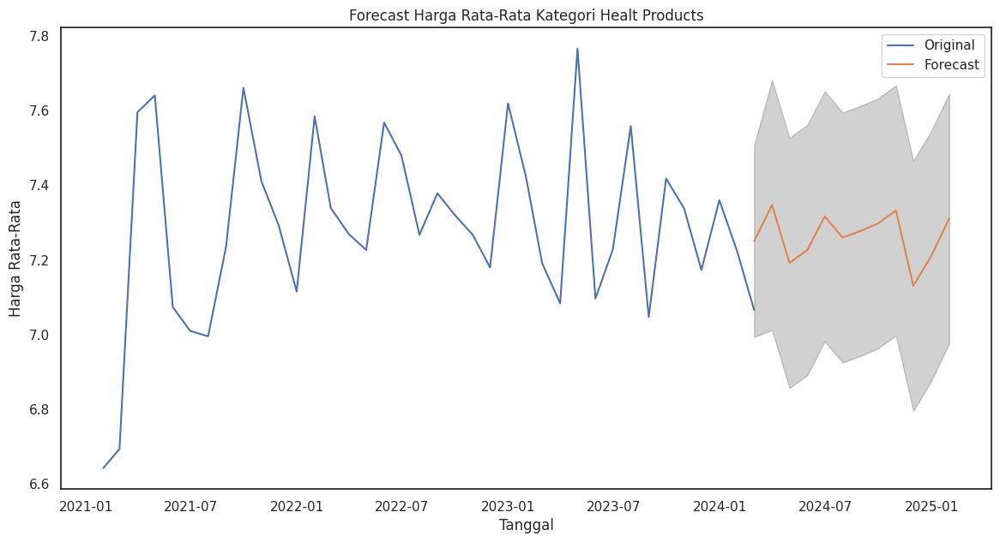

In [ ]:
#Health Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_health = CVFM[CVFM['kategori'] == 'health_products']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_health.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Healt Products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Healt Products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Healt Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Free-From

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "free-from"

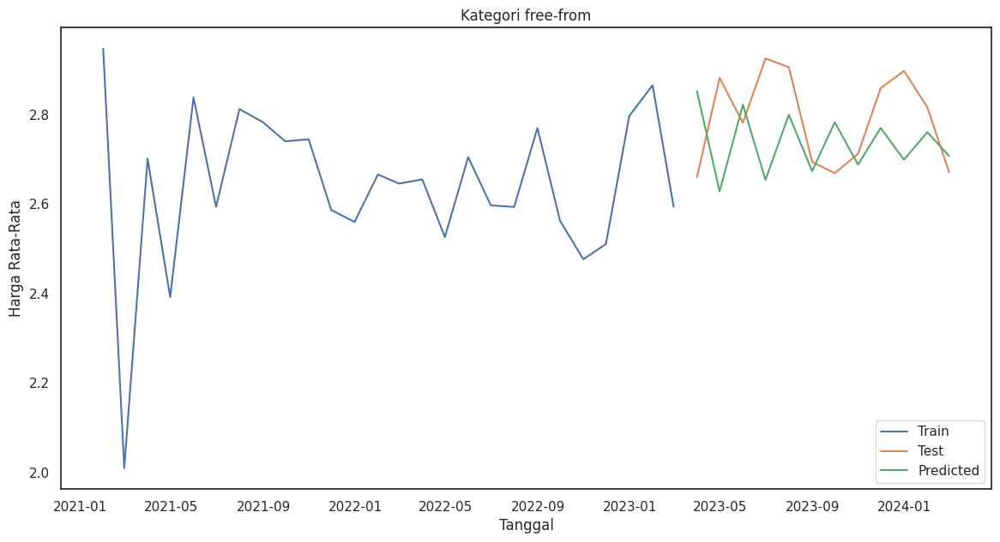

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.737364
2025-02-28    2.727834
2025-03-31    2.736089
2025-04-30    2.728938
2025-05-31    2.735133
2025-06-30    2.729767
2025-07-31    2.734415
2025-08-31    2.730389
2025-09-30    2.733877
2025-10-31    2.730855
2025-11-30    2.733473
2025-12-31    2.731205
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori free-from : 0.14552063245987998
Standar deviasi: 0.06818390881985466
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                   6.282
Date:                Fri, 07 Jun 2024   AIC                             -6.564
Time:                        08:01:21   BIC                             -2.907
Sample:                    01-31-2021   HQIC                            -5.550
                         - 02-28-2023                                  

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_free = CVFM[CVFM['kategori'] == 'free-from']
df_monthly = CVFM_free.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori free-from')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori free-from : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Syntax di atas digunakan untuk Ramalan harga rata-rata bulanan kategori 'free-from'. Dihasilkan nilai RMSE sebesar 0,1455. Sedangkan, untuk standar deviasi yang dihasilkan sebesar 0,06818.

Best ARIMA order: (2, 2, 2) with RMSE: 0.139999225809018


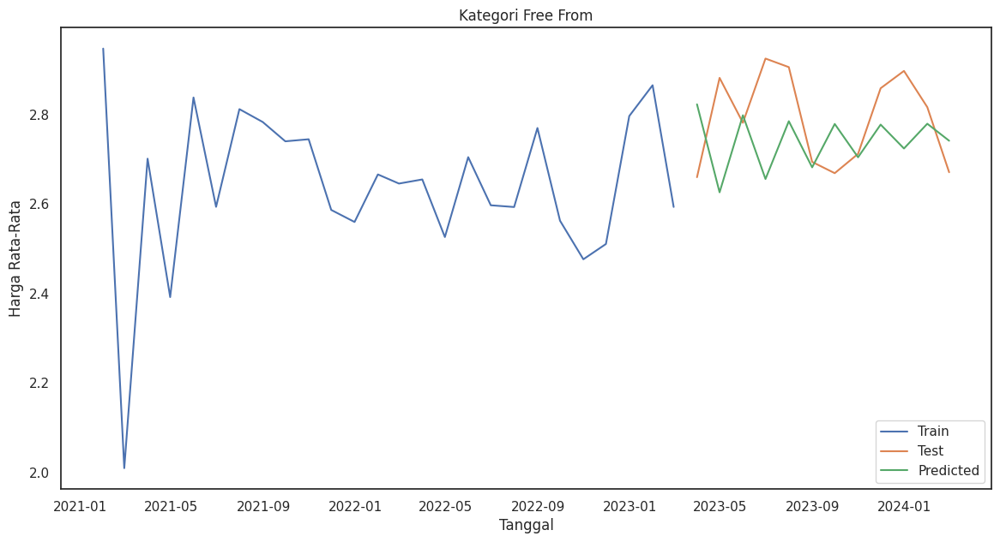

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.822852
2025-02-28    2.821140
2025-03-31    2.832341
2025-04-30    2.832454
2025-05-31    2.842089
2025-06-30    2.843547
2025-07-31    2.852027
2025-08-31    2.854477
2025-09-30    2.862105
2025-10-31    2.865287
2025-11-30    2.872287
2025-12-31    2.876008
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori free from: 0.139999225809018
Standar deviasi: 0.059033978824061625
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 2, 2)   Log Likelihood                   3.840
Date:                Fri, 07 Jun 2024   AIC                              2.320
Time:                        08:01:23   BIC                              8.210
Sample:                    01-31-2021   HQIC                             3.883
                         - 02-28-2023                                    

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'free-from']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori free from: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning diketahui nilai RMSE yang dihasilkan lebih kecil yaitu sebesar 0,1399 dan standar deviasi yang dihasilkanpun juga lebih kecil yaitu sebesar 0,059. Grafik Ramalan pun diketahui mengalami fluktuasi.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "free-from"

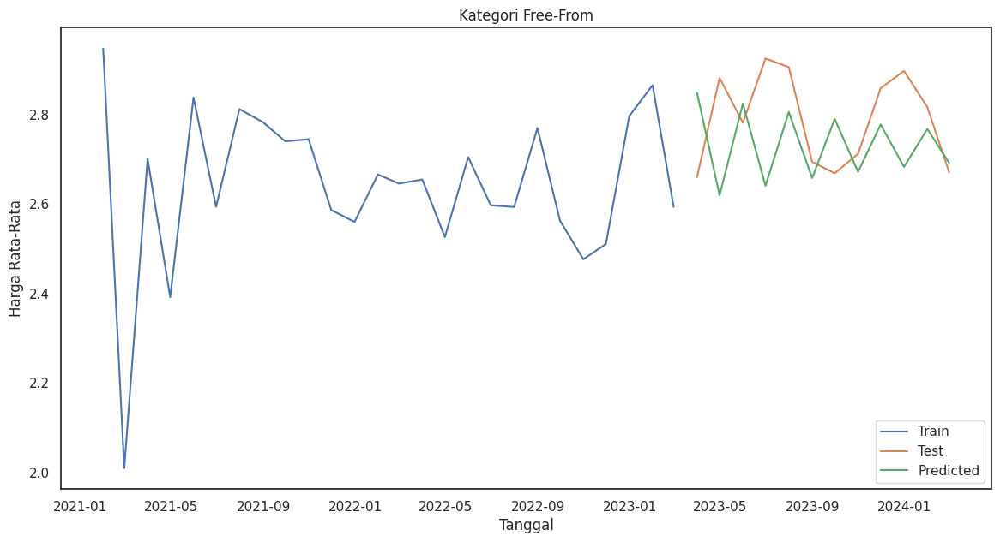

RMSE Kategori free_from: 0.15021495690376252
Standar deviasi: 0.07554675558479741
AIC: -6.4915670467756925
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 0)   Log Likelihood                   6.246
Date:                Fri, 07 Jun 2024   AIC                             -6.492
Time:                        08:01:24   BIC                             -2.835
Sample:                    01-31-2021   HQIC                            -5.477
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9504      0.180     -5.282      0.000      -1.303      -0.598
ar.L2         -0.0493   

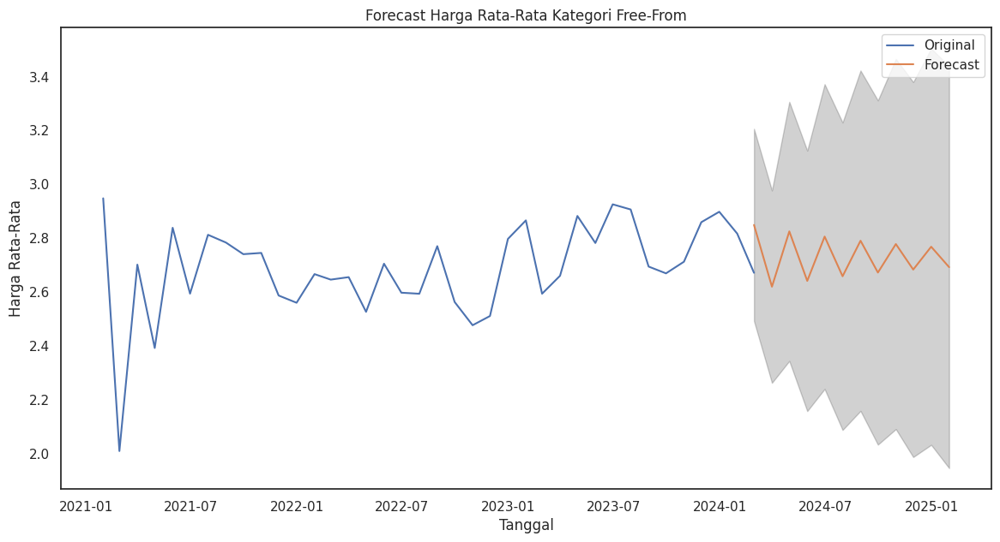

In [ ]:
#Free-From
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_ff = CVFM[CVFM['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2, 1, 0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori free_from: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Free-From untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 2.791552940134056
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.5153583113050246
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.21436872381417874
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.21078914238022664
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.22954550493941908
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.20518331053079988
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.20702024766278787
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.21056345447570046
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 2.721036635166257
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 1.46348466894307
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.21437446383690412
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.21460416891121714
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.23911132133351054
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.27955193889613983
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.20569977525682195
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.21460416891121714
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 2.616044772308041
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 1.42

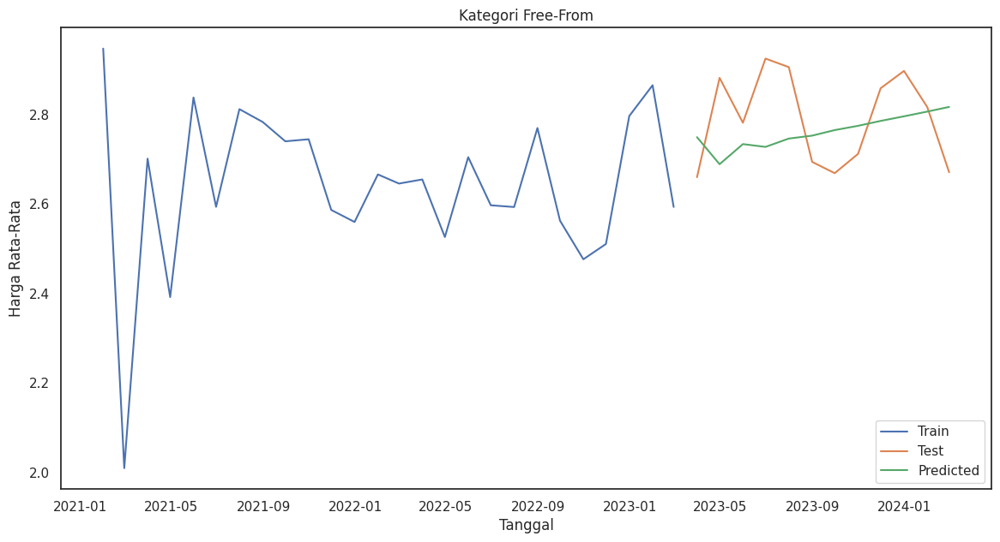

RMSE Kategori free_from: 0.11765288572882321
Standar deviasi: 0.035042826775574715
AIC: -11.798707403575804
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 2, 1)   Log Likelihood                   9.899
Date:                Fri, 07 Jun 2024   AIC                            -11.799
Time:                        08:01:40   BIC                             -7.435
Sample:                    01-31-2021   HQIC                           -10.771
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5182      0.211     -2.453      0.014      -0.932      -0.104
ar.L2         -0.0157  

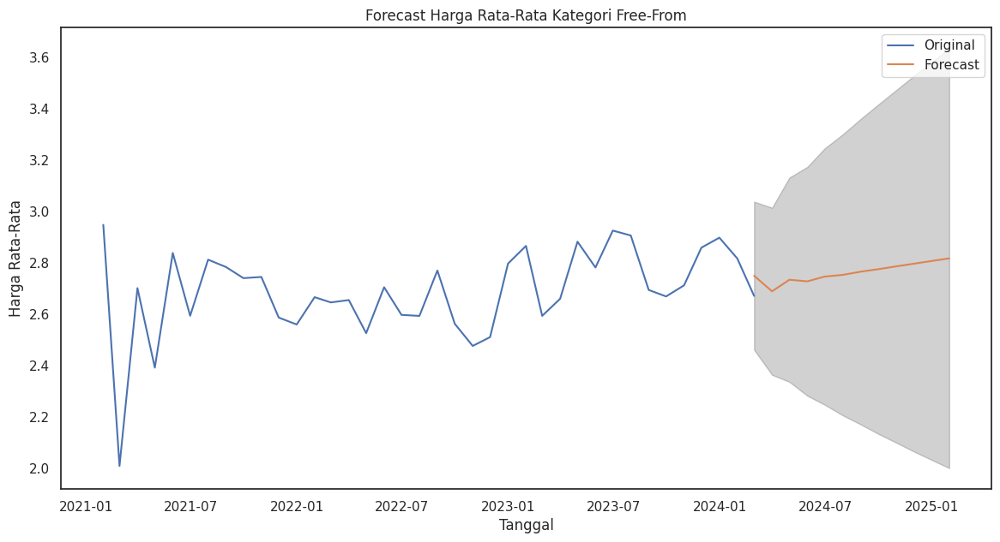

In [ ]:
#Free-From
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_ff = CVFM[CVFM['kategori'] == 'free-from']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_ff.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori free_from: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Free-From untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Free-From')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Household

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "household"

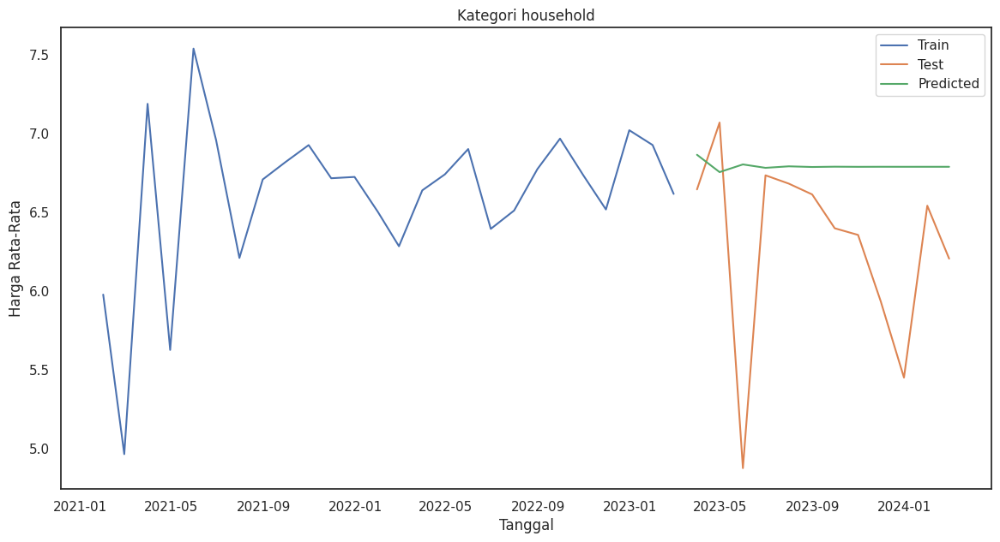

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    6.790713
2025-02-28    6.790713
2025-03-31    6.790713
2025-04-30    6.790713
2025-05-31    6.790713
2025-06-30    6.790713
2025-07-31    6.790713
2025-08-31    6.790713
2025-09-30    6.790713
2025-10-31    6.790713
2025-11-30    6.790713
2025-12-31    6.790713
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori household : 0.772656608726938
Standar deviasi: 0.024174818504404377
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -19.175
Date:                Fri, 07 Jun 2024   AIC                             44.351
Time:                        08:01:41   BIC                             48.007
Sample:                    01-31-2021   HQIC                            45.365
                         - 02-28-2023                                   

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_house = CVFM[CVFM['kategori'] == 'household']
df_monthly = CVFM_house.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori household : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Diketahui nilai RMSE pada Ramalan kategori 'household' menggunakan model ARIMA sebesar 0,77265 dan standar deviasi yang dihasilkan sebesar 0,02417.

Best ARIMA order: (2, 2, 0) with RMSE: 0.6494870286819517


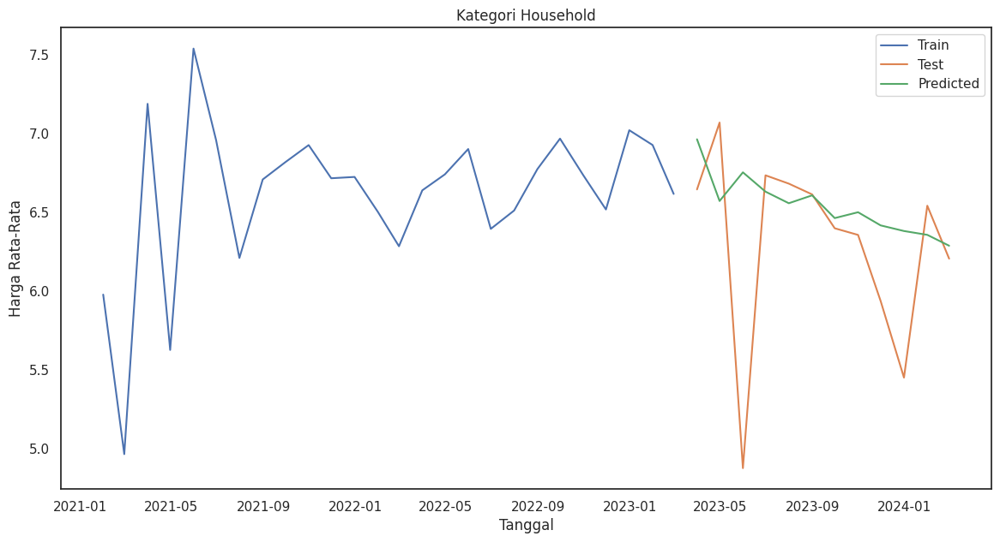

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.843942
2025-02-28    5.800230
2025-03-31    5.759550
2025-04-30    5.717128
2025-05-31    5.675141
2025-06-30    5.633655
2025-07-31    5.591234
2025-08-31    5.549745
2025-09-30    5.507597
2025-10-31    5.465747
2025-11-30    5.423910
2025-12-31    5.381871
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Household: 0.6494870286819517
Standar deviasi: 0.17890439224284066
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 2, 0)   Log Likelihood                 -24.424
Date:                Fri, 07 Jun 2024   AIC                             54.848
Time:                        08:01:43   BIC                             58.382
Sample:                    01-31-2021   HQIC                            55.785
                         - 02-28-2023                                    

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'household']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Household: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning menggunakan order (2,2,0) diketahui nilai RMSE yang lebih kecil yaitu sebesar 0,6494 dan standar deviasi yang lebih besar yaitu sebesar 0,1789.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "household"

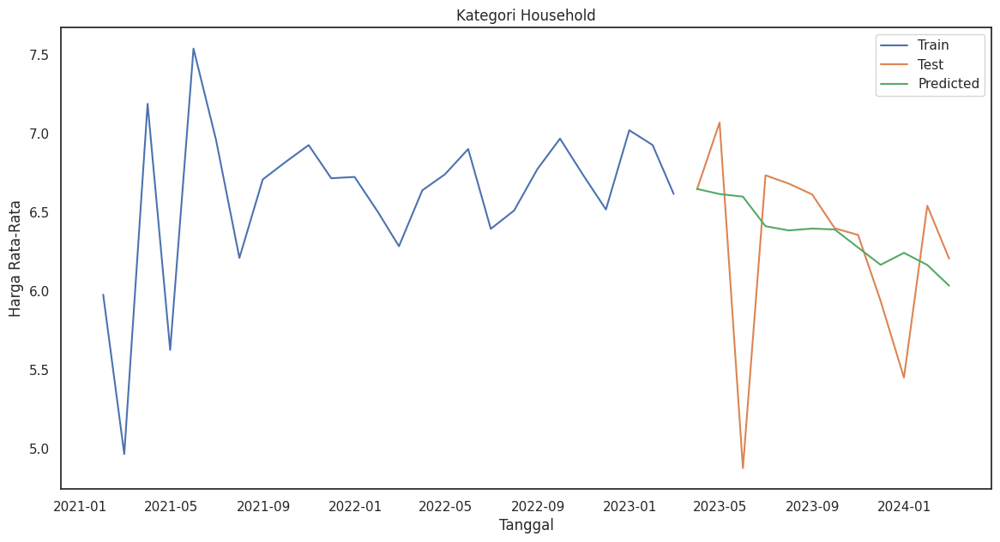

RMSE Kategori Household : 0.5966263140093326
Standar deviasi: 0.18565715728554455
AIC: 68.77115299135392
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 0, 0)x(1, 0, 0, 12)   Log Likelihood                 -31.386
Date:                            Fri, 07 Jun 2024   AIC                             68.771
Time:                                    08:01:44   BIC                             72.545
Sample:                                01-31-2021   HQIC                            69.858
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1    

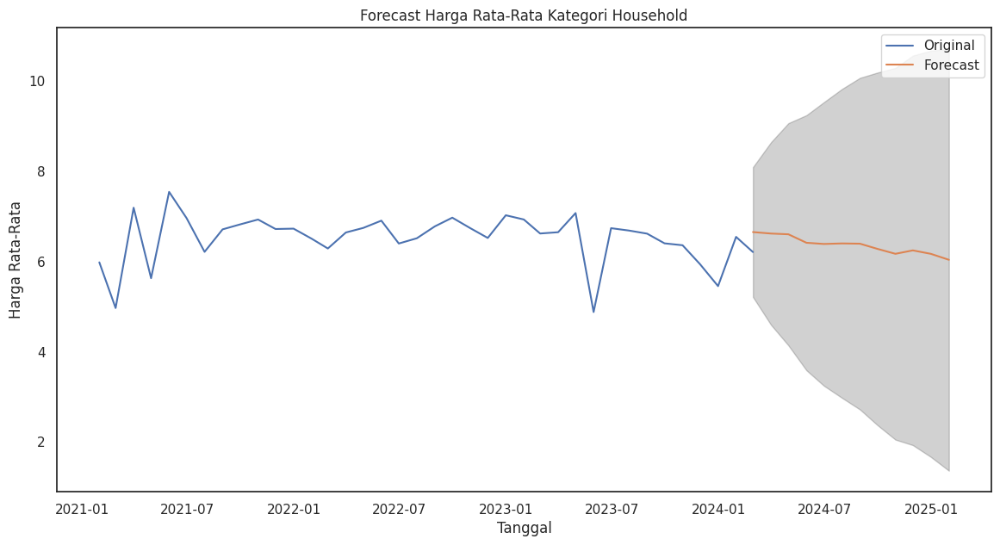

In [ ]:
#Household
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_bakery = CVFM[CVFM['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], oorder=(0,3,3), seasonal_order=(1,0,0,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Household : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Household untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 6.321631679826389
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 3.0887070287063736
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.8148172944806631
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.7983175724601933
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.8874065484116771
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.8264933473899403
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.8021314075145388
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.8068240944298847
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 6.115990039243489
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 2.9405912054184715
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.8159592116246457
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.8157848601779248
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.8915329358173588
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.8332689355802987
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.8022512999068998
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.8157848601779248
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 6.111045301632803
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 6.552182013779

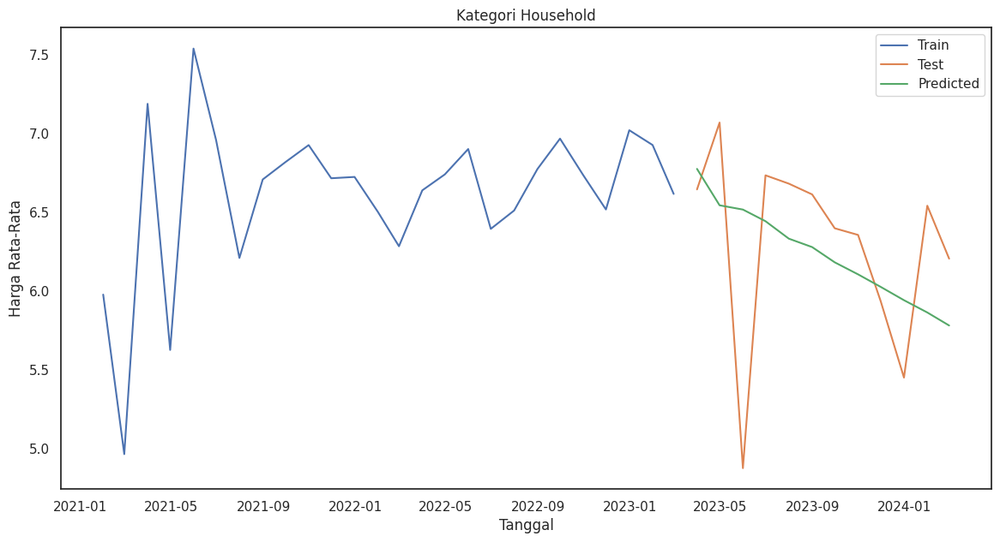

RMSE Kategori Household : 0.5987946971590293
Standar deviasi: 0.29071346245315877
AIC: 39.7646452621762
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 2, 0)   Log Likelihood                 -16.882
Date:                Fri, 07 Jun 2024   AIC                             39.765
Time:                        08:02:01   BIC                             43.038
Sample:                    01-31-2021   HQIC                            40.536
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0228      0.204     -5.007      0.000      -1.423      -0.622
ar.L2         -0.4153      

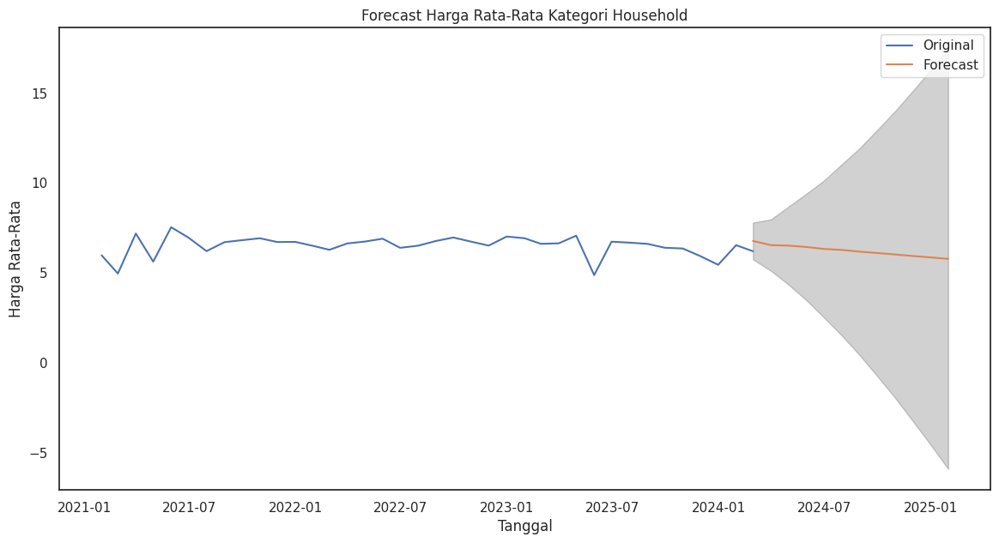

In [ ]:
#Household
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_bakery = CVFM[CVFM['kategori'] == 'household']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Household : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Household untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Household')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Drinks

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "drinks"

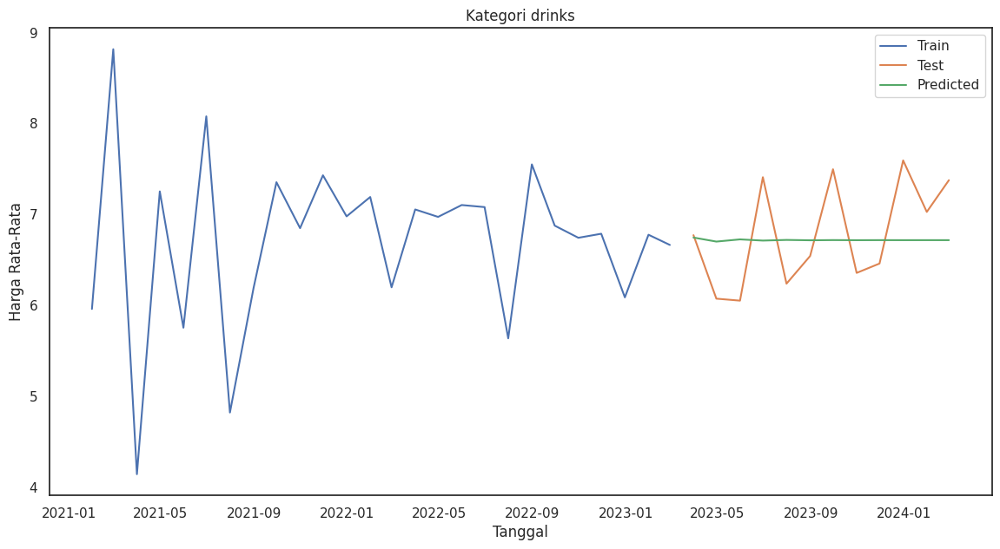

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    6.715866
2025-02-28    6.715865
2025-03-31    6.715866
2025-04-30    6.715866
2025-05-31    6.715866
2025-06-30    6.715866
2025-07-31    6.715866
2025-08-31    6.715866
2025-09-30    6.715866
2025-10-31    6.715866
2025-11-30    6.715866
2025-12-31    6.715866
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori drinks : 0.55549871721825
Standar deviasi: 0.009751858566663522
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -31.543
Date:                Fri, 07 Jun 2024   AIC                             69.086
Time:                        08:02:02   BIC                             72.742
Sample:                    01-31-2021   HQIC                            70.100
                         - 02-28-2023                                       

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_drinks = CVFM[CVFM['kategori'] == 'drinks']
df_monthly = CVFM_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori drinks : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Dilakukan Ramalan menggunakan model ARIMA terhadap harga rata-rata bulanan dan diketahui nilai RMSE yang dihasilkan sebesar 0,5554 dan standar deviasi sebesar 0,00975.

Best ARIMA order: (0, 2, 1) with RMSE: 0.5147529769996304


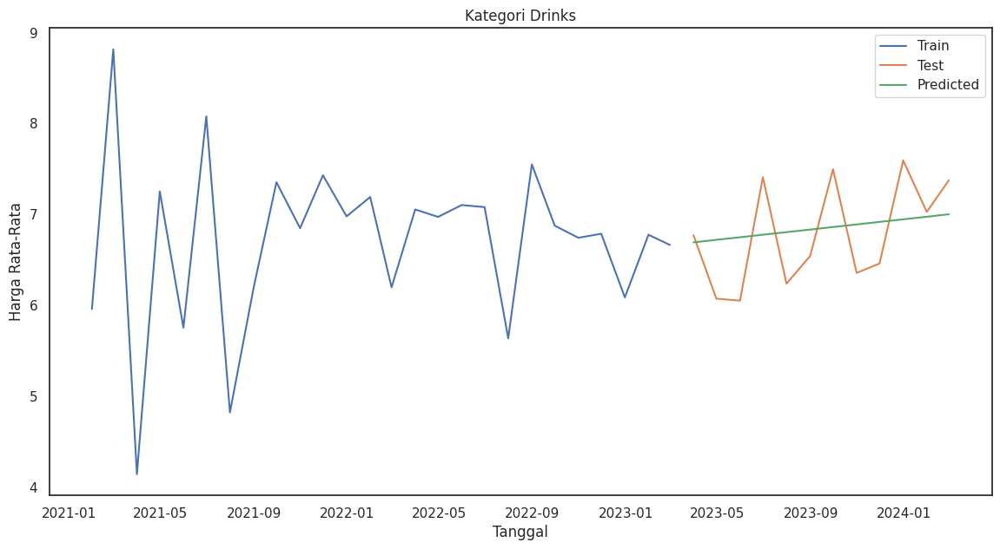

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    7.311364
2025-02-28    7.339544
2025-03-31    7.367724
2025-04-30    7.395903
2025-05-31    7.424083
2025-06-30    7.452263
2025-07-31    7.480443
2025-08-31    7.508623
2025-09-30    7.536803
2025-10-31    7.564983
2025-11-30    7.593162
2025-12-31    7.621342
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Drinks: 0.5147529769996304
Standar deviasi: 0.09727831800053247
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 2, 1)   Log Likelihood                 -48.678
Date:                Fri, 07 Jun 2024   AIC                            101.356
Time:                        08:02:04   BIC                            103.712
Sample:                    01-31-2021   HQIC                           101.981
                         - 02-28-2023                                       

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'drinks']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Drinks: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning, diketahui berdasarkan order (0,2,1) nilai RMSE yang dihasilkan lebih kecil yaitu sebesar 0,5147 dan nilai standar deviasi yang dihasilkan lebih besar yaitu 0,09727.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "drinks"

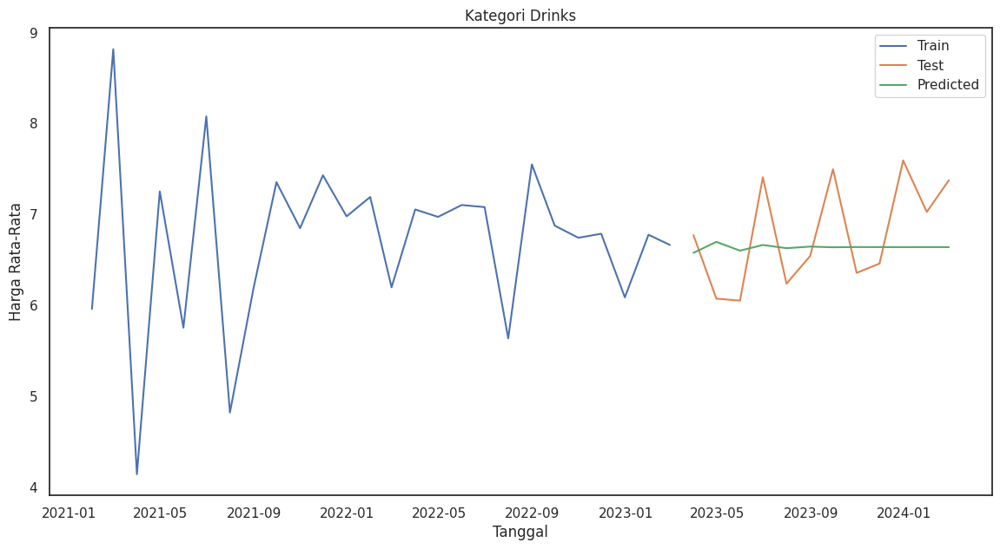

RMSE Kategori drinks: 0.5702332957373227
Standar deviasi: 0.028114776385143782
AIC: 77.16941542556847
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 -35.585
Date:                Fri, 07 Jun 2024   AIC                             77.169
Time:                        08:02:05   BIC                             80.826
Sample:                    01-31-2021   HQIC                            78.184
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0114      0.186     -5.429      0.000      -1.377      -0.646
ar.L2         -0.2909      0.

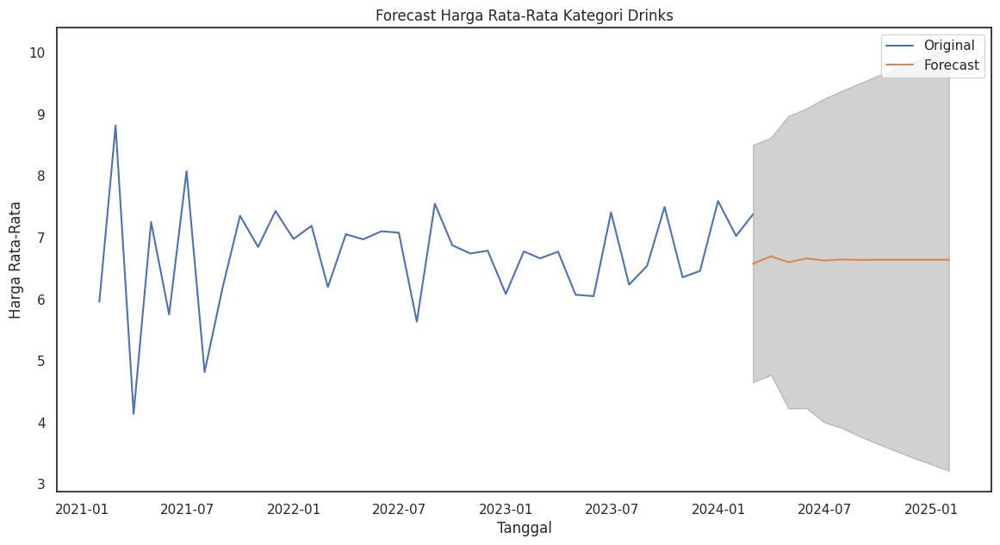

In [ ]:
#Drinks
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori
CVFM_drinks = CVFM[CVFM['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori
df_monthly = CVFM_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,1,0), seasonal_order=(0, 0, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori drinks: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Drinks untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 6.804634198573188
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 3.553010061261543
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.7618600811698573
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.6944382810381435
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.7639294862994642
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.8175899582291194
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.6973269093396872
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.7007842208188912
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 6.578120579353338
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 3.3651596897715432
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.7600567199723449
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.7623160331849395
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.7666504596279105
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.7248810181260981
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.6968682991056759
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.7623160331849395
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 6.515401630606725
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 3.3000961552491

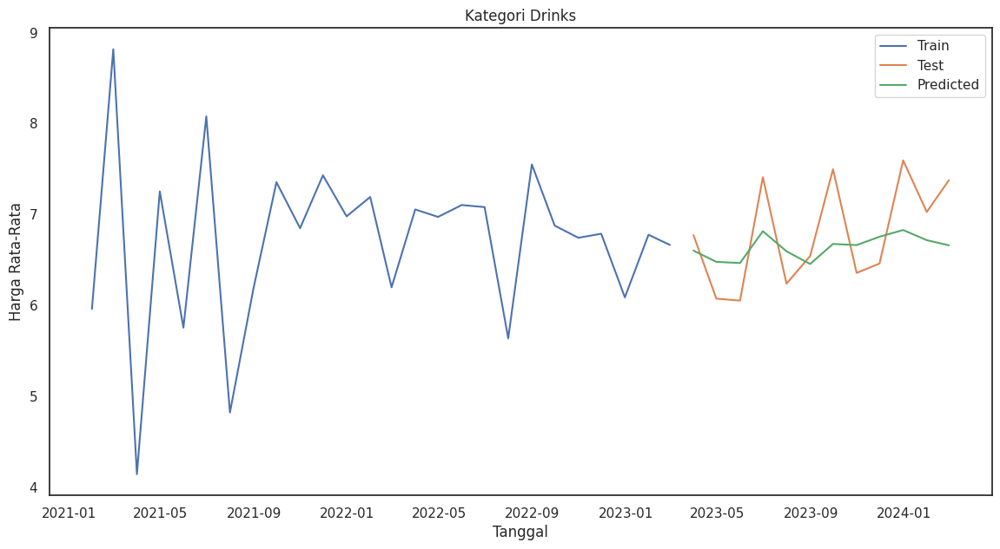

RMSE Kategori drinks: 0.4919726157525689
Standar deviasi: 0.12316894522639733
AIC: 26.390712617561803
                                      SARIMAX Results                                       
Dep. Variable:                           harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 1, 2)x(1, 0, [1], 12)   Log Likelihood                  -6.195
Date:                              Fri, 07 Jun 2024   AIC                             26.391
Time:                                      08:02:20   BIC                             28.509
Sample:                                  01-31-2021   HQIC                            24.067
                                       - 02-28-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

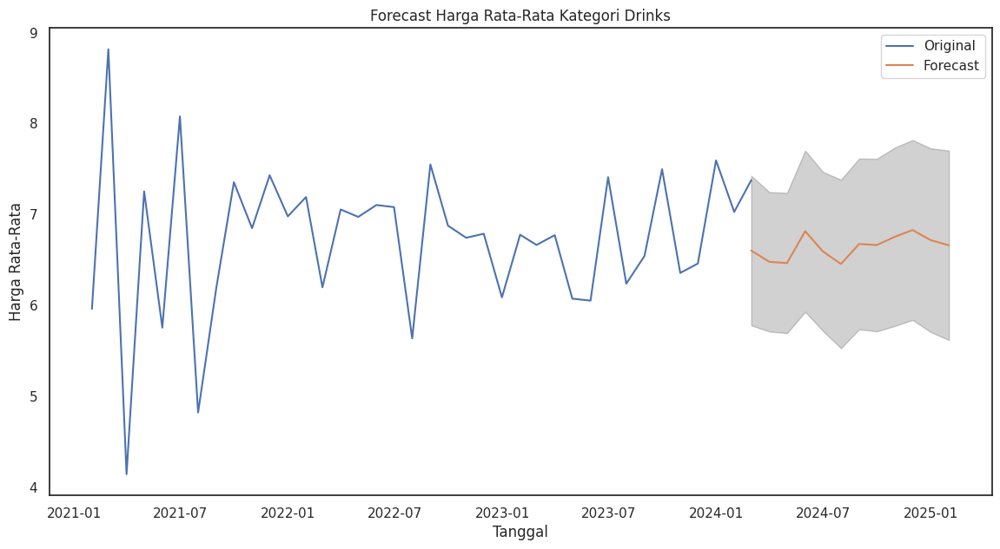

In [ ]:
#Drinks
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_drinks = CVFM[CVFM['kategori'] == 'drinks']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_drinks.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori drinks: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Drinks untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Drinks')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Pets

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "pets"

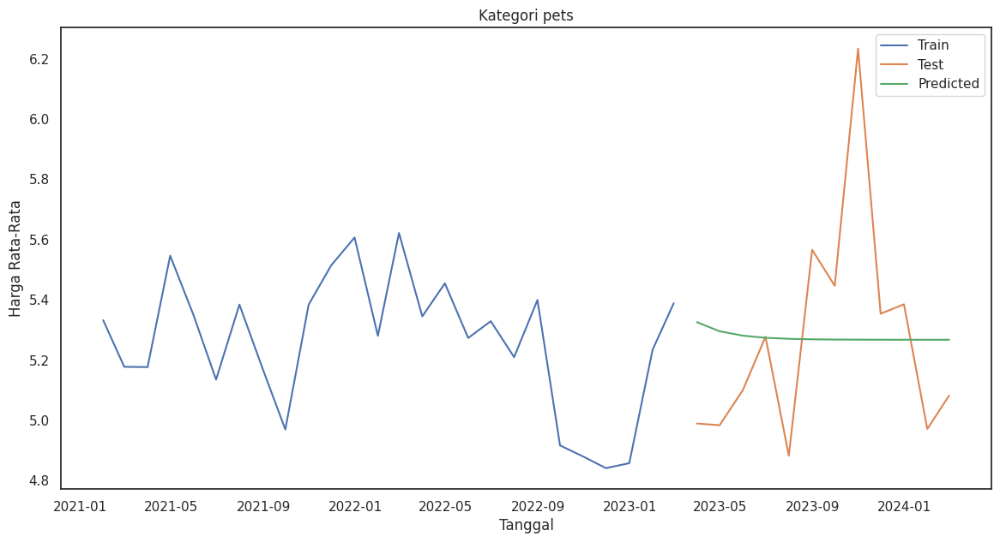

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.267498
2025-02-28    5.267498
2025-03-31    5.267498
2025-04-30    5.267498
2025-05-31    5.267498
2025-06-30    5.267498
2025-07-31    5.267498
2025-08-31    5.267498
2025-09-30    5.267498
2025-10-31    5.267498
2025-11-30    5.267498
2025-12-31    5.267498
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori pets : 0.36396456988096
Standar deviasi: 0.016806545776349446
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                   3.491
Date:                Fri, 07 Jun 2024   AIC                             -0.982
Time:                        08:02:22   BIC                              2.675
Sample:                    01-31-2021   HQIC                             0.032
                         - 02-28-2023                                         

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_pets = CVFM[CVFM['kategori'] == 'pets']
df_monthly = CVFM_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori pets : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Setelah dilakukan Ramalan menggunakan model ARIMA pada harga rata-rata bulanan diketahui nilai RMSE nya sebesar 0,3696 dan standar deviasi sebesar 0,0168.

Best ARIMA order: (2, 1, 0) with RMSE: 0.3562168370159676


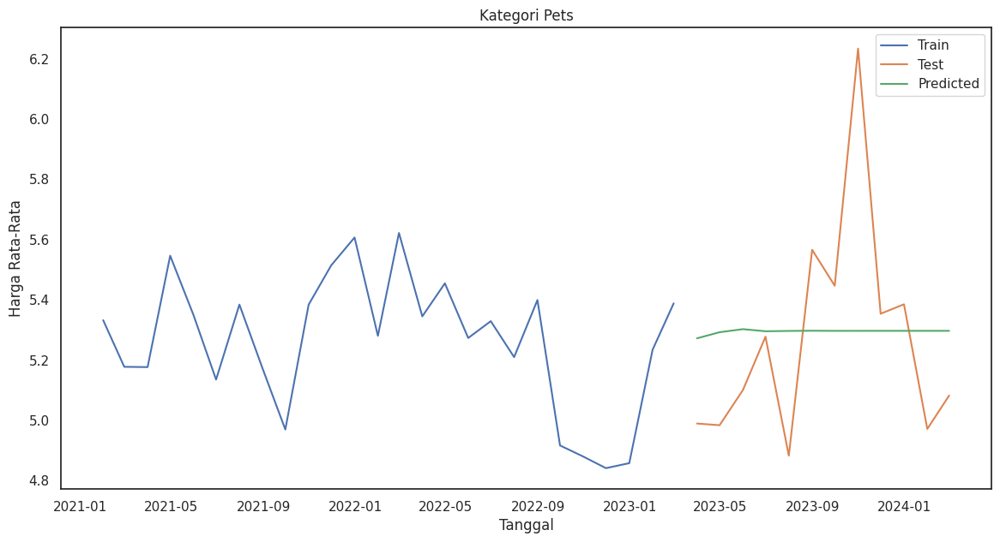

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.297156
2025-02-28    5.297156
2025-03-31    5.297156
2025-04-30    5.297156
2025-05-31    5.297156
2025-06-30    5.297156
2025-07-31    5.297156
2025-08-31    5.297156
2025-09-30    5.297156
2025-10-31    5.297156
2025-11-30    5.297156
2025-12-31    5.297156
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Pets: 0.3562168370159676
Standar deviasi: 0.007183766594048913
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 0)   Log Likelihood                   2.271
Date:                Fri, 07 Jun 2024   AIC                              1.458
Time:                        08:02:24   BIC                              5.115
Sample:                    01-31-2021   HQIC                             2.473
                         - 02-28-2023                                        

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'pets']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Pets: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning, dihasilkan nilai RMSE lebih kecil yaitu sebesar 0,3562 dan standar deviasi yang lebih kecil pula yaitu sebesar 0,00718

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "pets"

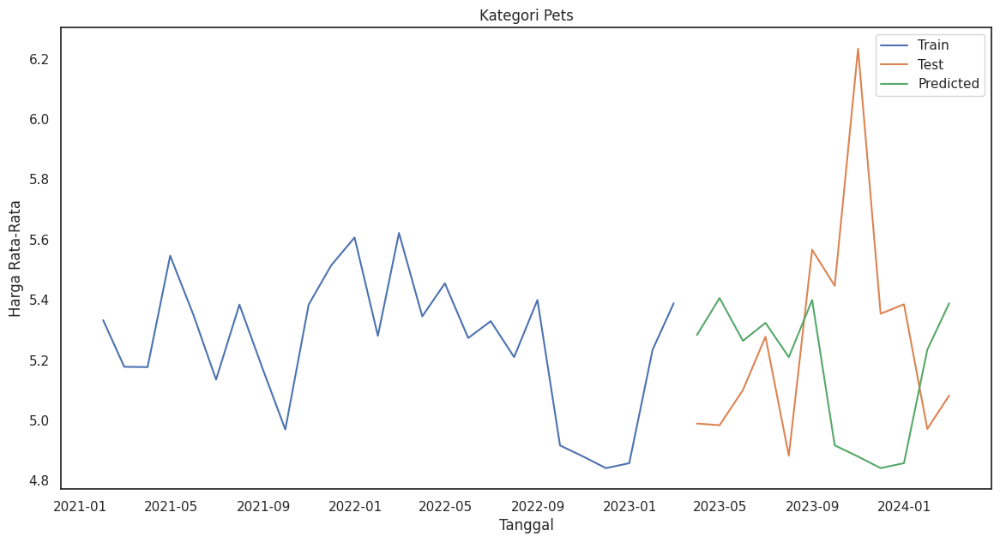

RMSE Kategori Pets : 0.5199972953166782
Standar deviasi: 0.21607391114571106
AIC: 16.029240107832234
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(3, 0, 1)x(0, 1, [], 12)   Log Likelihood                  -3.015
Date:                             Fri, 07 Jun 2024   AIC                             16.029
Time:                                     08:02:25   BIC                             19.225
Sample:                                 01-31-2021   HQIC                            15.733
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1

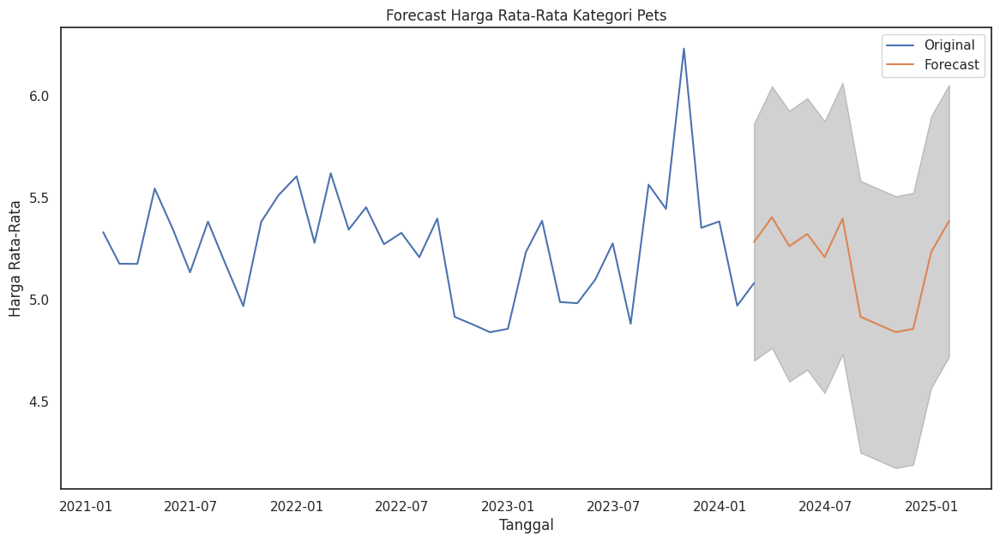

In [ ]:
#Pets
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'pets' saja
CVFM_pets = CVFM[CVFM['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(3, 0, 1), seasonal_order=(0, 1, 0, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Pets : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Pets untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 5.284944185754984
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 2.8031478251729705
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.526991002810608
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.44155138162646723
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.5572509122073219
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.49917002300671764
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.4484083146622745
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.4470218435061048
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 5.112721461469033
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 2.666075434665769
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.5205365875122688
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.5189279364313756
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.5605570624560542
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.5174706823166443
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.4558730887395675
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.5189279364313756
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 5.114633870751021
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 3.910076398391

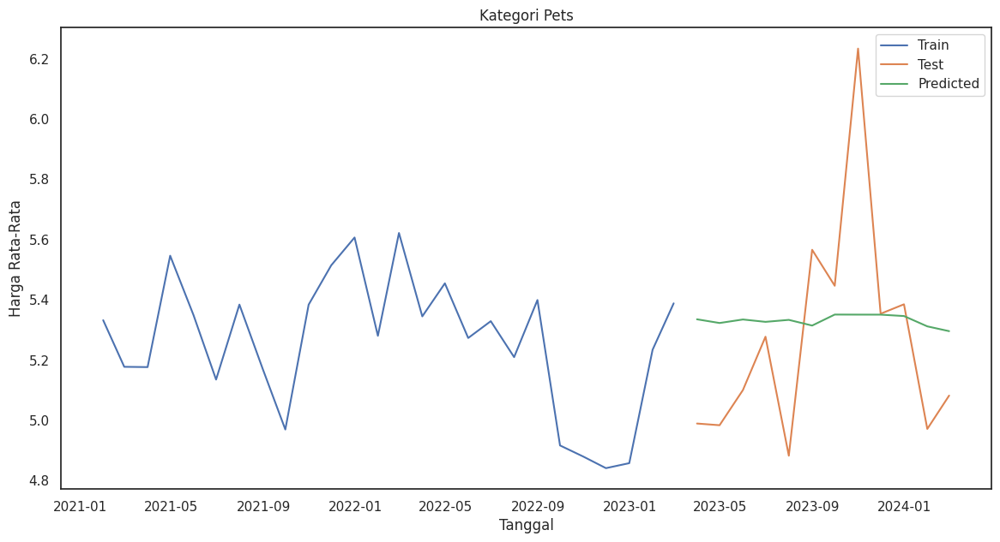

RMSE Kategori Pets : 0.35471990375616935
Standar deviasi: 0.01682115452498822
AIC: 5.801675995919697
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(1, 0, 1)x(1, 0, [], 12)   Log Likelihood                   1.099
Date:                             Fri, 07 Jun 2024   AIC                              5.802
Time:                                     08:02:41   BIC                              8.061
Sample:                                 01-31-2021   HQIC                             5.337
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1

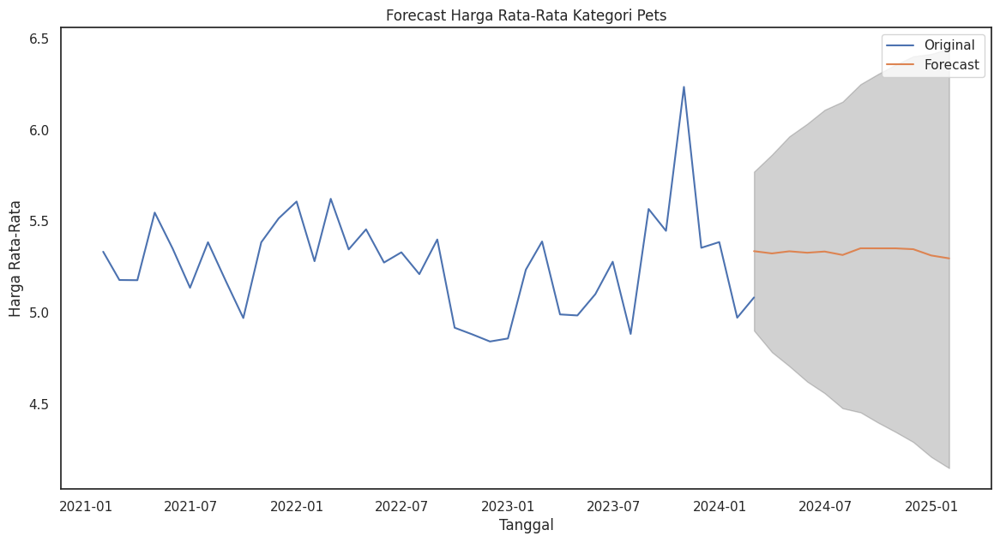

In [ ]:
#Pets
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'pets' saja
CVFM_pets = CVFM[CVFM['kategori'] == 'pets']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_pets.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Pets : {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Pets untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Pets')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Frozen

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "frozen"

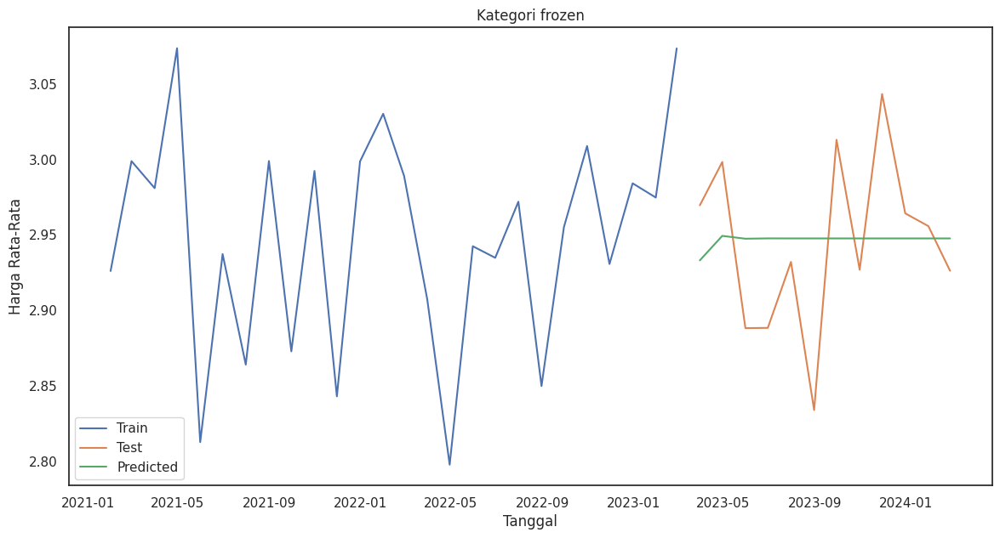

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.947693
2025-02-28    2.947693
2025-03-31    2.947693
2025-04-30    2.947693
2025-05-31    2.947693
2025-06-30    2.947693
2025-07-31    2.947693
2025-08-31    2.947693
2025-09-30    2.947693
2025-10-31    2.947693
2025-11-30    2.947693
2025-12-31    2.947693
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori frozen : 0.056701819936630454
Standar deviasi: 0.004085430057776182
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  28.395
Date:                Fri, 07 Jun 2024   AIC                            -50.789
Time:                        08:02:42   BIC                            -47.133
Sample:                    01-31-2021   HQIC                           -49.775
                         - 02-28-2023                                   

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_frozen = CVFM[CVFM['kategori'] == 'frozen']
df_monthly = CVFM_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori frozen : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Diketahui nilai RMSE yang dihasilkan pada Ramalan harga rata-rata bulanan menggunakan model ARIMA sebesar 0,0567 dan nilai standar deviasi sebesar 0,004

Best ARIMA order: (2, 1, 1) with RMSE: 0.055510916585611414


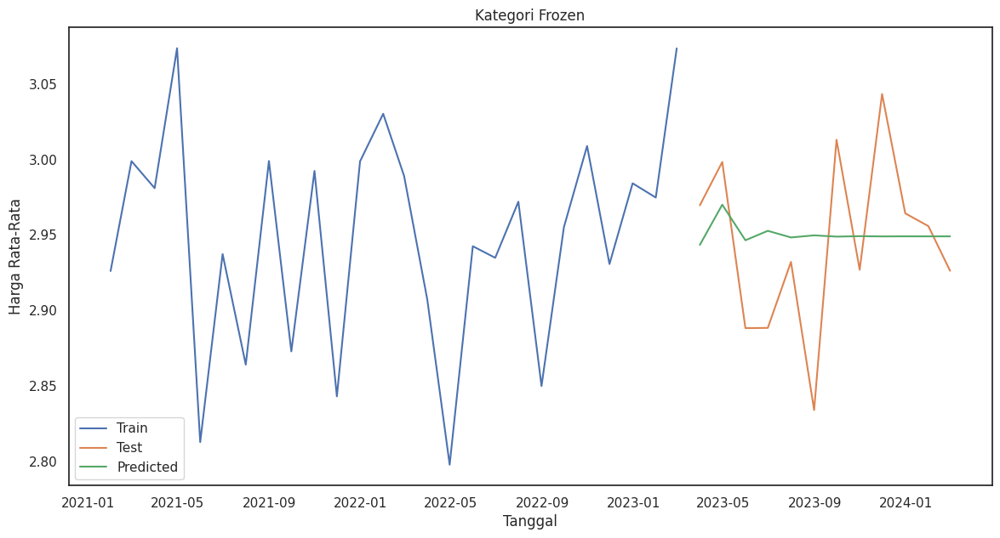

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    2.949052
2025-02-28    2.949052
2025-03-31    2.949052
2025-04-30    2.949052
2025-05-31    2.949052
2025-06-30    2.949052
2025-07-31    2.949052
2025-08-31    2.949052
2025-09-30    2.949052
2025-10-31    2.949052
2025-11-30    2.949052
2025-12-31    2.949052
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Frozen: 0.055510916585611414
Standar deviasi: 0.006264445038226815
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(2, 1, 1)   Log Likelihood                  28.691
Date:                Fri, 07 Jun 2024   AIC                            -49.382
Time:                        08:02:45   BIC                            -44.506
Sample:                    01-31-2021   HQIC                           -48.030
                         - 02-28-2023                                    

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'frozen']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Frozen: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning menggunakan order (2,1,1) dihasilkan nilai RMSE lebih kecil yaitu sebesar 0,05551 namun dengan standar deviasi lebih besar yaitu sebesar 0,00626.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "frozen"

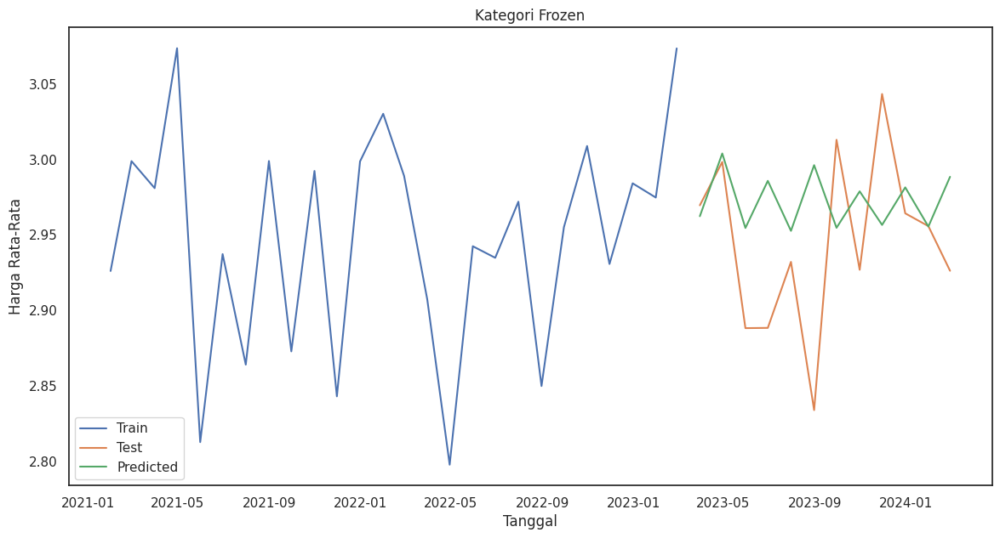

RMSE Kategori Frozen: 0.06983288613958943
Standar deviasi: 0.017742988058866347
AIC: -33.98136248381489
                                         SARIMAX Results                                          
Dep. Variable:                                 harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 0, 2)x(1, 0, [1, 2, 3], 12)   Log Likelihood                  25.991
Date:                                    Fri, 07 Jun 2024   AIC                            -33.981
Time:                                            08:02:48   BIC                            -22.658
Sample:                                        01-31-2021   HQIC                           -30.721
                                             - 02-28-2023                                         
Covariance Type:                                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------

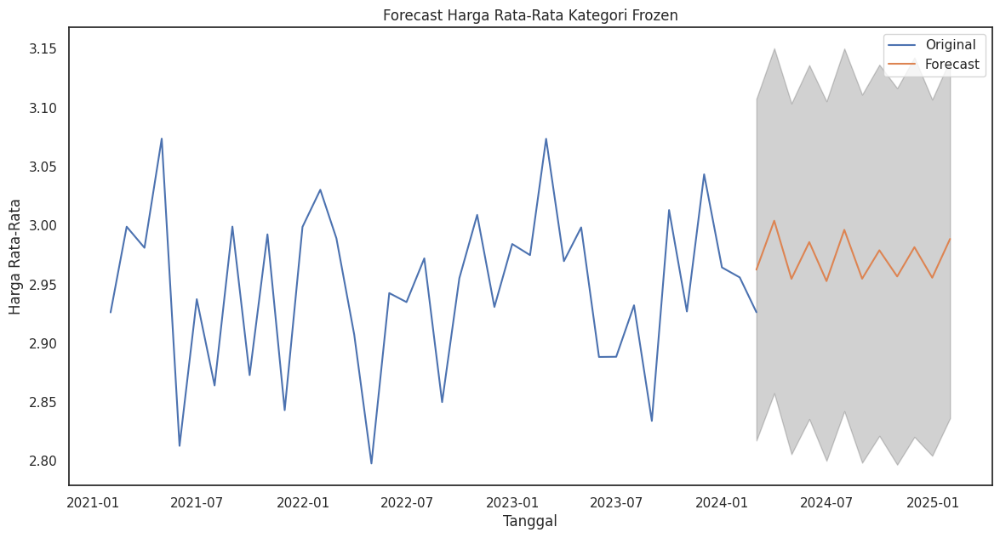

In [ ]:
#Frozen
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'frozen' saja
CVFM_frozen = CVFM[CVFM['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori frozen
df_monthly = CVFM_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,0,2), seasonal_order=(1,0, 3, 12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Frozen: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 2.9455646362822367
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.5183577478107606
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.08955751544248251
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.07463855607789131
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.08955846341862422
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.07453407654095615
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.0781151689405791
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 1.0286240931686017
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 2.9469469124289356
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 3.3674082246734662
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.0918581914124175
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.09105377504315074
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.09201107393477785
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.12546813687464187
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.08280563356273936
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.09105377504315074
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 2.749436554724009
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 1.3

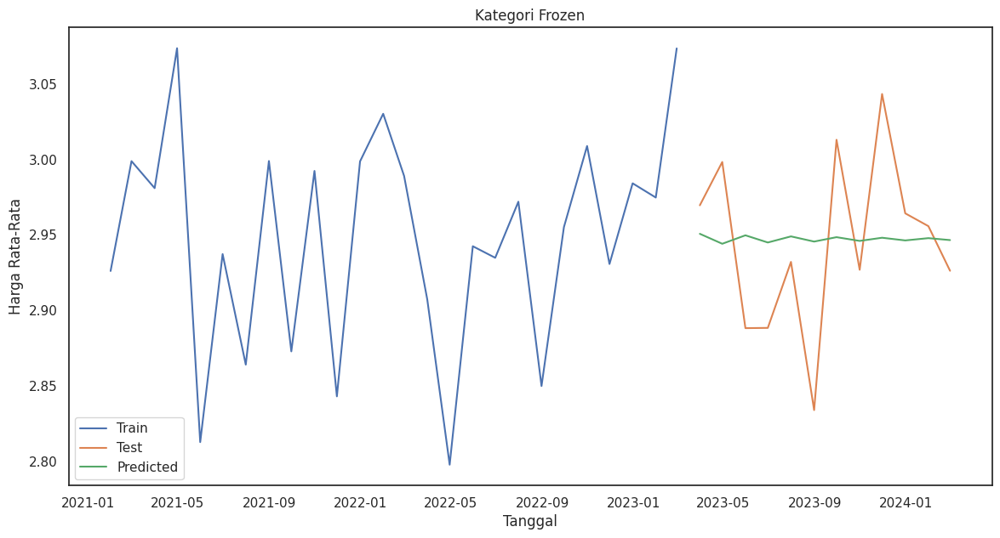

RMSE Kategori Frozen: 0.05583624509139039
Standar deviasi: 0.0019256877294227747
AIC: -44.91599583203053
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(1, 1, 2)   Log Likelihood                  26.458
Date:                Fri, 07 Jun 2024   AIC                            -44.916
Time:                        08:03:06   BIC                            -40.552
Sample:                    01-31-2021   HQIC                           -43.888
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8493      0.076    -11.172      0.000      -0.998      -0.700
ma.L1      -3.106e-05    4

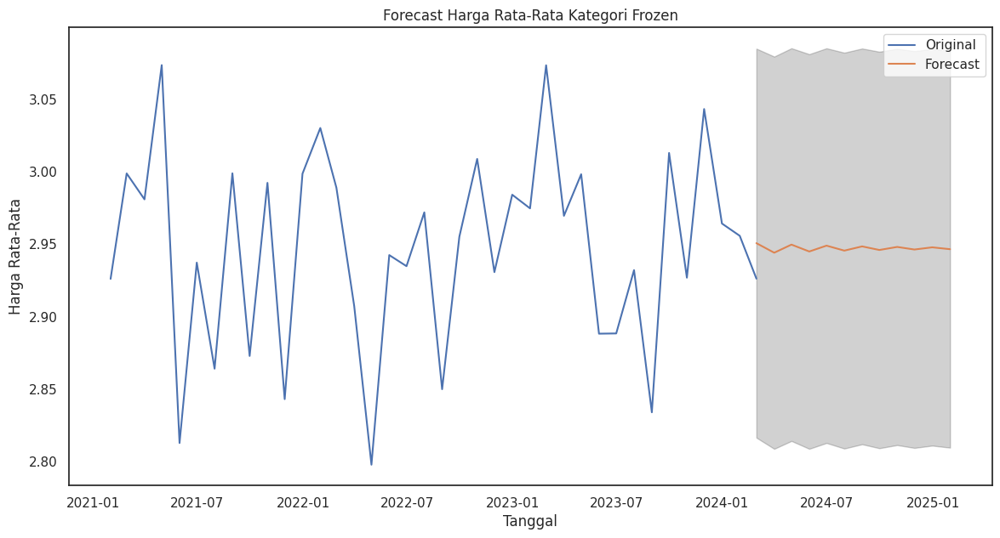

In [ ]:
#Frozen
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'frozen' saja
CVFM_frozen = CVFM[CVFM['kategori'] == 'frozen']

# Mengagregasi data per bulan untuk kategori frozen
df_monthly = CVFM_frozen.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori Frozen: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori Frozen untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Frozen')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

##Bakery

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "bakery"

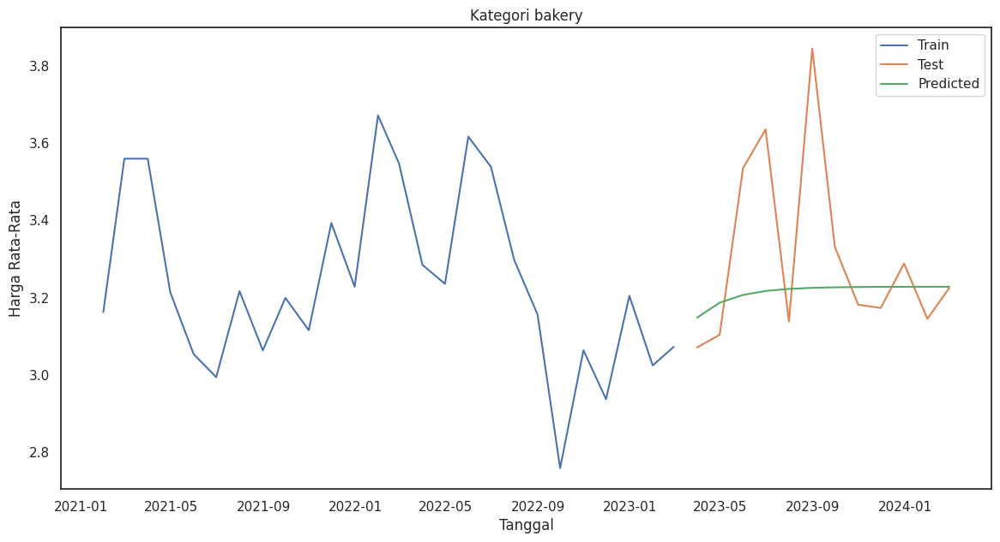

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.227954
2025-02-28    3.227954
2025-03-31    3.227954
2025-04-30    3.227954
2025-05-31    3.227954
2025-06-30    3.227954
2025-07-31    3.227954
2025-08-31    3.227954
2025-09-30    3.227954
2025-10-31    3.227954
2025-11-30    3.227954
2025-12-31    3.227954
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori bakery : 0.24387781597491126
Standar deviasi: 0.023209110274016
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                   3.152
Date:                Fri, 07 Jun 2024   AIC                             -0.303
Time:                        08:03:08   BIC                              3.353
Sample:                    01-31-2021   HQIC                             0.711
                         - 02-28-2023                                       

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_bakery = CVFM[CVFM['kategori'] == 'bakery']
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori bakery : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Dilakukan baseline model ARIMA untuk Ramalan harga rata-rata pada kategori 'bakery' dan dihasilkan nilai RMSE sebesar 0,2438 dan nilai standar deviasi sebesar 0,0232.

Best ARIMA order: (0, 0, 2) with RMSE: 0.24070904642402616


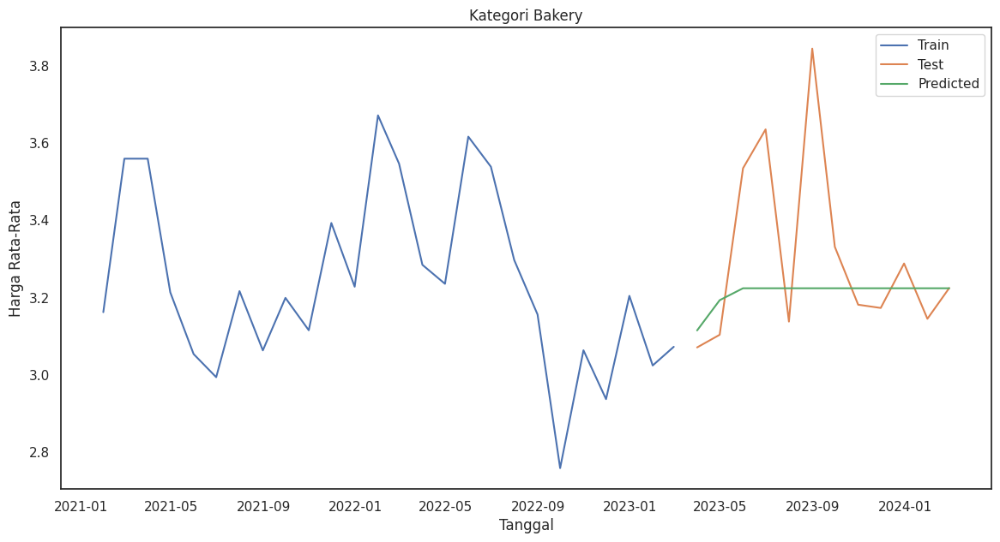

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    3.223984
2025-02-28    3.223984
2025-03-31    3.223984
2025-04-30    3.223984
2025-05-31    3.223984
2025-06-30    3.223984
2025-07-31    3.223984
2025-08-31    3.223984
2025-09-30    3.223984
2025-10-31    3.223984
2025-11-30    3.223984
2025-12-31    3.223984
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Bakery: 0.24070904642402616
Standar deviasi: 0.030618340253135954
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 0, 2)   Log Likelihood                   5.753
Date:                Fri, 07 Jun 2024   AIC                             -3.507
Time:                        08:03:10   BIC                              1.526
Sample:                    01-31-2021   HQIC                            -2.058
                         - 02-28-2023                                     

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'bakery']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Bakery: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Dilakukan tuning menggunakan order (0,0,2) dan dihasilkan nilai RMSE sebesar 0,2407 yang lebih kecil dibanding baseline-nya. Sedangkan, ntuk nilai standar deviasi yang dihasilkan lebih besar dari baselinenya yaitu sebesar 0,0306.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "bakery"

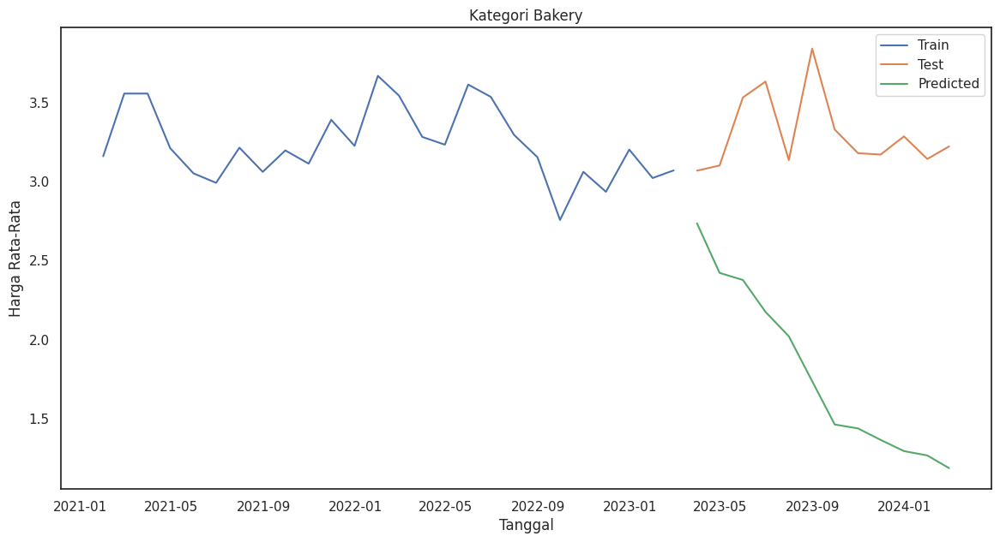

RMSE Kategori bakery: 1.613778031607597
Standar deviasi: 0.5125285104982028
                                     SARIMAX Results                                      
Dep. Variable:                         harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 2, 1)x(0, 1, 1, 12)   Log Likelihood                  -6.755
Date:                            Fri, 07 Jun 2024   AIC                             23.510
Time:                                    08:03:11   BIC                             25.935
Sample:                                01-31-2021   HQIC                            22.612
                                     - 02-28-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2621      0.722     -

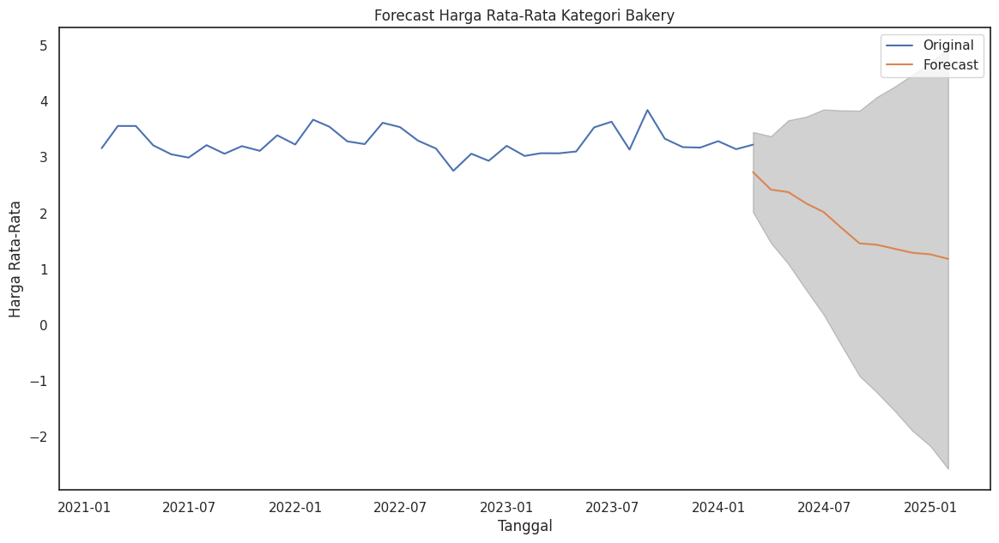

In [ ]:
#Bakery
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_bakery = CVFM[CVFM['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,2,1), seasonal_order=(0,1,1,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)

print(f"RMSE Kategori bakery: {rmse}")
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori bakery untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 3.313952964677168
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 1.7929864548236047
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.2919029175748712
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.4011385504340592
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.31819207312375636
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.38014596032754044
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.47781526601946667
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 19.949074996665125
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 3.2183136695966352
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 1.698590275735402
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.2878736532850189
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.28800304390271775
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.31813917395009006
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.4140487556017395
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.33000699047094695
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.28800304390271775
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 3.136185608428403
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 1.64613

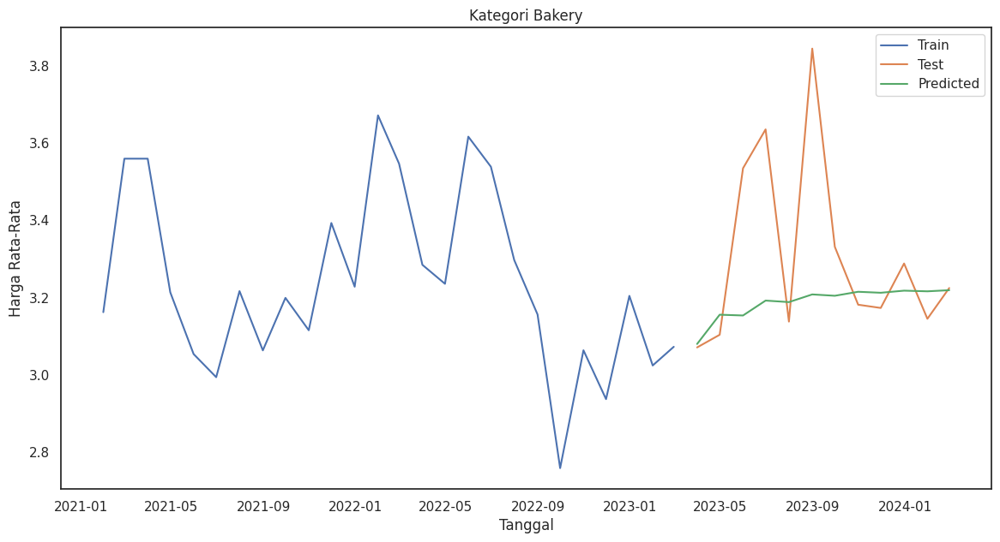

RMSE Kategori bakery: 0.25525804406612645
Standar deviasi: 0.039394777452443366
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:               SARIMAX(2, 1, 2)   Log Likelihood                   3.972
Date:                Fri, 07 Jun 2024   AIC                              2.057
Time:                        08:03:27   BIC                              7.512
Sample:                    01-31-2021   HQIC                             3.342
                         - 02-28-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0754      0.526     -0.143      0.886      -1.106       0.955
ar.L2          0.5075      0.402      1.263      0.

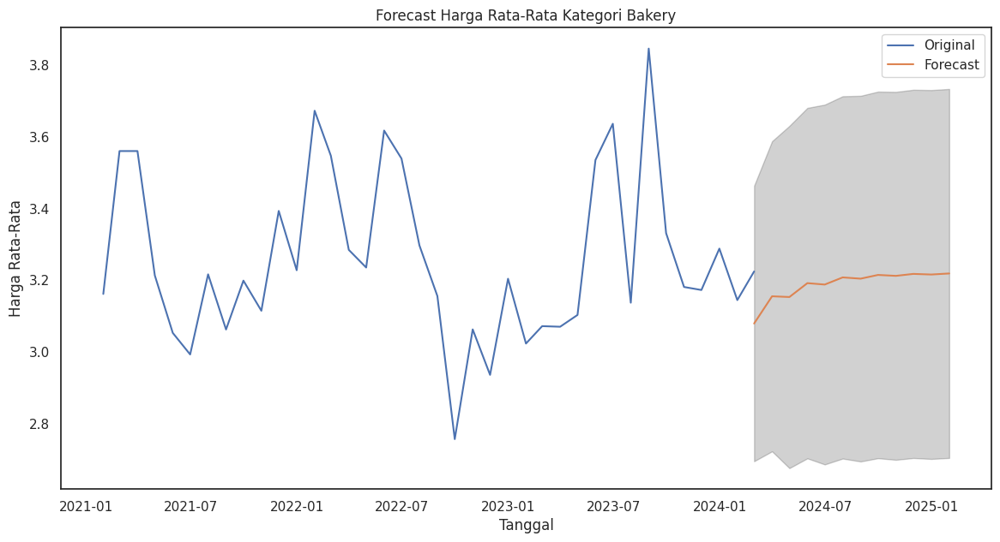

In [ ]:
import itertools
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import statsmodels.api as sm

# Ignore all warnings
warnings.filterwarnings('ignore')

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_bakery = CVFM[CVFM['kategori'] == 'bakery']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_bakery.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)

print(f"RMSE Kategori bakery: {rmse}")
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori bakery untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori Bakery')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()


##Baby_Products

###ARIMA

Base Line Model ARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "baby_products"

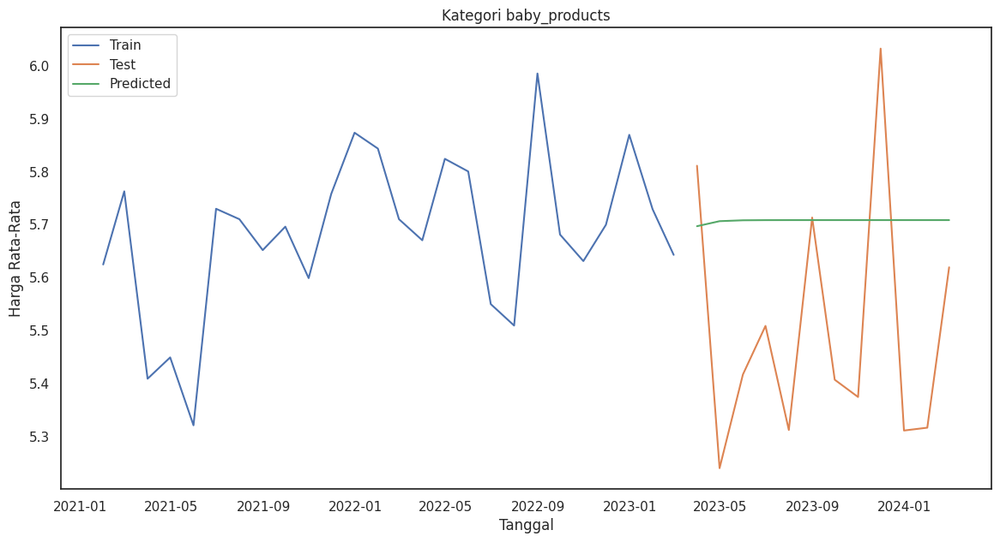

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.708549
2025-02-28    5.708549
2025-03-31    5.708549
2025-04-30    5.708549
2025-05-31    5.708549
2025-06-30    5.708549
2025-07-31    5.708549
2025-08-31    5.708549
2025-09-30    5.708549
2025-10-31    5.708549
2025-11-30    5.708549
2025-12-31    5.708549
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori baby_products : 0.30804552043948685
Standar deviasi: 0.003172015847276432
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(1, 1, 1)   Log Likelihood                  11.288
Date:                Fri, 07 Jun 2024   AIC                            -16.576
Time:                        08:03:28   BIC                            -12.919
Sample:                    01-31-2021   HQIC                           -15.562
                         - 02-28-2023                             

In [ ]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_baby = CVFM[CVFM['kategori'] == 'baby_products']
df_monthly = CVFM_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.ARIMA(train['harga_rata'], order=(1,1,1))
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori baby_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = fitted_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=True)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori baby_products : {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of fit model
print(fitted_model.summary())

Dilakukan Ramalan harga rata-rata bulanan berdasarkan kategori 'baby products' dan dihasilkan nilai RMSE sebesar 0,308 dan nilai standar deviasi sebesar 0,00317.

Best ARIMA order: (0, 1, 0) with RMSE: 0.26924567899525276


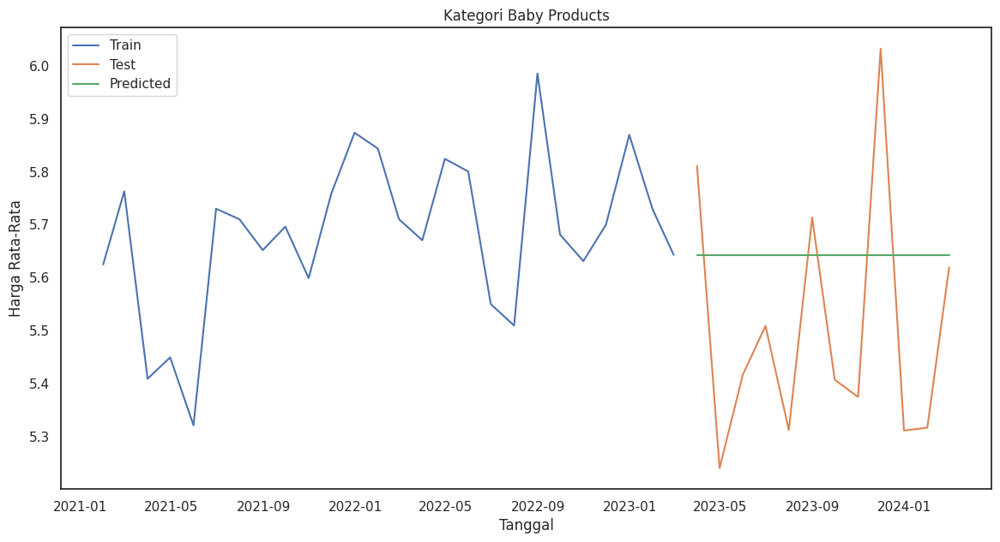

Ramalan harga untuk setiap bulan pada tahun 2025:
2025-01-31    5.6429
2025-02-28    5.6429
2025-03-31    5.6429
2025-04-30    5.6429
2025-05-31    5.6429
2025-06-30    5.6429
2025-07-31    5.6429
2025-08-31    5.6429
2025-09-30    5.6429
2025-10-31    5.6429
2025-11-30    5.6429
2025-12-31    5.6429
Freq: M, Name: predicted_mean, dtype: float64
RMSE Kategori Baby Products: 0.26924567899525276
Standar deviasi: 0.0
                               SARIMAX Results                                
Dep. Variable:             harga_rata   No. Observations:                   26
Model:                 ARIMA(0, 1, 0)   Log Likelihood                   6.442
Date:                Fri, 07 Jun 2024   AIC                            -10.884
Time:                        08:03:30   BIC                             -9.665
Sample:                    01-31-2021   HQIC                           -10.546
                         - 02-28-2023                                         
Covariance Type:             

In [ ]:
#Tuning menggunakan For Loop
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np
from itertools import product

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data berdasarkan kategori yang dipilih
CVFM_home = CVFM[CVFM['kategori'] == 'baby_products']
df_monthly = CVFM_home.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Definisikan grid parameter
p = d = q = range(0, 3)
pdq = list(product(p, d, q))

# Inisialisasi variabel untuk menyimpan hasil terbaik
best_rmse = np.inf
best_order = None
best_model = None

# Iterasi melalui semua kombinasi parameter
for param in pdq:
    try:
        model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
        fitted_model = model_train.fit()

        # Ramalan pada data test
        predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

        # Hitung RMSE
        rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

        # Evaluasi model dengan RMSE
        if rmse < best_rmse:
            best_rmse = rmse
            best_order = param
            best_model = fitted_model
    except Exception as e:
        continue

print(f"Best ARIMA order: {best_order} with RMSE: {best_rmse}")

# Ramalan pada data test dengan model terbaik
predictions = best_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Forecasting untuk bulan Januari-Desember 2025
forecast_start_date = '2025-01-31'
forecast_end_date = '2025-12-31'
forecast = best_model.predict(start=forecast_start_date, end=forecast_end_date, dynamic=False)

# Print Ramalan harga untuk setiap bulan pada tahun 2025
print("Ramalan harga untuk setiap bulan pada tahun 2025:")
print(forecast)

# Menghitung metrik evaluasi, misalnya RMSE
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
print(f"RMSE Kategori Baby Products: {rmse}")

# Menghitung standar deviasi
std_dev = np.std(predictions)
print(f"Standar deviasi: {std_dev}")

# Print summary of best model
print(best_model.summary())

Setelah dilakukan tuning, diketahui nilai RMSE yang dihasilkan lebih kecil yaitu sebesar 0,2692. Begitu pula dengan nilai standar deviasi yang lebih kecil yaitu 0.

###SARIMA

Base Line Model SARIMA untuk menganalisis Ramalan harga rata-rata perbulan dimasa depan untuk kategori "baby_products"

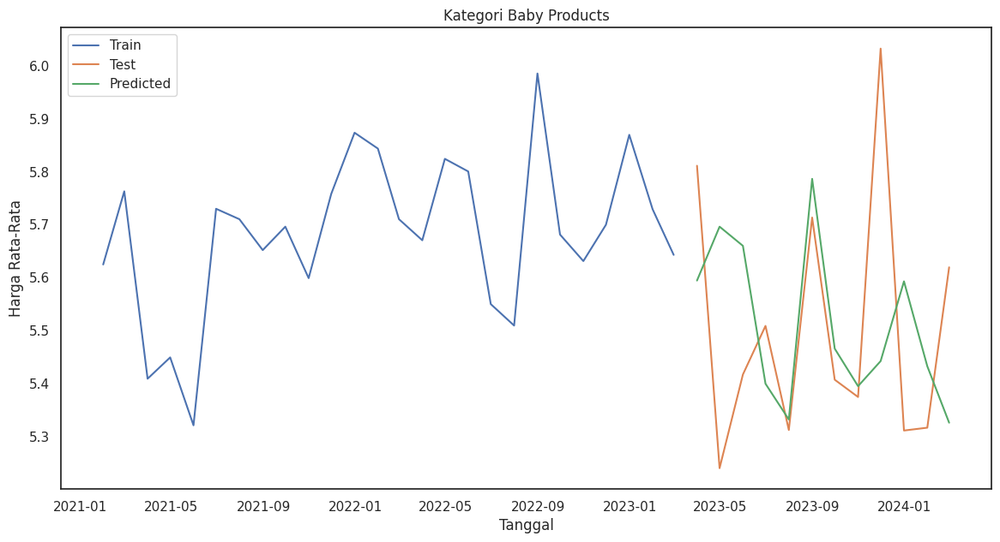

RMSE Kategori baby_products: 0.2680617178745324
Standar deviasi: 0.14461967060541928
AIC: 12.586092632128548
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(2, 2, 1)x(0, 1, [], 12)   Log Likelihood                  -2.293
Date:                             Fri, 07 Jun 2024   AIC                             12.586
Time:                                     08:03:31   BIC                             14.526
Sample:                                 01-31-2021   HQIC                            11.868
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------

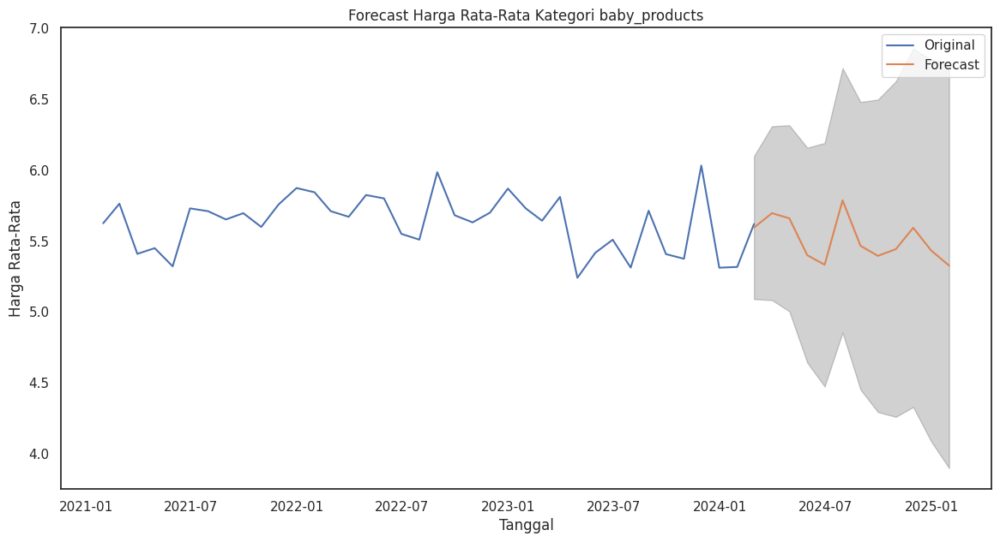

In [ ]:
#Baby Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_baby = CVFM[CVFM['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Fit model pada data train
model_train = sm.tsa.SARIMAX(train['harga_rata'], order=(2,2,1), seasonal_order=(0,1,0,12))  # Misalnya menggunakan SARIMA
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori baby_products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori baby_products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori baby_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

Tunning

ARIMA(0, 0, 0)x(0, 0, 0, 12) - RMSE: 5.510226403417159
ARIMA(0, 0, 0)x(0, 0, 1, 12) - RMSE: 2.755269716077
ARIMA(0, 0, 0)x(0, 1, 0, 12) - RMSE: 0.33618762067766
ARIMA(0, 0, 0)x(0, 1, 1, 12) - RMSE: 0.39785984736689484
ARIMA(0, 0, 0)x(1, 0, 0, 12) - RMSE: 0.38298449563103376
ARIMA(0, 0, 0)x(1, 0, 1, 12) - RMSE: 0.4191895785531605
ARIMA(0, 0, 0)x(1, 1, 0, 12) - RMSE: 0.3093052131456523
ARIMA(0, 0, 0)x(1, 1, 1, 12) - RMSE: 0.5309662492240078
ARIMA(0, 0, 1)x(0, 0, 0, 12) - RMSE: 5.3104148020677915
ARIMA(0, 0, 1)x(0, 0, 1, 12) - RMSE: 2.5772940365244286
ARIMA(0, 0, 1)x(0, 1, 0, 12) - RMSE: 0.3365291230396906
ARIMA(0, 0, 1)x(0, 1, 1, 12) - RMSE: 0.33651446499042265
ARIMA(0, 0, 1)x(1, 0, 0, 12) - RMSE: 0.38130008008301924
ARIMA(0, 0, 1)x(1, 0, 1, 12) - RMSE: 0.37431632346888954
ARIMA(0, 0, 1)x(1, 1, 0, 12) - RMSE: 0.31773282261203856
ARIMA(0, 0, 1)x(1, 1, 1, 12) - RMSE: 0.33651446499042265
ARIMA(0, 0, 2)x(0, 0, 0, 12) - RMSE: 5.183313552700989
ARIMA(0, 0, 2)x(0, 0, 1, 12) - RMSE: 2.5218307354

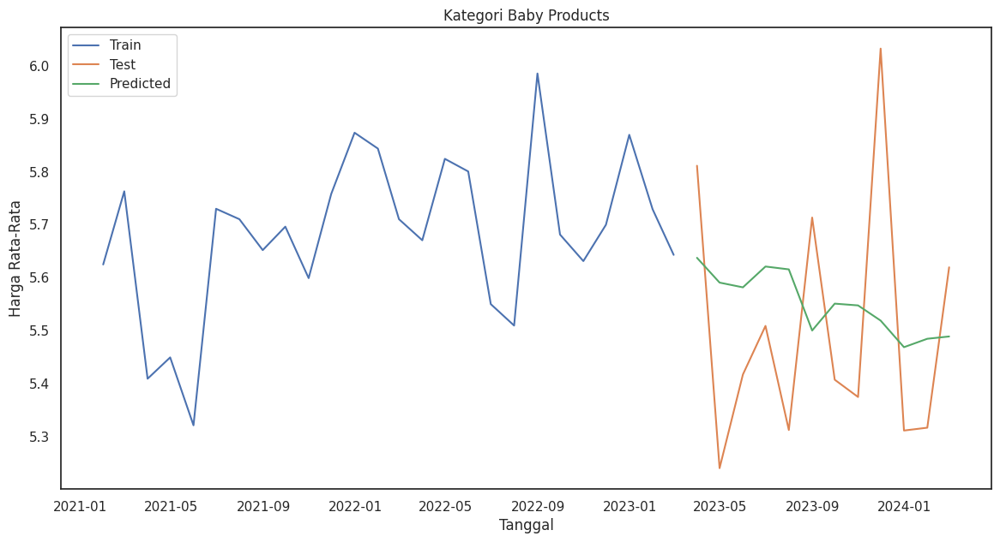

RMSE Kategori baby_products: 0.24396593592454963
Standar deviasi: 0.056060159702300494
AIC: 3.708278918007216
                                      SARIMAX Results                                      
Dep. Variable:                          harga_rata   No. Observations:                   26
Model:             SARIMAX(0, 2, 1)x(1, 0, [], 12)   Log Likelihood                   1.146
Date:                             Fri, 07 Jun 2024   AIC                              3.708
Time:                                     08:03:47   BIC                              5.163
Sample:                                 01-31-2021   HQIC                             3.170
                                      - 02-28-2023                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

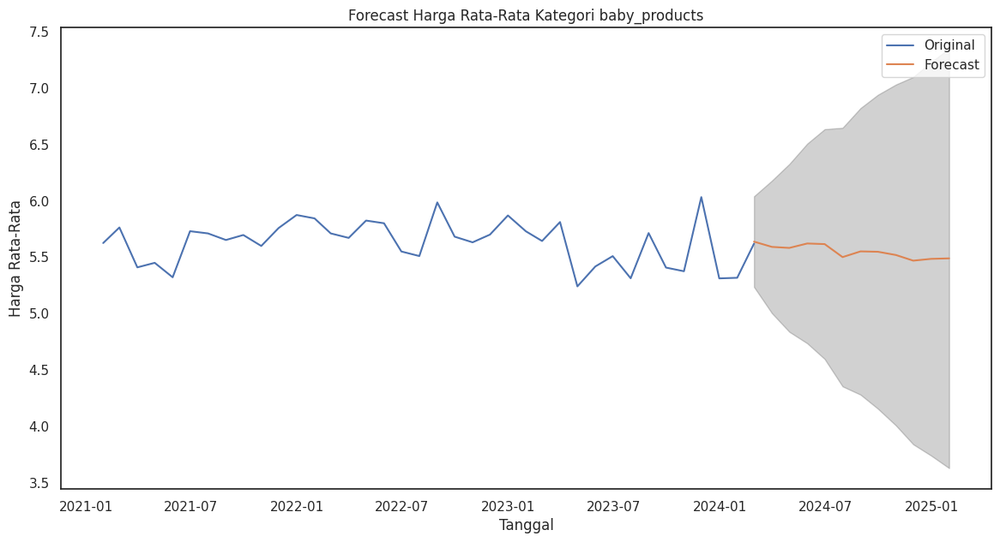

In [ ]:
#Baby Products
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Pastikan kolom tanggal dalam format datetime
CVFM['tanggal'] = pd.to_datetime(CVFM['tanggal'])

# Filter data untuk kategori 'bakery' saja
CVFM_baby = CVFM[CVFM['kategori'] == 'baby_products']

# Mengagregasi data per bulan untuk kategori bakery
df_monthly = CVFM_baby.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

# Mengatur ulang data menjadi time series
df_monthly = df_monthly.set_index('tanggal')
df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

# Split data menjadi train dan test
train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
test = df_monthly.iloc[-12:]

# Define the p, d, q parameters to take any value between 0 and 2
p = d = q = range(0, 3)
# Define the seasonal p, d, q parameters to take any value between 0 and 1
P = D = Q = range(0, 2)
# Define the seasonal period
s = 12

# Generate all different combinations of p, d, q triplets
pdq = list(itertools.product(p, d, q))
# Generate all different combinations of seasonal p, d, q triplets
seasonal_pdq = list(itertools.product(P, D, Q, [s]))

# Perform Grid Search
best_rmse = np.inf
best_params = None
best_seasonal_params = None
results_list = []

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.SARIMAX(train['harga_rata'],
                                 order=param,
                                 seasonal_order=seasonal_param,
                                 enforce_stationarity=False,
                                 enforce_invertibility=False)
            results = mod.fit()
            predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
            results_list.append((param, seasonal_param, rmse))
            if rmse < best_rmse:
                best_rmse = rmse
                best_params = param
                best_seasonal_params = seasonal_param
        except Exception as e:
            print(f"Error: {e}")
            continue

# Print all parameter combinations and their RMSE
for params in results_list:
    print(f'ARIMA{params[0]}x{params[1]} - RMSE: {params[2]}')

print(f'\nBest ARIMA{best_params}x{best_seasonal_params} - RMSE: {best_rmse}')

# Fit model pada data train dengan parameter terbaik
model_train = sm.tsa.SARIMAX(train['harga_rata'],
                             order=best_params,
                             seasonal_order=best_seasonal_params,
                             enforce_stationarity=False,
                             enforce_invertibility=False)
fitted_model = model_train.fit()

# Ramalan pada data test
predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=True)

# Plotting data asli dan Ramalan
plt.figure(figsize=(14, 7))
plt.plot(train.index, train['harga_rata'], label='Train')
plt.plot(test.index, test['harga_rata'], label='Test')
plt.plot(test.index, predictions, label='Predicted')
plt.title('Kategori Baby Products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Menghitung metrik evaluasi(RMSE), std, Aic
rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
std_dev = np.std(predictions)
aic = fitted_model.aic

print(f"RMSE Kategori baby_products: {rmse}")
print(f"Standar deviasi: {std_dev}")
print("AIC:", aic)

# Print summary of fit model
print(fitted_model.summary())

# Forecasting untuk 12 bulan ke depan setelah Februari 2024
forecast_start_date = '2024-02-01'
forecast_steps = 12

# Membuat forecast
forecast = fitted_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=forecast_start_date, periods=forecast_steps, freq='M')
forecast_mean = forecast.predicted_mean
forecast_mean.index = forecast_index
pred_ci = forecast.conf_int()
pred_ci.index = forecast_index

# Menghitung standar deviasi Ramalan
std_dev = forecast.se_mean

# Print Ramalan, interval kepercayaan, dan standar deviasi
print("Ramalan harga kategori baby_products untuk 12 bulan ke depan:")
for i, date in enumerate(forecast_mean.index):
    print(f"____________________________________")
    print(f"{date.strftime('%B %Y')}: {forecast_mean[i]:.2f}")
    print(f"Interval kepercayaan 95%: ({pred_ci.iloc[i, 0]:.2f}, {pred_ci.iloc[i, 1]:.2f})")
    print(f"Standar deviasi: {std_dev[i]:.2f}")

# Plotting forecast
plt.figure(figsize=(14, 7))
plt.plot(df_monthly.index, df_monthly['harga_rata'], label='Original')
plt.plot(forecast_mean.index, forecast_mean, label='Forecast')
plt.fill_between(forecast_mean.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color='k', alpha=0.2)
plt.title('Forecast Harga Rata-Rata Kategori baby_products')
plt.xlabel('Tanggal')
plt.ylabel('Harga Rata-Rata')
plt.legend()
plt.show()

# Summary

In [ ]:
import pandas as pd
import itertools
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import numpy as np

# Mengambil data toko UKMART dan CVFamz
df = all_data[all_data['nama_toko'].isin(['UKMart', 'CVFamz'])].copy()

# Fungsi untuk menghitung AIC, RMSE, standar deviasi, dan persentase perubahan per toko dan kategori
def calculate_metrics(data):
    # Mengagregasi data per bulan
    df_monthly = data.groupby(pd.Grouper(key='tanggal', freq='M')).agg(harga_rata=('harga_pound', 'mean')).reset_index()

    # Mengatur ulang data menjadi time series
    df_monthly = df_monthly.set_index('tanggal')
    df_monthly = df_monthly.asfreq('M')  # Pastikan frekuensi bulanan
    df_monthly = df_monthly.fillna(method='ffill')  # Mengisi nilai NaN dengan forward fill jika ada

    # Split data menjadi train dan test
    train = df_monthly.iloc[:-12]  # Misalkan menggunakan data terakhir 12 bulan sebagai test
    test = df_monthly.iloc[-12:]

    # Define the p, d, q parameters to take any value between 0 and 2
    p = d = q = range(0, 3)

    # Generate all different combinations of p, d, q triplets
    pdq = list(itertools.product(p, d, q))

    # ARIMA model
    best_rmse_arima = np.inf
    best_order_arima = None
    best_model_arima = None

    for param in pdq:
        try:
            model_train = sm.tsa.ARIMA(train['harga_rata'], order=param)
            fitted_model = model_train.fit()

            # Ramalan pada data test
            predictions = fitted_model.predict(start=test.index[0], end=test.index[-1], dynamic=False)

            # Hitung RMSE
            rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))

            # Evaluasi model dengan RMSE
            if rmse < best_rmse_arima:
                best_rmse_arima = rmse
                best_order_arima = param
                best_model_arima = fitted_model
        except Exception as e:
            continue

    # SARIMAX model
    # Define the seasonal p, d, q parameters to take any value between 0 and 1
    P = D = Q = range(0, 2)
    # Define the seasonal period
    s = 12

    # Generate all different combinations of seasonal p, d, q triplets
    seasonal_pdq = list(itertools.product(P, D, Q, [s]))

    best_rmse_sarimax = np.inf
    best_params_sarimax = None
    best_seasonal_params_sarimax = None
    best_model_sarimax = None

    for param in pdq:
        for seasonal_param in seasonal_pdq:
            try:
                mod = sm.tsa.SARIMAX(train['harga_rata'],
                                     order=param,
                                     seasonal_order=seasonal_param,
                                     enforce_stationarity=False,
                                     enforce_invertibility=False)
                results = mod.fit()
                predictions = results.predict(start=test.index[0], end=test.index[-1], dynamic=True)
                rmse = np.sqrt(mean_squared_error(test['harga_rata'], predictions))
                if rmse < best_rmse_sarimax:
                    best_rmse_sarimax = rmse
                    best_params_sarimax = param
                    best_seasonal_params_sarimax = seasonal_param
                    best_model_sarimax = results
            except Exception as e:
                continue

    # Menghitung metrik evaluasi untuk model ARIMA
    aic_arima = best_model_arima.aic
    std_dev_arima = np.std(best_model_arima.predict(start=test.index[0], end=test.index[-1], dynamic=False))

    # Menghitung metrik evaluasi untuk model SARIMAX
    aic_sarimax = best_model_sarimax.aic
    std_dev_sarimax = np.std(best_model_sarimax.predict(start=test.index[0], end=test.index[-1], dynamic=True))

    return {
        'AIC_ARIMA': aic_arima, 'RMSE_ARIMA': best_rmse_arima, 'STD_ARIMA': std_dev_arima,
        'AIC_SARIMAX': aic_sarimax, 'RMSE_SARIMAX': best_rmse_sarimax, 'STD_SARIMAX': std_dev_sarimax,
    }

# Menghitung metrik untuk masing-masing toko dan kategori
results = []

for (toko, kategori), group in df.groupby(['nama_toko', 'kategori']):
    metrics = calculate_metrics(group)
    results.append({'nama_toko': toko, 'kategori': kategori, **metrics})

results_df = pd.DataFrame(results)

# Menampilkan hasil
results_df

,nama_toko,kategori,AIC_ARIMA,RMSE_ARIMA,STD_ARIMA,AIC_SARIMAX,RMSE_SARIMAX,STD_SARIMAX
0,CVFamz,baby_products,-10.883929,0.269246,0.000000,3.708279,0.243966,0.056060
1,CVFamz,bakery,-3.506710,0.240709,0.030618,2.056808,0.255258,0.039395
2,CVFamz,drinks,101.355718,0.514753,0.097278,26.390713,0.491973,0.123169
3,CVFamz,food_cupboard,-83.317951,0.086187,0.001382,-42.129382,0.083120,0.012408
4,CVFamz,free-from,2.320039,0.139999,0.059034,-11.798707,0.117653,0.035043
5,CVFamz,fresh_food,-62.593362,0.064764,0.008359,-58.863843,0.060646,0.002279
6,CVFamz,frozen,-49.381846,0.055511,0.006264,-44.915996,0.055836,0.001926
7,CVFamz,health_products,10.726646,0.207790,0.031832,-0.081352,0.199001,0.061495
8,CVFamz,home,64.593513,0.540650,0.070990,23.309732,0.521678,0.055354
9,CVFamz,household,54.847818,0.649487,0.178904,39.764645,0.598795,0.290713


Secara keseluruhan, model SARIMAX memberikan Ramalan yang lebih akurat dan konsisten dibandingkan ARIMA. Ini berarti toko dapat lebih percaya diri dalam mengandalkan Ramalan SARIMAX untuk perencanaan inventaris, strategi pemasaran, dan penentuan harga.

# Hasil Akhir

**Analisa Recomendasi Sistem**

Dengan menyajikan produk atau konten yang relevan, sistem ini dapat meningkatkan kemungkinan konversi contohnya dalam pembelian produk

**Penghematan Waktu**: Mempermudah pengguna untuk menemukan konten atau produk yang mereka cari, mengurangi waktu yang dibutuhkan untuk pencarian dan meningkatkan efisiensi pengalaman pengguna.

**Pengambilan Keputusan yang Lebih Baik**: Melalui analisis data yang cermat, sistem ini dapat membantu bisnis dalam memahami preferensi dan perilaku pelanggan secara lebih baik, yang pada gilirannya dapat digunakan untuk mengambil keputusan yang lebih tepat dalam hal strategi pemasaran dan pengembangan produk.



---



**Analisa Ramalan**
1. Pengelolaan Inventaris

**Pengelolaan Stok Lebih Baik**: Dengan Ramalan yang lebih akurat, terutama dalam kategori seperti "food_cupboard," "fresh_food," dan "frozen" untuk kedua toko, manajemen dapat mengurangi risiko kelebihan stok atau kekurangan stok. Hal ini dapat mengurangi biaya penyimpanan dan potensi kerugian dari produk yang kedaluwarsa.

**Kategori dengan Ramalan Stabil**: Kategori dengan Ramalan yang stabil, seperti "baby_products" dan "fresh_food," memungkinkan toko untuk meminimalkan variabilitas dalam permintaan dan memastikan ketersediaan produk yang berkelanjutan.

2. Strategi Penjualan dan Promosi

**Target Promosi Lebih Tepat**: Dengan pemahaman yang lebih baik tentang permintaan yang diRamalan, toko dapat mengarahkan promosi dan diskon ke kategori yang memerlukan dorongan penjualan, seperti kategori "home" dan "health_products" di CVFamz, di mana model SARIMAX menunjukkan penurunan dalam kinerja dibandingkan ARIMA.

**Optimalisasi Harga**: Ramalan yang lebih akurat memungkinkan penyesuaian harga yang lebih responsif terhadap perubahan permintaan. Misalnya, jika permintaan diharapkan meningkat untuk kategori "drinks" di UKMart, harga dapat disesuaikan untuk memaksimalkan pendapatan.

3. Efisiensi Operasional
**Perencanaan Produksi dan Pengadaan**: Untuk kategori dengan Ramalan yang sangat akurat seperti "bakery" dan "food_cupboard" di UKMart, manajemen dapat merencanakan produksi dan pengadaan dengan lebih baik, menghindari biaya tambahan karena perubahan mendadak dalam permintaan.

**Pengurangan Biaya**: Kategori dengan RMSE dan STD rendah menunjukkan Ramalan yang konsisten, yang dapat membantu dalam mengurangi biaya operasional melalui perencanaan yang lebih efisien dan pengurangan pemborosan.
Strategi Jangka Panjang

**Investasi di Kategori Tertentu**: Berdasarkan kinerja Ramalan, toko dapat mempertimbangkan untuk berinvestasi lebih dalam kategori yang menunjukkan potensi pertumbuhan yang baik dengan Ramalan yang akurat, seperti "free-from" dan "health_products" di UKMart.

**Pengembangan Produk**: Analisis Ramalan dapat mengarahkan pengembangan produk baru atau variasi produk dalam kategori yang menunjukkan permintaan yang konsisten dan akurat, menghindari risiko masuk ke pasar yang tidak stabil.
Risiko dan Peluang

**Mitigasi Risiko**: Dengan Ramalan yang lebih baik, toko dapat mengidentifikasi dan mengelola risiko yang terkait dengan perubahan permintaan, mengurangi dampak negatif pada pendapatan dan kepuasan pelanggan.

**Peluang Pasar Baru**: Analisis Ramalan juga dapat mengungkap peluang di pasar baru atau segmen pelanggan baru yang mungkin belum dimanfaatkan sepenuhnya.